In [ ]:
#### Red Wall Replication II

In [2]:
dataset_name = "W14_comb"
df_list = 'BES_Panel'
#            'BES_reduced_with_na'
#           ]#,"BESnumeric"]

%matplotlib inline 
%run BES_header.py {dataset_name} {df_list}

del BES_Panel

Toggle code

In [376]:
from random import randint
import time
import statsmodels.api as sm

def add_identity(axes, *line_args, **line_kwargs):
    identity, = axes.plot([], [], *line_args, **line_kwargs)
    def callback(axes):
        low_x, high_x = axes.get_xlim()
        low_y, high_y = axes.get_ylim()
        low = max(low_x, low_y)
        high = min(high_x, high_y)
        identity.set_data([low, high], [low, high])
    callback(axes)
    axes.callbacks.connect('xlim_changed', callback)
    axes.callbacks.connect('ylim_changed', callback)
    return axes


def sm_and_xgb_plot(var_stub,title,specific_vars,df_simp,geomask=None,window=None,dependence_plots=False):
    from scipy import stats
    Treatment = var_stub
    var_list = [var_stub]
    var_stub_list = [var_stub,]
    df_simp[var_stub] = BES_census_data[var_stub]
    mask = df_simp[var_stub].notnull()
    if geomask is not None:
        mask = mask&geomask
    
    min_features = 30
    colname = var_stub
#     dependence_plots = True

    alg = get_xgboost_alg(classification_problem=False)
    (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
        xgboost_run(subdir=colname,dataset=df_simp[mask][specific_vars+[var_stub]],
                var_list=var_list,var_stub_list=var_stub_list,
                use_specific_weights=None,
                min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                title = title)
    xgboost_pred = pd.Series(alg.predict(df_simp[train_columns]),index=df_simp.index)

    import statsmodels.api as sm
    Y = df_simp[mask][var_stub]
    ## default mean imputation!
    X = df_simp[mask][specific_vars].astype('float').fillna(df_simp[mask][specific_vars].mean())
#     X = sm.add_constant(X)
    X["const"]=1.0
    model = sm.OLS(Y,X)
    results = model.fit()
    Xnew = df_simp[train_columns].astype('float')
#     Xnew = sm.add_constant(Xnew)
    Xnew["const"]=1.0
    statsmodels_pred = model.predict(results.params,Xnew)
    display( results.summary() );
    #########################################################

    ons_ids = BES_census_data.loc[df_simp.index,"ONSConstID"]
#     if geomask is not None:
#         ons_ids = ons_ids[geomask]

    xgb_var = title+"_xgb"+"_und"
    sm_var = title+"_sm"+"_und"

#     print("!!!!!!!!!!!!!!!!!!!!!!")
#     print(xgb_var,sm_var,title)
    merged[title+"_xgb"]=np.nan
    merged.loc[ ons_ids , title+"_xgb" ] = xgboost_pred.values
    merged[xgb_var] = merged[var_stub] - merged[title+"_xgb"]

    merged[title+"_sm"]=np.nan
    merged.loc[ ons_ids , title+"_sm" ] = statsmodels_pred
    merged[sm_var] = merged[var_stub] - merged[title+"_sm"]

    merged_mask = merged.reset_index()['PCON13CD'].isin(ons_ids[mask]).values
    
    

    fig, axes = plt.subplots(nrows=1,ncols=5,figsize=(16.5,4))
    merged[xgb_var][merged_mask].hist(bins=50,ax=axes[0])
#     mask = merged[xgb_var].notnull()
    sns.regplot(merged[title+"_xgb"][merged_mask],merged[var_stub][merged_mask],ax=axes[1])
    r, p, n= corr_simple_pearsonr(merged[title+"_xgb"],merged[var_stub], mask=merged_mask, round_places=2)
    axes[1].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[1].transAxes);
    add_identity(axes[1], color='r', ls='--')

    merged[sm_var][merged_mask].hist(bins=50,ax=axes[2])
#     mask = merged[sm_var].notnull()
    sns.regplot(merged[title+"_sm"][merged_mask],merged[var_stub][merged_mask],ax=axes[3])
    corr_mask = merged[title+"_sm"][merged_mask].notnull()&merged[var_stub][merged_mask].notnull()
    r, p, n= corr_simple_pearsonr(merged[title+"_sm"],merged[var_stub], mask=merged_mask, round_places=2)
#     r, p = stats.pearsonr(  merged[title+"_sm"][merged_mask][corr_mask]merged[var_stub][merged_mask][corr_mask] )
    axes[3].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[3].transAxes);
    add_identity(axes[3], color='r', ls='--')

    axes[0].set_ylabel("freq");
    axes[0].set_xlabel("underperf vs model (xgb)");
    axes[1].set_ylabel(var_stub);
    axes[1].set_xlabel(var_stub+" pred (xgb)");
    axes[2].set_ylabel("freq");
    axes[2].set_xlabel("underperf vs model (sm)");
    axes[3].set_ylabel(var_stub);
    axes[3].set_xlabel(var_stub+" pred (sm)");

    
    g = sns.regplot(x=merged[xgb_var][merged_mask], y=merged[sm_var][merged_mask], ax = axes[4])
#     r, p = stats.pearsonr( merged[xgb_var][merged_mask] , merged[sm_var][merged_mask] )
    r, p, n= corr_simple_pearsonr(merged[xgb_var],merged[sm_var], mask=merged_mask, round_places=2)
    axes[4].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[4].transAxes);
    axes[4].set_ylabel("underperf vs model (sm)");
    axes[4].set_xlabel("underperf vs model (xgb)");
    add_identity(axes[4], color='r', ls='--')
    plt.suptitle("Residual histograms and regression plots for each of Xgboost/Statsmodels models\nFollowed by regression of each models residuals");
    ##########################################################

    top75 = False
    add_colorbar = True

    if top75 == True:
        merged[xgb_var] = merged[xgb_var]<merged[xgb_var].quantile(.25)
        merged[sm_var] = merged[sm_var]<merged[sm_var].quantile(.25)
    else:
        merged[xgb_var] = -merged[xgb_var]
        merged[sm_var] = -merged[sm_var]
    if window is not None:
        merged_window = merged.reset_index()['PCON13CD'].isin(ons_ids[window]).values
        merged.loc[~merged_window,xgb_var]=np.nan
        merged.loc[~merged_window,sm_var]=np.nan
    else:
        merged.loc[~merged_mask,xgb_var]=np.nan
        merged.loc[~merged_mask,sm_var]=np.nan
              

    suptitle = "2017GE: Conservative Performance\nRelative To Demographic Model"
    symmetrical_colour_scale = True
    # set the range for the choropleth
    vmin, vmax = np.floor(merged[[xgb_var,sm_var]].min().min()/10)*10, np.ceil(merged[[xgb_var,sm_var]].max().max()/10)*10
    
    if symmetrical_colour_scale:
        max_abs_scale = max(abs(vmin),abs(vmax))
        vmin = (vmin/abs(vmin))*max_abs_scale
        vmax = (vmax/abs(vmax))*max_abs_scale

    # create figure and axes for Matplotlib
    fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(16, 10))

    # create map
    merged.plot(column=xgb_var, cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1, ax=ax[0], edgecolor='0.8',aspect=1)
    # remove the axis
    ax[0].axis('off')
    # add a title
    ax[0].set_title(suptitle+"(xgb)", \
                  fontdict={'fontsize': '18',
                            'fontweight' : '3'})

    # create map
    merged.plot(column=sm_var,  cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1, ax=ax[1], edgecolor='0.8',aspect=1)
    # remove the axis
    ax[1].axis('off')
    # add a title
    ax[1].set_title(suptitle+"(sm)", \
                  fontdict={'fontsize': '18',
                            'fontweight' : '3'})



    # create an annotation for the  data source
    plt.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
               xy=(0.3, .17), xycoords='figure fraction',
               verticalalignment='bottom',
                 #horizontalalignment='middle', 
               fontsize=10, color='#555555')

    if add_colorbar:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap('seismic').reversed(),#'seismic',
                                   norm=plt.Normalize(vmin=vmin, vmax=vmax))
#         sm._A = []
        cbar = fig.colorbar(sm,
#                             pad=-.5,
#                             orientation='horizontal',
                            pad=0,
                            location='top',ax=ax[0:2], shrink=.2,fraction=.3)
        # location='bottom',

    Treatment = "Chloropleth"
    output_subfolder = create_subdir(BES_output_folder,Treatment)
    fname = output_subfolder +suptitle +".png"
    # this will save the figure as a high-res png. you can also save as svg
    plt.savefig( fname, bbox_inches='tight', dpi=1000 )
    return ()

def model_comparison(var_stub,title,specific_vars_list,df_simp,geomask=None,model_type='sm',window=None,dependence_plots=False):
    from scipy import stats
    Treatment = var_stub
    var_list = [var_stub]
    var_stub_list = [var_stub,]
    df_simp[var_stub] = BES_census_data[var_stub]
    mask = df_simp[var_stub].notnull()
    if geomask is not None:
        mask = mask&geomask
    ons_ids = BES_census_data.loc[df_simp.index,"ONSConstID"]    
#     print("MASK DEBUG")
#     print(mask.sum())
    ######
    count=1
#     model_list = []
    for specific_vars in specific_vars_list:
        print("model"+str(count))
        min_features = 30
        colname = var_stub
#         dependence_plots = True
        alg = get_xgboost_alg(classification_problem=False)
        (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
            xgboost_run(subdir=colname,dataset=df_simp[mask][specific_vars+[var_stub]],
                    var_list=var_list,var_stub_list=var_stub_list,
                    use_specific_weights=None,
                    min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                    skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                    title = title)
        xgboost_pred = pd.Series(alg.predict(df_simp[train_columns]),index=df_simp.index)
        ######
        import statsmodels.api as sm
        Y = df_simp[mask][var_stub]
        X = df_simp[mask][specific_vars].astype('float').fillna(df_simp[mask][specific_vars].mean())
#         X = sm.add_constant(X)
        X["const"]=1.0
        model = sm.OLS(Y,X)
        results = model.fit()
        Xnew = df_simp[train_columns].astype('float')
#         Xnew = sm.add_constant(Xnew)
        Xnew["const"]=1.0
        statsmodels_pred = model.predict(results.params,Xnew)
        display( results.summary() );
        ######
        pred_name = title+"_model"+str(count)
        merged[pred_name]=np.nan
        if model_type == "xgb":
            merged.loc[ ons_ids , pred_name ] = xgboost_pred.values
        else:
            merged.loc[ ons_ids , pred_name ] = statsmodels_pred
        merged[pred_name+"_und"] = merged[var_stub] - merged[pred_name]
        
        count=count+1

    
    merged_mask = merged.reset_index()['PCON13CD'].isin(ons_ids[mask]).values
    

    if len(specific_vars_list)==2:
    
        fig, axes = plt.subplots(nrows=1,ncols=5,figsize=(16.5,4))
        merged[title+"_model1"+"_und"][merged_mask].hist(bins=50,ax=axes[0])
    #     mask = merged[xgb_var].notnull()
#         model1 = title+"_model1"
#         model2 = title+"_model2"
        sns.regplot(merged[title+"_model1"][merged_mask],merged[var_stub][merged_mask],ax=axes[1])
#         r, p = stats.pearsonr( merged[title+"_model1"][merged_mask] , merged[var_stub][merged_mask] )
        r, p, n= corr_simple_pearsonr(merged[title+"_model1"],merged[var_stub], mask=merged_mask, round_places=2)
        axes[1].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[1].transAxes);
        add_identity(axes[1], color='r', ls='--')
        
        merged[title+"_model2"+"_und"][merged_mask].hist(bins=50,ax=axes[2])
    #     mask = merged[sm_var].notnull()
        sns.regplot(merged[title+"_model2"][merged_mask],merged[var_stub][merged_mask],ax=axes[3])
#         r, p = stats.pearsonr( merged[title+"_model2"][merged_mask] , merged[var_stub][merged_mask] )
        r, p, n= corr_simple_pearsonr(merged[title+"_model2"],merged[var_stub], mask=merged_mask, round_places=2)
        axes[3].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[3].transAxes);
        add_identity(axes[3], color='r', ls='--')

        axes[0].set_ylabel("freq");
        axes[0].set_xlabel("model 1 residuals");
        axes[1].set_ylabel(var_stub);
        axes[1].set_xlabel(var_stub+" model 1 pred");
        axes[2].set_ylabel("freq");
        axes[2].set_xlabel("model 2 residuals");
        axes[3].set_ylabel(var_stub);
        axes[3].set_xlabel(var_stub+" model 2 pred");

        g = sns.regplot(x=merged[title+"_model1"+"_und"][merged_mask],
                        y=merged[title+"_model2"+"_und"][merged_mask], ax = axes[4])
#         r, p = stats.pearsonr( merged[title+"_model1"+"_und"][merged_mask],
#                                merged[title+"_model2"+"_und"][merged_mask] )
        r, p, n= corr_simple_pearsonr(merged[title+"_model1"],merged[title+"_model2"+"_und"], mask=merged_mask, round_places=2)
        axes[4].set_ylabel("model 1 residuals");
        axes[4].set_xlabel("model 2 residuals");
        axes[4].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[4].transAxes);
        add_identity(axes[4], color='r', ls='--')
        
        fig.tight_layout()
#         plt.suptitle("Residual histograms and regression plots for each of Xgboost/Statsmodels models\nFollowed by regression of each models residuals");
    ##########################################################

    top75 = False
    fraction = .25
    add_colorbar = True
#     plt_title = "2017GE: Conservative Performance\nRelative To Demographic Model"
    symmetrical_colour_scale = True    
    
    var_list = [title+"_model"+str(x)+"_und" for x in range(1,len(specific_vars_list)+1)]
    
    for resid in var_list:
        if top75 == True:
            merged[resid] = merged[resid]<merged[resid].quantile(fraction)
        else:
            merged[resid] = -merged[resid]
        if window is not None:
            merged_window = merged.reset_index()['PCON13CD'].isin(ons_ids[window]).values
            merged.loc[~merged_window,resid]=np.nan
        else:
            merged.loc[~merged_mask,resid]=np.nan



    # set the range for the choropleth
    vmin, vmax = np.floor(merged[var_list].min().min()/10)*10, np.ceil(merged[var_list].max().max()/10)*10
    if symmetrical_colour_scale:
        max_abs_scale = max(abs(vmin),abs(vmax))
        vmin = (vmin/abs(vmin))*max_abs_scale
        vmax = (vmax/abs(vmax))*max_abs_scale

    # create figure and axes for Matplotlib
    fig, ax = plt.subplots(nrows=1,ncols=len(specific_vars_list),
                           figsize=(16, 10))
    
    for var_no in range(len(var_list)):
        # create map
        merged.plot(column=var_list[var_no], cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1,
                    ax=ax[var_no], edgecolor='0.8',aspect=1)

        # remove the axis
        ax[var_no].axis('off')
        # add a title
        ax[var_no].set_title("model"+str(var_no+1), \
                      fontdict={'fontsize': '18',
                                'fontweight' : '3'})
    
#     # create map
#     merged.plot(column=sm_var,  cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1, ax=ax[1], edgecolor='0.8',aspect=1)
#     # remove the axis
#     ax[1].axis('off')
#     # add a title
#     ax[1].set_title(title+"(sm)", \
#                   fontdict={'fontsize': '18',
#                             'fontweight' : '3'})



    # create an annotation for the  data source
    plt.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
               xy=(0.3, .17), xycoords='figure fraction',
               verticalalignment='bottom',
                 #horizontalalignment='middle', 
               fontsize=10, color='#555555')

    if add_colorbar:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap('seismic').reversed(),#'seismic',
                                   norm=plt.Normalize(vmin=vmin, vmax=vmax))
#         sm._A = []
        if len(specific_vars_list)==2:
            location = 'top'
        else:
            location = 'bottom'
        cbar = fig.colorbar(sm,
#                             pad=-.5,
#                             orientation='horizontal',
                            pad=0,
                            location=location,ax=ax[0:len(specific_vars_list)], shrink=.2,fraction=.3)
        # location='bottom',

#     plt.suptitle(title)
        
    Treatment = "Chloropleth"
    output_subfolder = create_subdir(BES_output_folder,Treatment)
    fname = output_subfolder +title +".png"
    # this will save the figure as a high-res png. you can also save as svg
    plt.savefig( fname, bbox_inches='tight', dpi=1000 )
    return ()

import pickle
def dim_red(df,n_components=None,red_type="Factor Analysis",show_first_x_comps=4,display_comp=True):

    Treatment = "Census Data Decomposition"
    output_folder = "E:\\BES_analysis_data\\output\\CensusDataDecomposition\\"
    output_subfolder = output_folder + Treatment + os.sep
    if not os.path.exists( output_subfolder ):
        os.makedirs( output_subfolder )

    decomp_index = df.index
    decomp_columns = df.columns
    clean_feature_set_std = StandardScaler().fit_transform(df.values)
    decomp_std = pd.DataFrame(   clean_feature_set_std,
                                 columns = decomp_columns,
                                 index   = decomp_index      )
    if n_components is None:
        n_components = decomp_std.shape[1]
    
    # n_components = 4
    # (svd_solver='full', n_components='mle',whiten=True)
    
    if red_type == "Factor Analysis":
        decomp = FactorAnalysis(svd_method = 'lapack',n_components = n_components) ## ~10s ,n_components=30 -> 1.5 hr
    elif red_type == "PCA":
        decomp = PCA(n_components = n_components,svd_solver='full')    
    decomp_method = str(decomp).split("(")[0] 
    X_r = decomp.fit_transform(decomp_std)
    
    n_components = min(n_components,X_r.shape[1])
    BES_decomp = pd.DataFrame(   X_r,
                                 columns = range(0,n_components),
                                 index   = decomp_index)

#     save = True # False => Load
#     if save & ( 'decomp' in globals() ): # SAVE    ##( 'decomp' not in globals() )
#         decomp_method = str(decomp).split("(")[0] 
#         subdir = output_subfolder + decomp_method
#         fname = subdir+ os.sep + decomp_method
    subdir = output_subfolder + decomp_method
    if display_comp:
        (BES_decomp, comp_labels, comp_dict) = display_components(n_components, decomp,
                                                              decomp_columns, BES_decomp, manifest=None, 
                                                              save_folder = subdir,  
                                                              show_first_x_comps= show_first_x_comps, show_histogram = False)    
        return (BES_decomp, comp_labels, comp_dict)
    else:
        return BES_decomp

In [4]:
BES_census_data_2019 = pd.read_stata( BES_small_data_files + "BES-2019-General-Election-results-file-v1.0.dta" )
print("BES_census_data 2019", BES_census_data_2019.shape )

BES_census_data_2017 = pd.read_stata( BES_small_data_files + "BES-2017-General-Election-results-file-v1.0.dta" )
print("BES_census_data", BES_census_data_2017.shape )

BES_census_data_2015 = pd.read_stata( BES_small_data_files + "BES-2015-General-Election-results-file-v2.21.dta" )
print("BES_census_data 2015", BES_census_data_2015.shape )

BES_census_data = BES_census_data_2019.copy()

BES_census_data 2019 (632, 385)
BES_census_data (632, 308)
BES_census_data 2015 (632, 277)


In [5]:
#### BUG! -> check if in latest release, if yes, then tell them! ###########
BES_census_data.loc[BES_census_data["Country"].isin(["Scotland"]),"c11Households"] =\
    BES_census_data.loc[BES_census_data["Country"].isin(["Scotland"]),"c11Households"]*100
BES_census_data["ConstituencyName"] = BES_census_data["ConstituencyName"].replace("Ynys Môn","Ynys Mon")
BES_census_data["Winner15"] = BES_census_data["Winner15"].replace("Speaker.","Speaker")

BES_census_data[search(BES_census_data_2015,"SpendPercent").index] = BES_census_data_2015[search(BES_census_data_2015,"SpendPercent").index]

BES_census_data[['SNPLongSpendPercent', 'SNPShortSpendPercent',
       'PCLongSpendPercent', 'PCShortSpendPercent']] = BES_census_data[['SNPLongSpendPercent', 'SNPShortSpendPercent',
       'PCLongSpendPercent', 'PCShortSpendPercent']].replace(".",np.nan).astype('float')

In [6]:
party_19_list = search(BES_census_data,"^(Con|Lab|Brexit|LD|UKIP|SNP|PC|Green)19$").index
BES_census_data[[x+"_elec" for x in party_19_list]] = BES_census_data[party_19_list].apply(lambda x: x*BES_census_data["Turnout19"]/100).fillna(0)
BES_census_data["DNV19_elec"] = 100-BES_census_data["Turnout19"]
BES_census_data["DNV&OTH19_elec"] = 100-BES_census_data["Turnout19"]-BES_census_data["Other19"].fillna(0)
BES_census_data["Auth_Right19_elec"] = BES_census_data["Con19_elec"]+BES_census_data["UKIP19_elec"]+BES_census_data["Brexit19_elec"]
BES_census_data["Lib_Left19_elec"] = BES_census_data["Lab19_elec"]+BES_census_data["LD19_elec"]+BES_census_data["PC19_elec"]+BES_census_data["SNP19_elec"]+BES_census_data["Green19_elec"]

party_17_list = search(BES_census_data,"^(Con|Lab|Brexit|LD|UKIP|SNP|PC|Green)17$").index
BES_census_data[[x+"_elec" for x in party_17_list]] = BES_census_data[party_17_list].apply(lambda x: x*BES_census_data["Turnout17"]/100).fillna(0)
BES_census_data["DNV17_elec"] = 100-BES_census_data["Turnout17"]
BES_census_data["DNV&OTH17_elec"] = 100-BES_census_data["Turnout17"]-BES_census_data["Other17"].fillna(0)
BES_census_data["Auth_Right17_elec"] = BES_census_data["Con17_elec"]+BES_census_data["UKIP17_elec"]#+BES_census_data["Brexit17_elec"]
BES_census_data["Lib_Left17_elec"] = BES_census_data["Lab17_elec"]+BES_census_data["LD17_elec"]+BES_census_data["PC17_elec"]\
                                    +BES_census_data["SNP17_elec"]+BES_census_data["Green17_elec"]

party_15_list = search(BES_census_data,"^(Con|Lab|Brexit|LD|UKIP|SNP|PC|Green)15$").index
BES_census_data[[x+"_elec" for x in party_15_list]] = BES_census_data[party_15_list]\
                                    .apply(lambda x: x*BES_census_data["Turnout15"]/100).fillna(0)
BES_census_data["DNV15_elec"] = 100-BES_census_data["Turnout15"]
BES_census_data["DNV&OTH15_elec"] = 100-BES_census_data["Turnout15"]-BES_census_data["Other15"].fillna(0)
BES_census_data["Auth_Right15_elec"] = BES_census_data["Con15_elec"]+BES_census_data["UKIP15_elec"]#+BES_census_data["Brexit17_elec"]
BES_census_data["Lib_Left15_elec"] = BES_census_data["Lab15_elec"]+BES_census_data["LD15_elec"]+BES_census_data["PC15_elec"]\
                                    +BES_census_data["SNP15_elec"]+BES_census_data["Green15_elec"]

party_10_list = search(BES_census_data,"^(Con|Lab|BNP|LD|UKIP|SNP|PC|Green)10$").index
BES_census_data[[x+"_elec" for x in party_10_list]] = BES_census_data[party_10_list].apply(lambda x: x*BES_census_data["Turnout10"]/100).fillna(0)
BES_census_data["DNV10_elec"] = 100-BES_census_data["Turnout10"]
BES_census_data["DNV&OTH10_elec"] = 100-(BES_census_data[party_10_list].apply(lambda x: x*BES_census_data["Turnout10"]/100).sum(axis=1))
BES_census_data["Auth_Right10_elec"] = BES_census_data["Con10_elec"]+BES_census_data["UKIP10_elec"]+BES_census_data["BNP10_elec"]
BES_census_data["Lib_Left10_elec"] = BES_census_data["Lab10_elec"]+BES_census_data["LD10_elec"]+BES_census_data["PC10_elec"]\
                                    +BES_census_data["SNP10_elec"]+BES_census_data["Green10_elec"]

party_05_list = search(BES_census_data,"^(Con|Lab|BNP|LD|UKIP|SNP|PC|Green)05$").index
BES_census_data[[x+"_elec" for x in party_05_list]] = BES_census_data[party_05_list].apply(lambda x: x*BES_census_data["Turnout05"]/100).fillna(0)
BES_census_data["DNV05_elec"] = 100-BES_census_data["Turnout05"]
BES_census_data["DNV&OTH05_elec"] = 100-BES_census_data["Turnout05"]-BES_census_data["Other05"].fillna(0)
BES_census_data["Auth_Right05_elec"] = BES_census_data["Con05_elec"]+BES_census_data["UKIP05_elec"]+BES_census_data["BNP05_elec"]
BES_census_data["Lib_Left05_elec"] = BES_census_data["Lab05_elec"]+BES_census_data["LD05_elec"]+BES_census_data["PC05_elec"]\
                                    +BES_census_data["SNP05_elec"]+BES_census_data["Green05_elec"]


In [7]:
occ_df = pd.read_excel( open(BES_small_data_files+'Census2011-ConstituencyProfile-uk.xlsx','rb'), sheet_name='KS608D' )
occ_df.columns = occ_df.loc[3]
occ_df = occ_df.drop([0,1,2,3,654,])
# occ_df

var_list = ["CON%ELEM","CON%OPS","CON%SAL_SERV","CON%CAR_LEI_","CON%SKILL","CON%ADMIN_SEC","CON%ASSOC_PROF_TECH",
 "CON%PROF","CON%MAN_DIR_SEN"]

# occ_df = occ_df.set_index("ONSConstID").loc[merged.index]
# var_list = ["CON%ELEM","CON%OPS","CON%SAL_SERV","CON%CAR_LEI_","CON%SKILL","CON%ADMIN_SEC","CON%ASSOC_PROF_TECH",
#  "CON%PROF","CON%MAN_DIR_SEN"]

BES_census_data[var_list] = occ_df.set_index("ONSConstID").loc[BES_census_data["ONSConstID"]][var_list].values

merseyside = ["Birkenhead","Bootle","Garston and Halewood","Knowsley",
             "Liverpool, Riverside","Liverpool, Walton","Liverpool, Wavertree","Liverpool, West Derby",
             "Sefton Central","Southport","St Helens North","St Helens South and Whiston",
             "Wallasey","Wirral South","Wirral West"]

BES_census_data["Merseyside"] = BES_census_data["ConstituencyName"].isin(merseyside).astype('float')

In [8]:
welsh_df = pd.read_excel( open(BES_small_data_files+'welsh_constituency_data.xls','rb'), sheet_name='WelshLanguage' )
welsh_df.columns = welsh_df.loc[4]
welsh_df = welsh_df.drop([0,1,2,3,4,50,51,52])
welsh_df = welsh_df.replace("Ynys Môn","Ynys Mon")
welsh_df = welsh_df.set_index("Assembly Constituency Area")
BES_census_data["speakWelsh"] = [welsh_df.loc[x,"Percentage aged 3+ who can speak Welsh"] if x in welsh_df.index else 0 for x in BES_census_data["ConstituencyName"]  ]

In [9]:
BES_census_data["c11DeprivedMean"] = (BES_census_data["c11Deprived1"]+(BES_census_data["c11Deprived2"]*2)+(BES_census_data["c11Deprived3"]*3)+(BES_census_data["c11Deprived4"]*4))/100
BES_census_data["c11CarsMean"] = (BES_census_data["c11CarsOne"]+(BES_census_data["c11CarsTwo"]*2)+(BES_census_data["c11CarsThree"]*3)+(BES_census_data["c11CarsFour"]*4))/100
BES_census_data["c11AgeMean"] = (
                                 BES_census_data["c11Age18to19"]*18.5+\
                                 BES_census_data["c11Age20to24"]*22+\
                                 BES_census_data["c11Age25to29"]*27+\
                                 BES_census_data["c11Age30to44"]*37+\
                                 BES_census_data["c11Age45to59"]*52+\
                                 BES_census_data["c11Age60to64"]*62+\
                                 BES_census_data["c11Age65to74"]*69.5+\
                                 BES_census_data["c11Age75to84"]*79.5+\
                                 BES_census_data["c11Age85to89"]*87+\
                                 BES_census_data["c11Age90plus"]*95  )/100
BES_census_data["c11DeprivedHigh"] =BES_census_data["c11Deprived3"]+BES_census_data["c11Deprived4"]
BES_census_data["c11DeprivedLow"] =BES_census_data["c11Deprived2"]+BES_census_data["c11Deprived1"]+BES_census_data["c11DeprivedNone"]
## kids
BES_census_data["c11Kids"] =BES_census_data["c11Age0to4"]+\
                            BES_census_data["c11Age5to7"]+\
                            BES_census_data["c11Age8to9"]+\
                            BES_census_data["c11Age10to14"]+\
                            BES_census_data["c11Age15"]+\
                            BES_census_data["c11Age16to17"]
# 'c11Age0to4', 'c11Age5to7', 'c11Age8to9', 'c11Age10to14', 'c11Age15',  'c11Age16to17',
## young adults
BES_census_data["c11YoungAdults"] =BES_census_data["c11Age18to19"]+\
                            BES_census_data["c11Age20to24"]+\
                            BES_census_data["c11Age25to29"]
# 'c11Age18to19', 'c11Age20to24', 'c11Age25to29',
## adult
BES_census_data["c11Adults"] =BES_census_data["c11Age30to44"]+\
                              BES_census_data["c11Age45to59"]
# 'c11Age30to44', 'c11Age45to59',
## elderly
BES_census_data["c11Elderly"] =BES_census_data["c11Age60to64"]+\
                            BES_census_data["c11Age65to74"]+\
                            BES_census_data["c11Age75to84"]+\
                            BES_census_data["c11Age85to89"]+\
                            BES_census_data["c11Age90plus"]
# 'c11Age60to64', 'c11Age65to74', 'c11Age75to84', 'c11Age85to89', 'c11Age90plus'
BES_census_data["c11HealthMean"] = (BES_census_data["c11HealthVeryBad"]+\
                                    BES_census_data["c11HealthBad"])-\
                                    (BES_census_data["c11HealthFair"]+\
                                    BES_census_data["c11HealthGood"])
                                    ## still not very good
BES_census_data["c11HealthVeryBad&Bad"] = BES_census_data["c11HealthVeryBad"]+BES_census_data["c11HealthBad"]
BES_census_data["c11HealthFair&Good"] = BES_census_data["c11HealthFair"]+BES_census_data["c11HealthGood"]
BES_census_data["c11CarsMoreThanNone"] = BES_census_data["c11CarsOne"]+BES_census_data["c11CarsTwo"]+BES_census_data["c11CarsThree"]+BES_census_data["c11CarsFour"]


In [10]:
df = pd.read_csv(BES_small_data_files+"CentreForTowns"+os.sep+"pcon-classification-csv.csv")

# https://www.centrefortowns.org/our-towns
    
# Type	Definition	Number
# Villages (less than 5,000)	Places with less than 5,000 residents	5,568
# Communities (5-10k)	Places with between 5,000 and 10,000 residents	567
# Small towns (10k-30k)	Towns with between 10,000 and 30,000 residents	550
# Medium towns (30k – 75k)	Towns with between 30,000 and 75,000 residents	242
# Large towns (over 75k)	Towns with over 75,000 residents	102
# Core Cities	Core cities as defined by Pike et al (2016)	12

## doesn't seem so consisent - where is 'communities!'
replace_dict = {"Village or Smaller":"Village or smaller",}
df["classification"] = df["classification"].replace(replace_dict)
centre_for_towns = df.pivot(index='constituency_code', columns='classification', values='percent_of_constituency').fillna(0)
BES_census_data[centre_for_towns.columns] = centre_for_towns.loc[BES_census_data["ONSConstID"]].values

In [11]:
parl_con_aggs = pd.read_csv(BES_small_data_files+"parliamentary constituency data"+os.sep+"Lots of aggregated parliamentary data.csv")

parl_con_aggs = parl_con_aggs.set_index("ONSConstID").drop(['Unnamed: 0', 'pano',
 'RESULTS2019_OTHER', 'RESULTS2019_Registered Voters', 'YOUGOVMRP_DEC_Con', 'YOUGOVMRP_DEC_Lab', 'YOUGOVMRP_DEC_LD',
       'YOUGOVMRP_DEC_Brexit', 'YOUGOVMRP_DEC_Green', 'YOUGOVMRP_DEC_SNP',
       'YOUGOVMRP_DEC_PC', 'YOUGOVMRP_DEC_Other', 'YOUGOVMRP_NOV_Con',
       'YOUGOVMRP_NOV_Lab', 'YOUGOVMRP_NOV_LD', 'YOUGOVMRP_NOV_Brexit',
       'YOUGOVMRP_NOV_Green', 'YOUGOVMRP_NOV_SNP', 'YOUGOVMRP_NOV_PC',
       'YOUGOVMRP_NOV_Other', 'ConVote17', 'TotalVote17', 'RejectedVote17',
       'Electorate17', 'ConVote15', 'TotalVote15', 'RejectedVote15',
       'Electorate15', 'ConVote10', 'TotalVote10', 'Electorate10',
       'c11Population','RESULTS2019_CON', 'RESULTS2019_LAB',
       'RESULTS2019_LIBDEM', 'RESULTS2019_GRN', 'RESULTS2019_SNP',
       'RESULTS2019_PC', 'RESULTS2019_BXP', 'RESULTS2019_UKIP',
       'RESULTS2019_Turnout','Turn10'],axis=1).select_dtypes(['float64','int64'])
parl_con_aggs = parl_con_aggs.drop(set(parl_con_aggs.columns).intersection(set(BES_census_data.columns)),axis=1)
parl_con_aggs = parl_con_aggs.loc[BES_census_data["ONSConstID"]]

BES_census_data[parl_con_aggs.columns] = parl_con_aggs.values
BES_census_data.columns = [x.replace("<","LT") for x in BES_census_data.columns]

In [12]:
BES_constituency_aggregates = pd.read_csv(BES_small_data_files+"parliamentary constituency data"+os.sep+"BES_constituency_aggregates.csv")
BES_constituency_aggregates = BES_constituency_aggregates.set_index("ons_const_id").drop(["Unnamed: 0","constituency_name","pano"],axis=1).loc[BES_census_data["ONSConstID"]]
# (632, 6868)

## a lot - won't add before testing!

In [13]:
nomis_dump = pd.read_csv(BES_data_folder+"Nomis"+os.sep+"2011ONS_England&Wales_by_parlcon.csv")
nomis_dump = nomis_dump.set_index("Unnamed: 0").loc[BES_census_data["ONSConstID"][~BES_census_data["Country"].isin(["Scotland"])]]
## England&Wales

In [14]:
BES_census_data["LL17_elec"] = BES_census_data["Lab17_elec"]+BES_census_data["LD17_elec"]

BES_census_data["G-L-L17_elec"] = BES_census_data["Lab17_elec"]+BES_census_data["LD17_elec"]+BES_census_data["Green17_elec"]
BES_census_data["G-L17_elec"] = BES_census_data["Lab17_elec"]+BES_census_data["Green17_elec"]
# BES_census_data["G-L17_elec"] = BES_census_data["Lab17_elec"]+BES_census_data["Green17_elec"]
BES_census_data["LL15_elec"] = BES_census_data["Lab15_elec"]+BES_census_data["LD15_elec"]
BES_census_data["LL10_elec"] = BES_census_data["Lab10_elec"]+BES_census_data["LD10_elec"]
BES_census_data["LL05_elec"] = BES_census_data["Lab05_elec"]+BES_census_data["LD05_elec"]

BES_census_data["G-L15_elec"] = BES_census_data["Lab15_elec"]+BES_census_data["Green15_elec"]
BES_census_data["G-L10_elec"] = BES_census_data["Lab10_elec"]+BES_census_data["Green10_elec"]
BES_census_data["G-L05_elec"] = BES_census_data["Lab05_elec"]+BES_census_data["Green05_elec"]

In [314]:
# BES_constituency_aggregates.values

In [313]:
BES_census_data

,pano,ONSConstID,ConstituencyName,Country,Region,ConstituencyType,Winner19,Con19,Lab19,LD19,...,POLCOMP_Soc-Lib-Con,LL17_elec,G-L-L17_elec,G-L17_elec,LL15_elec,LL10_elec,LL05_elec,G-L15_elec,G-L10_elec,G-L05_elec
0,1,W07000049,Aberavon,Wales,Wales,County,Labour,20.627888,53.826187,3.392620,...,129.121311,46.622705,46.622705,45.422112,33.746814,41.58980,43.497720,32.369884,31.67120,36.389556
1,2,W07000058,Aberconwy,Wales,Wales,County,Conservative,46.091324,39.708145,5.714734,...,106.845460,32.359506,32.359506,30.279994,21.757276,29.42688,32.272986,20.298737,16.45056,21.618624
2,3,S14000001,Aberdeen North,Scotland,Scotland,Borough,Scottish National Party,20.140059,13.201293,7.606982,...,103.994362,20.479639,20.479639,17.754708,19.849435,36.66018,37.012425,16.823382,25.85244,23.677025
3,4,S14000002,Aberdeen South,Scotland,Scotland,Borough,Scottish National Party,35.930584,8.400894,10.995223,...,93.148047,18.091558,18.091558,14.073949,22.397731,43.62624,43.563954,20.505172,25.19328,23.937194
4,5,S14000058,West Aberdeenshire and Kincardine,Scotland,Scotland,County,Conservative,42.650669,4.557128,11.721810,...,80.582346,14.027899,14.027899,7.872842,19.468990,35.60220,37.761822,4.591191,9.32292,8.342802
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,646,E14001060,Yeovil,England,South West,County,Conservative,58.366520,6.346608,31.061422,...,113.074804,30.228183,31.496937,10.215158,27.797252,42.29236,39.624578,7.573350,3.62962,6.740395
628,647,W07000041,Ynys Mon,Wales,Wales,County,Conservative,35.453598,30.069490,NaN,...,124.058814,30.464277,30.464277,29.559154,23.272392,28.13232,27.984432,21.768558,22.95168,23.378886
629,648,E14001061,York Central,England,Yorkshire and The Humber,Borough,Labour,27.809313,55.170185,8.380972,...,86.012526,47.945418,47.945418,44.744228,31.872172,40.37440,41.828637,33.182041,27.00100,32.819019
630,649,E14001062,York Outer,England,Yorkshire and The Humber,County,Conservative,49.368530,31.327805,18.053371,...,99.208606,35.573284,37.015890,29.222654,24.970405,37.79676,41.035611,20.246687,12.15099,17.384259


In [16]:
import geopandas as gpd
# set the filepath and load in a shapefile
fp = BES_small_data_files+"wpc.json"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe
# map_df.head()
# now let's preview what our map looks like with no data in it
# map_df.plot();
# join the geodataframe with the cleaned up csv dataframe
merged = map_df.set_index("PCON13CD").join(BES_census_data.set_index("ONSConstID"))
merged = merged.loc[BES_census_data["ONSConstID"]]
merged.head()

,PCON13CDO,PCON13NM,geometry,pano,ConstituencyName,Country,Region,ConstituencyType,Winner19,Con19,...,POLCOMP_Soc-Lib-Con,LL17_elec,G-L-L17_elec,G-L17_elec,LL15_elec,LL10_elec,LL05_elec,G-L15_elec,G-L10_elec,G-L05_elec
PCON13CD,,,,,,,,,,,,,,,,,,,,,
W07000049,W09,Aberavon,"MULTIPOLYGON (((-3.83591 51.65169, -3.83335 51...",1,Aberavon,Wales,Wales,County,Labour,20.627888,...,129.121311,46.622705,46.622705,45.422112,33.746814,41.58980,43.497720,32.369884,31.67120,36.389556
W07000058,W18,Aberconwy,"POLYGON ((-4.01359 53.08969, -4.01411 53.09075...",2,Aberconwy,Wales,Wales,County,Conservative,46.091324,...,106.845460,32.359506,32.359506,30.279994,21.757276,29.42688,32.272986,20.298737,16.45056,21.618624
S14000001,801,Aberdeen North,"MULTIPOLYGON (((-2.08979 57.14050, -2.09245 57...",3,Aberdeen North,Scotland,Scotland,Borough,Scottish National Party,20.140059,...,103.994362,20.479639,20.479639,17.754708,19.849435,36.66018,37.012425,16.823382,25.85244,23.677025
S14000002,802,Aberdeen South,"MULTIPOLYGON (((-2.07875 57.09302, -2.07942 57...",4,Aberdeen South,Scotland,Scotland,Borough,Scottish National Party,35.930584,...,93.148047,18.091558,18.091558,14.073949,22.397731,43.62624,43.563954,20.505172,25.19328,23.937194
S14000058,858,West Aberdeenshire and Kincardine,"MULTIPOLYGON (((-2.31325 56.79981, -2.31325 56...",5,West Aberdeenshire and Kincardine,Scotland,Scotland,County,Conservative,42.650669,...,80.582346,14.027899,14.027899,7.872842,19.468990,35.60220,37.761822,4.591191,9.32292,8.342802


In [17]:
drop_cols = ['Winner17', 'Winner15', 'Winner10','pano',#category
            'ConVote17', 'TotalVote17', 'Electorate17', 'ConVote15', 'TotalVote15',
       'Electorate15', 'ConVote10', 'TotalVote10', 'Electorate10', #int
             'LabVote19', 'Electorate19','RejectedVote19','LabVote05',
              'Lab17', 'LD17', 'SNP17', 'PC17', 'UKIP17', 'Green17',
             'Con0510', 'Lab0510', 'LD0510', 'SNP0510', 'PC0510',
       'BNP0510', 'UKIP0510', 'Green0510',
             'Con19', 'Lab19', 'LD19', 'SNP19', 'PC19', 'UKIP19', 'Green19',
       'Brexit19', 'Other19', 'Majority19', 'Turnout19', 'TotalVote19',
       'Con1719', 'Lab1719', 'LD1719', 'SNP1719', 'PC1719', 'UKIP1719',
       'Green1719',
             'ConVote19', 'LDVote19', 'SNPVote19', 'PCVote19', 'UKIPVote19',
       'GreenVote19', 'BrexitVote19',
             'leaveHanretty', 'remainHanretty',
             'Con05', 'Lab05', 'LD05', 'SNP05', 'PC05', 'UKIP05',
       'Green05', 'BNP05', 'Other05', 'Majority05', 'Turnout05', 'ConVote05',
       'LDVote05', 'SNPVote05', 'PCVote05', 'UKIPVote05', 'GreenVote05',
       'BNPVote05',
             'Winner05', 'ConPPCsex19', 'LabPPCsex19',
       'LDPPCsex19', 'SNPPPCsex19', 'PCPPCsex19', 'UKIPPPCsex19',
       'GreenPPCsex19', 'BrexitPPCsex19',
             # 'Con17',
       'Other17', 'Majority17', 'Turnout17', 'LabVote17', 'LDVote17',
       'SNPVote17', 'PCVote17', 'UKIPVote17', 'GreenVote17', 'Con1517',
       'Lab1517', 'LD1517', 'SNP1517', 'PC1517', 'UKIP1517', 'Green1517',
       'Con15', 'Lab15', 'LD15', 'SNP15', 'PC15', 'UKIP15', 'Green15',
       'Other15', 'Majority15', 'Turnout15', 'LabVote15', 'LDVote15',
       'SNPVote15', 'PCVote15', 'UKIPVote15', 'GreenVote15', 'BNPVote15',
       'Con1015', 'Lab1015', 'LD1015', 'SNP1015', 'PC1015', 'UKIP1015',
       'Green1015', 'Con10', 'Lab10', 'LD10', 'SNP10', 'PC10', 'UKIP10',
       'Green10', 'BNP10', 'Majority10', 'LabVote10', 'LDVote10',
       'SNPVote10', 'PCVote10', 'UKIPVote10', 'GreenVote10', 'BNPVote10',## float
       'ONSConstID', 'ConstituencyName', 'SeatChange1517', 'SeatChange1015',
       'ConPPC17', 'LabPPC17', 'LDPPC17', 'SNPPPC17', 'PCPPC17', 'UKIPPPC17',
       'GreenPPC17', 'ConPPC15', 'LabPPC15', 'LDPPC15', 'SNPPPC15', 'PCPPC15',
       'UKIPPPC15', 'GreenPPC15',     # object
       'ONSConstID', 'ConstituencyName', 'SeatChange1719', 'SeatChange1517',
       'SeatChange1015', 'ConPPC19', 'LabPPC19', 'LDPPC19', 'SNPPPC19',
       'PCPPC19', 'UKIPPPC19', 'GreenPPC19', 'BrexitPPC19', 'ConPPC17',
       'LabPPC17', 'LDPPC17', 'SNPPPC17', 'PCPPC17', 'UKIPPPC17', 'GreenPPC17',
       'ConPPC15', 'LabPPC15', 'LDPPC15', 'SNPPPC15', 'PCPPC15', 'UKIPPPC15',
       'GreenPPC15',
             'ConLongSpendPercent',
       'ConShortSpendPercent', 'LabLongSpendPercent', 'LabShortSpendPercent',
       'LDLongSpendPercent', 'LDShortSpendPercent', 'SNPLongSpendPercent',
       'SNPShortSpendPercent', 'PCLongSpendPercent', 'PCShortSpendPercent',
       'UKIPLongSpendPercent', 'UKIPShortSpendPercent',
       'GreenLongSpendPercent', 'GreenShortSpendPercent',
             'FOCALDATAMRP_DEC_Conservative',
 'FOCALDATAMRP_DEC_Labour',
 'FOCALDATAMRP_DEC_Liberal Democrats',
 'FOCALDATAMRP_DEC_SNP',
 'FOCALDATAMRP_DEC_Other',
 'FOCALDATAMRP_DEC_Green',
 'FOCALDATAMRP_DEC_Brexit Party',
 'FOCALDATAMRP_DEC_Plaid Cymru',
        'Winner19',
             'POLCOMP_Ec-Left-Right', 'POLCOMP_Soc-Lib-Con',
             'Turnout10',
            ]+['Con19_elec', 'Lab19_elec',
       'LD19_elec', 'SNP19_elec', 'PC19_elec', 'UKIP19_elec', 'Green19_elec',
       'Brexit19_elec', 'DNV19_elec', 'DNV&OTH19_elec', 'Auth_Right19_elec',
       'Lib_Left19_elec', 'Con17_elec', 'Lab17_elec', 'LD17_elec',
       'SNP17_elec', 'PC17_elec', 'UKIP17_elec', 'Green17_elec', 'DNV17_elec',
       'DNV&OTH17_elec', 'Auth_Right17_elec', 'Lib_Left17_elec', 'Con15_elec',
       'Lab15_elec', 'LD15_elec', 'SNP15_elec', 'PC15_elec', 'UKIP15_elec',
       'Green15_elec', 'DNV15_elec', 'DNV&OTH15_elec', 'Auth_Right15_elec',
       'Lib_Left15_elec', 'Con10_elec', 'Lab10_elec', 'LD10_elec',
       'SNP10_elec', 'PC10_elec', 'UKIP10_elec', 'Green10_elec', 'BNP10_elec',
       'DNV10_elec', 'DNV&OTH10_elec', 'Auth_Right10_elec', 'Lib_Left10_elec',
       'Con05_elec', 'Lab05_elec', 'LD05_elec', 'SNP05_elec', 'PC05_elec',
       'UKIP05_elec', 'Green05_elec', 'BNP05_elec', 'DNV05_elec',
       'DNV&OTH05_elec', 'Auth_Right05_elec', 'Lib_Left05_elec']+['TotalVote19',
                                                                  'TotalVote17', 'TotalVote15', 'TotalVote10',
       'TotalVote05','CLOCKFACEREP_diversity', 'CLOCKFACEREP_security',
       'CLOCKFACEREP_fecundity', 'CLOCKFACEREP_diversity_flatter',
       'CLOCKFACEREP_security_flatter',
        'LL17_elec', 'G-L-L17_elec','G-L17_elec',
        "LL15_elec","LL10_elec","LL05_elec",
        "G-L15_elec","G-L10_elec","G-L05_elec",
        "Con17",
                                                ]

# 'c11Population'

# df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))

In [142]:
results_df = pd.DataFrame(columns=["threshold","repeats","results"])

In [ ]:
### we want an okayish baseline for parameters

### we want a mixture of combos for Coalitions and Countries
# thresh =.1, n_components =10

# Countries -> Britain/England&Wales/Scotland/England/Wales/regional combos??
# Con/Auth-Right/Lab/Lib-Left/Lab+LD/Lab+LD+Green

# ~10 -> say we want an hour/hour-and-a-half
# 6-9 mins each

In [184]:
BES_census_data["Region"].value_counts()

{'North East': 'North East',
 'North West': 'North West',
 'Yorkshire and The Humber': 'Yorkshire and The Humber',
 'East Midlands': 'East Midlands',
 'West Midlands': 'West Midlands',
 'East of England': 'East of England',
 'London': 'London',
 'South East': 'South East',
 'South West': 'South West'}

In [253]:
country_dict

{'North East': ['North East'],
 'North West': ['North West'],
 'Yorkshire and The Humber': ['Yorkshire and The Humber'],
 'East Midlands': ['East Midlands'],
 'West Midlands': ['West Midlands'],
 'East of England': ['East of England'],
 'London': ['London'],
 'South East': ['South East'],
 'South West': ['South West']}

In [260]:
%%time

# geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp_base = pd.get_dummies(BES_census_data.drop(drop_cols+['Con17','LL17_elec', 'G-L-L17_elec','G-L17_elec',
                                                             "LL15_elec","LL10_elec","LL05_elec",
                                                             "G-L15_elec","G-L10_elec","G-L05_elec"],axis=1))
# df_simp[var_stub] = BES_census_data[var_stub][geomask].values
# var_stub = "Con17_elec"

# country_dict = {"England":["England"],"Wales":["Wales"],"Scotland":["Scotland"],"England&Wales":["England","Wales"],
#                "Scotland&Wales":["Scotland","Wales"],"England&Scotland":["England","Scotland"],
#                 "Britain":["England","Scotland","Wales"]} #7

country_dict = {'The Norf': ['North East','North West','Yorkshire and The Humber'],
 'Middle Earth': ['East Midlands','West Midlands'],
 'Great Sarfeast': ['South East','London'],
 'Southlands': ['East of England','London','South East','South West'],
}

target_pol_var_list = ["Lab05_elec","Lab10_elec","Lab15_elec","Lab17_elec","Lab19_elec","Con05_elec","Con10_elec","Con15_elec","Con17_elec","Con19_elec",]
    #"Con05_elec","Con10_elec","Con15_elec","Con19_elec"]
# ["Con17_elec","Auth_Right17_elec","Lab17_elec","Lib_Left17_elec","LD17_elec",
#                        'DNV17_elec','LL17_elec','G-L-L17_elec']
                      
n_comp=10
threshold=.1
repeat_no =20
# for n_comp in [5,10]:
# for threshold in [0,.1,.2,.3,.4,.5,.6,.7]:
for country_label in country_dict.keys():
    country = country_dict[country_label]
    print(country)
    for var_stub in target_pol_var_list:
        geomask = (BES_census_data["Region"].isin(country))&(BES_census_data["Winner17"]!="Speaker")
        df_simp = df_simp_base[geomask].copy()
        df_simp[var_stub] = BES_census_data[geomask][var_stub]
        print(var_stub)
        #,0.01,.02,.05,.1
        for repeat in range(repeat_no):
            start = time.time()

            Treatment = var_stub

            var_list = [var_stub]
            var_stub_list = [var_stub,]
            mask = df_simp[var_stub].notnull()
            wt_cols = []
            min_features = 30
            colname = var_stub
            dependence_plots = False

            alg = get_xgboost_alg(classification_problem=False)
            alg.random_state = randint(0, 1000)
            # alg.n_estimators=1000
            title = var_stub

            (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
                xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
                        var_list=var_list,var_stub_list=var_stub_list,
                        use_specific_weights=None,
                        min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                        skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                        title = title,print_shap_chart=False,minimum_sample=28)

            predictions = alg.predict(df_simp.drop(var_stub,axis=1))
            MSE = mean_squared_error(df_simp[var_stub], predictions)
            MAE = mean_absolute_error(df_simp[var_stub], predictions)
            EV = explained_variance_score(df_simp[var_stub], predictions)
            R2 = r2_score(df_simp[var_stub], predictions)

            dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
            print( train_columns[dist[dist>=threshold].index].shape,df_simp.shape )

            df = df_simp[train_columns[dist[dist>=threshold].index]][geomask]
            df = df.fillna(df.mean())

            BES_decomp = dim_red(df, n_components=n_comp,
                                                           red_type="Factor Analysis",show_first_x_comps=14,display_comp=False)
            n_components = min(n_comp,BES_decomp.shape[1])
            Y = df_simp[var_stub]
            X = BES_decomp.loc[:,0:n_components]
            X = sm.add_constant(X)
            model = sm.OLS(Y,X)
            results = model.fit()
#             display(results.summary())

            ind = results_df.index.max()
            if pd.isnull(ind):
                ind = 0
            else:
                ind = ind+1
            end = time.time()
            results_df.loc[ind,["duration","n_components","n_components_act",
                                "variables","country","var_stub",
                                "threshold","repeats","results","xgb_r2"]] = [end-start,n_comp,n_components,
                                                                                                           df.columns,
                                                                                                    country_label,var_stub,
                                                                                                    threshold,repeat,results,R2]

['North East', 'North West', 'Yorkshire and The Humber']
Lab05_elec
MSE: 17.62, MAE: 2.74, EV: 0.61, R2: 0.61
(23,) (158, 467)
MSE: 17.20, MAE: 2.77, EV: 0.62, R2: 0.62
(24,) (158, 467)
MSE: 18.08, MAE: 2.79, EV: 0.61, R2: 0.60
(24,) (158, 467)
MSE: 18.22, MAE: 2.77, EV: 0.60, R2: 0.60
(20,) (158, 467)
MSE: 18.76, MAE: 2.77, EV: 0.59, R2: 0.59
(25,) (158, 467)
MSE: 17.25, MAE: 2.72, EV: 0.62, R2: 0.62
(23,) (158, 467)
MSE: 18.79, MAE: 2.84, EV: 0.59, R2: 0.59
(20,) (158, 467)
MSE: 16.99, MAE: 2.68, EV: 0.63, R2: 0.63
(14,) (158, 467)
MSE: 17.62, MAE: 2.78, EV: 0.62, R2: 0.61
(22,) (158, 467)
MSE: 18.08, MAE: 2.75, EV: 0.60, R2: 0.60
(23,) (158, 467)
MSE: 17.52, MAE: 2.86, EV: 0.62, R2: 0.62
(16,) (158, 467)
MSE: 19.85, MAE: 2.82, EV: 0.57, R2: 0.56
(23,) (158, 467)
MSE: 17.04, MAE: 2.77, EV: 0.63, R2: 0.63
(23,) (158, 467)
MSE: 17.73, MAE: 2.68, EV: 0.61, R2: 0.61
(21,) (158, 467)
MSE: 19.16, MAE: 2.81, EV: 0.58, R2: 0.58
(20,) (158, 467)
MSE: 17.42, MAE: 2.72, EV: 0.62, R2: 0.62
(20,)

(24,) (158, 467)
MSE: 12.84, MAE: 2.93, EV: 0.85, R2: 0.84
(30,) (158, 467)
MSE: 11.74, MAE: 2.71, EV: 0.86, R2: 0.86
(21,) (158, 467)
MSE: 11.71, MAE: 2.71, EV: 0.86, R2: 0.86
(23,) (158, 467)
Con15_elec
MSE: 15.31, MAE: 2.89, EV: 0.86, R2: 0.86
(33,) (158, 467)
MSE: 15.07, MAE: 3.03, EV: 0.86, R2: 0.86
(28,) (158, 467)
MSE: 13.60, MAE: 2.72, EV: 0.88, R2: 0.88
(29,) (158, 467)
MSE: 15.78, MAE: 3.06, EV: 0.86, R2: 0.86
(29,) (158, 467)
MSE: 15.57, MAE: 3.04, EV: 0.86, R2: 0.86
(28,) (158, 467)
MSE: 13.75, MAE: 2.83, EV: 0.88, R2: 0.88
(32,) (158, 467)
MSE: 15.01, MAE: 2.98, EV: 0.86, R2: 0.86
(26,) (158, 467)
MSE: 15.84, MAE: 3.01, EV: 0.86, R2: 0.86
(30,) (158, 467)
MSE: 17.36, MAE: 3.22, EV: 0.84, R2: 0.84
(27,) (158, 467)
MSE: 14.91, MAE: 2.95, EV: 0.86, R2: 0.86
(30,) (158, 467)
MSE: 14.99, MAE: 3.03, EV: 0.86, R2: 0.86
(33,) (158, 467)
MSE: 14.96, MAE: 2.90, EV: 0.86, R2: 0.86
(29,) (158, 467)
MSE: 14.23, MAE: 2.93, EV: 0.87, R2: 0.87
(29,) (158, 467)
MSE: 16.09, MAE: 3.15, EV: 0

(33,) (105, 467)
MSE: 17.40, MAE: 3.15, EV: 0.80, R2: 0.79
(37,) (105, 467)
MSE: 15.76, MAE: 3.06, EV: 0.82, R2: 0.81
(31,) (105, 467)
MSE: 19.08, MAE: 3.43, EV: 0.79, R2: 0.77
(35,) (105, 467)
MSE: 15.78, MAE: 2.95, EV: 0.82, R2: 0.81
(34,) (105, 467)
MSE: 16.84, MAE: 3.12, EV: 0.81, R2: 0.80
(34,) (105, 467)
MSE: 16.58, MAE: 3.09, EV: 0.81, R2: 0.80
(36,) (105, 467)
Lab19_elec
MSE: 12.13, MAE: 2.58, EV: 0.84, R2: 0.84
(37,) (105, 467)
MSE: 10.43, MAE: 2.39, EV: 0.86, R2: 0.86
(29,) (105, 467)
MSE: 9.99, MAE: 2.30, EV: 0.87, R2: 0.87
(31,) (105, 467)
MSE: 12.33, MAE: 2.60, EV: 0.84, R2: 0.84
(26,) (105, 467)
MSE: 10.63, MAE: 2.42, EV: 0.86, R2: 0.86
(31,) (105, 467)
MSE: 11.38, MAE: 2.62, EV: 0.85, R2: 0.85
(28,) (105, 467)
MSE: 11.28, MAE: 2.54, EV: 0.85, R2: 0.85
(28,) (105, 467)
MSE: 10.53, MAE: 2.32, EV: 0.86, R2: 0.86
(32,) (105, 467)
MSE: 12.63, MAE: 2.72, EV: 0.84, R2: 0.83
(28,) (105, 467)
MSE: 11.57, MAE: 2.53, EV: 0.85, R2: 0.85
(27,) (105, 467)
MSE: 10.39, MAE: 2.47, EV: 0.

MSE: 16.43, MAE: 3.07, EV: 0.69, R2: 0.69
(24,) (156, 467)
MSE: 18.02, MAE: 3.25, EV: 0.66, R2: 0.66
(24,) (156, 467)
MSE: 16.92, MAE: 3.13, EV: 0.68, R2: 0.68
(24,) (156, 467)
MSE: 16.65, MAE: 3.21, EV: 0.69, R2: 0.69
(21,) (156, 467)
MSE: 18.53, MAE: 3.25, EV: 0.65, R2: 0.65
(24,) (156, 467)
MSE: 15.71, MAE: 2.96, EV: 0.70, R2: 0.70
(19,) (156, 467)
MSE: 17.07, MAE: 3.22, EV: 0.68, R2: 0.68
(21,) (156, 467)
MSE: 16.02, MAE: 3.05, EV: 0.70, R2: 0.70
(21,) (156, 467)
MSE: 17.24, MAE: 3.19, EV: 0.68, R2: 0.67
(21,) (156, 467)
Lab10_elec
MSE: 23.40, MAE: 3.49, EV: 0.77, R2: 0.77
(28,) (156, 467)
MSE: 23.79, MAE: 3.68, EV: 0.77, R2: 0.77
(23,) (156, 467)
MSE: 23.22, MAE: 3.50, EV: 0.77, R2: 0.77
(28,) (156, 467)
MSE: 25.22, MAE: 3.68, EV: 0.75, R2: 0.75
(26,) (156, 467)
MSE: 22.95, MAE: 3.50, EV: 0.78, R2: 0.77
(28,) (156, 467)
MSE: 22.57, MAE: 3.52, EV: 0.78, R2: 0.78
(26,) (156, 467)
MSE: 24.90, MAE: 3.83, EV: 0.76, R2: 0.76
(25,) (156, 467)
MSE: 23.22, MAE: 3.59, EV: 0.77, R2: 0.77
(29

(34,) (156, 467)
MSE: 13.32, MAE: 2.49, EV: 0.89, R2: 0.89
(27,) (156, 467)
MSE: 12.95, MAE: 2.61, EV: 0.89, R2: 0.89
(26,) (156, 467)
MSE: 13.81, MAE: 2.54, EV: 0.89, R2: 0.89
(30,) (156, 467)
MSE: 13.09, MAE: 2.54, EV: 0.89, R2: 0.89
(35,) (156, 467)
MSE: 12.77, MAE: 2.44, EV: 0.90, R2: 0.89
(29,) (156, 467)
MSE: 11.41, MAE: 2.37, EV: 0.91, R2: 0.91
(33,) (156, 467)
MSE: 12.66, MAE: 2.54, EV: 0.90, R2: 0.89
(31,) (156, 467)
MSE: 13.66, MAE: 2.61, EV: 0.89, R2: 0.89
(35,) (156, 467)
MSE: 13.08, MAE: 2.53, EV: 0.89, R2: 0.89
(31,) (156, 467)
MSE: 12.83, MAE: 2.44, EV: 0.90, R2: 0.89
(35,) (156, 467)
MSE: 12.41, MAE: 2.46, EV: 0.90, R2: 0.90
(28,) (156, 467)
Con17_elec
MSE: 11.72, MAE: 2.74, EV: 0.92, R2: 0.92
(36,) (156, 467)
MSE: 12.17, MAE: 2.73, EV: 0.91, R2: 0.91
(28,) (156, 467)
MSE: 12.55, MAE: 2.78, EV: 0.91, R2: 0.91
(36,) (156, 467)
MSE: 12.31, MAE: 2.76, EV: 0.91, R2: 0.91
(34,) (156, 467)
MSE: 12.11, MAE: 2.81, EV: 0.91, R2: 0.91
(30,) (156, 467)
MSE: 13.20, MAE: 2.86, EV: 0

(30,) (269, 467)
MSE: 21.77, MAE: 3.58, EV: 0.85, R2: 0.85
(37,) (269, 467)
MSE: 24.87, MAE: 3.70, EV: 0.82, R2: 0.82
(34,) (269, 467)
MSE: 22.39, MAE: 3.55, EV: 0.84, R2: 0.84
(34,) (269, 467)
MSE: 22.18, MAE: 3.69, EV: 0.84, R2: 0.84
(28,) (269, 467)
MSE: 21.99, MAE: 3.55, EV: 0.84, R2: 0.84
(32,) (269, 467)
MSE: 21.69, MAE: 3.58, EV: 0.85, R2: 0.85
(29,) (269, 467)
MSE: 23.63, MAE: 3.82, EV: 0.83, R2: 0.83
(33,) (269, 467)
MSE: 23.64, MAE: 3.67, EV: 0.83, R2: 0.83
(48,) (269, 467)
MSE: 22.69, MAE: 3.72, EV: 0.84, R2: 0.84
(38,) (269, 467)
MSE: 22.23, MAE: 3.66, EV: 0.84, R2: 0.84
(36,) (269, 467)
MSE: 21.92, MAE: 3.58, EV: 0.84, R2: 0.84
(28,) (269, 467)
MSE: 22.60, MAE: 3.65, EV: 0.84, R2: 0.84
(30,) (269, 467)
MSE: 22.91, MAE: 3.70, EV: 0.84, R2: 0.84
(36,) (269, 467)
MSE: 23.82, MAE: 3.65, EV: 0.83, R2: 0.83
(34,) (269, 467)
Con05_elec
MSE: 12.00, MAE: 2.64, EV: 0.82, R2: 0.82
(29,) (269, 467)
MSE: 12.34, MAE: 2.66, EV: 0.82, R2: 0.82
(27,) (269, 467)
MSE: 12.25, MAE: 2.70, EV: 0

In [178]:
df_simp[var_stub].notnull().sum(),var_stub

(631, 'DNV10_elec')

In [89]:
# predictions = alg.predict(df_simp.drop(var_stub,axis=1).values)

In [107]:
# %debug

In [85]:
set(df_simp.columns) - set(train_columns)

{'Lab17_elec', 'Lib_Lab17_elec'}

In [79]:
df_simp.drop(var_stub,axis=1).shape,df_simp_base.shape

((532, 468), (632, 468))

In [145]:
results_df["country"].value_counts()



Wales               900
England&Wales       900
England&Scotland    900
Britain             900
Scotland&Wales      900
England             900
Scotland            900
Name: country, dtype: int64

In [268]:
results_df["rsquared"] = results_df["results"].apply(lambda x: x.rsquared)

In [203]:
# results_df.groupby('country')["rsquared"].mean()

In [262]:
results_df.groupby('country')["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))

country
Britain                      (0.7, 0.16, N=1080)
East Midlands                (0.83, 0.08, N=760)
East of England              (0.82, 0.07, N=760)
England                     (0.72, 0.15, N=1080)
England&Scotland             (0.7, 0.16, N=1080)
England&Wales               (0.71, 0.16, N=1080)
Great Sarfeast               (0.86, 0.07, N=200)
London                       (0.85, 0.09, N=760)
Middle Earth                 (0.84, 0.09, N=200)
North East                    (0.83, 0.1, N=774)
North West                   (0.77, 0.12, N=760)
Scotland                    (0.73, 0.14, N=1080)
Scotland&Wales              (0.71, 0.16, N=1080)
South East                    (0.8, 0.11, N=760)
South West                   (0.77, 0.11, N=760)
Southlands                   (0.81, 0.09, N=200)
The Norf                     (0.77, 0.08, N=200)
Wales                       (0.82, 0.07, N=1080)
West Midlands                (0.85, 0.14, N=760)
Yorkshire and The Humber     (0.83, 0.09, N=760)
Name: rsquar

In [263]:
results_df.groupby('var_stub')["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))

var_stub
Auth_Right05_elec     (0.87, 0.04, N=360)
Auth_Right10_elec     (0.87, 0.05, N=360)
Auth_Right15_elec     (0.88, 0.04, N=360)
Auth_Right17_elec    (0.87, 0.05, N=1060)
Auth_Right19_elec     (0.91, 0.05, N=360)
Con05_elec            (0.84, 0.05, N=400)
Con10_elec            (0.86, 0.05, N=400)
Con15_elec            (0.86, 0.06, N=400)
Con17                 (0.81, 0.05, N=140)
Con17_elec            (0.87, 0.05, N=964)
Con19_elec            (0.87, 0.06, N=400)
DNV&OTH17_elec        (0.71, 0.11, N=700)
DNV05_elec            (0.75, 0.04, N=140)
DNV10_elec            (0.77, 0.04, N=140)
DNV15_elec            (0.77, 0.06, N=140)
DNV17_elec            (0.79, 0.06, N=700)
DNV19_elec            (0.83, 0.06, N=140)
G-L-L17_elec           (0.7, 0.05, N=700)
G-L05_elec             (0.7, 0.07, N=180)
G-L10_elec            (0.75, 0.08, N=180)
G-L15_elec            (0.81, 0.06, N=180)
G-L17_elec             (0.8, 0.07, N=180)
LD17_elec             (0.36, 0.14, N=700)
LL05_elec              (0

In [ ]:
# ConX_elec - mostly only has problems in Scotland

In [267]:
results_df.groupby(['var_stub','country'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).loc["Lib_Left15_elec"]

country
East Midlands               (0.77, 0.03, N=40)
East of England             (0.82, 0.03, N=40)
London                      (0.84, 0.02, N=40)
North East                  (0.72, 0.04, N=40)
North West                  (0.76, 0.02, N=40)
South East                  (0.81, 0.02, N=40)
South West                  (0.75, 0.03, N=40)
West Midlands               (0.86, 0.01, N=40)
Yorkshire and The Humber    (0.76, 0.02, N=40)
Name: rsquared, dtype: object

In [196]:
results_df.groupby(['var_stub','country'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).loc["Auth_Right17_elec"]

country
Britain                     (0.87, 0.01, N=100)
East Midlands                (0.92, 0.01, N=20)
East of England              (0.88, 0.01, N=20)
England                     (0.88, 0.01, N=100)
England&Scotland            (0.87, 0.01, N=100)
England&Wales               (0.87, 0.01, N=100)
London                       (0.92, 0.01, N=20)
North East                   (0.92, 0.01, N=20)
North West                    (0.9, 0.01, N=20)
Scotland                    (0.81, 0.02, N=100)
Scotland&Wales              (0.75, 0.02, N=100)
South East                   (0.93, 0.01, N=20)
South West                   (0.92, 0.01, N=20)
Wales                       (0.87, 0.02, N=100)
West Midlands                 (0.97, 0.0, N=20)
Yorkshire and The Humber     (0.92, 0.02, N=20)
Name: rsquared, dtype: object

In [193]:
results_df.groupby(['var_stub','country'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).loc["Lab17_elec"]

country
Britain                      (0.7, 0.03, N=100)
East Midlands                (0.84, 0.02, N=20)
East of England              (0.83, 0.02, N=20)
England                     (0.72, 0.01, N=100)
England&Scotland            (0.72, 0.02, N=100)
England&Wales               (0.72, 0.01, N=100)
London                       (0.86, 0.02, N=20)
North East                   (0.85, 0.04, N=20)
North West                    (0.8, 0.02, N=20)
Scotland                    (0.66, 0.03, N=100)
Scotland&Wales              (0.85, 0.01, N=100)
South East                   (0.67, 0.01, N=20)
South West                   (0.66, 0.02, N=20)
Wales                       (0.91, 0.01, N=100)
West Midlands                (0.89, 0.01, N=20)
Yorkshire and The Humber     (0.76, 0.02, N=20)
Name: rsquared, dtype: object

In [194]:
results_df.groupby(['var_stub','country'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).loc["Lib_Left17_elec"]

country
Britain                     (0.72, 0.03, N=100)
East Midlands                (0.83, 0.02, N=20)
East of England              (0.85, 0.02, N=20)
England                     (0.72, 0.03, N=100)
England&Scotland            (0.71, 0.03, N=100)
England&Wales               (0.71, 0.04, N=100)
London                       (0.87, 0.02, N=20)
North East                    (0.9, 0.03, N=20)
North West                   (0.83, 0.01, N=20)
Scotland                     (0.7, 0.04, N=100)
Scotland&Wales              (0.55, 0.03, N=100)
South East                   (0.87, 0.02, N=20)
South West                   (0.83, 0.01, N=20)
Wales                       (0.81, 0.04, N=100)
West Midlands                (0.88, 0.01, N=20)
Yorkshire and The Humber     (0.85, 0.02, N=20)
Name: rsquared, dtype: object

In [195]:
results_df.groupby(['var_stub','country'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).loc["LL17_elec"]

country
Britain                     (0.64, 0.04, N=100)
East Midlands                (0.82, 0.02, N=20)
East of England              (0.83, 0.03, N=20)
England                      (0.7, 0.03, N=100)
England&Scotland            (0.64, 0.04, N=100)
England&Wales               (0.68, 0.02, N=100)
London                       (0.87, 0.03, N=20)
North East                   (0.91, 0.02, N=20)
North West                   (0.81, 0.03, N=20)
Scotland                    (0.64, 0.04, N=100)
Scotland&Wales              (0.73, 0.02, N=100)
South East                   (0.66, 0.03, N=20)
South West                   (0.79, 0.02, N=20)
Wales                       (0.79, 0.04, N=100)
West Midlands                (0.89, 0.01, N=20)
Yorkshire and The Humber     (0.82, 0.02, N=20)
Name: rsquared, dtype: object

In [271]:
results_df.groupby(['country','var_stub',])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).loc[:,"Con05_elec"]

country
Britain                     (0.84, 0.01, N=20)
East Midlands                (0.9, 0.02, N=20)
East of England             (0.85, 0.02, N=20)
England                     (0.84, 0.01, N=20)
England&Scotland            (0.84, 0.01, N=20)
England&Wales                (0.83, 0.0, N=20)
Great Sarfeast              (0.89, 0.01, N=20)
London                       (0.9, 0.01, N=20)
Middle Earth                (0.87, 0.01, N=20)
North East                  (0.78, 0.03, N=20)
North West                  (0.88, 0.01, N=20)
Scotland                    (0.73, 0.02, N=20)
Scotland&Wales              (0.71, 0.02, N=20)
South East                  (0.84, 0.01, N=20)
South West                  (0.87, 0.01, N=20)
Southlands                  (0.84, 0.01, N=20)
The Norf                    (0.85, 0.01, N=20)
Wales                       (0.82, 0.02, N=20)
West Midlands               (0.91, 0.01, N=20)
Yorkshire and The Humber    (0.91, 0.01, N=20)
Name: rsquared, dtype: object

In [223]:
results_df.groupby(['country','var_stub',])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).tail(60)

country                   var_stub         
Wales                     LD17_elec            (0.66, 0.06, N=100)
                          LL17_elec            (0.79, 0.04, N=100)
                          Lab17_elec           (0.91, 0.01, N=100)
                          Lib_Left17_elec      (0.81, 0.04, N=100)
West Midlands             Auth_Right05_elec     (0.91, 0.01, N=20)
                          Auth_Right10_elec     (0.93, 0.01, N=20)
                          Auth_Right15_elec     (0.95, 0.01, N=20)
                          Auth_Right17_elec      (0.97, 0.0, N=20)
                          Auth_Right19_elec      (0.97, 0.0, N=20)
                          Con05_elec            (0.91, 0.01, N=20)
                          Con10_elec            (0.92, 0.01, N=20)
                          Con15_elec             (0.95, 0.0, N=20)
                          Con17_elec             (0.97, 0.0, N=20)
                          Con19_elec             (0.97, 0.0, N=20)
                  

In [234]:
results_df.groupby(['country','var_stub',])["rsquared"].mean().reset_index().groupby('var_stub').std().sort_values(by='rsquared')

,rsquared
var_stub,
Auth_Right15_elec,0.035627
DNV05_elec,0.038059
Auth_Right05_elec,0.041521
G-L-L17_elec,0.043917
DNV10_elec,0.043936
Lib_Left15_elec,0.045133
Con10_elec,0.047311
Auth_Right10_elec,0.048978
Auth_Right17_elec,0.050812


In [161]:
results_df.groupby(['country','var_stub',])["xgb_r2"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x)))).head(60)

country           var_stub         
Britain           Auth_Right17_elec      (1.0, 0.0, N=100)
                  Con17_elec             (1.0, 0.0, N=100)
                  DNV&OTH17_elec       (0.98, 0.02, N=100)
                  DNV17_elec             (1.0, 0.0, N=100)
                  G-L-L17_elec           (1.0, 0.0, N=100)
                  LD17_elec            (0.96, 0.04, N=100)
                  LL17_elec              (1.0, 0.0, N=100)
                  Lab17_elec             (1.0, 0.0, N=100)
                  Lib_Left17_elec        (1.0, 0.0, N=100)
England           Auth_Right17_elec      (1.0, 0.0, N=100)
                  Con17_elec             (1.0, 0.0, N=100)
                  DNV&OTH17_elec       (0.97, 0.01, N=100)
                  DNV17_elec             (1.0, 0.0, N=100)
                  G-L-L17_elec           (1.0, 0.0, N=100)
                  LD17_elec            (0.97, 0.02, N=100)
                  LL17_elec              (1.0, 0.0, N=100)
                  La

In [241]:
pd.Series(flatten(results_df[(results_df["country"]=="West Midlands")&(results_df["var_stub"]=="Auth_Right19_elec")]["variables"].values)).value_counts().head(20)

# Auth_Right19_elec      (0.97, 0.0, N=20)

c11CarsThree                       20
c11PopulationDensity               20
c11Age45to59                       20
c11HouseholdOneFamily65plus        20
c11HouseholdMarriedNoChildren      20
c11Age60to64                       19
c11Age65to74                       19
c11HouseholdOnePersonOther         19
c11HouseholdMarried                19
c11CarsFour                        18
c11CarsTwo                         17
DISEASES_Serious Mental Illness    16
c11Christian                       16
c11CarsMean                        15
c11CarsNone                        15
c11Neverworked                     14
c11QualApprentice                  14
c11Age25to29                       14
c11EthnicityOtherAsian             12
c11Elderly                         12
dtype: int64

In [248]:
results_df[(results_df["country"]=="West Midlands")&(results_df["var_stub"]=="Auth_Right19_elec")]["results"].values[0].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      Auth_Right19_elec   R-squared:                       0.967
Model:                            OLS   Adj. R-squared:                  0.960
Method:                 Least Squares   F-statistic:                     140.3
Date:                Fri, 28 Jan 2022   Prob (F-statistic):           5.30e-32
Time:                        16:14:26   Log-Likelihood:                -118.97
No. Observations:                  59   AIC:                             259.9
Df Residuals:                      48   BIC:                             282.8
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         35.4681      0.262    135.204      0.000      34.941      35.996
0             -9.2016      0.262    -35.076      0.000      -9.729      -8.674
1              1.4204      0.262      5.412      0.000       0.893       1.948
2             -0.3958      0.263     -1.507      0.138      -0.924       0.132
3              2.2954      0.263      8.721      0.000       1.766       2.825
4             -0.2125      0.264     -0.804      0.425      -0.744       0.319
5             -1.8783      0.265     -7.092      0.000      -2.411      -1.346
6             -0.4396      0.270     -1.630      0.110      -0.982       0.103
7             -0.7176      0.272     -2.634      0.011      -1.265      -0.170
8             -0.5432      0.282     -1.925      0.060      -1.110       0.024
9              0.2761      0.290      0.951      0.347      -0.308       0.860
==============================================================================
Omnibus:                        2.398   Durbin-Watson:                   1.783
Prob(Omnibus):                  0.302   Jarque-Bera (JB):                1.742
Skew:                          -0.099   Prob(JB):                        0.419
Kurtosis:                       3.818   Cond. No.                         1.11
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [134]:
# BES_census_data[['Lib_Lab17_elec','Lib_Lab_Grn17_elec']]
# df_simp_base[['Lib_Lab17_elec']]

In [139]:
list( pd.Series([x for x in flatten([x for x in results_df["variables"].values]) if "_elec" in x]).value_counts().index )

['LL17_elec', 'G-L-L17_elec', 'Lib_Lab17_elec', 'Lib_Lab_Grn17_elec']

In [141]:
[x for x  in BES_census_data.columns if x in ['LL17_elec', 'G-L-L17_elec', 'Lib_Lab17_elec', 'Lib_Lab_Grn17_elec']]

['LL17_elec', 'G-L-L17_elec']

In [160]:
results_df

,threshold,repeats,results,duration,n_components,n_components_act,variables,country,var_stub,xgb_r2,rsquared
0,0.1,0,<statsmodels.regression.linear_model.Regressio...,5.119684,10.0,10.0,"Index(['c11CarsFour', 'c11CarsNone', 'c11CarsM...",England,Con17_elec,0.999981,0.889100
1,0.1,1,<statsmodels.regression.linear_model.Regressio...,5.429712,10.0,10.0,"Index(['c11CarsNone', 'c11CarsFour', 'c11CarsT...",England,Con17_elec,0.999978,0.886660
2,0.1,2,<statsmodels.regression.linear_model.Regressio...,5.375152,10.0,10.0,"Index(['c11CarsNone', 'c11CarsFour', 'c11CarsT...",England,Con17_elec,0.999980,0.891233
3,0.1,3,<statsmodels.regression.linear_model.Regressio...,5.160880,10.0,10.0,"Index(['c11CarsNone', 'c11CarsFour', 'c11CarsM...",England,Con17_elec,0.999981,0.896898
4,0.1,4,<statsmodels.regression.linear_model.Regressio...,5.148976,10.0,10.0,"Index(['c11CarsNone', 'c11CarsFour', 'c11CarsT...",England,Con17_elec,0.999981,0.890468
...,...,...,...,...,...,...,...,...,...,...,...
6295,0.1,95,<statsmodels.regression.linear_model.Regressio...,5.497968,10.0,10.0,"Index(['DISEASES_Serious Mental Illness', 'c11...",Britain,G-L-L17_elec,0.999890,0.656474
6296,0.1,96,<statsmodels.regression.linear_model.Regressio...,5.431011,10.0,10.0,"Index(['c11HouseholdMarriedNoChildren', 'DISEA...",Britain,G-L-L17_elec,0.999871,0.662039
6297,0.1,97,<statsmodels.regression.linear_model.Regressio...,5.712729,10.0,10.0,"Index(['DISEASES_Serious Mental Illness', 'c11...",Britain,G-L-L17_elec,0.999934,0.670589
6298,0.1,98,<statsmodels.regression.linear_model.Regressio...,4.828392,10.0,10.0,"Index(['DISEASES_Serious Mental Illness', 'c11...",Britain,G-L-L17_elec,0.999841,0.678690


In [273]:
results_df.to_pickle(BES_small_data_files+"results_df.pkl")

In [286]:
%%time
var_stub = "Con17_elec"
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
df_simp[var_stub] = BES_census_data[var_stub]

BES_agg_cols = BES_constituency_aggregates.drop(search(BES_constituency_aggregates,"|".join(["winConstituency","profile_past","ashcroft","partyContact",
                                                       "partyId","localElection","localTurnout","^map",
                                                       "generalElectionVote","euroElectionVote",
                                                       "^prefer[^M]","ptv"])).index,axis=1).columns
df_simp[BES_agg_cols] = BES_constituency_aggregates[BES_agg_cols]

df_simp.loc[BES_census_data["Country"]!="Scotland",nomis_dump.columns] = nomis_dump.values

df_simp = df_simp[geomask]


Wall time: 20.6 s


MSE: 14.95, MAE: 3.00, EV: 0.88, R2: 0.88


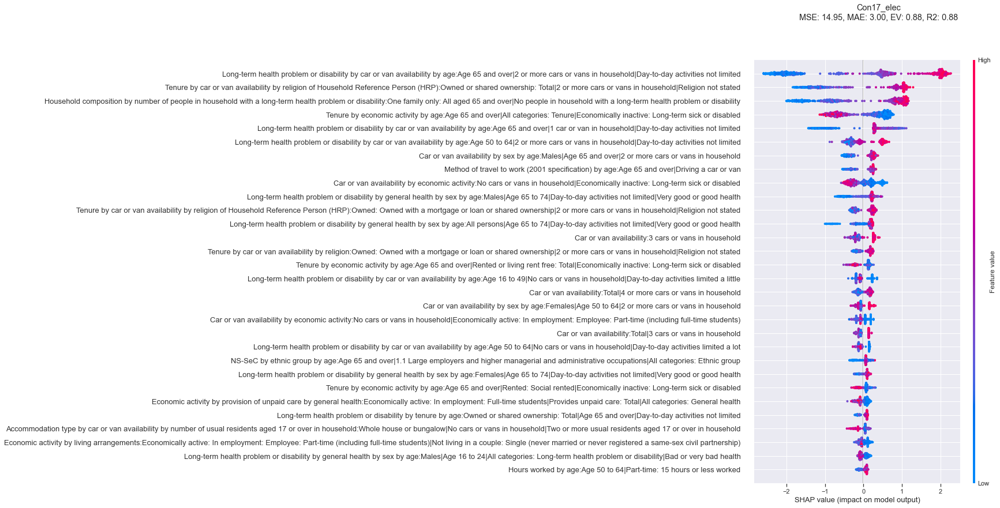

Wall time: 5min 24s


In [287]:
%%time
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = var_stub
dependence_plots = False

alg = get_xgboost_alg(classification_problem=False)
title = var_stub

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

(26,) (572, 60906)


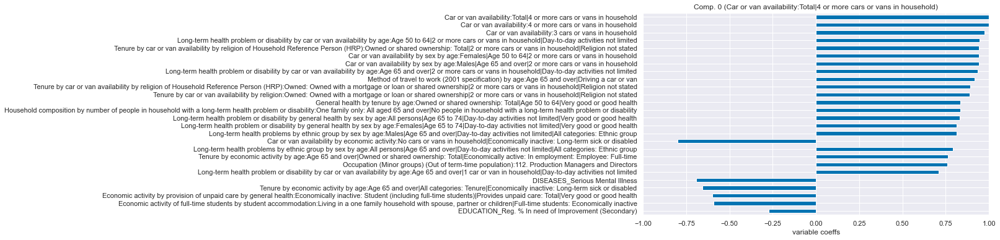

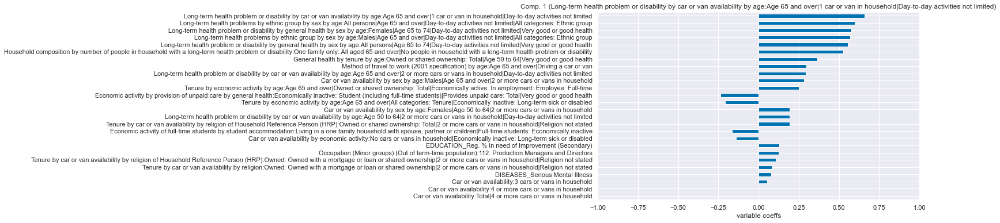

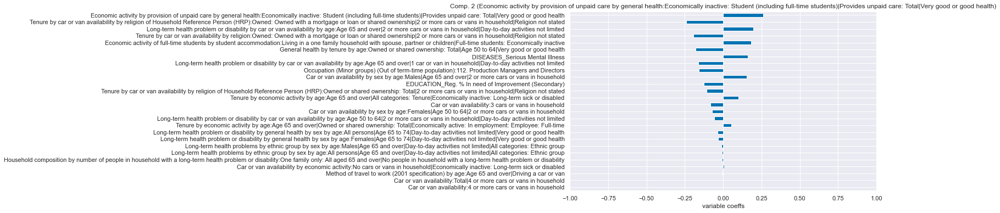

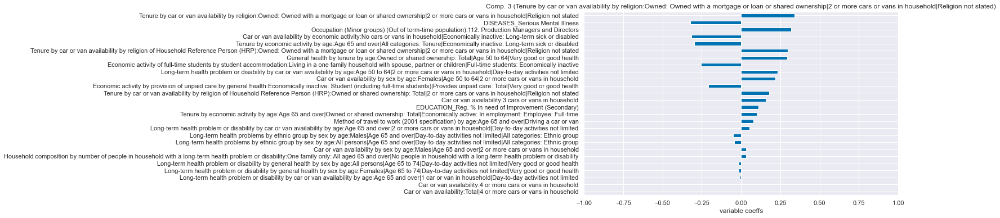

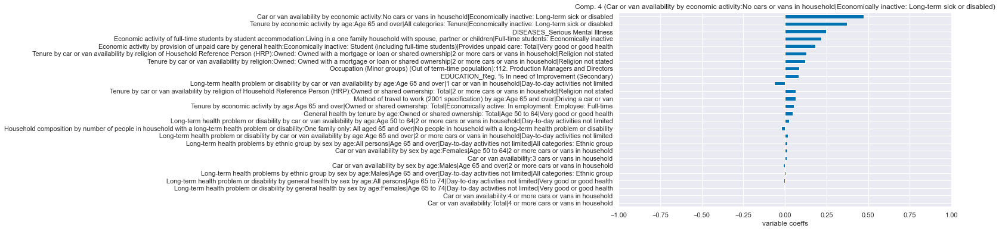

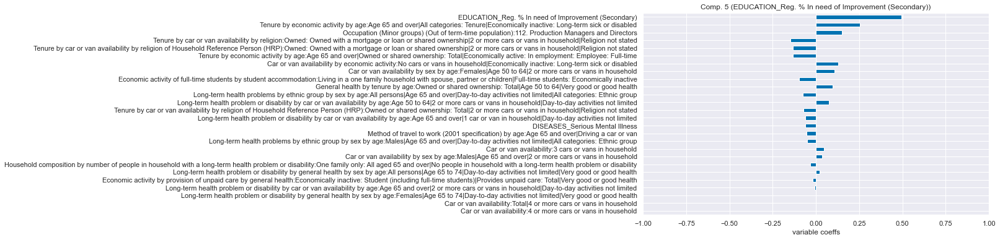

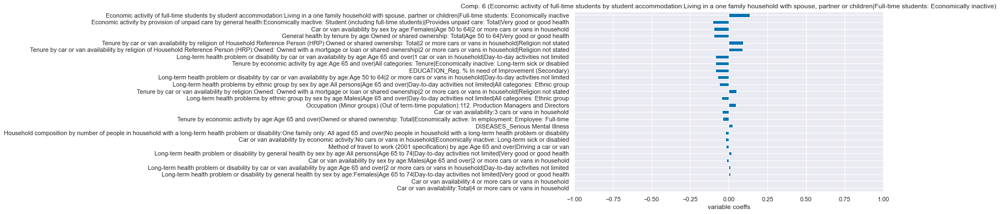

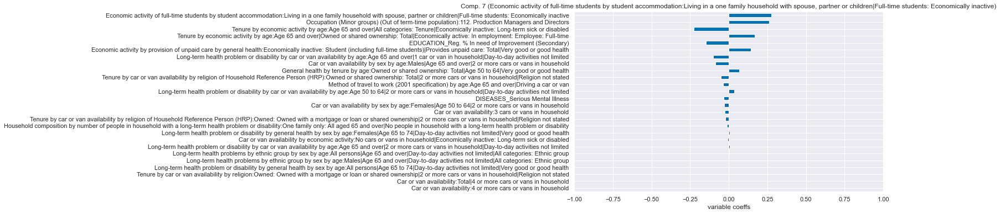

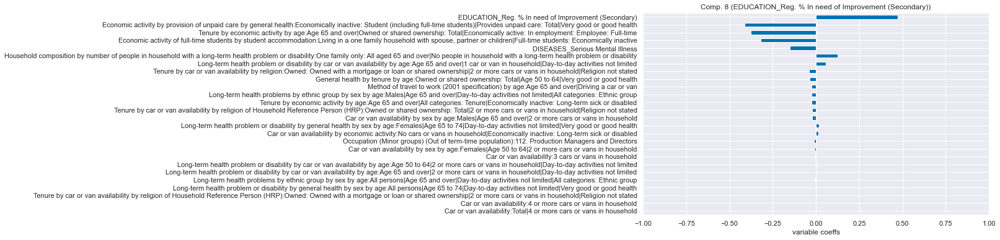

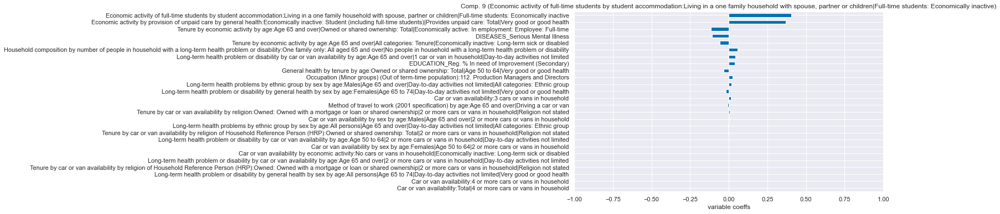

In [296]:
predictions = alg.predict(df_simp.drop(var_stub,axis=1))
MSE = mean_squared_error(df_simp[var_stub], predictions)
MAE = mean_absolute_error(df_simp[var_stub], predictions)
EV = explained_variance_score(df_simp[var_stub], predictions)
R2 = r2_score(df_simp[var_stub], predictions)

dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
print( train_columns[dist[dist>=threshold].index].shape,df_simp.shape )

df = df_simp[train_columns[dist[dist>=threshold].index]][geomask]
df = df.fillna(df.mean())

BES_decomp, comp_labels, comp_dict = dim_red(df, n_components=n_comp,
                                               red_type="Factor Analysis",show_first_x_comps=14,display_comp=True)
n_components = min(n_comp,BES_decomp.shape[1])
Y = df_simp[var_stub]
X = BES_decomp.loc[:,0:n_components]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()

MSE: 10.66, MAE: 2.59, EV: 0.91, R2: 0.91


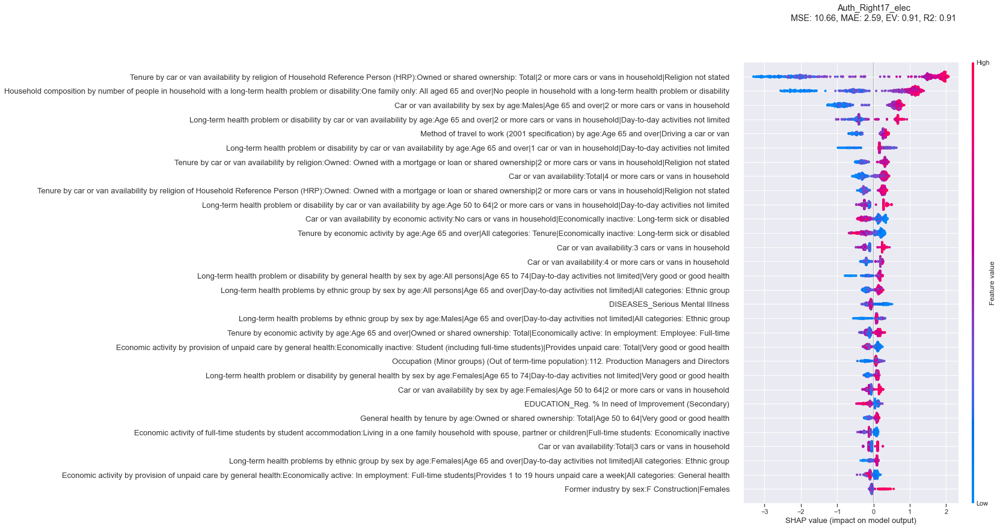

<Figure size 1152x720 with 0 Axes>

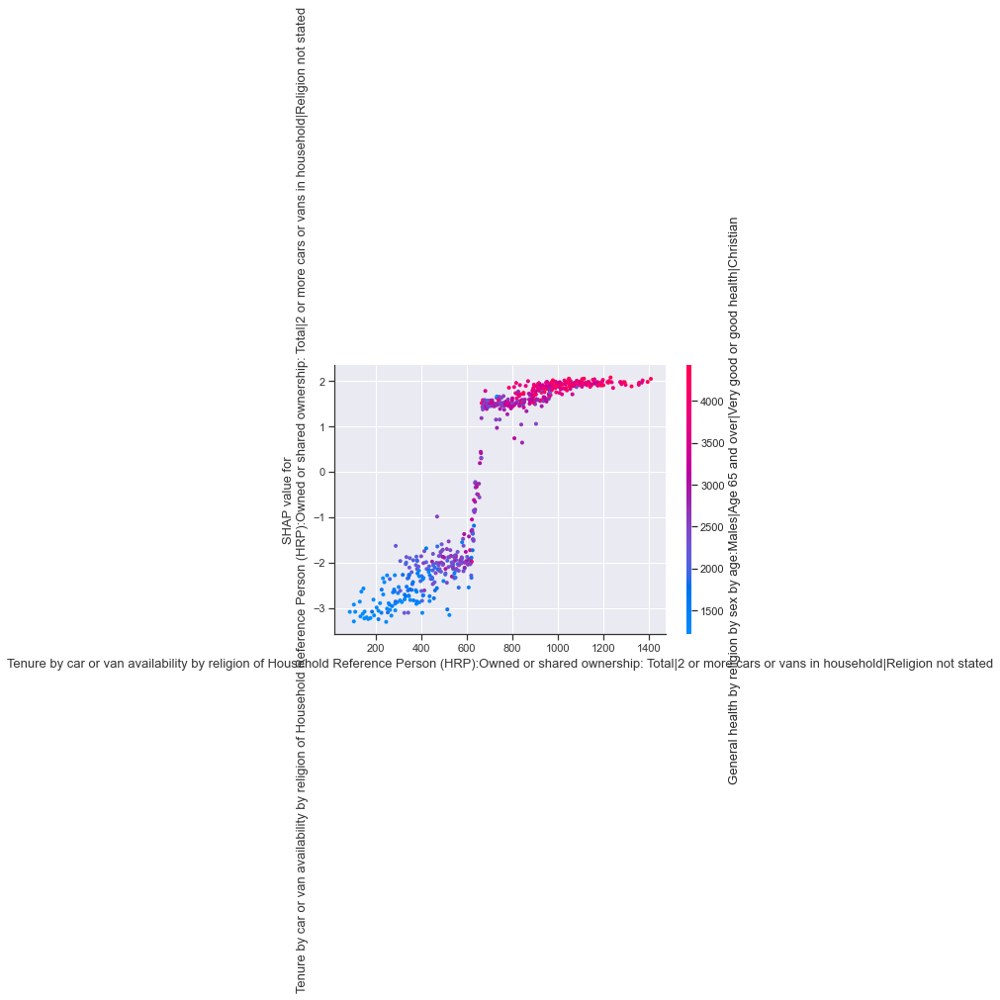

<Figure size 1152x720 with 0 Axes>

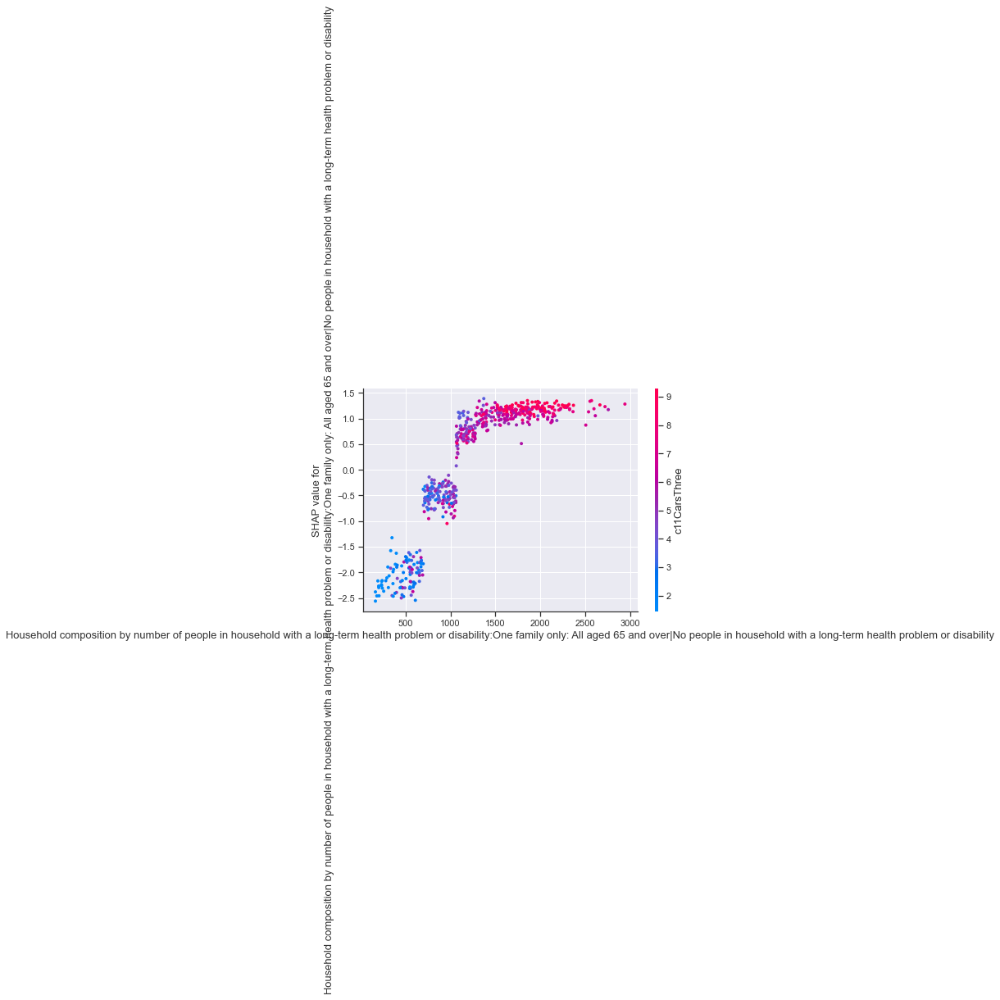

<Figure size 1152x720 with 0 Axes>

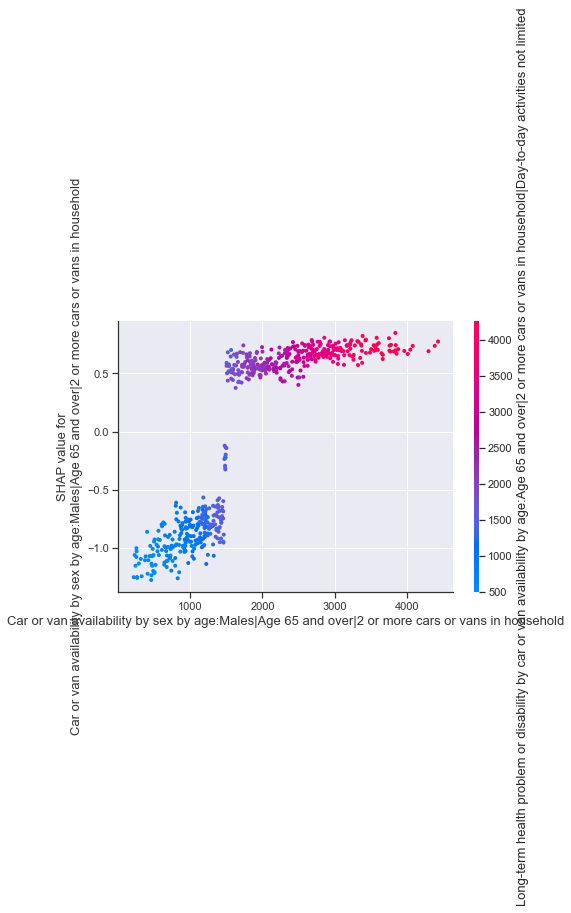

<Figure size 1152x720 with 0 Axes>

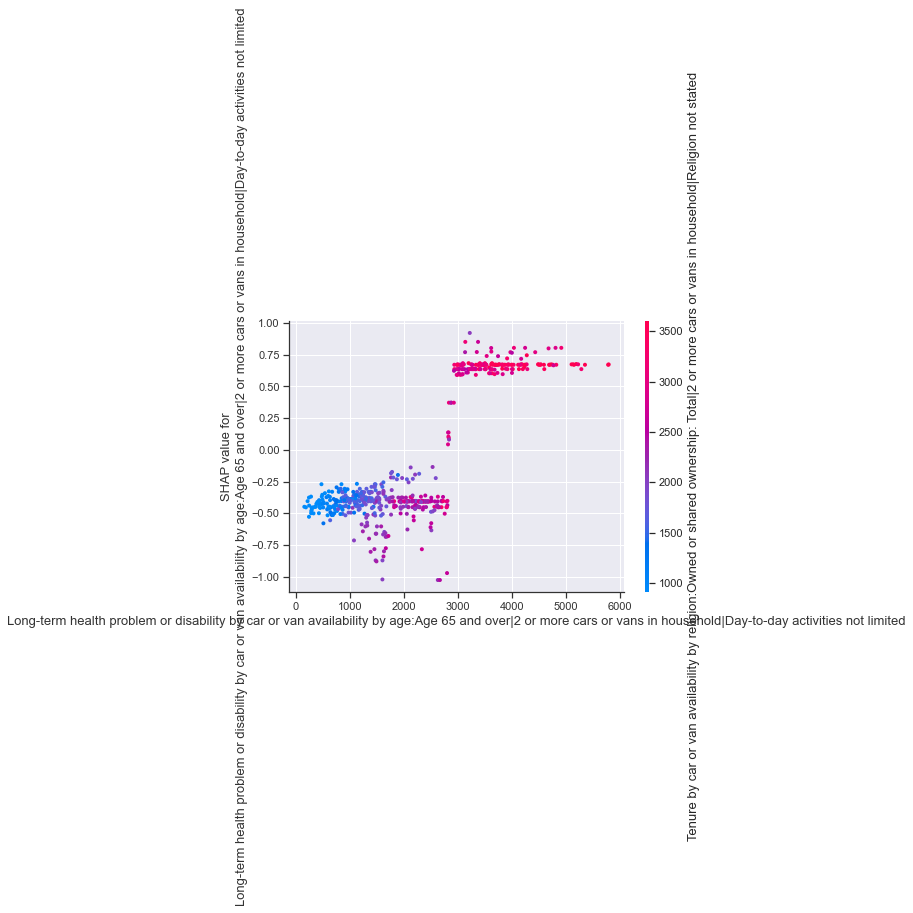

<Figure size 1152x720 with 0 Axes>

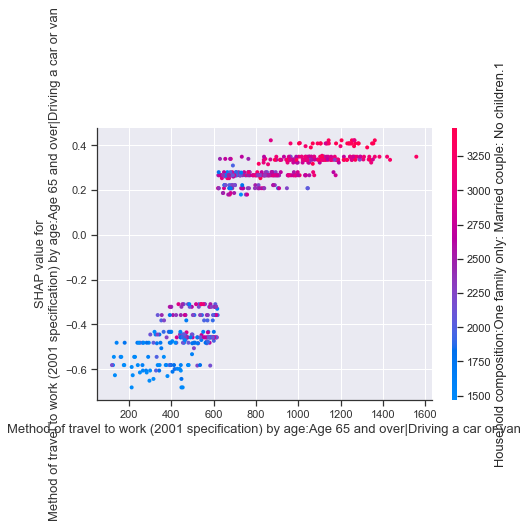

<Figure size 1152x720 with 0 Axes>

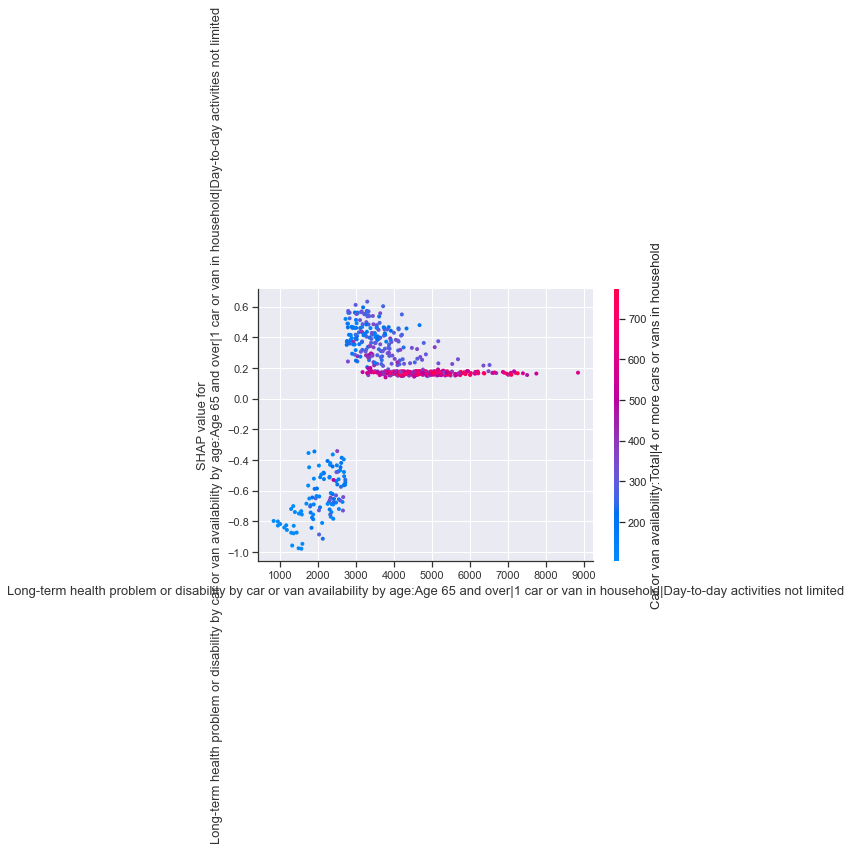

<Figure size 1152x720 with 0 Axes>

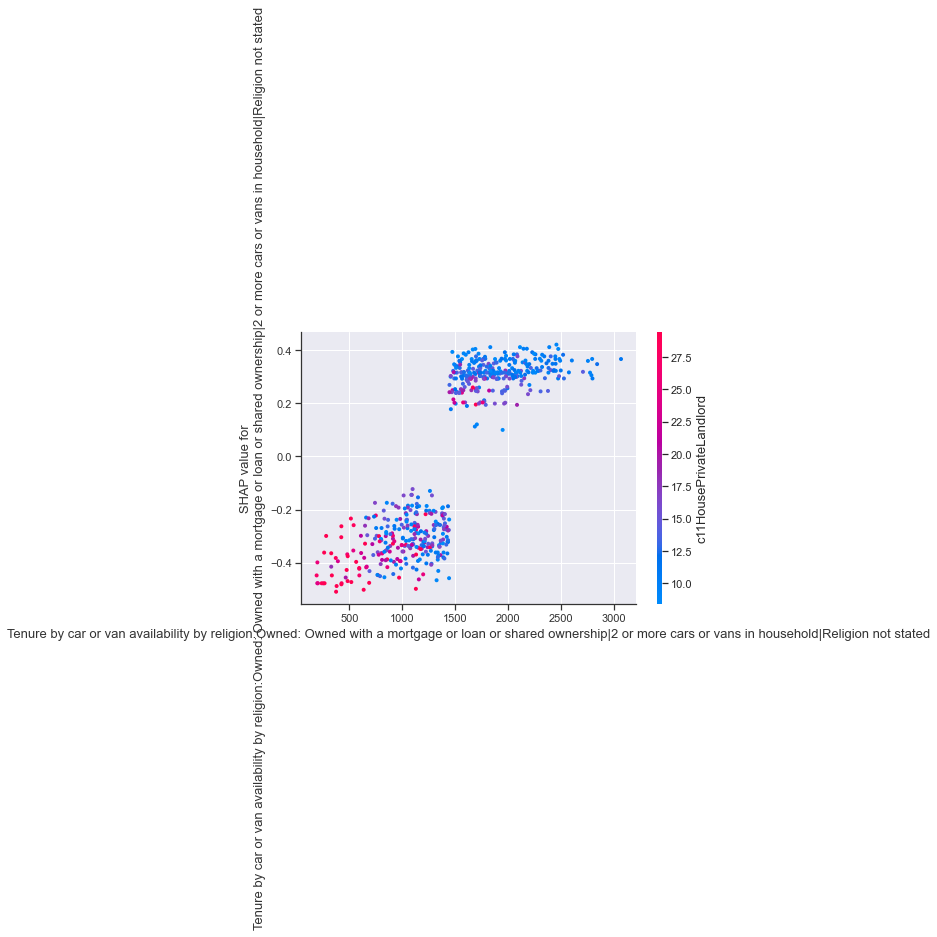

<Figure size 1152x720 with 0 Axes>

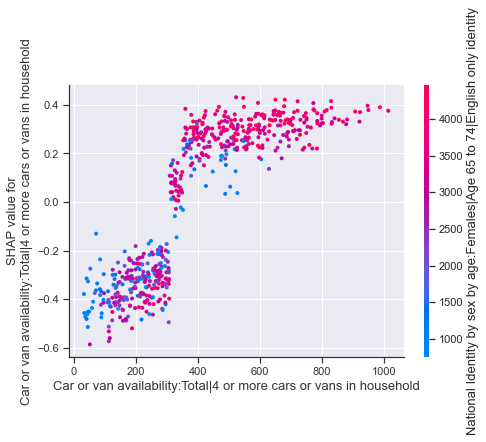

<Figure size 1152x720 with 0 Axes>

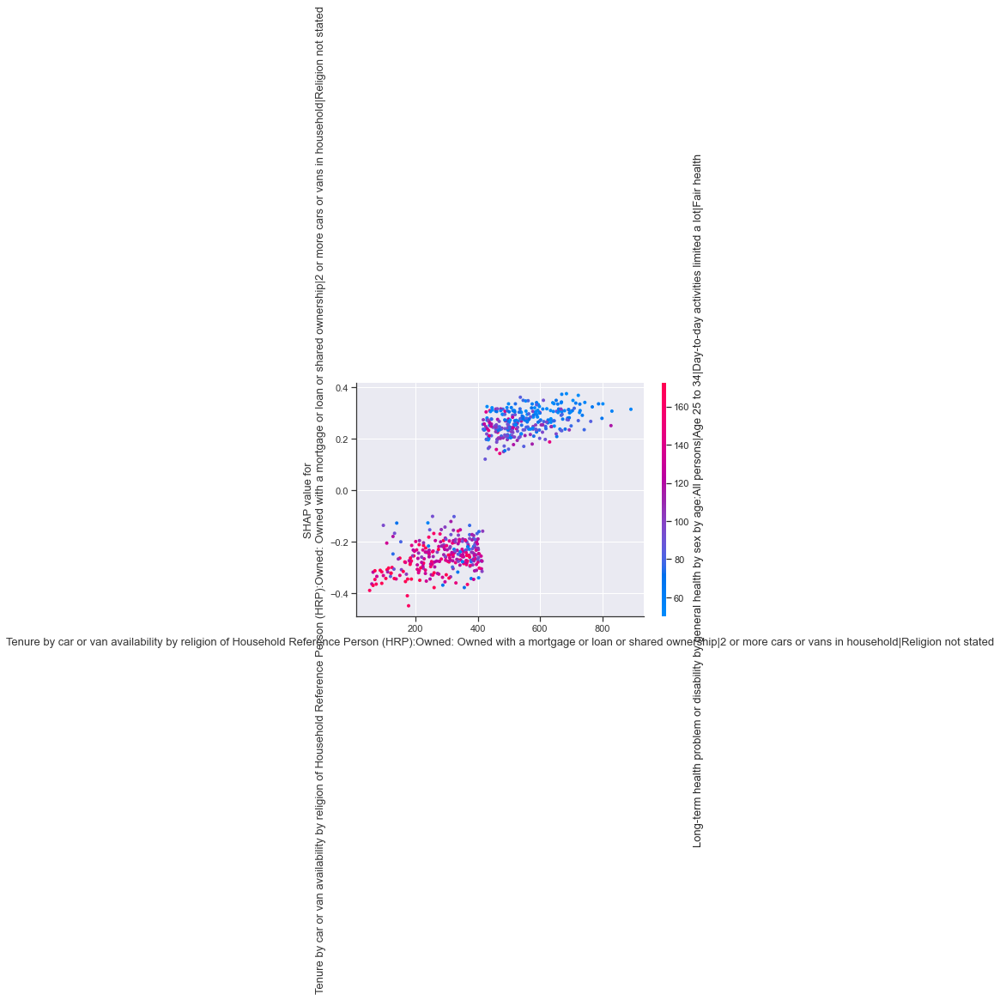

<Figure size 1152x720 with 0 Axes>

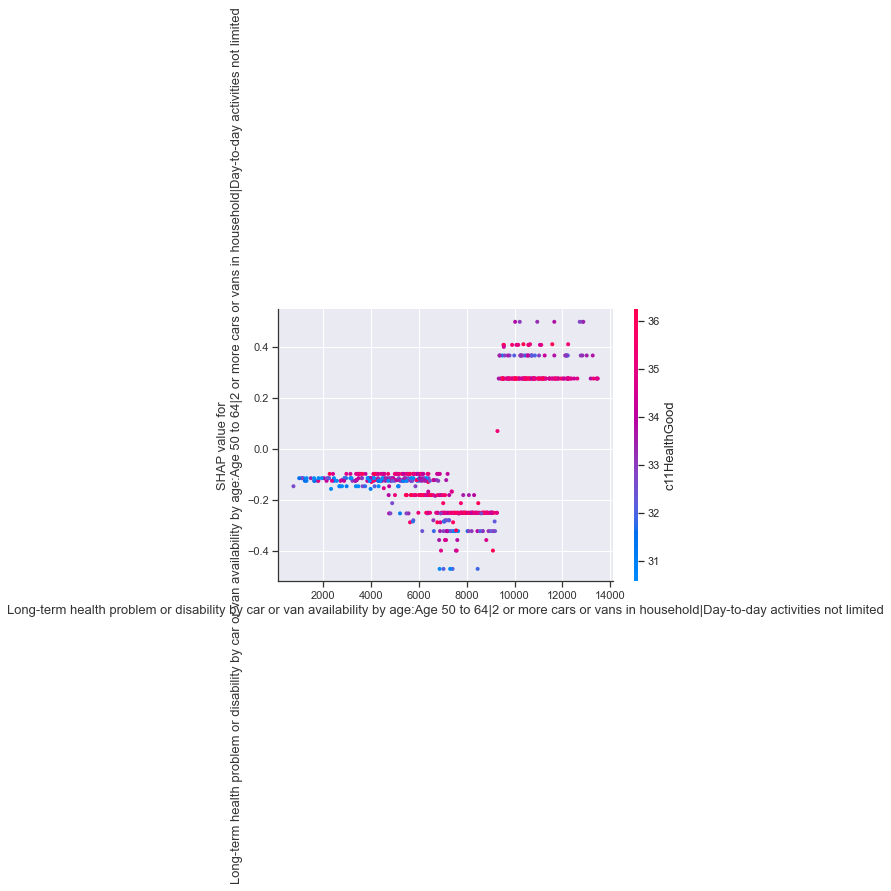

<Figure size 1152x720 with 0 Axes>

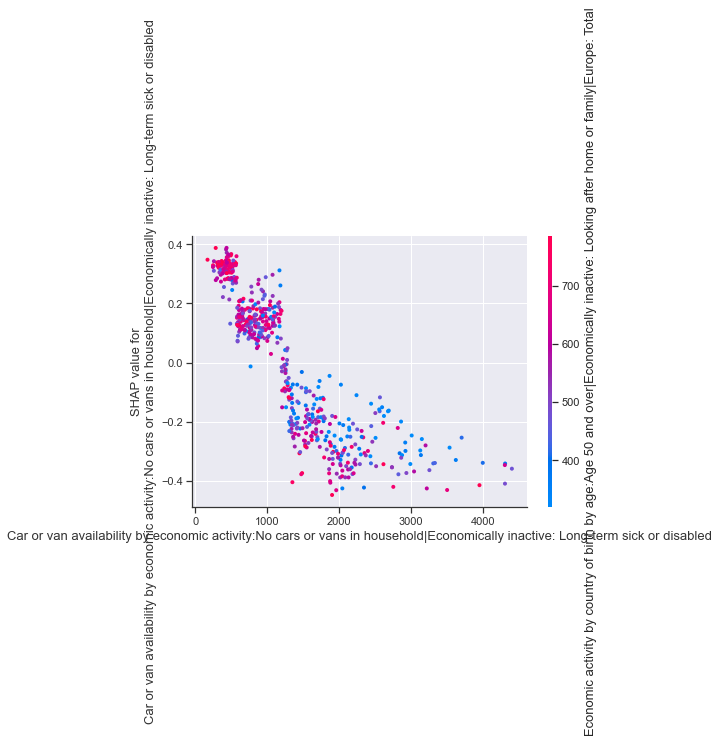

<Figure size 1152x720 with 0 Axes>

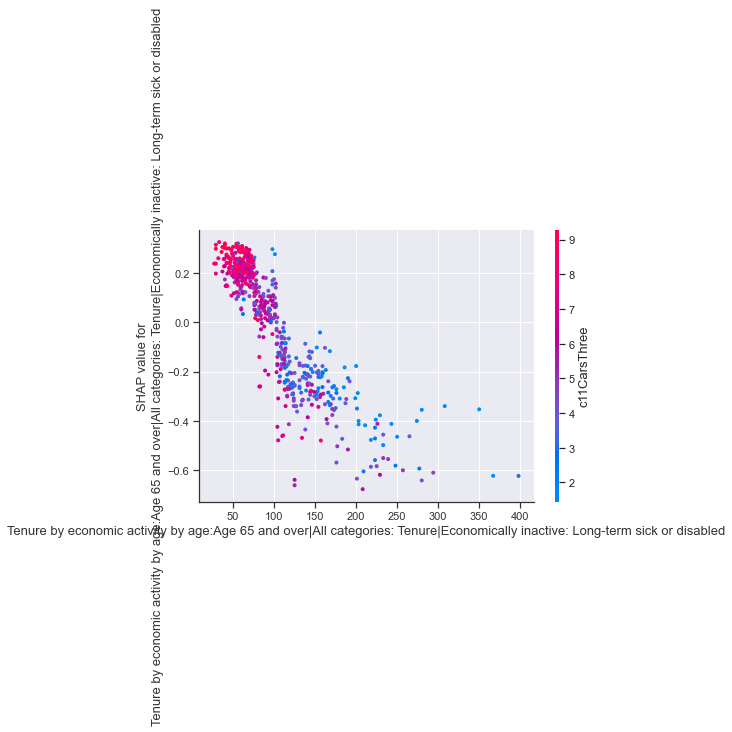

<Figure size 1152x720 with 0 Axes>

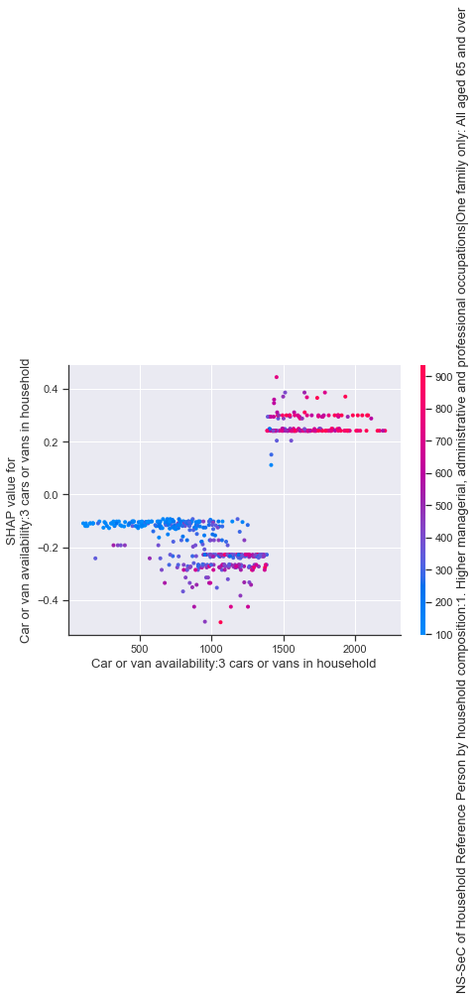

<Figure size 1152x720 with 0 Axes>

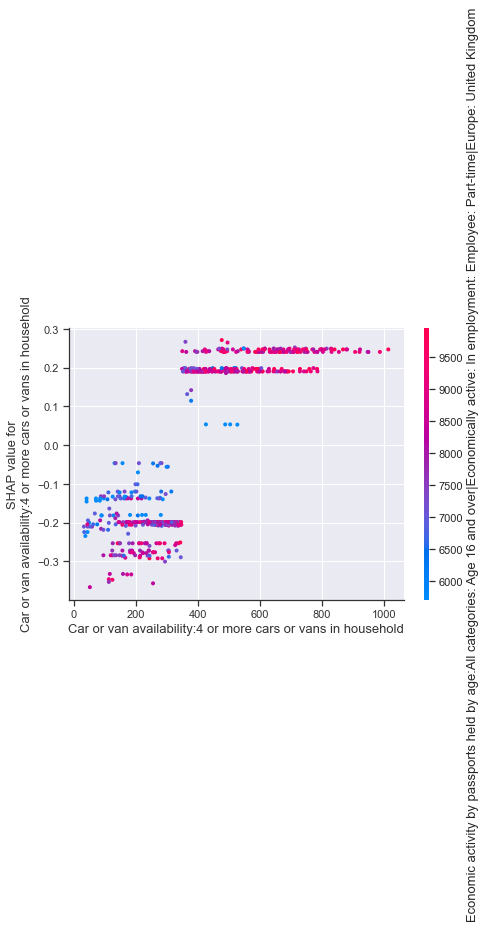

<Figure size 1152x720 with 0 Axes>

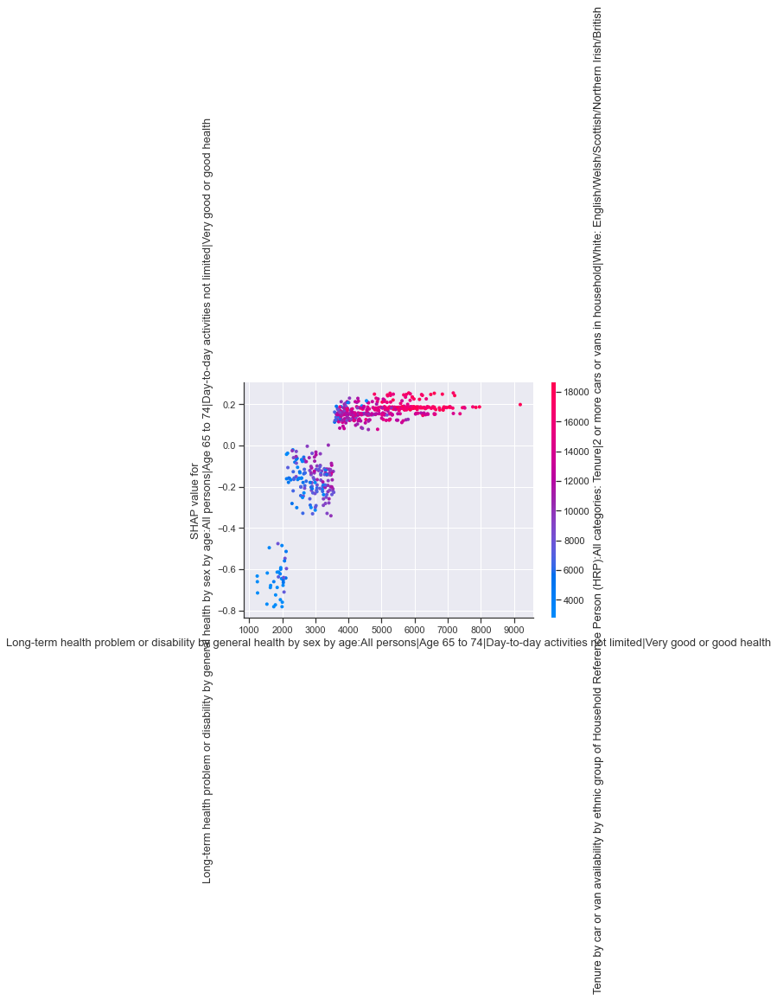

<Figure size 1152x720 with 0 Axes>

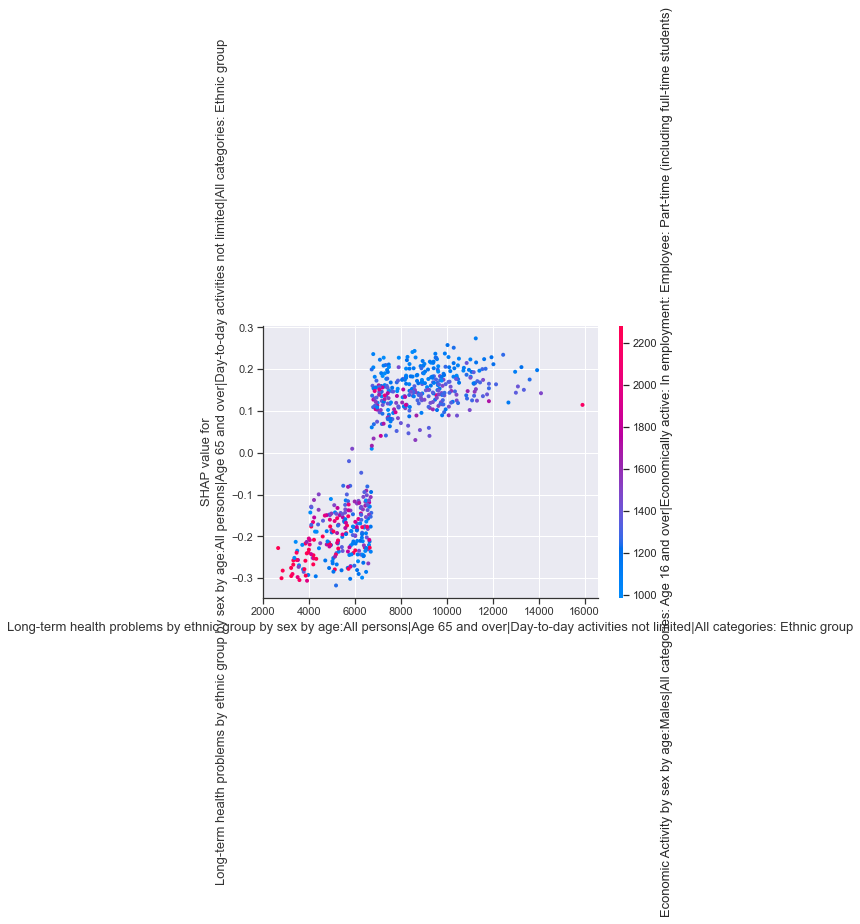

<Figure size 1152x720 with 0 Axes>

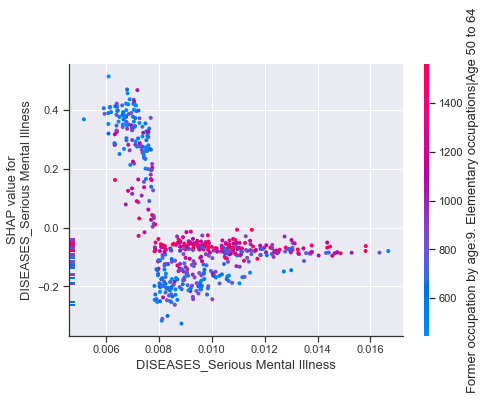

<Figure size 1152x720 with 0 Axes>

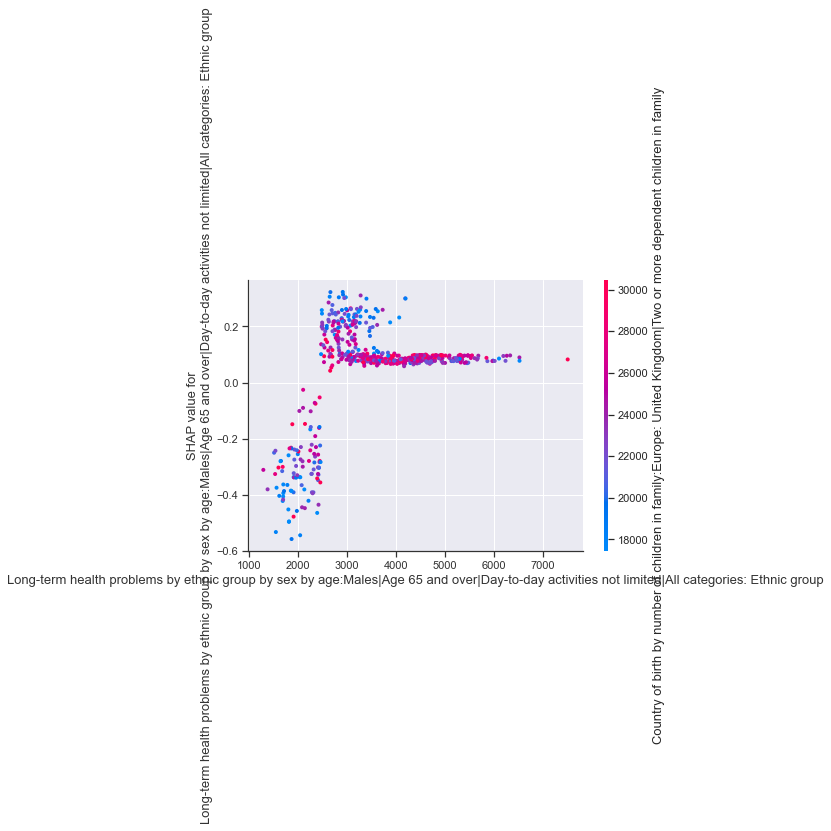

<Figure size 1152x720 with 0 Axes>

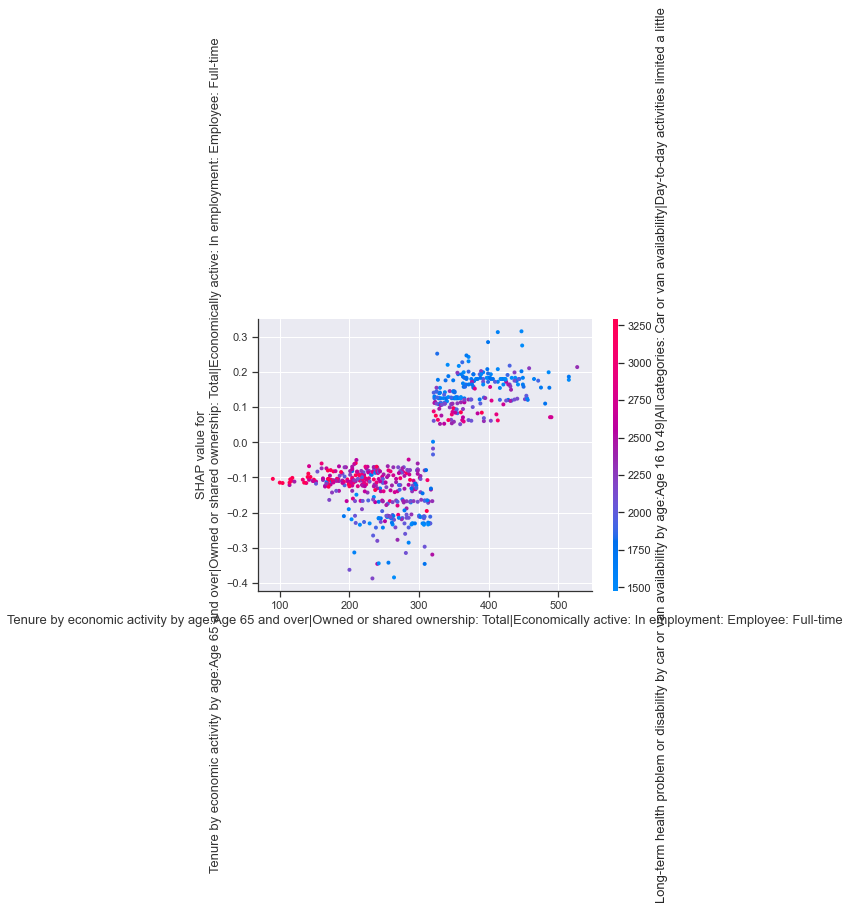

<Figure size 1152x720 with 0 Axes>

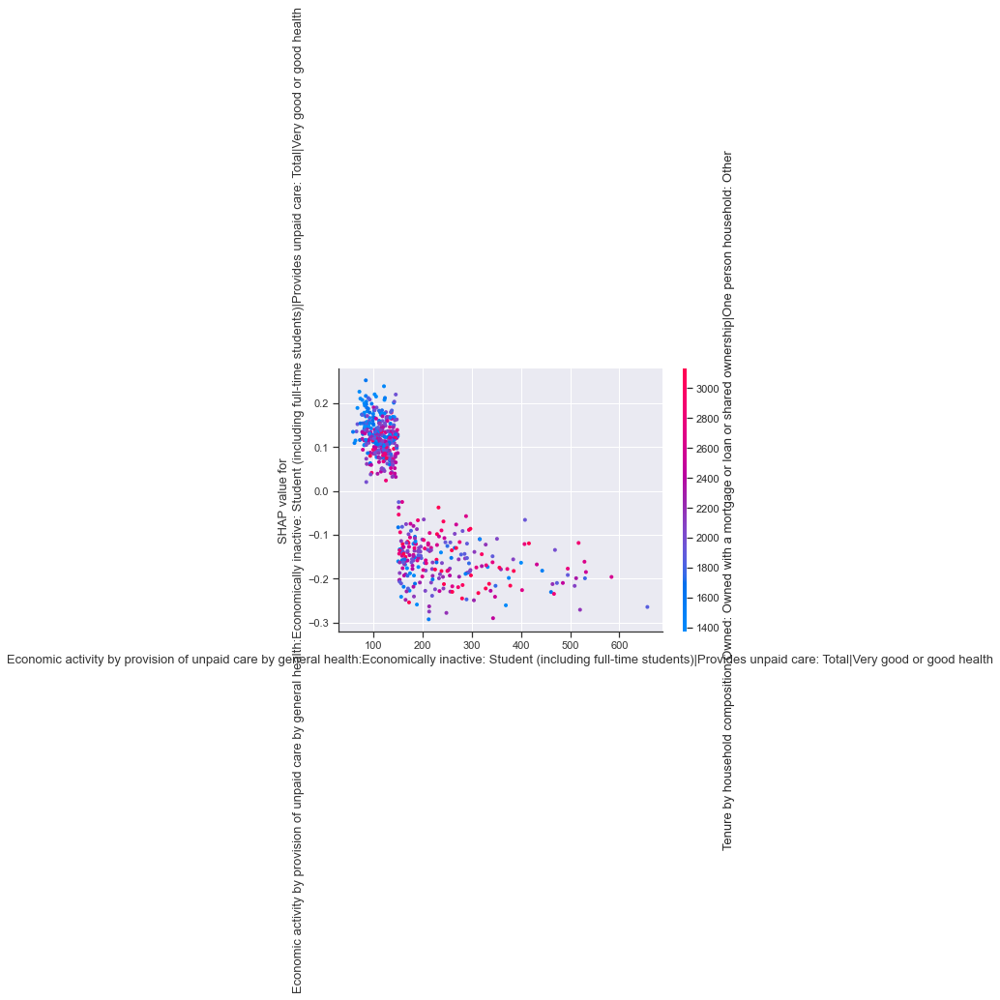

<Figure size 1152x720 with 0 Axes>

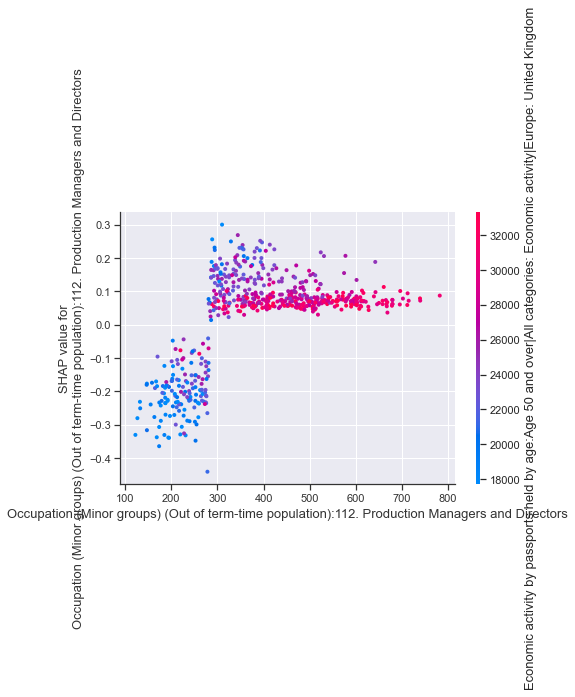

<Figure size 1152x720 with 0 Axes>

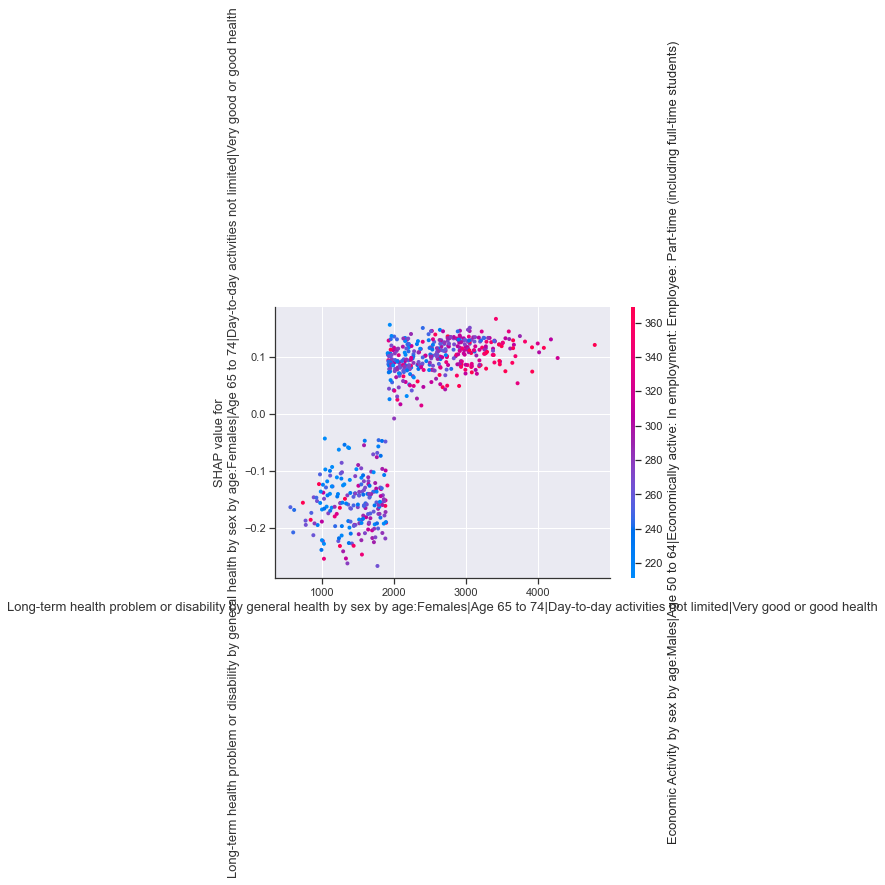

<Figure size 1152x720 with 0 Axes>

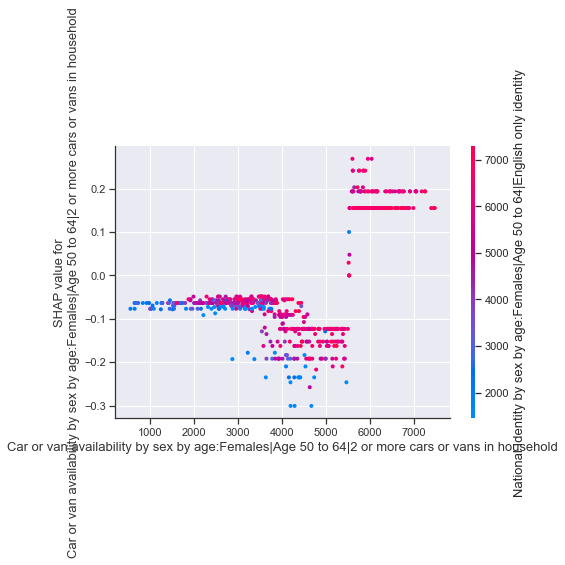

<Figure size 1152x720 with 0 Axes>

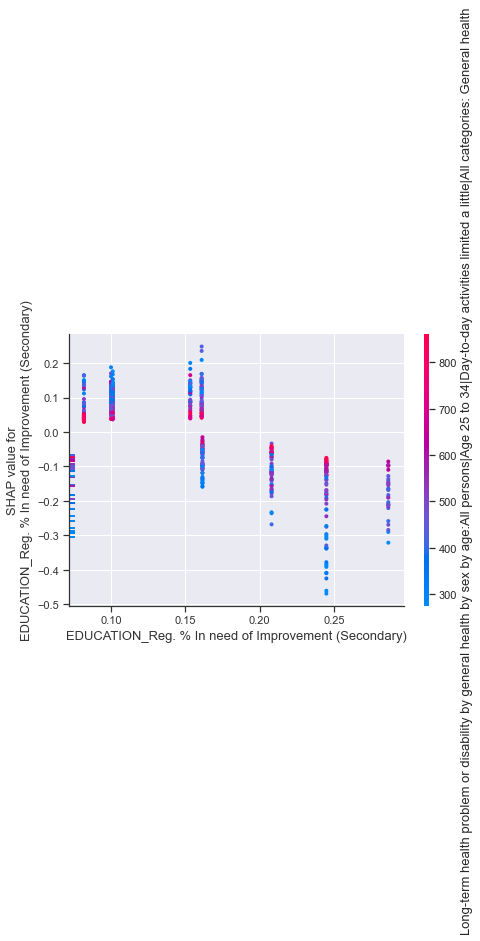

<Figure size 1152x720 with 0 Axes>

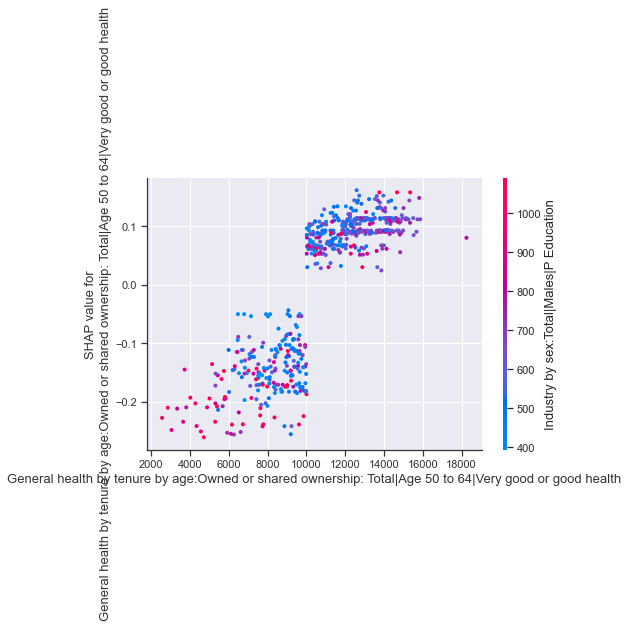

<Figure size 1152x720 with 0 Axes>

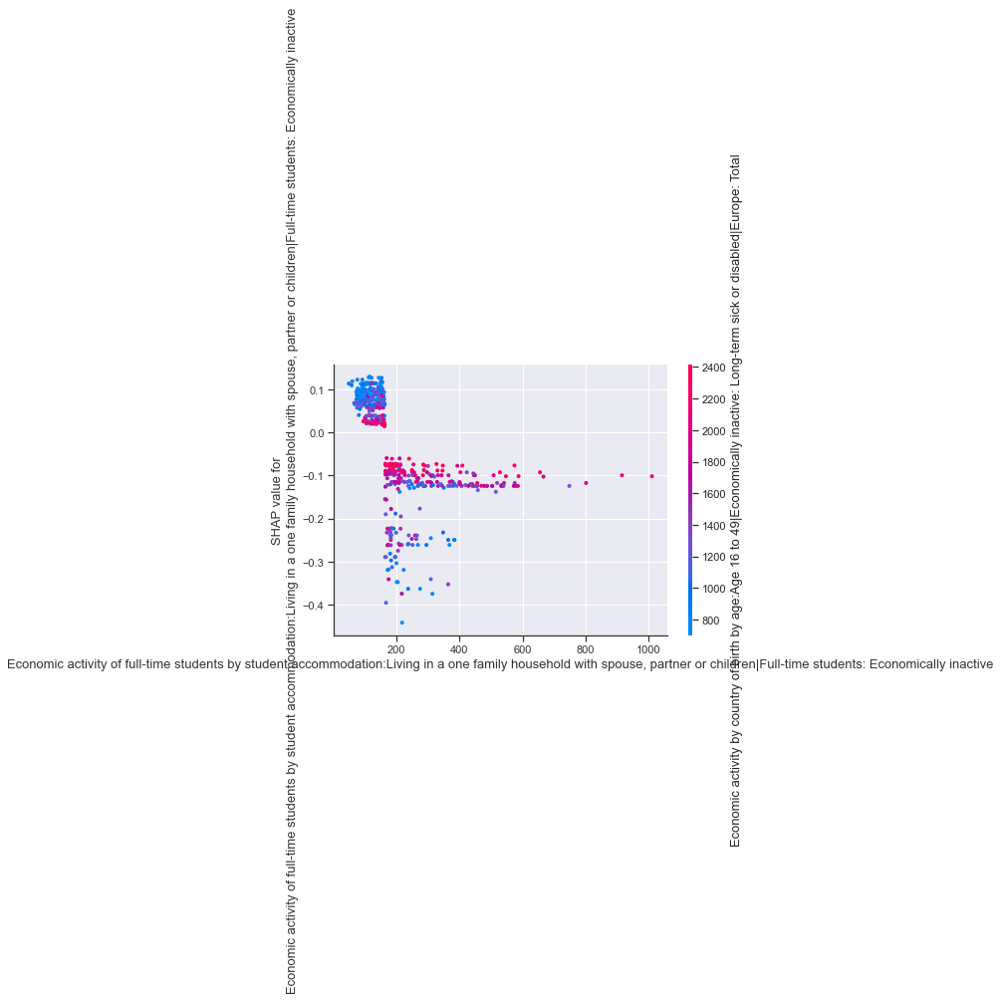

<Figure size 1152x720 with 0 Axes>

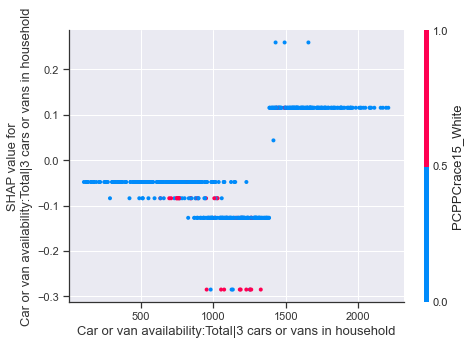

<Figure size 1152x720 with 0 Axes>

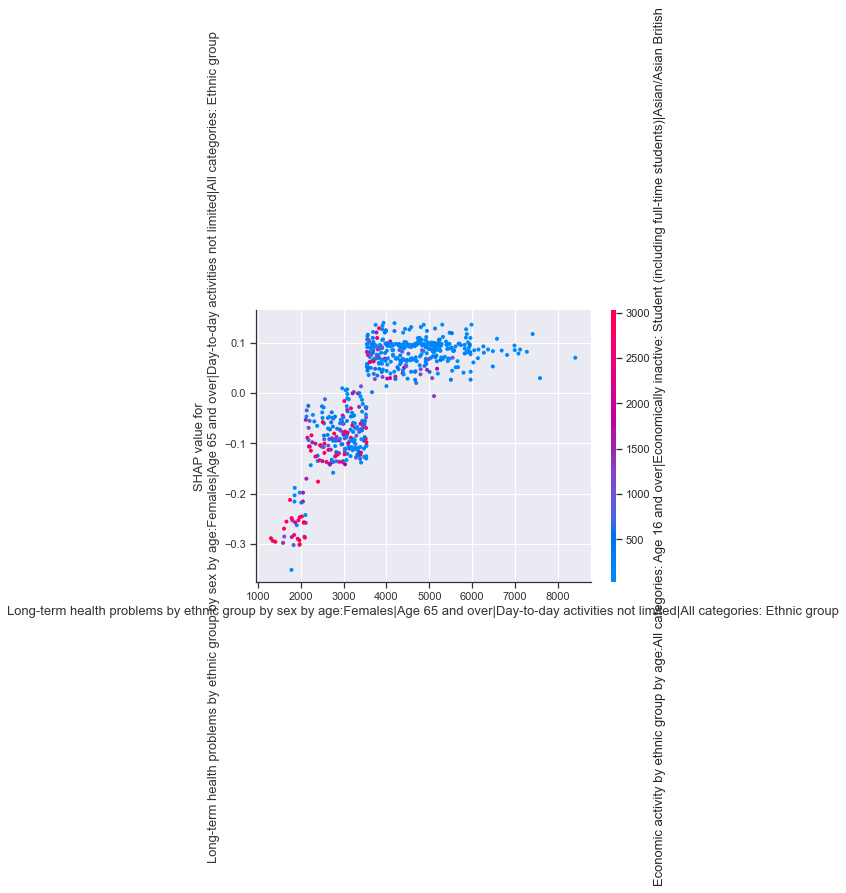

<Figure size 1152x720 with 0 Axes>

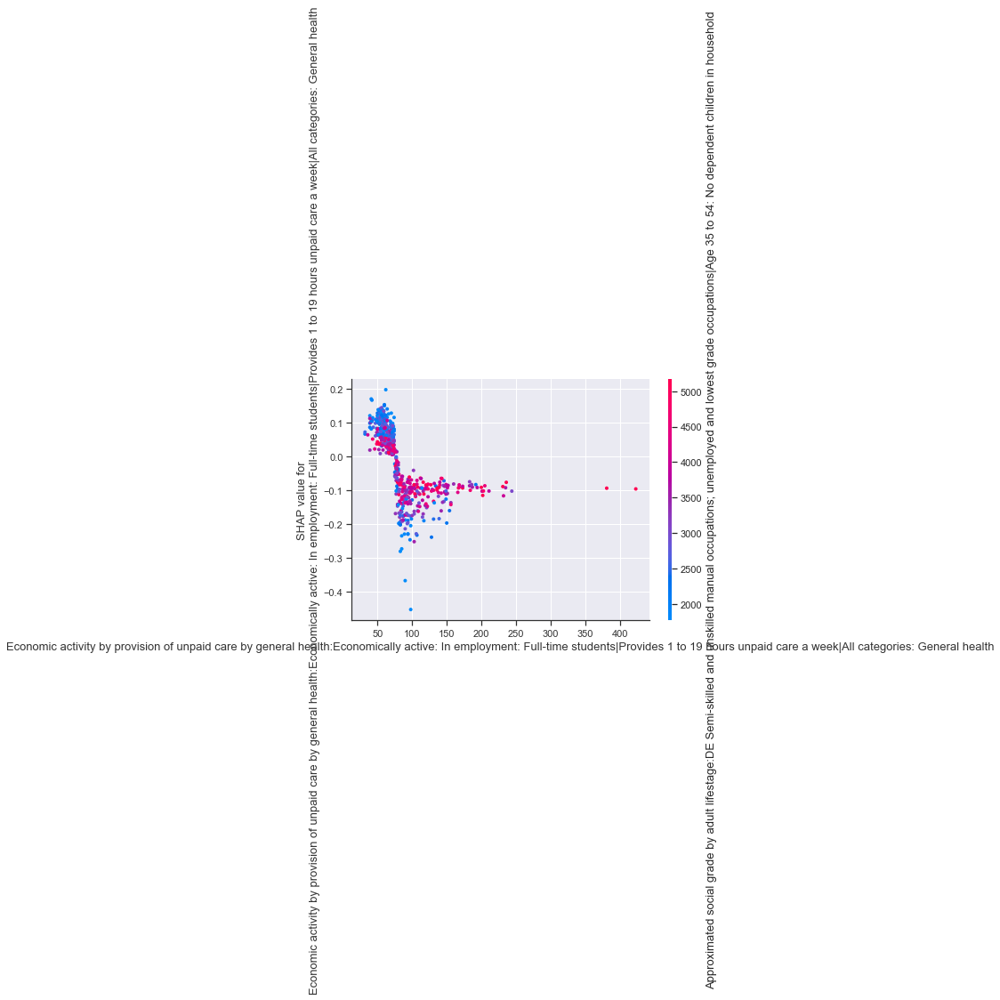

<Figure size 1152x720 with 0 Axes>

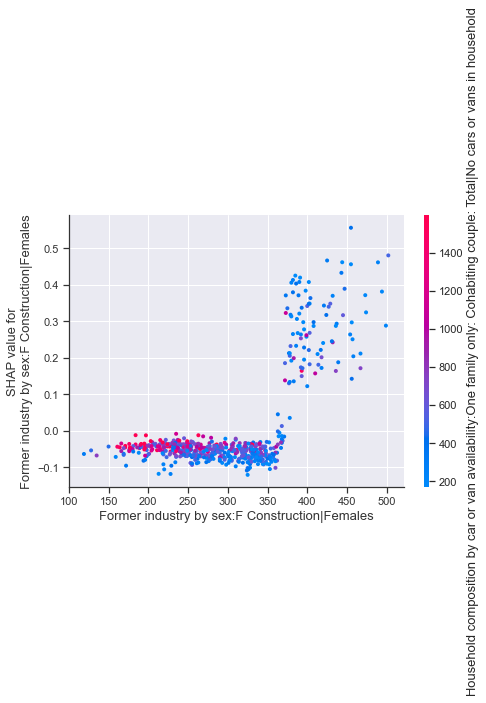

Wall time: 44min 16s


In [290]:
%%time
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = var_stub
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = var_stub

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

In [457]:
%%time
# var_stub = "Auth_Right17_elec"
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
# df_simp[var_stub] = BES_census_data[var_stub]

# BES_agg_cols = BES_constituency_aggregates.drop(search(BES_constituency_aggregates,"|".join(["winConstituency","profile_past","ashcroft","partyContact",
#                                                        "partyId","localElection","localTurnout","^map",
#                                                        "generalElectionVote","euroElectionVote",
#                                                        "^prefer[^M]","ptv"])).index,axis=1).columns
# df_simp[BES_agg_cols] = BES_constituency_aggregates[BES_agg_cols].values

# df_simp.loc[BES_census_data["Country"]!="Scotland",nomis_dump.columns] = nomis_dump.values

df_simp = df_simp[geomask]


Wall time: 94.8 ms


In [336]:
alg.max_depth=10
alg.min_child_weight=1
alg.learning_rate=0.05

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=0.9,
             colsample_bynode=0.85, colsample_bytree=0.7, gamma=0.000650000002,
             gpu_id=-1, importance_type='gain', interaction_constraints='',
             learning_rate=0.05, max_delta_step=0, max_depth=6,
             min_child_weight=6, min_split_loss=0.00065, missing=nan,
             monotone_constraints='()', n_estimators=1638, n_jobs=8, nthread=8,
             num_parallel_tree=1, random_state=729, refresh_leaf=0,
             reg_alpha=1.075, reg_lambda=1.011, scale_pos_weight=1.09,
             sketch_eps=0.0, subsample=0.8, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [347]:
alg = get_xgboost_alg(classification_problem=False)
alg

XGBRegressor(base_score=None, booster=None, colsample_bylevel=0.9,
             colsample_bynode=0.85, colsample_bytree=0.7, gamma=None,
             gpu_id=None, importance_type='gain', interaction_constraints=None,
             learning_rate=0.05, max_delta_step=None, max_depth=6,
             min_child_weight=6, min_split_loss=0.00065, missing=nan,
             monotone_constraints=None, n_estimators=500, n_jobs=8, nthread=8,
             num_parallel_tree=None, random_state=729, refresh_leaf=0,
             reg_alpha=1.075, reg_lambda=1.011, scale_pos_weight=1.09,
             sketch_eps=0.0, subsample=0.8, tree_method=None,
             validate_parameters=None, verbosity=None)

In [366]:
alg

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
             importance_type='gain', interaction_constraints='',
             learning_rate=0.300000012, max_delta_step=0, max_depth=6,
             min_child_weight=1, missing=nan, monotone_constraints='()',
             n_estimators=34, n_jobs=6, num_parallel_tree=1, random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

MSE: 13.38, MAE: 2.82, EV: 0.89, R2: 0.89


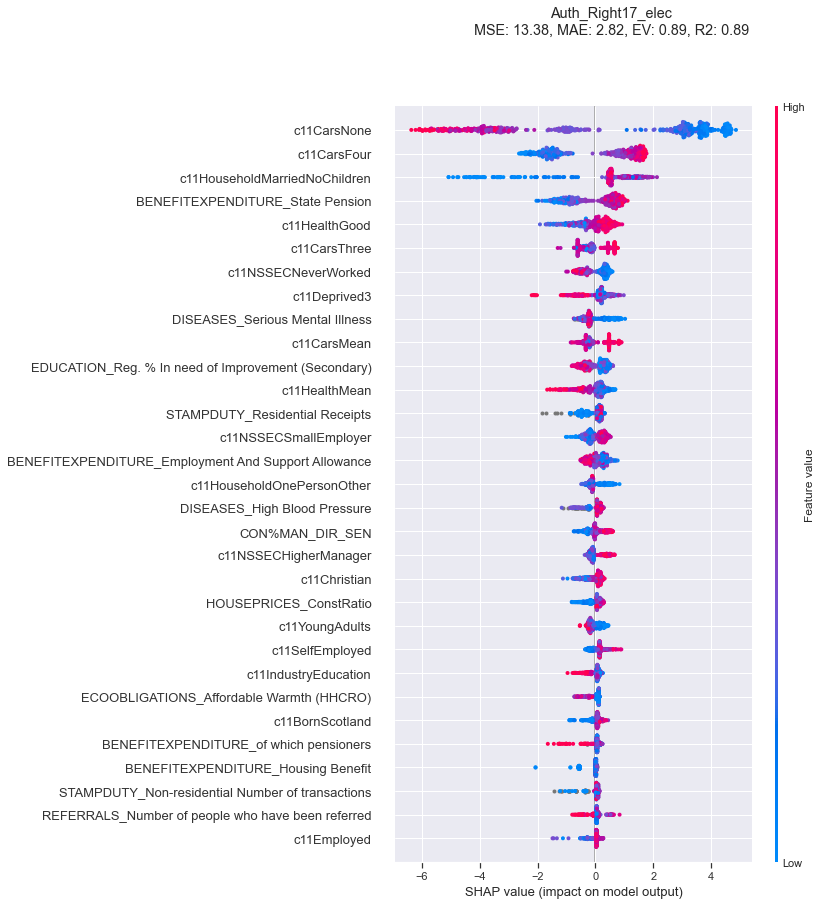

Wall time: 41.2 s


In [367]:
%%time
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = var_stub
dependence_plots = False

alg = get_xgboost_alg(classification_problem=False)
# alg.n_estimators =alg.n_estimators*10
# alg.max_depth=10
# alg.min_child_weight=1
alg = XGBRegressor(n_estimators=500)
alg.learning_rate=0.05
title = var_stub

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

(267,) (572, 6425)
1.2523764462624039e-05 0.0026571908391448827 0.9999999001589573 0.9999999001588651


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:      Auth_Right17_elec   R-squared:                       0.856
Model:                            OLS   Adj. R-squared:                  0.853
Method:                 Least Squares   F-statistic:                     333.4
Date:                Sat, 29 Jan 2022   Prob (F-statistic):          1.25e-228
Time:                        17:26:59   Log-Likelihood:                -1639.3
No. Observations:                 572   AIC:                             3301.
Df Residuals:                     561   BIC:                             3348.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==========================================================================================================================================
                                                                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------------------------------------------------
const                                                                     32.1303      0.179    179.048      0.000      31.778      32.483
Comp. 0 (c11Elderly)                                                       7.8958      0.179     43.988      0.000       7.543       8.248
Comp. 1 (c11NSSECLowerManager)                                             5.2438      0.180     29.201      0.000       4.891       5.596
Comp. 2 (c11QualLevel3)                                                   -1.6367      0.180     -9.107      0.000      -1.990      -1.284
Comp. 3 (c11HouseMortgage)                                                 1.5669      0.180      8.708      0.000       1.213       1.920
Comp. 4 (c11HealthGood)                                                    2.5454      0.180     14.130      0.000       2.192       2.899
Comp. 5 (HOUSEHOLDECOS_Households with at least one usual resident1,2)     0.7271      0.180      4.030      0.000       0.373       1.081
Comp. 6 (c11Deprived1)                                                     1.6016      0.181      8.828      0.000       1.245       1.958
Comp. 7 (STAMPDUTY_Residential Receipts)                                   1.2064      0.182      6.640      0.000       0.850       1.563
Comp. 8 (c11IndustryAgriculture)                                          -1.2888      0.182     -7.065      0.000      -1.647      -0.930
Comp. 9 (EDUCATION_Reg. % In need of Improvement (Secondary))             -0.0132      0.183     -0.072      0.943      -0.373       0.347
==============================================================================
Omnibus:                       24.944   Durbin-Watson:                   1.864
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               27.114
Skew:                          -0.502   Prob(JB):                     1.30e-06
Kurtosis:                       3.360   Cond. No.                         1.02
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

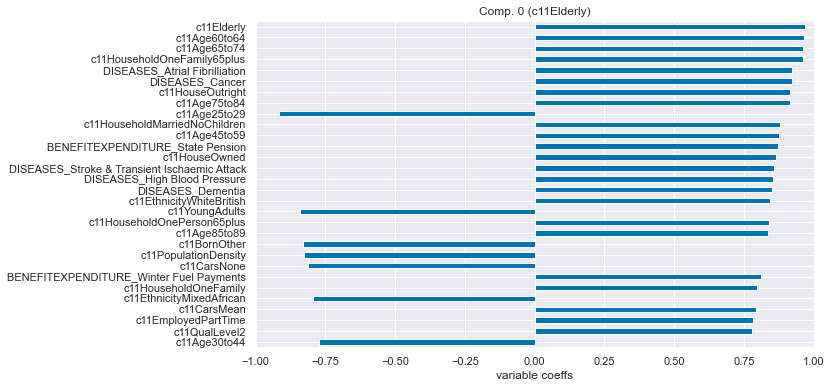

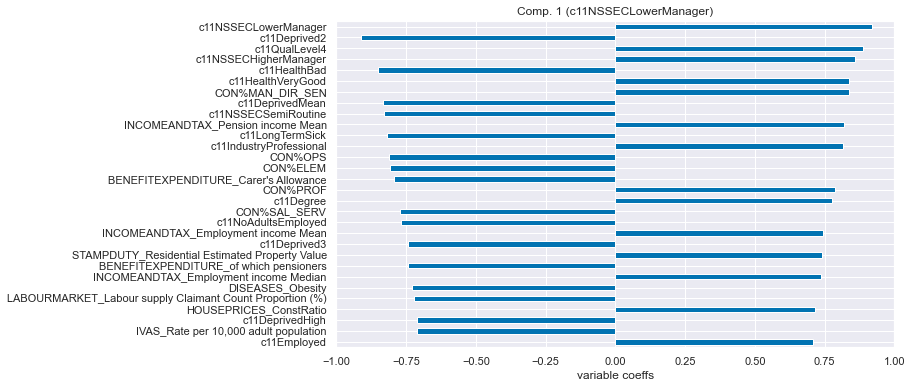

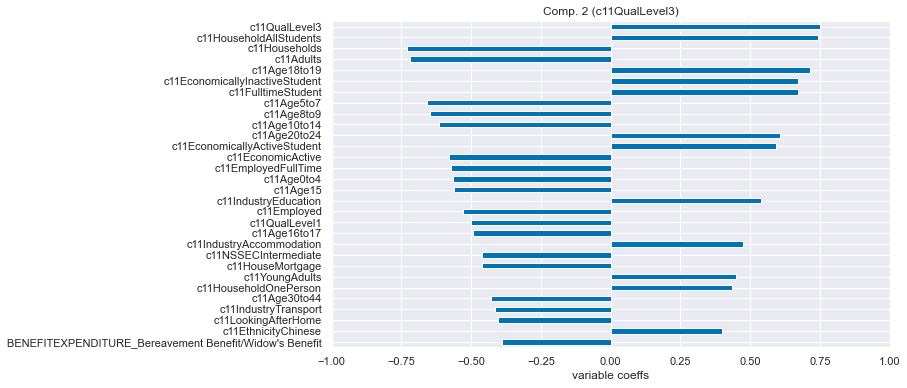

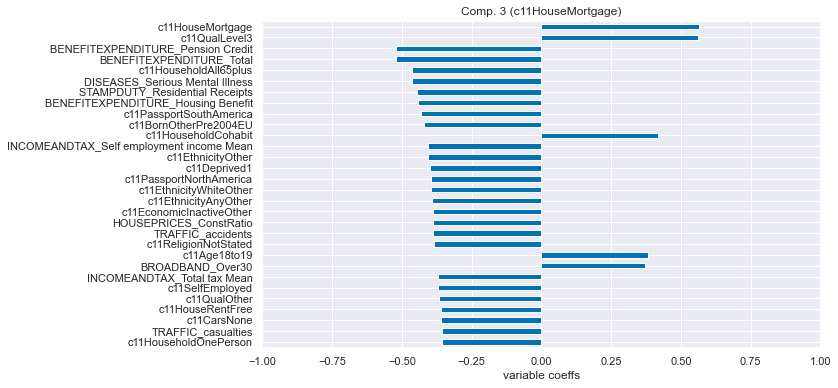

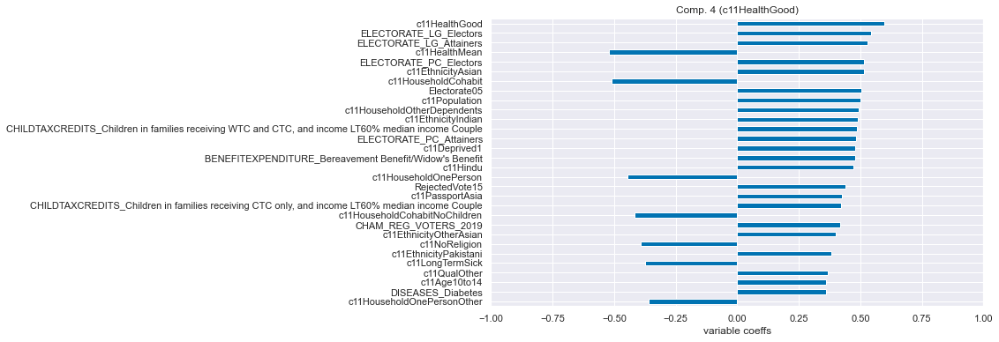

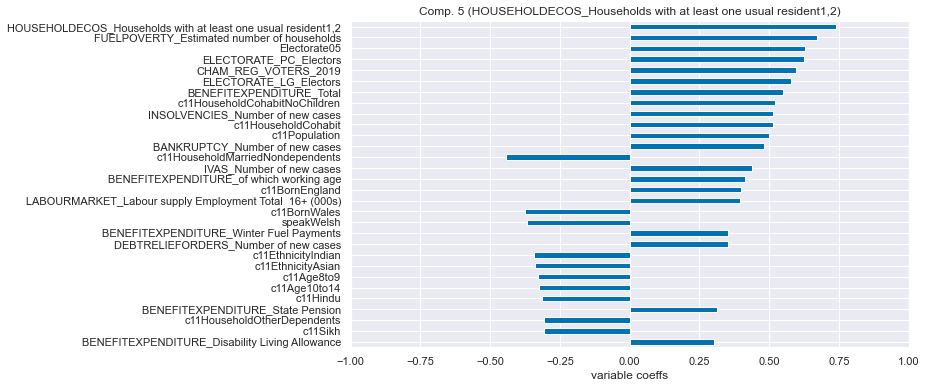

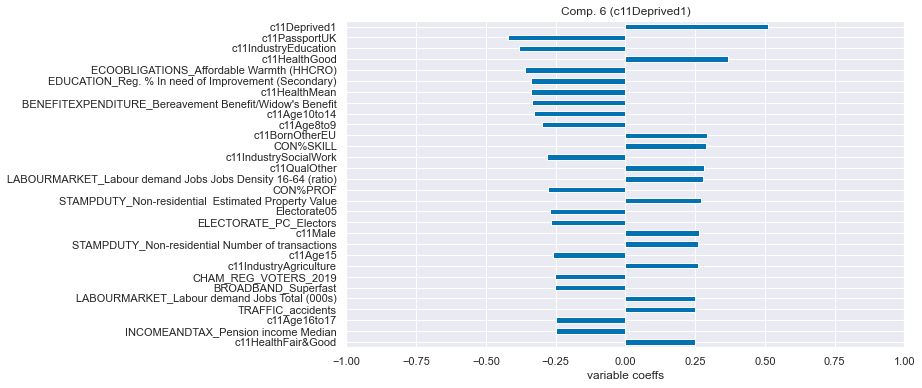

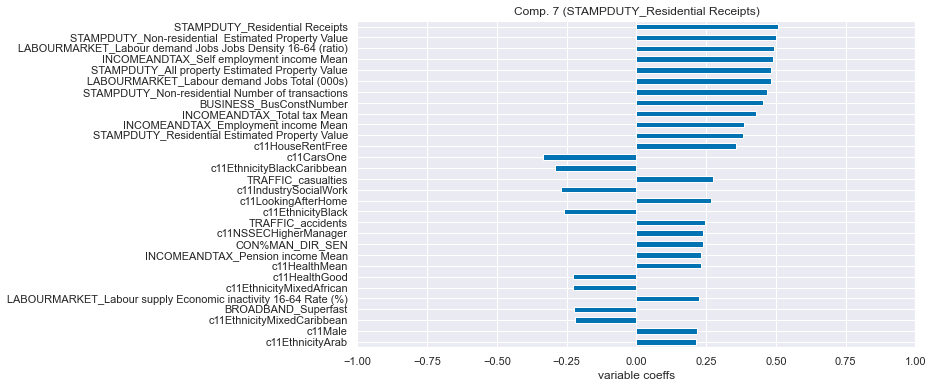

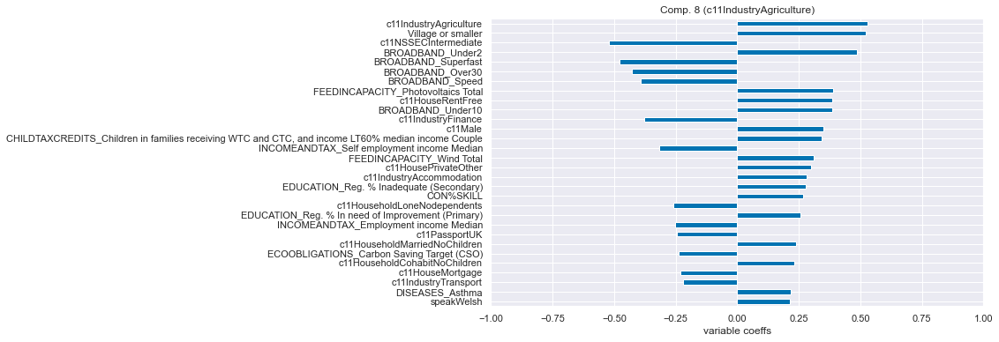

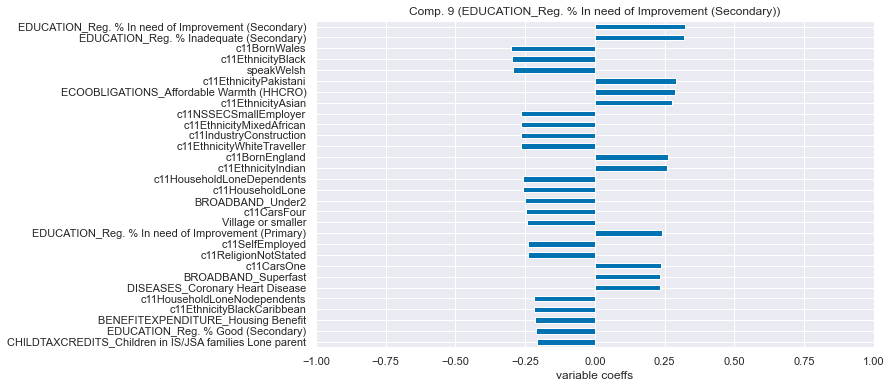

In [368]:
threshold = 0.05

predictions = alg.predict(df_simp.drop(var_stub,axis=1))
MSE = mean_squared_error(df_simp[var_stub], predictions)
MAE = mean_absolute_error(df_simp[var_stub], predictions)
EV = explained_variance_score(df_simp[var_stub], predictions)
R2 = r2_score(df_simp[var_stub], predictions)

dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
print( train_columns[dist[dist>=threshold].index].shape,df_simp.shape )
print(MSE,MAE,EV,R2)

df = df_simp[train_columns[dist[dist>threshold].index]][geomask]
df = df.fillna(df.mean())

BES_decomp, comp_labels, comp_dict = dim_red(df, n_components=n_comp,
                                               red_type="Factor Analysis",show_first_x_comps=14,display_comp=True)
n_components = min(n_comp,BES_decomp.shape[1])
BES_decomp.columns = list(comp_labels.values())
Y = df_simp[var_stub]
X = BES_decomp.loc[:,BES_decomp.columns[0:n_components]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

In [ ]:
# .001: R-squared:	0.853
# .005: R-squared:	0.862
# .01:R-squared:	0.872
# .02:R-squared:	0.874
# .03:R-squared:	0.865
# .04:R-squared:	0.882
# .05:R-squared:	0.877
# .06:R-squared:	0.878

# .1:R-squared:	0.868

In [352]:
# threshold = 0
# R-squared:	0.849

(324,)

In [350]:
# alg = XGBRegressor(n_estimators=500)
dist[dist!=0].shape
# R-squared:	0.868

(324,)

In [346]:
# alg = XGBRegressor()
dist[dist!=0].shape
# R-squared:	0.868

(324,)

In [342]:
# alg.min_child_weight=1
dist[dist!=0].shape
# R-squared: R-squared:	0.880

(434,)

In [339]:
# alg.max_depth=10
dist[dist!=0].shape
# R-squared: R-squared:	0.881

(428,)

In [335]:
dist[dist!=0].shape
# n_est x10
# R-squared:	0.882

(437,)

In [326]:
dist[dist!=0].shape
# n_est x2

(435,)

In [322]:
dist[dist!=0].shape
# n_est
# 430

(430,)

In [375]:
train_columns[dist[dist>threshold].index]

Index(['c11CarsNone', 'c11CarsFour', 'c11HouseholdMarriedNoChildren',
       'BENEFITEXPENDITURE_State Pension', 'c11HealthGood', 'c11CarsThree',
       'c11NSSECNeverWorked', 'c11Deprived3',
       'DISEASES_Serious Mental Illness', 'c11CarsMean',
       ...
       'CON%OPS', 'c11HealthBad', 'TRAFFIC_accidents', 'c11BornNI',
       'INSOLVENCIES_Number of new cases', 'ELECTORATE_PC_Electors',
       'EDUCATION_Reg. % In need of Improvement (Primary)',
       'LABOURMARKET_Labour demand Jobs Total (000s)', 'c11Jewish',
       'c11EthnicityChinese'],
      dtype='object', length=267)

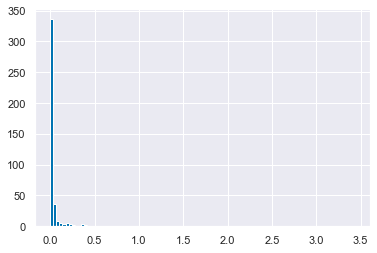

In [378]:
dist[dist>0].hist(bins=100)

In [319]:
(dist==0).sum()

5994

In [ ]:
########################################

# build a model *over multiple ges*

In [393]:
df_simp

,RejectedVote17,RejectedVote15,Electorate05,c11Population,c11PopulationDensity,c11Male,c11Female,c11Households,c11Communal,c11Age0to4,...,ldPriorities_noneW2_Yes,ldPriorities_schoolW2_Yes,RV2W2_factory worker,ldPriorities_crimeW2_Yes,achieveReduceImmigGrnW12_Yes,scotReferendumIntentionW12_Will vote 'Yes',dv1ClassExpW2_Simmons,successReduceInequalityConW12_Yes,bestPMW12_Jeremy Corbyn,successReduceInequalityUKIPW12_Yes
0,57,57,51080,66133,3.751395,48.766879,51.233121,99.287799,0.712201,5.511621,...,0.020246,0.016478,0.014123,0.000000,0.0,0.04293,0.020923,0.000000,0.186898,0.0
1,78,59,43976,56415,0.935424,48.334663,51.665337,97.594611,2.405389,4.956129,...,0.025153,0.029798,0.020295,0.000000,0.0,0.00000,0.000000,0.000000,0.117855,0.0
6,102,114,65971,103922,19.614660,49.898963,50.101037,98.047574,1.952426,7.038933,...,0.000000,0.000000,0.043844,0.000000,0.0,0.00000,0.000000,0.020746,0.063786,0.0
7,87,105,58262,76974,17.483482,48.929509,51.070491,99.425780,0.574220,5.186167,...,0.000000,0.000000,0.091969,0.000000,0.0,0.00000,0.000000,0.000000,0.144806,0.0
8,132,158,63969,96591,18.709288,48.906213,51.093787,99.355012,0.644988,6.305971,...,0.000000,0.000000,0.078495,0.000000,0.0,0.00000,0.050132,0.050262,0.034484,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,94,163,79306,106783,2.662853,49.362726,50.637274,97.991253,2.008747,5.811787,...,0.000000,0.000000,0.072050,0.000000,0.0,0.00000,0.063677,0.000000,0.059236,0.0
628,40,67,52512,69751,0.980694,49.137647,50.862353,98.838726,1.161274,5.559777,...,0.000000,0.000000,0.000000,0.000000,0.0,0.00000,0.000000,0.000000,0.043307,0.0
629,213,224,65817,104359,44.501633,49.314386,50.685614,97.369657,2.630343,5.827001,...,0.032875,0.014546,0.018100,0.014546,0.0,0.00000,0.016912,0.000000,0.073410,0.0
630,146,154,71464,93692,3.770519,47.805576,52.194424,94.755155,5.244845,4.905435,...,0.016708,0.065959,0.017185,0.065959,0.0,0.00000,0.018154,0.000000,0.157807,0.0


In [444]:
%%time
# var_stub = "Auth_Right17_elec"
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
# df_simp[var_stub] = BES_census_data[var_stub]

# BES_agg_cols = BES_constituency_aggregates.drop(search(BES_constituency_aggregates,"|".join(["winConstituency","profile_past","ashcroft","partyContact",
#                                                        "partyId","localElection","localTurnout","^map",
#                                                        "generalElectionVote","euroElectionVote",
#                                                        "^prefer[^M]","ptv"])).index,axis=1).columns
# df_simp[BES_agg_cols] = BES_constituency_aggregates[BES_agg_cols].values

# df_simp.loc[BES_census_data["Country"]!="Scotland",nomis_dump.columns] = nomis_dump.values

df_simp = df_simp[geomask]


Wall time: 39.7 ms


In [446]:
df_simp = df_simp.loc[BES_census_data[["Auth_Right10_elec","Auth_Right15_elec"]][geomask].reset_index().melt(id_vars='index')["index"]]

temp = BES_census_data[["Con10_elec","Con15_elec"]][geomask].melt(var_name="GE",value_name="Voteshare")
temp["GE"] = temp["GE"].replace({"Con10_elec":"10","Con17_elec":"17"}).astype('category')
temp = pd.get_dummies(temp)
df_simp[temp.columns] = temp

# temp["variable"].value_counts()

In [448]:
# df_simp["Voteshare"].value_counts()

In [449]:
var_stub = "Voteshare"

MSE: 38.51, MAE: 3.02, EV: 0.65, R2: 0.65


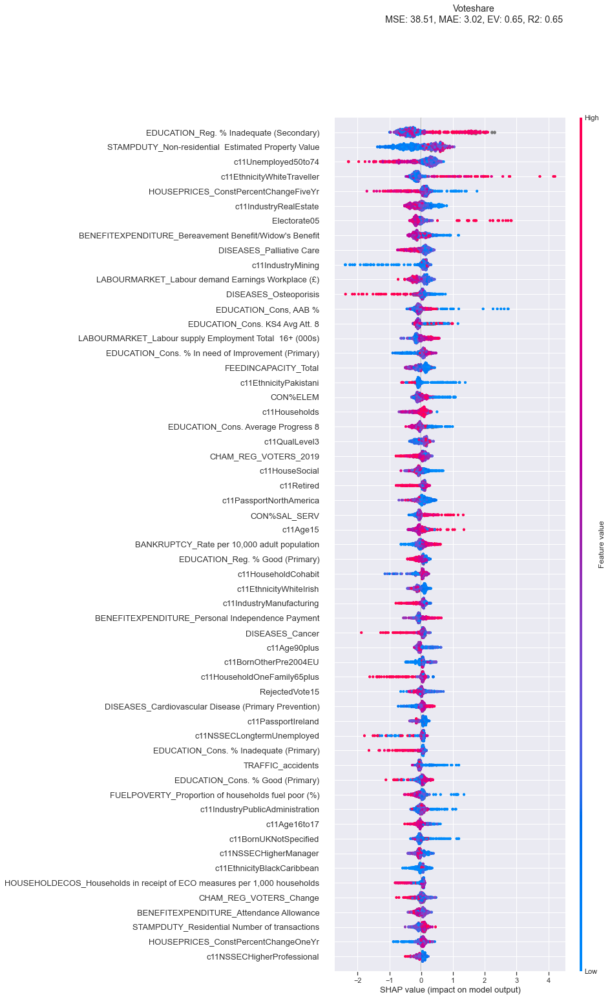

Wall time: 10.4 s


In [450]:
%%time
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = var_stub
dependence_plots = False

alg = get_xgboost_alg(classification_problem=False)
title = var_stub

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

(139,) (1144, 469)
0.0019504731384732577 0.02975140363308511 0.9999818852577572 0.9999818844438916


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.033
Model:                            OLS   Adj. R-squared:                  0.023
Method:                 Least Squares   F-statistic:                     3.490
Date:                Sat, 29 Jan 2022   Prob (F-statistic):           8.12e-05
Time:                        20:43:47   Log-Likelihood:                -4280.6
No. Observations:                1144   AIC:                             8585.
Df Residuals:                    1132   BIC:                             8646.
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
==========================================================================================================================
                                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------------
const                                                     23.0929      0.942     24.517      0.000      21.245      24.941
Comp. 0 (c11BornWales)                                     0.9726      0.304      3.202      0.001       0.377       1.569
Comp. 1 (c11AgeMean)                                       0.3402      0.304      1.119      0.263      -0.256       0.937
Comp. 2 (c11NSSECHigherProfessional)                      -0.0395      0.304     -0.130      0.897      -0.636       0.557
Comp. 3 (c11HouseholdMarriedDependents)                   -0.5338      0.306     -1.747      0.081      -1.133       0.066
Comp. 4 (c11HouseholdCohabit)                              1.1193      0.306      3.661      0.000       0.519       1.719
Comp. 5 (STAMPDUTY_Residential Number of transactions)     0.1896      0.307      0.617      0.538      -0.414       0.793
Comp. 6 (FUELPOVERTY_Estimated number of households)       0.4489      0.308      1.456      0.146      -0.156       1.054
Comp. 7 (c11Households)                                   -0.5515      0.309     -1.785      0.074      -1.158       0.055
Comp. 8 (c11HealthMean)                                   -0.2881      0.312     -0.923      0.356      -0.901       0.325
Comp. 9 (c11EthnicityPakistani)                            0.0575      0.317      0.181      0.856      -0.564       0.679
GE_10                                                      1.6382      0.996      1.644      0.100      -0.317       3.593
==============================================================================
Omnibus:                      236.828   Durbin-Watson:                   1.591
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               50.547
Skew:                          -0.143   Prob(JB):                     1.06e-11
Kurtosis:                       2.011   Cond. No.                         6.06
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

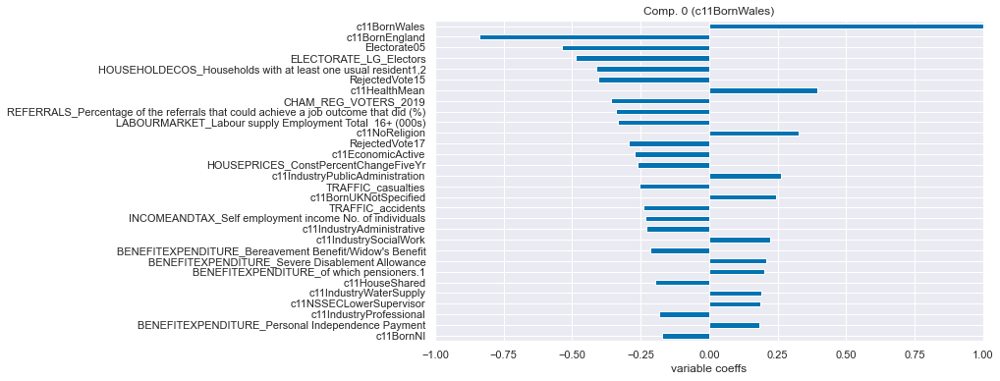

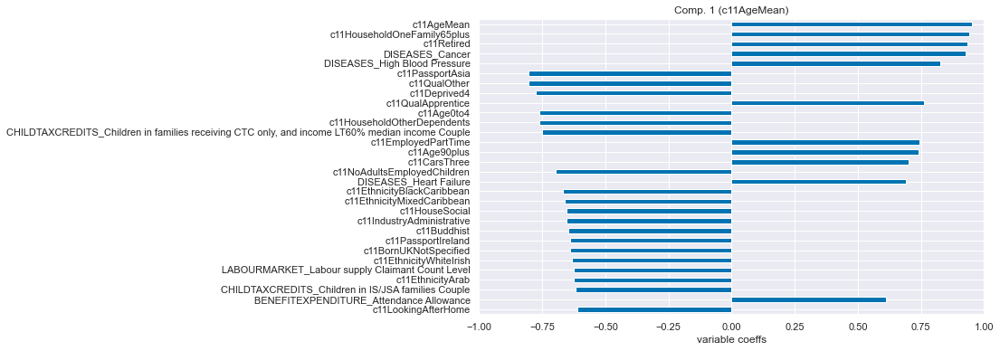

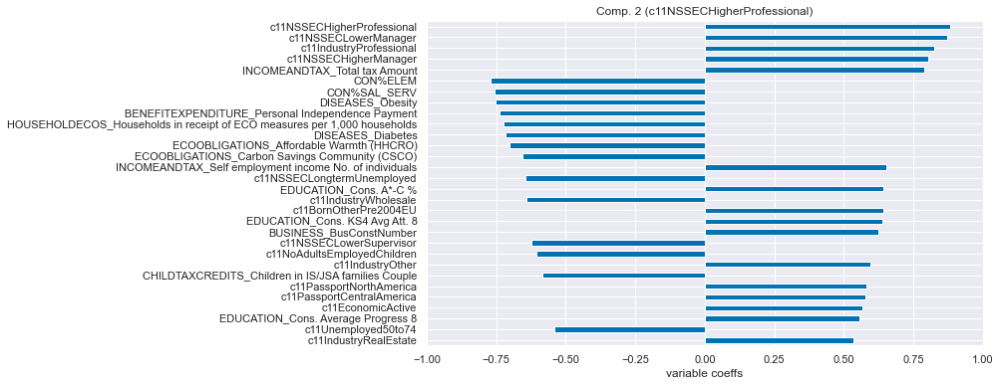

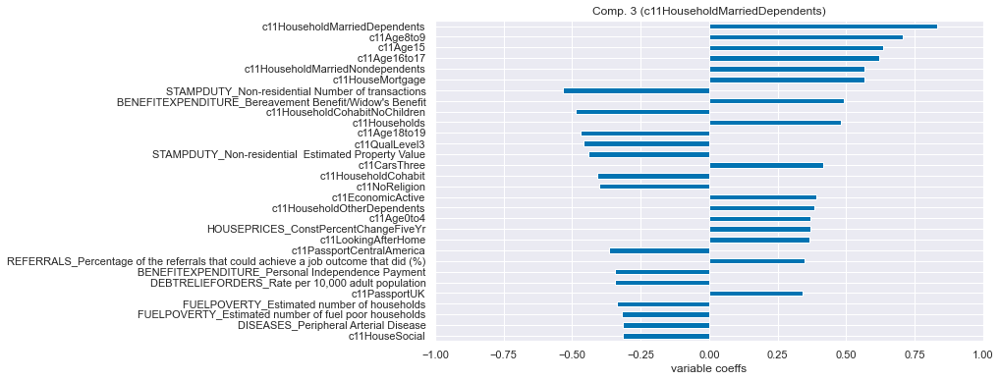

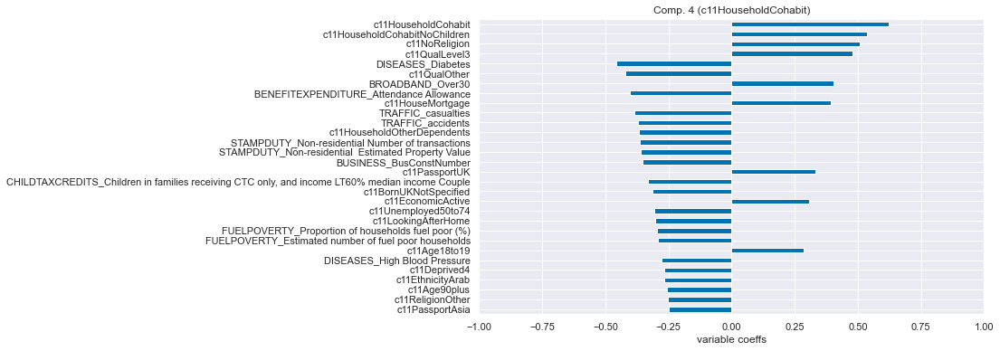

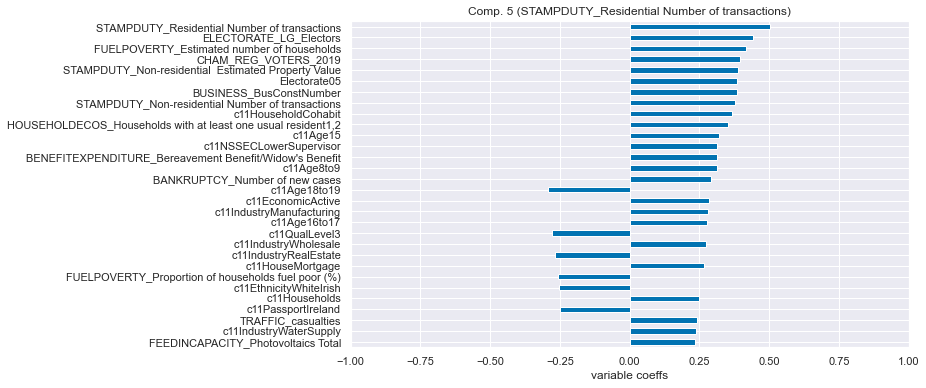

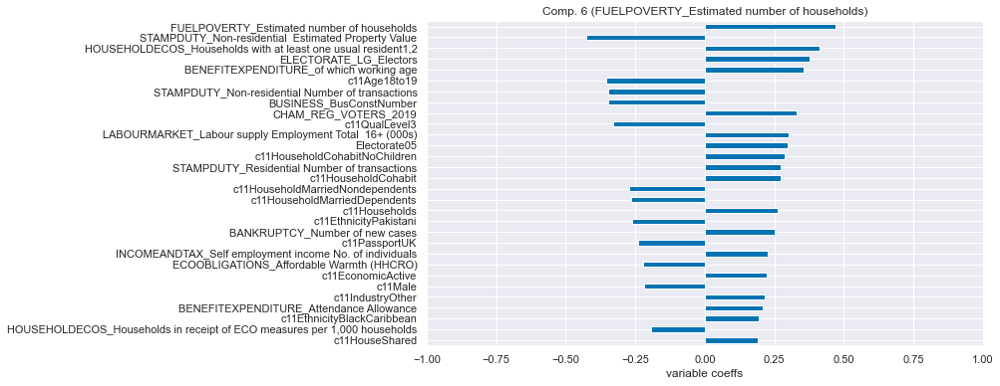

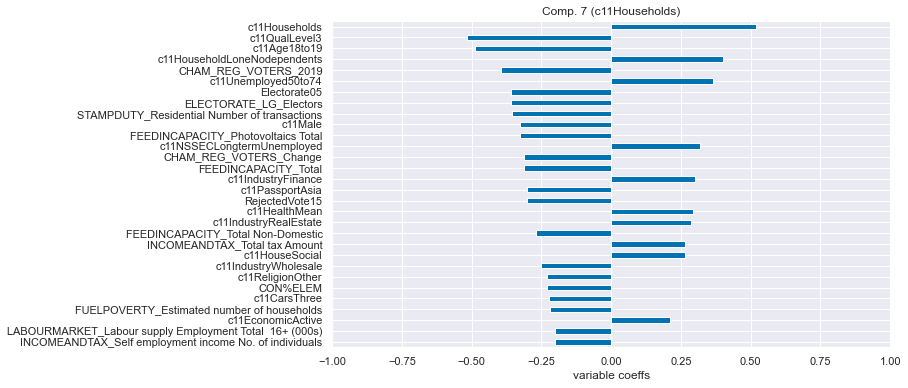

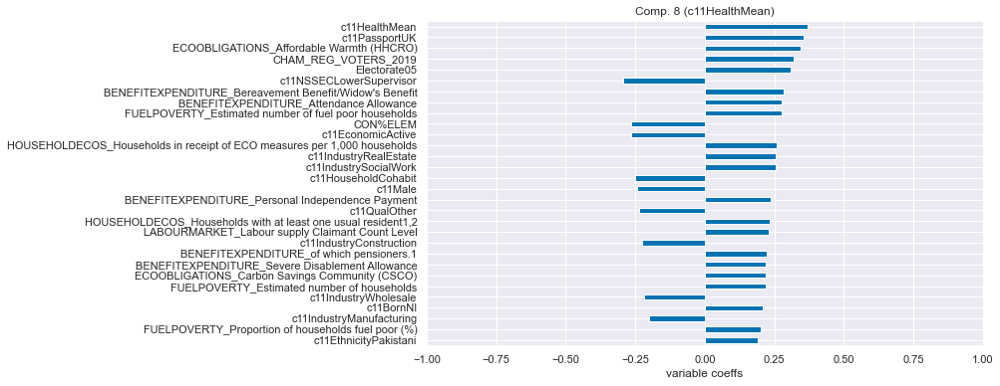

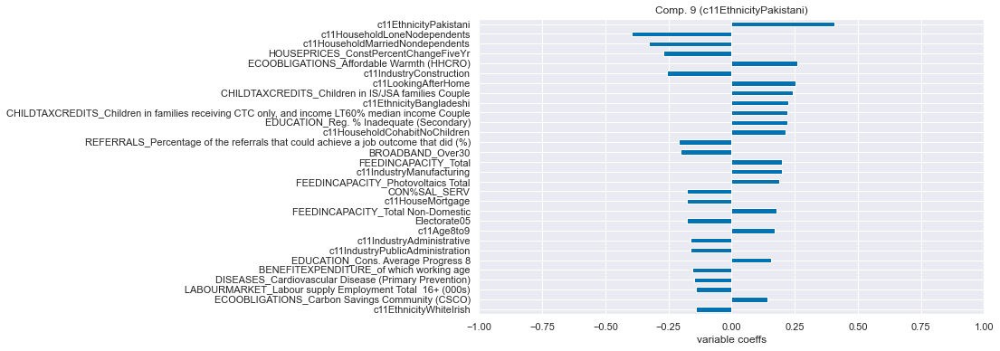

In [452]:
threshold = 0.05

predictions = alg.predict(df_simp.drop(var_stub,axis=1))
MSE = mean_squared_error(df_simp[var_stub], predictions)
MAE = mean_absolute_error(df_simp[var_stub], predictions)
EV = explained_variance_score(df_simp[var_stub], predictions)
R2 = r2_score(df_simp[var_stub], predictions)

dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
print( train_columns[dist[dist>=threshold].index].shape,df_simp.shape )
print(MSE,MAE,EV,R2)

selected_features = train_columns[dist[dist>=threshold].index]
selected_features = [x for x in selected_features if x not in ["GE_10","GE_15"]]

df = df_simp[train_columns[dist[dist>threshold].index]][geomask]
df = df.fillna(df.mean())

BES_decomp, comp_labels, comp_dict = dim_red(df, n_components=n_comp,
                                               red_type="Factor Analysis",show_first_x_comps=14,display_comp=True)
n_components = min(n_comp,BES_decomp.shape[1])
BES_decomp.columns = list(comp_labels.values())
BES_decomp["GE_10"] = df_simp["GE_10"]

Y = df_simp[var_stub]
X = BES_decomp.loc[:,BES_decomp.columns[0:n_components+1]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

In [ ]:
### oof!
# how about doing it manually for Con15 and Con17 and looking at the two models?

In [458]:
%%time
# var_stub = "Auth_Right17_elec"
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
# df_simp[var_stub] = BES_census_data[var_stub]

# BES_agg_cols = BES_constituency_aggregates.drop(search(BES_constituency_aggregates,"|".join(["winConstituency","profile_past","ashcroft","partyContact",
#                                                        "partyId","localElection","localTurnout","^map",
#                                                        "generalElectionVote","euroElectionVote",
#                                                        "^prefer[^M]","ptv"])).index,axis=1).columns
# df_simp[BES_agg_cols] = BES_constituency_aggregates[BES_agg_cols].values

# df_simp.loc[BES_census_data["Country"]!="Scotland",nomis_dump.columns] = nomis_dump.values

df_simp = df_simp[geomask]


Wall time: 37.7 ms


In [464]:
specific_vars = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside",
                 "speakWelsh",
                ]
var_stub = "Con17_elec"
Y = BES_census_data[var_stub][geomask]
X = df_simp[specific_vars]
# BES_decomp.loc[:,BES_decomp.columns[0:n_components+1]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             Con17_elec   R-squared:                       0.887
Model:                            OLS   Adj. R-squared:                  0.885
Method:                 Least Squares   F-statistic:                     631.7
Date:                Sun, 30 Jan 2022   Prob (F-statistic):          3.76e-262
Time:                        13:09:07   Log-Likelihood:                -1571.1
No. Observations:                 572   AIC:                             3158.
Df Residuals:                     564   BIC:                             3193.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              54.5798      3.325     16.417      0.000      48.050      61.110
c11Deprived3       -3.3325      0.127    -26.244      0.000      -3.582      -3.083
c11QualLevel4      -0.6828      0.040    -17.284      0.000      -0.760      -0.605
c11Age60to64        0.1860      0.209      0.890      0.374      -0.225       0.597
CON%MAN_DIR_SEN     1.8239      0.140     13.063      0.000       1.550       2.098
CON%SAL_SERV       -0.9815      0.163     -6.012      0.000      -1.302      -0.661
Merseyside         -5.0367      1.039     -4.847      0.000      -7.078      -2.996
speakWelsh        -20.4544      2.583     -7.918      0.000     -25.528     -15.380
==============================================================================
Omnibus:                       55.850   Durbin-Watson:                   1.781
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               84.060
Skew:                          -0.685   Prob(JB):                     5.58e-19
Kurtosis:                       4.285   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [465]:
specific_vars = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside",
                 "speakWelsh",
                ]
var_stub = "Con15_elec"
Y = BES_census_data[var_stub][geomask]
X = df_simp[specific_vars]
# BES_decomp.loc[:,BES_decomp.columns[0:n_components+1]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             Con15_elec   R-squared:                       0.841
Model:                            OLS   Adj. R-squared:                  0.839
Method:                 Least Squares   F-statistic:                     427.3
Date:                Sun, 30 Jan 2022   Prob (F-statistic):          8.73e-221
Time:                        13:09:18   Log-Likelihood:                -1663.1
No. Observations:                 572   AIC:                             3342.
Df Residuals:                     564   BIC:                             3377.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              45.1028      3.905     11.550      0.000      37.433      52.773
c11Deprived3       -3.2424      0.149    -21.739      0.000      -3.535      -2.949
c11QualLevel4      -0.4527      0.046     -9.757      0.000      -0.544      -0.362
c11Age60to64       -0.7969      0.246     -3.245      0.001      -1.279      -0.314
CON%MAN_DIR_SEN     2.0662      0.164     12.599      0.000       1.744       2.388
CON%SAL_SERV       -0.7896      0.192     -4.118      0.000      -1.166      -0.413
Merseyside         -2.3658      1.221     -1.938      0.053      -4.763       0.032
speakWelsh        -16.6951      3.034     -5.502      0.000     -22.655     -10.735
==============================================================================
Omnibus:                       80.274   Durbin-Watson:                   1.839
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              146.962
Skew:                          -0.837   Prob(JB):                     1.22e-32
Kurtosis:                       4.834   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

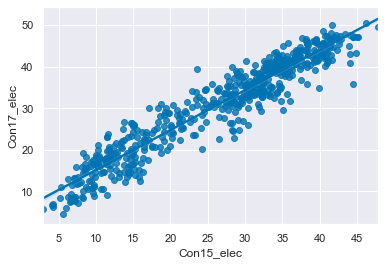

In [467]:
sns.regplot(BES_census_data["Con15_elec"][geomask],BES_census_data["Con17_elec"][geomask])

In [470]:
BES_census_data["Con15_elec"][geomask].corr(BES_census_data["Con17_elec"][geomask])

0.954129860141082

In [472]:
df_simp_orig = df_simp.copy()
df_simp_15 = df_simp.copy()
df_simp_15["Con%"] = BES_census_data["Con15_elec"][geomask]
df_simp_15["GE15"] = 1

df_simp_17 = df_simp.copy()
df_simp_17["Con%"] = BES_census_data["Con17_elec"][geomask]
df_simp_17["GE15"] = 0

In [474]:
df_simp = df_simp_15.append(df_simp_17)

In [475]:
specific_vars = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside",
                 "speakWelsh",
                ]
var_stub = "Con%"
Y = df_simp[var_stub]
X = df_simp[specific_vars]
# BES_decomp.loc[:,BES_decomp.columns[0:n_components+1]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   Con%   R-squared:                       0.816
Model:                            OLS   Adj. R-squared:                  0.815
Method:                 Least Squares   F-statistic:                     720.9
Date:                Sun, 30 Jan 2022   Prob (F-statistic):               0.00
Time:                        13:20:28   Log-Likelihood:                -3438.0
No. Observations:                1144   AIC:                             6892.
Df Residuals:                    1136   BIC:                             6932.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              49.8413      3.034     16.428      0.000      43.888      55.794
c11Deprived3       -3.2875      0.116    -28.369      0.000      -3.515      -3.060
c11QualLevel4      -0.5677      0.036    -15.749      0.000      -0.638      -0.497
c11Age60to64       -0.3054      0.191     -1.601      0.110      -0.680       0.069
CON%MAN_DIR_SEN     1.9450      0.127     15.265      0.000       1.695       2.195
CON%SAL_SERV       -0.8856      0.149     -5.944      0.000      -1.178      -0.593
Merseyside         -3.7012      0.948     -3.903      0.000      -5.562      -1.841
speakWelsh        -18.5748      2.357     -7.879      0.000     -23.200     -13.949
==============================================================================
Omnibus:                       90.811   Durbin-Watson:                   1.425
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              128.017
Skew:                          -0.633   Prob(JB):                     1.59e-28
Kurtosis:                       4.041   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [476]:
specific_vars = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside",
                 "speakWelsh","GE15",
                ]
var_stub = "Con%"
Y = df_simp[var_stub]
X = df_simp[specific_vars]
# BES_decomp.loc[:,BES_decomp.columns[0:n_components+1]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   Con%   R-squared:                       0.856
Model:                            OLS   Adj. R-squared:                  0.855
Method:                 Least Squares   F-statistic:                     841.7
Date:                Sun, 30 Jan 2022   Prob (F-statistic):               0.00
Time:                        13:21:36   Log-Likelihood:                -3299.5
No. Observations:                1144   AIC:                             6617.
Df Residuals:                    1135   BIC:                             6662.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              52.1067      2.692     19.353      0.000      46.824      57.389
c11Deprived3       -3.2875      0.103    -32.005      0.000      -3.489      -3.086
c11QualLevel4      -0.5677      0.032    -17.768      0.000      -0.630      -0.505
c11Age60to64       -0.3054      0.169     -1.806      0.071      -0.637       0.026
CON%MAN_DIR_SEN     1.9450      0.113     17.221      0.000       1.723       2.167
CON%SAL_SERV       -0.8856      0.132     -6.706      0.000      -1.145      -0.626
Merseyside         -3.7012      0.841     -4.403      0.000      -5.350      -2.052
speakWelsh        -18.5748      2.090     -8.889      0.000     -22.675     -14.475
GE15               -4.5307      0.257    -17.631      0.000      -5.035      -4.026
==============================================================================
Omnibus:                      113.550   Durbin-Watson:                   1.813
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              189.289
Skew:                          -0.684   Prob(JB):                     7.88e-42
Kurtosis:                       4.449   Cond. No.                         676.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
const	54.5798	3.325	16.417	0.000	48.050	61.110
c11Deprived3	-3.3325	0.127	-26.244	0.000	-3.582	-3.083
c11QualLevel4	-0.6828	0.040	-17.284	0.000	-0.760	-0.605
c11Age60to64	0.1860	0.209	0.890	0.374	-0.225	0.597
CON%MAN_DIR_SEN	1.8239	0.140	13.063	0.000	1.550	2.098
CON%SAL_SERV	-0.9815	0.163	-6.012	0.000	-1.302	-0.661
Merseyside	-5.0367	1.039	-4.847	0.000	-7.078	-2.996
speakWelsh	-20.4544	2.583	-7.918	0.000	-25.528	-15.380

In [621]:
%%time
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
df_simp = df_simp[geomask]


Wall time: 82.3 ms


In [532]:
base = "Auth_Right"
year_list = ["05","10","15","17","19"]
var_set = [base+x+"_elec" for x in year_list]

df_simp = df_simp.loc[BES_census_data[var_set][geomask].reset_index().melt(id_vars='index')["index"]]
temp = BES_census_data[var_set][geomask].melt(var_name="GE",value_name="Voteshare")
temp["GE"] = temp["GE"].astype('category')
temp = pd.get_dummies(temp)
df_simp[["Voteshare"]+year_list] = temp.values
df_simp=df_simp.reset_index().drop("index",axis=1)

In [530]:
# df_simp

In [535]:
# df_simp

In [536]:
specific_vars = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside",
                 "speakWelsh",]
specific_vars = specific_vars+year_list[1:]
var_stub = "Voteshare"
Y = df_simp[var_stub]
X = df_simp[specific_vars]
# BES_decomp.loc[:,BES_decomp.columns[0:n_components+1]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.853
Model:                            OLS   Adj. R-squared:                  0.853
Method:                 Least Squares   F-statistic:                     1504.
Date:                Sun, 30 Jan 2022   Prob (F-statistic):               0.00
Time:                        21:42:47   Log-Likelihood:                -8337.9
No. Observations:                2860   AIC:                         1.670e+04
Df Residuals:                    2848   BIC:                         1.677e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              48.2884      1.759     27.445      0.000      44.838      51.738
c11Deprived3       -3.1000      0.067    -46.340      0.000      -3.231      -2.969
c11QualLevel4      -0.7515      0.021    -36.111      0.000      -0.792      -0.711
c11Age60to64       -0.3121      0.110     -2.833      0.005      -0.528      -0.096
CON%MAN_DIR_SEN     1.9819      0.074     26.945      0.000       1.838       2.126
CON%SAL_SERV       -0.9609      0.086    -11.173      0.000      -1.130      -0.792
Merseyside         -4.5365      0.547     -8.287      0.000      -5.610      -3.463
speakWelsh        -19.0377      1.361    -13.989      0.000     -21.706     -16.369
10                  6.0817      0.265     22.983      0.000       5.563       6.601
15                 12.8758      0.265     48.658      0.000      12.357      13.395
17                  9.5070      0.265     35.927      0.000       8.988      10.026
19                 10.2017      0.265     38.553      0.000       9.683      10.721
==============================================================================
Omnibus:                      309.351   Durbin-Watson:                   1.826
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              735.855
Skew:                          -0.635   Prob(JB):                    1.63e-160
Kurtosis:                       5.136   Cond. No.                         678.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
### run through reasonable combinations???
# store R2(results?) as a quick
## No - use the pre-existing code, the point is to auto-find good models covering given pairs of years/coalitions

# all 10 adjacent combos
## 05-10,10-15,15-17,17-19,05-10-15,10-15-17,15-17-19,05-10-15-17,10-15-17-19,05-10-15-17-19

## Con,Auth-Right,Lab,Lib-Left

In [580]:
res_df_2 = pd.DataFrame()

In [617]:
# %%time

country = "Wales"
geomask = (BES_census_data["Country"]==country)&(BES_census_data["Winner17"]!="Speaker")
df_simp_base = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
df_simp_base = df_simp_base[geomask]
# df_simp_base = pd.get_dummies(BES_census_data.drop(drop_cols+['Con17','LL17_elec', 'G-L-L17_elec','G-L17_elec',
#                                                              "LL15_elec","LL10_elec","LL05_elec",
#                                                              "G-L15_elec","G-L10_elec","G-L05_elec"],axis=1))
# df_simp[var_stub] = BES_census_data[var_stub][geomask].values
# var_stub = "Con17_elec"

# country_dict = {"England":["England"],"Wales":["Wales"],"Scotland":["Scotland"],"England&Wales":["England","Wales"],
#                "Scotland&Wales":["Scotland","Wales"],"England&Scotland":["England","Scotland"],
#                 "Britain":["England","Scotland","Wales"]} #7

# country_dict = {'The Norf': ['North East','North West','Yorkshire and The Humber'],
#  'Middle Earth': ['East Midlands','West Midlands'],
#  'Great Sarfeast': ['South East','London'],
#  'Southlands': ['East of England','London','South East','South West'],
# }

target_pol_var_list = ["Lab","Lib_Left","PC"]
# target_pol_var_list = target_pol_var_list[:1]
year_combo_list = [["05","10"],["10","15"],["15","17"],["17","19"],["05","10","15"],["10","15","17"],
                   ["15","17","19"],["05","10","15","17"],["10","15","17","19"],["05","10","15","17","19"]]
    #"Con05_elec","Con10_elec","Con15_elec","Con19_elec"]
# ["Con17_elec","Auth_Right17_elec","Lab17_elec","Lib_Left17_elec","LD17_elec",
#                        'DNV17_elec','LL17_elec','G-L-L17_elec']
       
# year_combo_list = year_combo_list[:1]
    
n_comp=10
threshold=.1
repeat_no =10



# for n_comp in [5,10]:
# for threshold in [0,.1,.2,.3,.4,.5,.6,.7]:
for year_combo in year_combo_list:
#     country = country_dict[country_label]
    
    for pol_var in target_pol_var_list:
        print(year_combo,pol_var)
        var_set = [pol_var+x+"_elec" for x in year_combo]
        df_simp = df_simp_base.loc[BES_census_data[var_set][geomask].reset_index().melt(id_vars='index')["index"]].copy()
        temp = BES_census_data[var_set][geomask].melt(var_name="GE",value_name="Voteshare")
        temp["GE"] = temp["GE"].astype('category')
        temp = pd.get_dummies(temp)
        df_simp[["Voteshare"]+year_combo] = temp.values
        df_simp=df_simp.reset_index().drop("index",axis=1)        
        
        
#         geomask = (BES_census_data["Region"].isin(country))&(BES_census_data["Winner17"]!="Speaker")
#         df_simp = df_simp_base[geomask].copy()

#         df_simp[var_stub] = BES_census_data[geomask][var_stub]
        var_stub = "Voteshare"


#         print(var_stub)
        #,0.01,.02,.05,.1
        for repeat in range(repeat_no):
            start = time.time()

            Treatment = var_stub

            var_list = [var_stub]
            var_stub_list = [var_stub,]
            mask = df_simp[var_stub].notnull()
            wt_cols = []
            min_features = 30
            colname = var_stub
            dependence_plots = False

            alg = get_xgboost_alg(classification_problem=False)
            alg.random_state = randint(0, 1000)
            # alg.n_estimators=1000
            title = var_stub

            (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
                xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
                        var_list=var_list,var_stub_list=var_stub_list,
                        use_specific_weights=None,
                        min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                        skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                        title = title,print_shap_chart=False,minimum_sample=28)

#             predictions = alg.predict(df_simp.drop(var_stub,axis=1))
#             MSE = mean_squared_error(df_simp[var_stub], predictions)
#             MAE = mean_absolute_error(df_simp[var_stub], predictions)
#             EV = explained_variance_score(df_simp[var_stub], predictions)
#             R2 = r2_score(df_simp[var_stub], predictions)

            dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
            selected_features = train_columns[dist[dist>=threshold].index]
            print( selected_features.shape,df_simp.shape )
            # drop year combo variables
            selected_features = [x for x in selected_features if x not in year_combo]
            
        

            df = df_simp[selected_features]#[geomask]
            df = df.fillna(df.mean())

            BES_decomp = dim_red(df, n_components=n_comp,
                                                           red_type="Factor Analysis",show_first_x_comps=14,display_comp=False)
            n_components = min(n_comp,BES_decomp.shape[1])
            Y = df_simp[var_stub]
            year_df = df_simp[year_combo[1:]]
            year_df.columns = "GE"+year_df.columns
            X = pd.concat([BES_decomp.loc[:,0:n_components],year_df],axis=1)
            X = sm.add_constant(X)
            model = sm.OLS(Y,X)
            results = model.fit()
#             display(results.summary())

            ind = res_df_2.index.max()
            if pd.isnull(ind):
                ind = 0
            else:
                ind = ind+1
            end = time.time()
            res_df_2.loc[ind,["duration","n_components","n_components_act",
                                "variables","year_combo","pol_var",
                                "threshold","repeats","results","country"]] = [end-start,n_comp,n_components,
                                                                                                           df.columns,
                                                                                                    "|".join(year_combo),pol_var,
                                                                                                    threshold,repeat,results,country]
            
            
res_df_2["rsquared"] = res_df_2["results"].apply(lambda x: x.rsquared)            

['05', '10'] Lab
MSE: 13.04, MAE: 2.58, EV: 0.77, R2: 0.77
(29,) (80, 469)
MSE: 11.97, MAE: 2.50, EV: 0.79, R2: 0.79
(27,) (80, 469)
MSE: 12.87, MAE: 2.72, EV: 0.77, R2: 0.77
(26,) (80, 469)
MSE: 12.52, MAE: 2.53, EV: 0.78, R2: 0.78
(23,) (80, 469)
MSE: 12.31, MAE: 2.46, EV: 0.78, R2: 0.78
(24,) (80, 469)
MSE: 11.44, MAE: 2.44, EV: 0.80, R2: 0.80
(28,) (80, 469)
MSE: 12.65, MAE: 2.61, EV: 0.78, R2: 0.78
(26,) (80, 469)
MSE: 12.96, MAE: 2.61, EV: 0.77, R2: 0.77
(26,) (80, 469)
MSE: 12.64, MAE: 2.54, EV: 0.78, R2: 0.78
(31,) (80, 469)
MSE: 12.84, MAE: 2.63, EV: 0.77, R2: 0.77
(27,) (80, 469)
['05', '10'] Lib_Left
MSE: 21.40, MAE: 3.69, EV: 0.42, R2: 0.38
(26,) (80, 469)
MSE: 23.54, MAE: 3.79, EV: 0.36, R2: 0.32
(24,) (80, 469)
MSE: 21.42, MAE: 3.61, EV: 0.42, R2: 0.38
(19,) (80, 469)
MSE: 18.23, MAE: 3.44, EV: 0.51, R2: 0.47
(24,) (80, 469)
MSE: 20.35, MAE: 3.44, EV: 0.45, R2: 0.41
(29,) (80, 469)
MSE: 21.69, MAE: 3.64, EV: 0.40, R2: 0.37
(30,) (80, 469)
MSE: 19.81, MAE: 3.44, EV: 0.48, 

(24,) (120, 470)
MSE: 16.78, MAE: 3.45, EV: 0.66, R2: 0.66
(18,) (120, 470)
MSE: 14.98, MAE: 3.26, EV: 0.70, R2: 0.70
(24,) (120, 470)
['05', '10', '15'] PC
MSE: 3.81, MAE: 1.52, EV: 0.93, R2: 0.93
(15,) (120, 470)
MSE: 4.13, MAE: 1.56, EV: 0.92, R2: 0.92
(16,) (120, 470)
MSE: 4.13, MAE: 1.55, EV: 0.92, R2: 0.92
(17,) (120, 470)
MSE: 3.95, MAE: 1.56, EV: 0.93, R2: 0.93
(16,) (120, 470)
MSE: 3.98, MAE: 1.51, EV: 0.93, R2: 0.93
(19,) (120, 470)
MSE: 3.93, MAE: 1.53, EV: 0.93, R2: 0.93
(16,) (120, 470)
MSE: 3.98, MAE: 1.53, EV: 0.93, R2: 0.93
(17,) (120, 470)
MSE: 4.10, MAE: 1.53, EV: 0.92, R2: 0.92
(21,) (120, 470)
MSE: 4.48, MAE: 1.65, EV: 0.92, R2: 0.92
(20,) (120, 470)
MSE: 4.23, MAE: 1.58, EV: 0.92, R2: 0.92
(13,) (120, 470)
['10', '15', '17'] Lab
MSE: 6.43, MAE: 1.87, EV: 0.91, R2: 0.91
(24,) (120, 470)
MSE: 5.65, MAE: 1.78, EV: 0.92, R2: 0.92
(21,) (120, 470)
MSE: 6.42, MAE: 1.90, EV: 0.91, R2: 0.91
(20,) (120, 470)
MSE: 5.98, MAE: 1.80, EV: 0.91, R2: 0.91
(22,) (120, 470)
MSE: 6.4

MSE: 10.34, MAE: 2.42, EV: 0.83, R2: 0.83
(21,) (200, 472)
MSE: 9.05, MAE: 2.17, EV: 0.85, R2: 0.85
(25,) (200, 472)
MSE: 10.14, MAE: 2.37, EV: 0.83, R2: 0.83
(23,) (200, 472)
MSE: 8.62, MAE: 2.07, EV: 0.86, R2: 0.86
(26,) (200, 472)
MSE: 9.01, MAE: 2.13, EV: 0.85, R2: 0.85
(23,) (200, 472)
MSE: 8.81, MAE: 2.11, EV: 0.86, R2: 0.85
(20,) (200, 472)
MSE: 10.28, MAE: 2.43, EV: 0.83, R2: 0.83
(20,) (200, 472)
MSE: 9.52, MAE: 2.32, EV: 0.84, R2: 0.84
(20,) (200, 472)
['05', '10', '15', '17', '19'] Lib_Left
MSE: 6.06, MAE: 2.05, EV: 0.87, R2: 0.87
(20,) (200, 472)
MSE: 7.34, MAE: 2.18, EV: 0.84, R2: 0.84
(22,) (200, 472)
MSE: 6.84, MAE: 2.13, EV: 0.85, R2: 0.85
(24,) (200, 472)
MSE: 6.80, MAE: 2.07, EV: 0.85, R2: 0.85
(21,) (200, 472)
MSE: 7.50, MAE: 2.21, EV: 0.84, R2: 0.84
(25,) (200, 472)
MSE: 7.21, MAE: 2.15, EV: 0.84, R2: 0.84
(20,) (200, 472)
MSE: 7.30, MAE: 2.15, EV: 0.84, R2: 0.84
(22,) (200, 472)
MSE: 7.12, MAE: 2.12, EV: 0.84, R2: 0.84
(22,) (200, 472)
MSE: 6.75, MAE: 2.10, EV: 0.8

In [612]:
# search(BES_census_data,"PC")

In [588]:
res_df_2["duration"].sum()

38536.40484833717

In [587]:
res_df_2["duration"].sum()

38536.40484833717

In [596]:
res_df_2.groupby(['pol_var','year_combo'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))

pol_var     year_combo    
Auth_Right  05|10             (0.84, 0.01, N=20)
            05|10|15          (0.86, 0.01, N=20)
            05|10|15|17        (0.86, 0.0, N=20)
            05|10|15|17|19     (0.84, 0.0, N=20)
            10|15              (0.85, 0.0, N=20)
            10|15|17           (0.85, 0.0, N=20)
            10|15|17|19        (0.83, 0.0, N=20)
            15|17             (0.86, 0.01, N=20)
            15|17|19           (0.84, 0.0, N=20)
            17|19             (0.84, 0.01, N=20)
Con         05|10              (0.85, 0.0, N=20)
            05|10|15           (0.86, 0.0, N=10)
            05|10|15|17        (0.86, 0.0, N=10)
            05|10|15|17|19    (0.84, 0.01, N=10)
            10|15              (0.86, 0.0, N=10)
            10|15|17           (0.86, 0.0, N=10)
            10|15|17|19        (0.84, 0.0, N=10)
            15|17              (0.87, 0.0, N=10)
            15|17|19           (0.84, 0.0, N=10)
            17|19             (0.85, 0.01,

In [602]:
res_df_2[res_df_2["country"]=="England"].groupby(['pol_var','year_combo'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))
# res_df_2.groupby(['pol_var','year_combo'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))

pol_var   year_combo    
Lab       05|10             (0.68, 0.01, N=10)
          05|10|15           (0.7, 0.01, N=10)
          05|10|15|17       (0.71, 0.01, N=10)
          05|10|15|17|19     (0.7, 0.01, N=10)
          10|15             (0.75, 0.01, N=10)
          10|15|17           (0.77, 0.0, N=10)
          10|15|17|19       (0.75, 0.01, N=10)
          15|17             (0.78, 0.01, N=10)
          15|17|19          (0.74, 0.01, N=10)
          17|19             (0.72, 0.01, N=10)
Lib_Left  05|10              (0.5, 0.02, N=10)
          05|10|15           (0.6, 0.01, N=10)
          05|10|15|17       (0.61, 0.02, N=10)
          05|10|15|17|19    (0.57, 0.02, N=10)
          10|15             (0.66, 0.02, N=10)
          10|15|17          (0.66, 0.03, N=10)
          10|15|17|19       (0.63, 0.02, N=10)
          15|17             (0.71, 0.03, N=10)
          15|17|19          (0.69, 0.02, N=10)
          17|19             (0.69, 0.01, N=10)
Name: rsquared, dtype: object

In [615]:
res_df_2[res_df_2["country"]=="Scotland"].groupby(['pol_var','year_combo'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))

pol_var   year_combo    
Lab       05|10             (0.75, 0.01, N=10)
          05|10|15          (0.75, 0.01, N=10)
          05|10|15|17       (0.73, 0.01, N=10)
          05|10|15|17|19    (0.75, 0.01, N=10)
          10|15             (0.76, 0.02, N=10)
          10|15|17          (0.72, 0.01, N=10)
          10|15|17|19       (0.74, 0.02, N=10)
          15|17             (0.65, 0.02, N=10)
          15|17|19          (0.67, 0.01, N=10)
          17|19              (0.7, 0.01, N=10)
Lib_Left  05|10             (0.66, 0.03, N=10)
          05|10|15          (0.73, 0.02, N=10)
          05|10|15|17        (0.7, 0.02, N=10)
          05|10|15|17|19    (0.67, 0.02, N=10)
          10|15              (0.7, 0.03, N=10)
          10|15|17          (0.74, 0.02, N=10)
          10|15|17|19       (0.71, 0.02, N=10)
          15|17             (0.77, 0.01, N=10)
          15|17|19          (0.75, 0.01, N=10)
          17|19             (0.73, 0.03, N=10)
SNP       05|10               (nan,

In [609]:
res_df_2[res_df_2["country"]=="Wales"].groupby(['pol_var','year_combo'])["rsquared"].apply(lambda x: (round(x.mean(),2),round(x.std(),2),"N="+str(len(x))))

pol_var   year_combo    
Lab       05|10             (0.75, 0.02, N=10)
          05|10|15          (0.75, 0.02, N=10)
          05|10|15|17       (0.74, 0.01, N=10)
          05|10|15|17|19    (0.74, 0.01, N=10)
          10|15             (0.75, 0.01, N=10)
          10|15|17          (0.72, 0.01, N=10)
          10|15|17|19       (0.74, 0.01, N=10)
          15|17             (0.65, 0.02, N=10)
          15|17|19          (0.66, 0.01, N=10)
          17|19             (0.71, 0.02, N=10)
Lib_Left  05|10             (0.66, 0.03, N=10)
          05|10|15          (0.72, 0.01, N=10)
          05|10|15|17        (0.7, 0.01, N=10)
          05|10|15|17|19    (0.68, 0.02, N=10)
          10|15             (0.69, 0.03, N=10)
          10|15|17          (0.74, 0.02, N=10)
          10|15|17|19       (0.71, 0.02, N=10)
          15|17             (0.77, 0.01, N=10)
          15|17|19          (0.75, 0.01, N=10)
          17|19             (0.72, 0.02, N=10)
Name: rsquared, dtype: object

In [622]:
df_simp

,RejectedVote17,RejectedVote15,Electorate05,c11Population,c11PopulationDensity,c11Male,c11Female,c11Households,c11Communal,c11Age0to4,...,PCPPCrace15_White,PCPPCrace15_BME,UKIPPPCsex15_Male,UKIPPPCsex15_Female,UKIPPPCrace15_White,UKIPPPCrace15_BME,GreenPPCsex15_Male,GreenPPCsex15_Female,GreenPPCrace15_White,GreenPPCrace15_BME
0,57,57,51080,66133,3.751395,48.766879,51.233121,99.287799,0.712201,5.511621,...,1,0,1,0,1,0,1,0,1,0
1,78,59,43976,56415,0.935424,48.334663,51.665337,97.594611,2.405389,4.956129,...,1,0,1,0,1,0,0,1,1,0
6,102,114,65971,103922,19.614660,49.898963,50.101037,98.047574,1.952426,7.038933,...,0,0,1,0,1,0,1,0,1,0
7,87,105,58262,76974,17.483482,48.929509,51.070491,99.425780,0.574220,5.186167,...,0,0,1,0,1,0,1,0,1,0
8,132,158,63969,96591,18.709288,48.906213,51.093787,99.355012,0.644988,6.305971,...,0,0,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,94,163,79306,106783,2.662853,49.362726,50.637274,97.991253,2.008747,5.811787,...,0,0,1,0,1,0,0,1,1,0
628,40,67,52512,69751,0.980694,49.137647,50.862353,98.838726,1.161274,5.559777,...,1,0,1,0,1,0,0,0,0,0
629,213,224,65817,104359,44.501633,49.314386,50.685614,97.369657,2.630343,5.827001,...,0,0,1,0,1,0,1,0,1,0
630,146,154,71464,93692,3.770519,47.805576,52.194424,94.755155,5.244845,4.905435,...,0,0,1,0,1,0,0,1,1,0


In [763]:
# %%time
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
df_simp = df_simp[geomask]


var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
df_simp[var_stub] = BES_census_data[var_stub][geomask]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = "Con17"
dependence_plots = False

alg = get_xgboost_alg(classification_problem=False)
title = "Con17"
print(alg.n_estimators)
# (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
#     xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
#             var_list=var_list,var_stub_list=var_stub_list,
#             use_specific_weights=None,
#             min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
#             skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
#             title = title)



dataset=df_simp[mask].drop(wt_cols,axis=1)
alg=alg
target_var = var_stub

#     if automatic_weights_from_wave_no:
#         wave_no = get_wave_no( target_var )
#         weight_var = num_to_weight[wave_no]    
#         print( target_var, wave_no )

target = create_target(dataset,target_var)
mask   = target.notnull()
#     if optional_mask & automatic_weights_from_wave_no:
#         mask = mask&optional_mask_fn(wave_no)
#     else:
#         mask = mask&optional_mask_fn()
target = target[mask]

#     if sum(mask) < minimum_sample:
#         print("Skipping - sample size beneath minimum: ",minimum_sample)
#         skipping = True
#         if not dont_stop_on_sample_size_err:
#             raise Exception("fgflgf")
#         continue
#     skipping=False

train = create_train(dataset,drop_other_waves,var_stub_list,mask)

#     if subdir is None:
#         output_subfolder = create_subdir(treatment_subfolder,target_var)
#     else:
#         output_subfolder = create_subdir(treatment_subfolder,subdir)

#     if use_specific_weights is not None:
#         sample_weights = use_specific_weights[mask].fillna(use_specific_weights[mask].median())




#     elif automatic_weights_from_wave_no:
#         sample_weights = weights[weight_var][mask]
#         print("missing vals in sample weights: "+ str( sample_weights.isnull().sum() ) )
#         sample_weights = sample_weights.fillna(sample_weights.median())

#     else:
#         sample_weights = None
# #         get_non_overfit_settings( train, target, alg, seed, early_stoppping_fraction, test_size, sample_weights )
# #         # fit to full dataset at non-overfitting level
# #         alg.fit(train, target, verbose = True, sample_weight = sample_weights)        
# #     else:

#     if target.dtype.name == 'category':
#         (ACC,  F1, alg_best_iteration) = get_non_overfit_settings( train, target, alg, seed, early_stoppping_fraction, test_size, eval_metric, verbose = verbose,
#                                   sample_weights=sample_weights )
#         pd.Series([ACC,  F1,  alg_best_iteration],index = ["ACC",  "F1", "alg_best_iteration"]).to_csv(output_subfolder+"scores.csv")


#     else:
sample_weights = None
objective = 'reg:squarederror'
# eval_metric = 'rmse'

seed = 27
test_size = 0.33
minimum_sample = 100
early_stoppping_fraction = .01    
verbose=True
# eval_metric = 'rmse'
# eval_metric=["rmse","rmsle","mae","mape","mphe","logloss","error","auc",
#             "ndcg","map","poisson-nloglik","gamma-nloglik","cox-nloglik","gamma-deviance",
#             ]
eval_metric=["rmsle"]
# (MSE, MAE, EV, R2, alg_best_iteration) = get_non_overfit_settings( train, target, alg, seed,
#                                                                   early_stoppping_fraction, test_size, eval_metric, verbose = verbose,
#                           sample_weights=sample_weights )

stratification = pd.qcut( pd.Series( target ), q=10, duplicates = 'drop', ).cat.codes

X_train, X_test, y_train, y_test = train_test_split( train,
                                                     target, test_size=test_size,
                                                     random_state=seed, stratify=stratification )



eval_set = [(X_train, y_train), (X_test, y_test)]

alg.fit(X_train, y_train, eval_metric=eval_metric, 
        early_stopping_rounds = alg.get_params()['n_estimators']*early_stoppping_fraction,
        eval_set=eval_set, verbose=verbose )        


# make predictions for test data
predictions = alg.predict(X_test)

# evaluate predictions
MSE = mean_squared_error(y_test, predictions)
MAE = mean_absolute_error(y_test, predictions)
EV = explained_variance_score(y_test, predictions)
R2 = r2_score(y_test, predictions)

print("MSE: %.2f, MAE: %.2f, EV: %.2f, R2: %.2f" % (MSE, MAE, EV, R2) )
alg.set_params(n_estimators=alg.best_iteration)   
# return (MSE, MAE, EV, R2, alg.best_iteration)



#         pd.Series([MSE, MAE, EV, R2, alg_best_iteration],index = ["MSE", "MAE", "EV", "R2", "alg_best_iteration"]).to_csv(output_subfolder+"scores.csv")
print((MSE, MAE, EV, R2, alg.best_iteration))
# fit to full dataset at non-overfitting level
print(alg.n_estimators)
# eval_metric=["rmse", "mae"]
alg.fit(X_train, y_train, verbose = verbose, sample_weight = sample_weights,eval_metric=eval_metric,eval_set=eval_set)
xgboost_pred = pd.Series(alg.predict(df_simp[train.columns],iteration_range=(0, alg.best_iteration + 1)),index=df_simp.index)
MSE = mean_squared_error(df_simp[var_stub], xgboost_pred)
MAE = mean_absolute_error(df_simp[var_stub], xgboost_pred)
EV = explained_variance_score(df_simp[var_stub], xgboost_pred)
R2 = r2_score(df_simp[var_stub], xgboost_pred)
print("!!!!!!!!!")
print("MSE: %.2f, MAE: %.2f, EV: %.2f, R2: %.2f" % (MSE, MAE, EV, R2) )    

500
[0]	validation_0-rmsle:2.46917	validation_1-rmsle:2.47543
[1]	validation_0-rmsle:2.03554	validation_1-rmsle:2.04723
[2]	validation_0-rmsle:1.74911	validation_1-rmsle:1.76503
[3]	validation_0-rmsle:1.53776	validation_1-rmsle:1.54742
[4]	validation_0-rmsle:1.37061	validation_1-rmsle:1.38227
[5]	validation_0-rmsle:1.23500	validation_1-rmsle:1.24821
[6]	validation_0-rmsle:1.12019	validation_1-rmsle:1.13392
[7]	validation_0-rmsle:1.02449	validation_1-rmsle:1.03807
[8]	validation_0-rmsle:0.94107	validation_1-rmsle:0.95301
[9]	validation_0-rmsle:0.86818	validation_1-rmsle:0.88125
[10]	validation_0-rmsle:0.80339	validation_1-rmsle:0.81770
[11]	validation_0-rmsle:0.74586	validation_1-rmsle:0.76113
[12]	validation_0-rmsle:0.69359	validation_1-rmsle:0.71022
[13]	validation_0-rmsle:0.64647	validation_1-rmsle:0.66336
[14]	validation_0-rmsle:0.60314	validation_1-rmsle:0.62216
[15]	validation_0-rmsle:0.56355	validation_1-rmsle:0.58366
[16]	validation_0-rmsle:0.52814	validation_1-rmsle:0.54901
[17

[27]	validation_0-rmsle:0.27734	validation_1-rmsle:0.31312
[28]	validation_0-rmsle:0.26308	validation_1-rmsle:0.30071
[29]	validation_0-rmsle:0.24963	validation_1-rmsle:0.28895
[30]	validation_0-rmsle:0.23735	validation_1-rmsle:0.27756
[31]	validation_0-rmsle:0.22562	validation_1-rmsle:0.26841
[32]	validation_0-rmsle:0.21468	validation_1-rmsle:0.25847
[33]	validation_0-rmsle:0.20427	validation_1-rmsle:0.24977
[34]	validation_0-rmsle:0.19453	validation_1-rmsle:0.24198
[35]	validation_0-rmsle:0.18540	validation_1-rmsle:0.23437
[36]	validation_0-rmsle:0.17647	validation_1-rmsle:0.22785
[37]	validation_0-rmsle:0.16841	validation_1-rmsle:0.22229
[38]	validation_0-rmsle:0.16040	validation_1-rmsle:0.21599
[39]	validation_0-rmsle:0.15321	validation_1-rmsle:0.21114
[40]	validation_0-rmsle:0.14628	validation_1-rmsle:0.20677
[41]	validation_0-rmsle:0.14004	validation_1-rmsle:0.20270
[42]	validation_0-rmsle:0.13373	validation_1-rmsle:0.19842
[43]	validation_0-rmsle:0.12800	validation_1-rmsle:0.194

In [767]:
# from xgboost import cv

In [ ]:
# xgb_cv = cv(dtrain=data_dmatrix, params=params, nfold=3,
#                     num_boost_round=50, early_stopping_rounds=10, metrics="auc", as_pandas=True, seed=123)

In [13]:
from sklearn.model_selection import StratifiedKFold,KFold
from sklearn.model_selection import cross_val_score

In [795]:
%%time
alg = get_xgboost_alg(classification_problem=False)
alg.n_estimators = 100

kfold = KFold(n_splits=5)
results = cross_val_score(alg, train, target, cv=kfold,scoring='r2')
# neg_mean_squared_log_error
print("R2: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

R2: 85.26% (1.72%)
Wall time: 2.16 s


In [252]:
%%time
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
df_simp = df_simp[geomask]
df_simp[var_stub] = BES_census_data[var_stub][geomask]

var_stub = "Con17_elec"
var_stub_list = [var_stub,]
# df_simp = BES_census_data[[var_stub]]
# df_simp.loc[BES_census_data["Country"]!="Scotland",nomis_dump.columns] = nomis_dump.values
# df_simp = df_simp[geomask]
# df_simp = df_simp.drop("Con17",axis=1)



# df_simp[var_stub] = BES_census_data[var_stub][geomask]
mask = df_simp[var_stub].notnull()
wt_cols = []


alg = get_xgboost_alg(classification_problem=False)

dataset=df_simp[mask].drop(wt_cols,axis=1)

target_var = var_stub
target = create_target(dataset,target_var)
mask   = target.notnull()
target = target[mask]
train = create_train(dataset,drop_other_waves,var_stub_list,mask)

Wall time: 70 ms


In [130]:
df_simp.shape

(572, 467)

In [253]:
# import packages for hyperparameters tuning
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe

In [288]:
space={ 
        'n_estimators': 100,
#         'tree_method': 'exact',
#         'tree_method': 'exact',
#         'tree_method' : hp.choice('tree_method',[
#             {
#                 'method':'exact',
#             },
#             {
#                 'method':'hist',
#             },           
#         ]),    
    
    
        'booster':'gblinear',
    

#         'n_estimators': hp.loguniform('n_estimators',50, 200),
        'learning_rate': hp.quniform('learning_rate',-3.0, -.2, 0.01),  # powers of 10
#         'min_child_weight' : hp.quniform('min_child_weight', 0, 50, 1),    
#         "max_depth": hp.randint("max_depth",0, 13),
#         "subsample": hp.quniform("subsample",0.15, 0.95, 0.01),
#         "colsample_bytree": hp.quniform("colsample_bytree",0.05, 0.95, 0.01),
#         "colsample_bylevel": hp.quniform("colsample_bylevel",0.05, 0.95, 0.01),      
#         "colsample_bynode": hp.quniform("colsample_bynode",0.05, 0.95, 0.01),   
#         'gamma': hp.uniform('gamma', .1,10),
    
#         'reg_alpha': hp.quniform('reg_alpha', 40,180,1),
        'reg_alpha': hp.quniform('reg_alpha', 0,180,1),
        'reg_lambda': hp.quniform('reg_lambda', 0,180,1),
    
        
        'feature_selector':hp.choice('feature_selector',[
                {
                    'feature':'cyclic',
                    'top_k':None,
                    'updater':hp.choice('updater1',('shotgun','coord_descent')),
                },
                {
                    'feature':'shuffle',
                    'top_k':None,
                    'updater':hp.choice('updater2',('shotgun','coord_descent')),
                },
                {
                    'feature':'random',
                    'top_k':None,
                    'updater':'coord_descent',
                },
                {
                    'feature':'greedy',
                    'top_k':hp.quniform("top_k_dist1",0, 100, 1),
                    'updater':'coord_descent',
                },
                {
                    'feature':'thrifty',  
                    'top_k':hp.quniform("top_k_dist2",0, 100, 1),
                    'updater':'coord_descent',
                },
            
        ]),
#         'sample_type' : hp.choice('sample_type',[
#             {
#                 'type':'uniform',
#             },
#             {
#                 'type':'weighted',
#             },           
#         ]),
#         'normalize_type' : hp.choice('normalize_type',[
#             {
#                 'type':'tree',
#             },
#             {
#                 'type':'forest',
#             },           
#         ]),        
#         'rate_drop': hp.uniform('rate_drop', 0.0,1.0),
#         'one_drop': hp.choice('one_drop',[{'flag':0},{'flag':1}]),
#         'skip_drop': hp.uniform('skip_drop', 0.0,1.0),
    
      }







In [289]:
def objective(space):
    alg = get_xgboost_alg(classification_problem=False)
    top_k = space['feature_selector']['top_k']
    if top_k is not None:
        top_k = int(top_k)
    alg.set_params(
                    n_estimators =space['n_estimators'],
                    booster = space['booster'],
#                     tree_method = space['tree_method']['method'],
#                     tree_method = space['tree_method'],
#                     reg_alpha = 0,        
#                     reg_lambda = 0,      
        
#                     max_depth = int(space['max_depth'])+2,
#                     gamma = space['gamma'],
#                     min_child_weight=space['min_child_weight'],
#                     colsample_bytree=space['colsample_bytree'],
#                     colsample_bylevel=space['colsample_bylevel'],
#                     colsample_bynode=space['colsample_bynode'],
#                     subsample=space['subsample'],
        
                    reg_alpha = space['reg_alpha'],
                    reg_lambda= space['reg_lambda'],
                    learning_rate = 10**space['learning_rate'],
            
                    updater = space['feature_selector']['updater'],
                    feature_selector = space['feature_selector']['feature'],
                    top_k = top_k,
                    max_depth=None,    
                    colsample_bylevel=None,
                    colsample_bynode=None,
                    colsample_bytree=None,
                    gamma=None,
                    min_child_weight=None,
                    refresh_leaf=None,
                    sketch_eps=None,
                    subsample=None,   
                    #### dart
#                     sample_type = space['sample_type']['type'],
#                     normalize_type = space['normalize_type']['type'],
#                     rate_drop = space['rate_drop'],
#                     one_drop = space['one_drop']['flag'],
#                     skip_drop = space['skip_drop'],
  
    )
    
    
# "colsample_bylevel", "colsample_bynode", "colsample_bytree", "gamma", "interaction_constraints", "max_delta_step", "max_depth",
# "min_child_weight", "monotone_constraints", "num_parallel_tree", "refresh_leaf", "sketch_eps", "subsample", "tree_method" 

    kfold = KFold(n_splits=5)
    results = cross_val_score(alg, train, target, cv=kfold,scoring='r2')
    # neg_mean_squared_log_error
#     print(alg)
    print("R2: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))
    print(space)
    return {'loss': -(results.mean()), 'status': STATUS_OK }

In [290]:
%%time
trials = Trials()

best_hyperparams = fmin(fn = objective,
                        space = space,
                        algo = tpe.suggest,
                        max_evals = 100,
                        trials = trials)

# cyclic, shotgun!
# thrifty, shotgun x
# greedy, shotgun x
# random, shotgun x

R2: 54.34% (5.64%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'shuffle', 'top_k': None, 'updater': 'shotgun'}, 'learning_rate': -2.4, 'n_estimators': 100, 'reg_alpha': 71.0, 'reg_lambda': 38.0}
R2: 75.52% (5.15%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'thrifty', 'top_k': 34.0, 'updater': 'coord_descent'}, 'learning_rate': -0.64, 'n_estimators': 100, 'reg_alpha': 10.0, 'reg_lambda': 135.0}
R2: 40.22% (9.22%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'greedy', 'top_k': 92.0, 'updater': 'coord_descent'}, 'learning_rate': -2.74, 'n_estimators': 100, 'reg_alpha': 143.0, 'reg_lambda': 19.0}
R2: 64.46% (4.13%)                                                                

R2: 69.17% (5.24%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'cyclic', 'top_k': None, 'updater': 'shotgun'}, 'learning_rate': -0.91, 'n_estimators': 100, 'reg_alpha': 90.0, 'reg_lambda': 17.0}
R2: 54.82% (6.01%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'shuffle', 'top_k': None, 'updater': 'shotgun'}, 'learning_rate': -2.29, 'n_estimators': 100, 'reg_alpha': 102.0, 'reg_lambda': 101.0}
R2: 21.21% (4.30%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'thrifty', 'top_k': 51.0, 'updater': 'coord_descent'}, 'learning_rate': -1.99, 'n_estimators': 100, 'reg_alpha': 157.0, 'reg_lambda': 71.0}
R2: 71.88% (5.84%)                                                                    

R2: 74.70% (5.81%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'random', 'top_k': None, 'updater': 'coord_descent'}, 'learning_rate': -0.28, 'n_estimators': 100, 'reg_alpha': 27.0, 'reg_lambda': 87.0}
R2: 78.13% (3.99%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'greedy', 'top_k': 70.0, 'updater': 'coord_descent'}, 'learning_rate': -1.0, 'n_estimators': 100, 'reg_alpha': 11.0, 'reg_lambda': 37.0}
R2: 71.27% (5.82%)                                                                                              
{'booster': 'gblinear', 'feature_selector': {'feature': 'cyclic', 'top_k': None, 'updater': 'shotgun'}, 'learning_rate': -0.7000000000000001, 'n_estimators': 100, 'reg_alpha': 52.0, 'reg_lambda': 13.0}
R2: 72.90% (4.89%)                                                      

In [301]:
space = best_hyperparams
# del space['updater1']
space['feature_selector'] = 'cyclic'
space['updater'] ='shotgun'
space['n_estimators'] =100
space['booster'] ='gblinear'

alg = get_xgboost_alg(classification_problem=False)
# top_k = space['feature_selector']['top_k']
# if top_k is not None:
#     top_k = int(top_k)
alg.set_params(
                n_estimators =space['n_estimators'],
                booster = space['booster'],
#                     tree_method = space['tree_method']['method'],
#                     tree_method = space['tree_method'],
#                     reg_alpha = 0,        
#                     reg_lambda = 0,      

#                     max_depth = int(space['max_depth'])+2,
#                     gamma = space['gamma'],
#                     min_child_weight=space['min_child_weight'],
#                     colsample_bytree=space['colsample_bytree'],
#                     colsample_bylevel=space['colsample_bylevel'],
#                     colsample_bynode=space['colsample_bynode'],
#                     subsample=space['subsample'],

                reg_alpha = space['reg_alpha'],
                reg_lambda= space['reg_lambda'],
                learning_rate = 10**space['learning_rate'],

                updater = space['updater'],
                feature_selector = space['feature_selector'],
#                 top_k = top_k,
                max_depth=None,    
                colsample_bylevel=None,
                colsample_bynode=None,
                colsample_bytree=None,
                gamma=None,
                min_child_weight=None,
                refresh_leaf=None,
                sketch_eps=None,
                subsample=None,   
                #### dart
#                     sample_type = space['sample_type']['type'],
#                     normalize_type = space['normalize_type']['type'],
#                     rate_drop = space['rate_drop'],
#                     one_drop = space['one_drop']['flag'],
#                     skip_drop = space['skip_drop'],

)
kfold = KFold(n_splits=5)
results = cross_val_score(alg, train, target, cv=kfold,scoring='r2')
# neg_mean_squared_log_error
print("R2: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

R2: 84.09% (2.48%)


{'feature_selector': 0,
 'learning_rate': -0.81,
 'reg_alpha': 0.0,
 'reg_lambda': 25.0,
 'updater1': 0}

In [258]:
## dart!

gc.collect()
best_hyperparams
# best loss: -0.8821922661283228
# {'colsample_bylevel': 0.39,
#  'colsample_bynode': 0.16,
#  'colsample_bytree': 0.7000000000000001,
#  'gamma': 5.067637151963403,
#  'learning_rate': -0.37,
#  'max_depth': 7,
#  'min_child_weight': 14.0,
#  'normalize_type': 0,
#  'one_drop': 0,
#  'rate_drop': 0.8001854392160361,
#  'reg_alpha': 8.0,
#  'reg_lambda': 15.0,
#  'sample_type': 0,
#  'skip_drop': 0.5294833458745991,
#  'subsample': 0.88,
#  'tree_method': 0}

{'colsample_bylevel': 0.39,
 'colsample_bynode': 0.16,
 'colsample_bytree': 0.7000000000000001,
 'gamma': 5.067637151963403,
 'learning_rate': -0.37,
 'max_depth': 7,
 'min_child_weight': 14.0,
 'normalize_type': 0,
 'one_drop': 0,
 'rate_drop': 0.8001854392160361,
 'reg_alpha': 8.0,
 'reg_lambda': 15.0,
 'sample_type': 0,
 'skip_drop': 0.5294833458745991,
 'subsample': 0.88,
 'tree_method': 0}

In [209]:
## dart!

gc.collect()
best_hyperparams
# {'colsample_bylevel': 0.78,
#  'colsample_bynode': 0.77,
#  'colsample_bytree': 0.74,
#  'gamma': 6.231027609021689,
#  'learning_rate': -0.9,
#  'max_depth': 5,
#  'min_child_weight': 31.0,
#  'normalize_type ': 1,
#  'one_drop ': 0,
#  'rate_drop': 0.10156821239567745,
#  'reg_alpha': 0.0,
#  'reg_lambda': 0.0,
#  'sample_type': 1,
#  'skip_drop': 0.7705247931294512,
#  'subsample': 0.66}

# best loss: -0.8931796640366393

{'colsample_bylevel': 0.78,
 'colsample_bynode': 0.77,
 'colsample_bytree': 0.74,
 'gamma': 6.231027609021689,
 'learning_rate': -0.9,
 'max_depth': 5,
 'min_child_weight': 31.0,
 'normalize_type ': 1,
 'one_drop ': 0,
 'rate_drop': 0.10156821239567745,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'sample_type': 1,
 'skip_drop': 0.7705247931294512,
 'subsample': 0.66}

In [224]:
best_hyperparams

{'colsample_bylevel': 0.78,
 'colsample_bynode': 0.77,
 'colsample_bytree': 0.74,
 'gamma': 6.231027609021689,
 'learning_rate': 4.900767231904688e+21,
 'max_depth': 13,
 'min_child_weight': 31.0,
 'rate_drop': 0.10156821239567745,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'sample_type': 'weighted',
 'skip_drop': 0.7705247931294512,
 'subsample': 0.66,
 'tree_method': 'exact',
 'booster': 'dart',
 'normalize_type': 'forest',
 'one_drop': 1}

In [205]:
## dart!
gc.collect()
best_hyperparams
# best loss: -0.8750790539562324

# {'colsample_bylevel': 0.92,
#  'colsample_bynode': 0.72,
#  'colsample_bytree': 0.64,
#  'gamma': 1.9898311896261225,
#  'learning_rate': -0.74,
#  'max_depth': 3,
#  'min_child_weight': 19.0,
#  'normalize_type ': 1,
#  'one_drop ': 1,
#  'rate_drop': 0.0059516199112026515,
#  'reg_alpha': 1.0,
#  'reg_lambda': 82.0,
#  'sample_type': 1,
#  'skip_drop': 0.002372125932293718,
#  'subsample': 0.35000000000000003}

{'colsample_bylevel': 0.92,
 'colsample_bynode': 0.72,
 'colsample_bytree': 0.64,
 'gamma': 1.9898311896261225,
 'learning_rate': -0.74,
 'max_depth': 3,
 'min_child_weight': 19.0,
 'normalize_type ': 1,
 'one_drop ': 1,
 'rate_drop': 0.0059516199112026515,
 'reg_alpha': 1.0,
 'reg_lambda': 82.0,
 'sample_type': 1,
 'skip_drop': 0.002372125932293718,
 'subsample': 0.35000000000000003}

In [157]:
gc.collect()
best_hyperparams

## annoyingly, doesn't seem to store string variables!
# R2: 88.78% (2.67%)                                                                                              
# {'booster': 'gblinear', 'feature_selector': {'feature': 'cyclic', 'top_k': None, 'updater': 'shotgun'},
#  'learning_rate': -0.25, 'n_estimators': 100, 'reg_alpha': 0.0, 'reg_lambda': 0.0}
## default seems to be best!

# R2: 90.04% (1.24%)                                                                                              
# {'booster': 'gblinear', 'learning_rate': -0.96, 'n_estimators': 100} 

{'feature_selector': 0,
 'learning_rate': -0.25,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'updater1': 0}

In [129]:
## gblinear added in gblinear specific variables!
gc.collect()
best_hyperparams

# {'feature_selector': 0,
#  'learning_rate': -0.2,
#  'reg_alpha': 0.0,
#  'reg_lambda': 50.0,
#  'top_k': 21,
#  'updater': 0}

# very confusing!

{'feature_selector': 0,
 'learning_rate': -0.2,
 'reg_alpha': 0.0,
 'reg_lambda': 50.0,
 'top_k': 21,
 'updater': 0}

In [115]:
## gblinear diff range of variable spaces
gc.collect()
best_hyperparams

# best loss: -0.8998093728133547
#     {'learning_rate': -0.7000000000000001, 'reg_alpha': 0.0, 'reg_lambda': 0.0}

{'learning_rate': -0.7000000000000001, 'reg_alpha': 0.0, 'reg_lambda': 0.0}

In [111]:
## gblinear
# 12:26<00:00,  1.34trial/s, best loss: -0.7364999895953412]
gc.collect()
best_hyperparams
# {'learning_rate': -0.25, 'reg_alpha': 43.0, 'reg_lambda': 0.7502141110278052}

{'learning_rate': -0.25, 'reg_alpha': 43.0, 'reg_lambda': 0.7502141110278052}

In [103]:
gc.collect()
best_hyperparams
# best loss: -0.8905555577490659

## soo cool!

{'colsample_bylevel': 0.77,
 'colsample_bynode': 0.9,
 'colsample_bytree': 0.76,
 'gamma': 1.2300438239845202,
 'learning_rate': -0.75,
 'max_depth': 8,
 'min_child_weight': 14.0,
 'reg_alpha': 45.0,
 'reg_lambda': 0.9053417756564863,
 'subsample': 0.7000000000000001}

In [100]:
gc.collect()
best_hyperparams

{'colsample_bylevel': 0.29,
 'colsample_bynode': 0.71,
 'colsample_bytree': 0.75,
 'gamma': 5.576705107313781,
 'learning_rate': -1.1500000000000001,
 'max_depth': 5,
 'min_child_weight': 15.0,
 'reg_alpha': 54.0,
 'reg_lambda': 0.2027951247713691,
 'subsample': 0.87}

In [ ]:
# first run with more factors, on basic BES_census_data set
# {'colsample_bylevel': 0.29,
#  'colsample_bynode': 0.71,
#  'colsample_bytree': 0.75,
#  'gamma': 5.576705107313781,
#  'learning_rate': -1.1500000000000001,
#  'max_depth': 5,
#  'min_child_weight': 15.0,
#  'reg_alpha': 54.0,
#  'reg_lambda': 0.2027951247713691,
#  'subsample': 0.87}

In [32]:
best_hyperparams
{'colsample_bylevel': 0.545,
 'colsample_bytree': 0.43,
 'gamma': 7.0559722037762675,
 'learning_rate': 10**-1.0625,
 'max_depth': 5+2,
 'min_child_weight': 11.0,
 'subsample': 0.48}
# nomis, Con17_elec, best loss: -0.8951493735921587,'n_estimators': 100,

{'colsample_bylevel': 0.545,
 'colsample_bytree': 0.43,
 'gamma': 7.0559722037762675,
 'learning_rate': -1.0625,
 'max_depth': 5,
 'min_child_weight': 11.0,
 'subsample': 0.48}

In [919]:
best_hyperparams
# {'colsample_bylevel': 0.26,
#  'colsample_bytree': 0.64,
#  'gamma': 4.9792115890922535,
#  'learning_rate': -0.75,
#  'max_depth': 1,
#  'min_child_weight': 19.0,
#  'subsample': 0.8250000000000001}

{'colsample_bylevel': 0.26,
 'colsample_bytree': 0.64,
 'gamma': 4.9792115890922535,
 'learning_rate': -0.75,
 'max_depth': 1,
 'min_child_weight': 19.0,
 'subsample': 0.8250000000000001}

XGBRegressor(base_score=None, booster=None, colsample_bylevel=0.9,
             colsample_bynode=0.85, colsample_bytree=0.7, gamma=None,
             gpu_id=None, importance_type='gain', interaction_constraints=None,
             learning_rate=0.05, max_delta_step=None, max_depth=6,
             min_child_weight=6, min_split_loss=0.00065, missing=nan,
             monotone_constraints=None, n_estimators=500, n_jobs=8, nthread=8,
             num_parallel_tree=None, random_state=729, refresh_leaf=0,
             reg_alpha=1.075, reg_lambda=1.011, scale_pos_weight=1.09,
             sketch_eps=0.0, subsample=0.8, tree_method=None,
             validate_parameters=None, verbosity=None)

In [922]:
10**(-.75)

0.1778279410038923

In [913]:
best_hyperparams

{'colsample_bylevel': 0.605,
 'colsample_bytree': 0.6,
 'learning_rate': -0.875,
 'max_depth': 4,
 'min_child_weight': 17.0,
 'subsample': 0.6950000000000001}

In [909]:
best_hyperparams

{'colsample_bylevel': 0.58,
 'colsample_bytree': 0.25,
 'learning_rate': -1.0,
 'max_depth': 9,
 'min_child_weight': 13.0,
 'subsample': 0.59}

In [905]:
best_hyperparams

{'colsample_bylevel': 0.5,
 'colsample_bytree': 0.5700000000000001,
 'learning_rate': -1.0,
 'max_depth': 1,
 'min_child_weight': 10.0,
 'subsample': 0.63}

In [896]:
best_hyperparams

{'colsample_bylevel': 0.3,
 'colsample_bytree': 0.5,
 'learning_rate': -1.0,
 'max_depth': 1,
 'min_child_weight': 10.0,
 'subsample': 0.65}

In [859]:
alg = get_xgboost_alg(classification_problem=False)
alg.n_estimators = 100
alg.set_params(**best_hyperparams )
alg

XGBRegressor(base_score=None, booster=None, colsample_bylevel=0.9,
             colsample_bynode=0.85, colsample_bytree=0.6213736148542229,
             gamma=8.565454871645962, gpu_id=None, importance_type='gain',
             interaction_constraints=None, learning_rate=0.05,
             max_delta_step=None, max_depth=6, min_child_weight=9.0,
             min_split_loss=0.00065, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=8, nthread=8, num_parallel_tree=None,
             random_state=729, refresh_leaf=0, reg_alpha=44.0,
             reg_lambda=0.61697263983516, scale_pos_weight=1.09, sketch_eps=0.0,
             subsample=0.8, tree_method=None, validate_parameters=None,
             verbosity=None)

In [282]:
best_hyperparams
10**(-0.25)

0.5623413251903491

In [284]:
# %%time
# best_hyperparams['max_depth']= = int(best_hyperparams['max_depth']+2)
## dart
# best_hyperparams['max_depth']=5+2
# best_hyperparams['learning_rate'] = 10**(-0.9)
# best_hyperparams['tree_method'] = 'exact'# 'hist'
# best_hyperparams['booster'] = 'dart'
# best_hyperparams['sample_type'] = 'weighted'
# best_hyperparams['normalize_type'] = 'forest' #fx
# best_hyperparams['one_drop']=1 # fx

# best_hyperparams['colsample_bylevel']=0.78 #fx
# best_hyperparams['colsample_bynode']=0.77 #fx
# best_hyperparams['colsample_bytree']=0.74 #fx
# best_hyperparams['gamma']=6.231027609021689 # fx
# best_hyperparams['min_child_weight']=31 # fx
# best_hyperparams['reg_alpha']=0 # fx
# best_hyperparams['reg_lambda']=0 # fx
# best_hyperparams['rate_drop']=0.10156821239567745 #fx
# best_hyperparams['skip_drop']=0.7705247931294512 #fx

best_hyperparams['booster'] = 'gblinear'
best_hyperparams['learning_rate'] = 10**(-0.25)
# best_hyperparams['learning_rate']=1
best_hyperparams['objective'] = 'reg:linear',
best_hyperparams['reg_alpha']=0.0
best_hyperparams['reg_lambda']=0.0

best_hyperparams['max_depth'] = None
best_hyperparams['colsample_bylevel'] = None
best_hyperparams['colsample_bynode'] = None
best_hyperparams['colsample_bytree'] = None
best_hyperparams['gamma'] = None
best_hyperparams['min_child_weight'] = None
best_hyperparams['refresh_leaf'] = None
best_hyperparams['sketch_eps'] = None
best_hyperparams['subsample'] = None

best_hyperparams['normalize_type'] = None
best_hyperparams['one_drop'] = None
best_hyperparams['rate_drop'] = None
best_hyperparams['sample_type'] = None
best_hyperparams['skip_drop'] = None
best_hyperparams['tree_method'] = None
best_hyperparams['updater'] = 'shotgun'
best_hyperparams['feature_selector'] = 'cyclic'
best_hyperparams['top_k'] = 0

alg = get_xgboost_alg(classification_problem=False)

alg.set_params(**best_hyperparams )
alg.n_estimators = 100
from sklearn.model_selection import StratifiedKFold,KFold
from sklearn.model_selection import cross_val_score
kfold = KFold(n_splits=5)
results = cross_val_score(alg, train, target, cv=kfold,scoring='r2')
# neg_mean_squared_log_error
print("R2: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

R2: nan% (nan%)


In [279]:
alg.get_params()

{'objective': ('reg:linear',),
 'base_score': None,
 'booster': 'gblinear',
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'gamma': None,
 'gpu_id': None,
 'importance_type': 'gain',
 'interaction_constraints': None,
 'learning_rate': 1,
 'max_delta_step': None,
 'max_depth': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'n_estimators': 100,
 'n_jobs': 8,
 'num_parallel_tree': None,
 'random_state': 729,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'scale_pos_weight': 1.09,
 'subsample': None,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None,
 'sketch_eps': None,
 'refresh_leaf': None,
 'nthread': 8,
 'normalize_type': None,
 'one_drop': None,
 'rate_drop': None,
 'sample_type': None,
 'skip_drop': None}

In [277]:
target

0      11.827548
1      31.683278
6      35.365134
7      43.597899
8      36.780652
         ...    
627    39.038304
628    19.621700
629    20.719136
630    38.710358
631    38.786159
Name: Con17_elec, Length: 572, dtype: float64

In [273]:
# R2: 89.41% (1.74%)


alg.get_params()

{'objective': 'reg:squarederror',
 'base_score': None,
 'booster': 'gblinear',
 'colsample_bylevel': None,
 'colsample_bynode': None,
 'colsample_bytree': None,
 'gamma': None,
 'gpu_id': None,
 'importance_type': 'gain',
 'interaction_constraints': None,
 'learning_rate': 0.5623413251903491,
 'max_delta_step': None,
 'max_depth': None,
 'min_child_weight': None,
 'missing': nan,
 'monotone_constraints': None,
 'n_estimators': 100,
 'n_jobs': 8,
 'num_parallel_tree': None,
 'random_state': 729,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'scale_pos_weight': 1.09,
 'subsample': None,
 'tree_method': None,
 'validate_parameters': None,
 'verbosity': None,
 'sketch_eps': None,
 'refresh_leaf': None,
 'nthread': 8,
 'normalize_type': None,
 'one_drop': None,
 'rate_drop': None,
 'sample_type': None,
 'skip_drop': None}

In [259]:
# alg.fit(train, target, verbose = verbose, sample_weight = sample_weights,eval_metric=eval_metric,eval_set=eval_set)
# xgboost_pred = pd.Series(alg.predict(df_simp[train.columns],iteration_range=(0, 100 + 1)),index=df_simp.index)
# MSE = mean_squared_error(df_simp[var_stub], xgboost_pred)
# MAE = mean_absolute_error(df_simp[var_stub], xgboost_pred)
# EV = explained_variance_score(df_simp[var_stub], xgboost_pred)
# R2 = r2_score(df_simp[var_stub], xgboost_pred)
# print("!!!!!!!!!")
# print("MSE: %.2f, MAE: %.2f, EV: %.2f, R2: %.2f" % (MSE, MAE, EV, R2) )

In [750]:
# eval_metric.remove('ndcg')
# eval_metric.remove('gamma-deviance') #nope
# eval_metric.remove('cox-nloglik')
# eval_metric.remove('error') # nope
# eval_metric.remove('logloss')

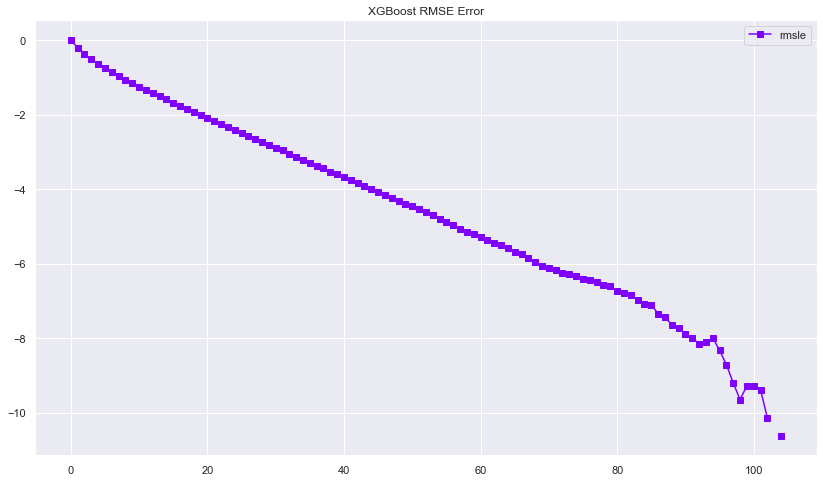

In [766]:
def scale(x):
    return (np.array(x)-min(x))/(max(x)-min(x))
results = alg.evals_result()
epochs = len(results['validation_0'][eval_metric[0]])
x_axis = range(0, epochs)
# plot log loss
# fig, ax = plt.subplots()
# ax.plot(x_axis, results['validation_0']['mae'], label='Train')
# ax.plot(x_axis, results['validation_1']['mae'], label='Test')
# ax.legend()
# plt.ylabel('Log Loss')
# plt.title('XGBoost Log Loss')
# plt.show()
# plot classification error
# fig, ax = plt.subplots()
plt.figure(figsize=(14,8));
color = iter(cm.rainbow(np.linspace(0, 1, len(eval_metric))))
for metric in eval_metric:
#['rmse']:
#
    col = next(color)
#     count = count+1
#     plt.plot(x_axis, np.log(scale(results['validation_0'][metric])), label=metric,marker='*',c=col)
    plt.plot(x_axis, np.log(scale(results['validation_1'][metric])), label=metric,marker='s',c=col)
    
#     plt.ylabel(metric)
plt.legend()
plt.title('XGBoost RMSE Error')
plt.show()

In [925]:
# np.log(scale(results['validation_0']['rmse']))

In [924]:
# # plot learning curve
# from numpy import loadtxt
# from xgboost import XGBClassifier
# from sklearn.model_selection import train_test_split
# from sklearn.metrics import accuracy_score
# from matplotlib import pyplot
# # load data
# # dataset = loadtxt('pima-indians-diabetes.csv', delimiter=",")
# # # split data into X and y
# # X = dataset[:,0:8]
# # Y = dataset[:,8]
# X = train.copy().values
# Y = target.copy().values
# # split data into train and test sets
# X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.33, random_state=7)
# # fit model no training data
# # model = XGBClassifier()
# model = alg
# eval_set = [(X_train, y_train), (X_test, y_test)]
# model.fit(X_train, y_train, eval_metric=["rmse", "mae"], eval_set=eval_set, verbose=True)
# # make predictions for test data
# y_pred = model.predict(X_test)
# predictions = [round(value) for value in y_pred]
# # evaluate predictions
# # accuracy = accuracy_score(y_test, predictions)
# # print("Accuracy: %.2f%%" % (accuracy * 100.0))
# # retrieve performance metrics
# results = model.evals_result()
# # epochs = len(results['validation_0']['rmse'])
# # x_axis = range(0, epochs)
# # # plot log loss
# # fig, ax = pyplot.subplots()
# # ax.plot(x_axis, results['validation_0']['mae'], label='Train')
# # ax.plot(x_axis, results['validation_1']['mae'], label='Test')
# # ax.legend()
# # pyplot.ylabel('Log Loss')
# # pyplot.title('XGBoost Log Loss')
# # pyplot.show()
# # # plot classification error
# # fig, ax = pyplot.subplots()
# # ax.plot(x_axis, results['validation_0']['rmse'], label='Train')
# # ax.plot(x_axis, results['validation_1']['rmse'], label='Test')
# # ax.legend()
# # pyplot.ylabel('Classification Error')
# # pyplot.title('XGBoost Classification Error')
# # pyplot.show()

In [923]:
# results

In [668]:
model.evals_result()

{'validation_0': OrderedDict([('rmse', [43.994892]), ('mae', [41.673512])]),
 'validation_1': OrderedDict([('rmse', [43.632282]), ('mae', [41.048298])])}

In [266]:
train_columns[alg.feature_importances_>.01]
## dart importances >.1

Index(['c11HouseholdMarriedNoChildren', 'c11CarsNone', 'c11CarsThree',
       'c11CarsFour', 'c11NSSECNeverWorked', 'c11NoAdultsEmployedChildren',
       'c11Deprived3', 'CON%MAN_DIR_SEN', 'c11CarsMean', 'c11DeprivedHigh',
       'c11DeprivedLow', 'c11CarsMoreThanNone', 'DISEASES_Cancer',
       'INCOMEANDTAX_Pension income No. of individuals',
       'STAMPDUTY_Residential Receipts'],
      dtype='object')

In [311]:
pd.Series(alg.coef_,index=train_columns).abs().sort_values().tail(20)

c11Elderly                                             0.036577
CON%PROF                                               0.041237
c11YoungAdults                                         0.041700
c11IndustryEducation                                   0.042068
c11CarsThree                                           0.045079
c11FulltimeStudent                                     0.046483
c11NSSECSmallEmployer                                  0.046619
BENEFITEXPENDITURE_Personal Independence Payment       0.047106
c11NoReligion                                          0.051114
c11HouseSocialLA                                       0.051339
CON%MAN_DIR_SEN                                        0.053703
c11HouseSocial                                         0.053970
FEEDINCAPACITY_Anaerobic Digestion Domestic            0.054767
c11CarsNone                                            0.059049
c11Degree                                              0.071948
BENEFITEXPENDITURE_Employment And Suppor

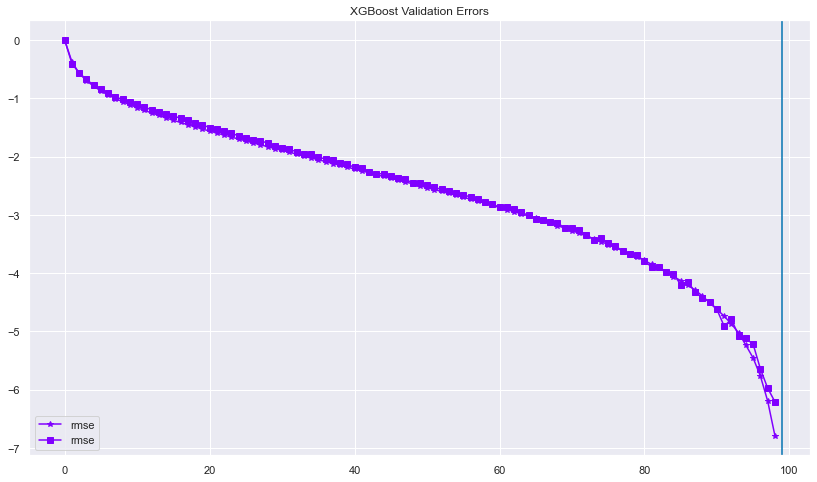

MSE: 17.13, MAE: 3.24, EV: 0.86, R2: 0.86


AssertionError: Only the 'gbtree' model type is supported, not 'gblinear'!

In [302]:
# geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
# df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
# df_simp = df_simp[geomask]

var_stub = "Con17_elec"
# df_simp[var_stub] = BES_census_data[var_stub][geomask]


Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]

mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = var_stub
dependence_plots = False

# best_hyperparams['max_depth']=5+2
# best_hyperparams['learning_rate'] = 10**(-0.9)
# best_hyperparams['tree_method'] = 'exact'# 'hist'
# best_hyperparams['booster'] = 'dart'
# best_hyperparams['sample_type'] = 'weighted'
# best_hyperparams['normalize_type'] = 'forest' #fx
# best_hyperparams['one_drop']=1 # fx

# best_hyperparams['colsample_bylevel']=0.78 #fx
# best_hyperparams['colsample_bynode']=0.77 #fx
# best_hyperparams['colsample_bytree']=0.74 #fx
# best_hyperparams['gamma']=6.231027609021689 # fx
# best_hyperparams['min_child_weight']=31 # fx
# best_hyperparams['reg_alpha']=0 # fx
# best_hyperparams['reg_lambda']=0 # fx
# best_hyperparams['rate_drop']=0.10156821239567745 #fx
# best_hyperparams['skip_drop']=0.7705247931294512 #fx


# alg = get_xgboost_alg(classification_problem=False)

# alg.set_params(**best_hyperparams )
# alg.n_estimators = 100
title = var_stub

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=['rmse'],                    
            title = title,plot_validation=True)

In [71]:
# %%time
# best_hyperparams['max_depth'] = int(best_hyperparams['max_depth']+2)
# best_hyperparams['learning_rate'] = 10**best_hyperparams['learning_rate']
# alg = get_xgboost_alg(classification_problem=False)

# alg.set_params(**best_hyperparams )
# alg.n_estimators = 100
alg.scale_pos_weight=10000.09 ## changes nothing
alg.max_delta_step=0#10000000000000
# alg.reg_alpha=1000000.075



alg.reg_alpha=1.075
alg.reg_lambda=1.011
alg.colsample_bynode=0.85
alg.gamma=4.9792115890922535

alg.min_child_weight = 19
alg.tree_method = 'exact' # auto==exact for this dataset
# approx -> nan!, gpu_hist -> nan
# hist -> slow
alg.booster = 'gbtree' #gbtree diff from dart, dart slower,
# gblinear doesn't use these:
# "colsample_bylevel", "colsample_bynode", "colsample_bytree", "gamma", "interaction_constraints", "max_delta_step", "max_depth",
# "min_child_weight", "monotone_constraints", "num_parallel_tree", "refresh_leaf", "sketch_eps", "subsample", "tree_method" 

# dart needs a bunch of extra parameters!

alg.num_parallel_tree=1
# https://xgboost.readthedocs.io/en/stable/tutorials/rf.html
# you can theoretically make random forests, but have to set specific variables AND param in xgb.train to allow
alg.refresh_leaf=0 # changes nothing because param for updater which is set automatically (but could be overridden)


#

from sklearn.model_selection import StratifiedKFold,KFold
from sklearn.model_selection import cross_val_score
kfold = KFold(n_splits=5)
results = cross_val_score(alg, df_simp[train_columns], df_simp[var_stub], cv=kfold,scoring='r2')
# neg_mean_squared_log_error
print("R2: %.2f%% (%.2f%%)" % (results.mean()*100, results.std()*100))

R2: 87.28% (2.38%)


In [315]:
## I wish to redo the xgb regression - using dataset optimised settings - for
# - 'base' variables
# - BES aggregates
# - nomis

# then run FA dim red
# then linreg on components

In [ ]:
from sklearn.metrics import mean_squared_log_error
from sklearn.model_selection import KFold
from sklearn.metrics import check_scoring
from sklearn.metrics._scorer import _check_multimetric_scoring, _MultimetricScorer 

alg = xgb.XGBRegressor(
        objective="reg:squarederror", n_estimators=10000, learning_rate=0.05
    )

scoring='r2'
estimator = alg


def better_cross_val_score(alg,p_input,p_target,scoring,n_splits =5,shuffle=True,
                           random_state=1121218,early_stopping_rounds = 50,verbose = True)

    if callable(scoring):
        scorers = scoring
    elif scoring is None or isinstance(scoring, str):
        scorers = check_scoring(estimator, scoring)
    else:
        scorers = _check_multimetric_scoring(estimator, scoring)

    cv = KFold(
        n_splits=n_splits,
        shuffle=shuffle,
        random_state=random_state,
    )

    fold = 0
    scores = np.empty(n_splits)
    for train_idx, test_idx in cv.split(p_input, p_target):
        if verbose:
            print(f"Started fold {fold}...")
        # Create the training sets from training indices
        X_cv_train, y_cv_train = p_input.iloc[train_idx], p_target.iloc[train_idx]
        # Create the test sets from test indices
        X_cv_test, y_cv_test = p_input.iloc[test_idx], p_target.iloc[test_idx]
        # Init/fit XGB

        alg.fit(
            X_cv_train,
            y_cv_train,
            eval_set=[(X_cv_test, y_cv_test)],
            early_stopping_rounds=early_stopping_rounds,
            verbose=verbose,
        )
        # Generate preds, evaluate
        preds = model.predict(X_cv_test)
        ## pass through metric here!
        rmsle = np.sqrt(mean_squared_log_error(y_cv_test, preds))
        if verbose:
            print("RMSLE of fold {}: {:.4f}\n".format(fold, rmsle))
        scores[fold] = rmsle
        fold += 1
    if verbose:
        print("Overall RMSLE: {:.4f}".format(np.mean(scores)))
    return

In [377]:
# import pickle
# def dim_red(df,n_components=None,red_type="Factor Analysis",show_first_x_comps=4):

#     Treatment = "Census Data Decomposition"
#     output_folder = "E:\\BES_analysis_data\\output\\CensusDataDecomposition\\"
#     output_subfolder = output_folder + Treatment + os.sep
#     if not os.path.exists( output_subfolder ):
#         os.makedirs( output_subfolder )

#     decomp_index = df.index
#     decomp_columns = df.columns
#     clean_feature_set_std = StandardScaler().fit_transform(df.values)
#     decomp_std = pd.DataFrame(   clean_feature_set_std,
#                                  columns = decomp_columns,
#                                  index   = decomp_index      )
#     if n_components is None:
#         n_components = decomp_std.shape[1]
    
#     # n_components = 4
#     # (svd_solver='full', n_components='mle',whiten=True)
    
#     if red_type == "Factor Analysis":
#         decomp = FactorAnalysis(svd_method = 'lapack',n_components = n_components) ## ~10s ,n_components=30 -> 1.5 hr
#     elif red_type == "PCA":
#         decomp = PCA(n_components = n_components,svd_solver='full')    
#     decomp_method = str(decomp).split("(")[0] 
#     X_r = decomp.fit_transform(decomp_std)
#     BES_decomp = pd.DataFrame(   X_r,
#                                  columns = range(0,n_components),
#                                  index   = decomp_index)

# #     save = True # False => Load
# #     if save & ( 'decomp' in globals() ): # SAVE    ##( 'decomp' not in globals() )
# #         decomp_method = str(decomp).split("(")[0] 
# #         subdir = output_subfolder + decomp_method
# #         fname = subdir+ os.sep + decomp_method
#     subdir = output_subfolder + decomp_method
#     (BES_decomp, comp_labels, comp_dict) = display_components(n_components, decomp,
#                                                               decomp_columns, BES_decomp, manifest=None, 
#                                                               save_folder = subdir,  
#                                                               show_first_x_comps= show_first_x_comps, show_histogram = False)    
#     return (BES_decomp, comp_labels, comp_dict)

In [370]:
%%time
var_stub = "Con17_elec"
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))
df_simp[var_stub] = BES_census_data[var_stub]

BES_agg_cols = BES_constituency_aggregates.drop(search(BES_constituency_aggregates,"|".join(["winConstituency","profile_past","ashcroft","partyContact",
                                                       "partyId","localElection","localTurnout","^map",
                                                       "generalElectionVote","euroElectionVote",
                                                       "^prefer[^M]","ptv"])).index,axis=1).columns
df_simp[BES_agg_cols] = BES_constituency_aggregates[BES_agg_cols].values

df_simp.loc[BES_census_data["Country"]!="Scotland",nomis_dump.columns] = nomis_dump.values

df_simp = df_simp[geomask]


Wall time: 13.7 s


In [ ]:
# df_simp_backup = df_simp.copy()

In [340]:

# df_simp = df_simp_backup[df_simp_backup.columns[0:1000]]
# df_simp = df_simp_backup.copy()

In [371]:
from sklearn.preprocessing import RobustScaler
df_simp[df_simp.columns] = RobustScaler().fit_transform(df_simp)
# df_simp

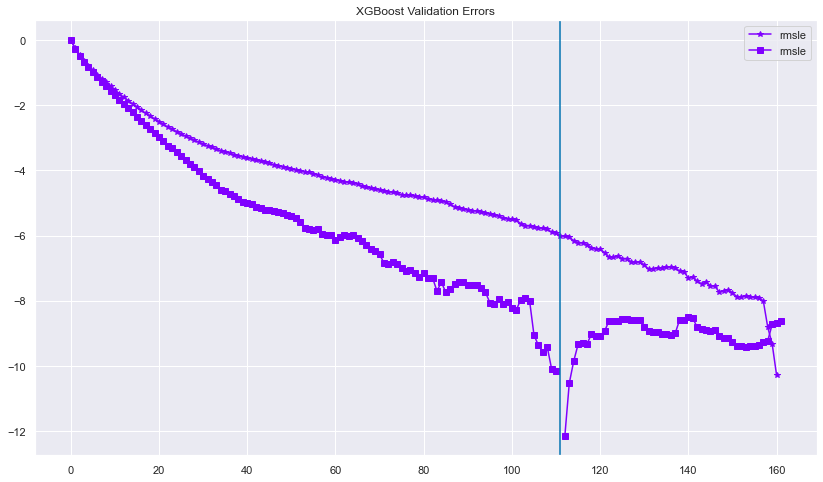

MSE: 13.61, MAE: 2.81, EV: 0.89, R2: 0.89


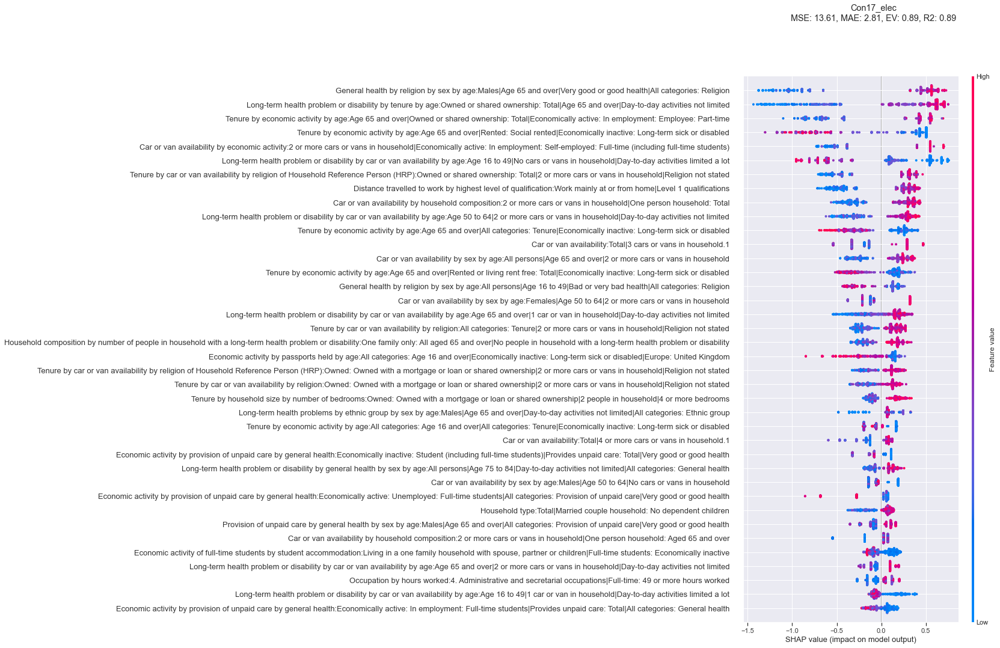

(38,) (572, 60906)


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             Con17_elec   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                     340.8
Date:                Sat, 05 Feb 2022   Prob (F-statistic):          6.37e-231
Time:                        23:40:36   Log-Likelihood:                -1634.7
No. Observations:                 572   AIC:                             3291.
Df Residuals:                     561   BIC:                             3339.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.7140      0.178    172.530      0.000      30.364      31.064
0              9.6890      0.178     54.425      0.000       9.339      10.039
1             -2.4047      0.178    -13.504      0.000      -2.755      -2.055
2             -2.1246      0.178    -11.917      0.000      -2.475      -1.774
3             -0.4850      0.178     -2.717      0.007      -0.836      -0.134
4              0.5019      0.179      2.797      0.005       0.149       0.854
5             -0.6736      0.181     -3.727      0.000      -1.029      -0.319
6              0.8924      0.183      4.878      0.000       0.533       1.252
7             -1.0731      0.186     -5.781      0.000      -1.438      -0.708
8              1.0585      0.186      5.686      0.000       0.693       1.424
9              0.3571      0.197      1.810      0.071      -0.030       0.745
==============================================================================
Omnibus:                       27.154   Durbin-Watson:                   1.821
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               40.234
Skew:                          -0.386   Prob(JB):                     1.83e-09
Kurtosis:                       4.045   Cond. No.                         1.11
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Wall time: 1min 56s


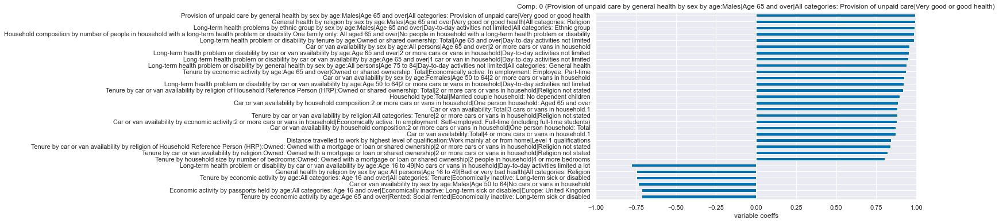

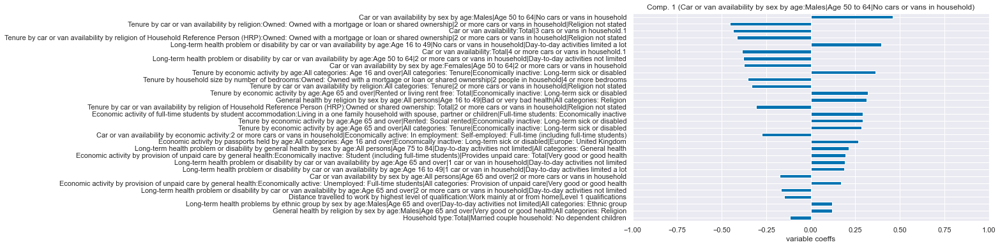

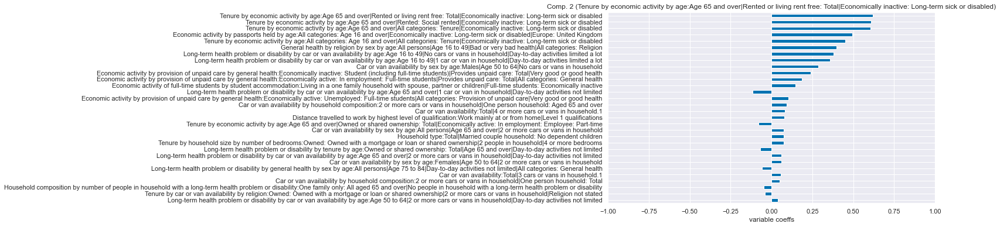

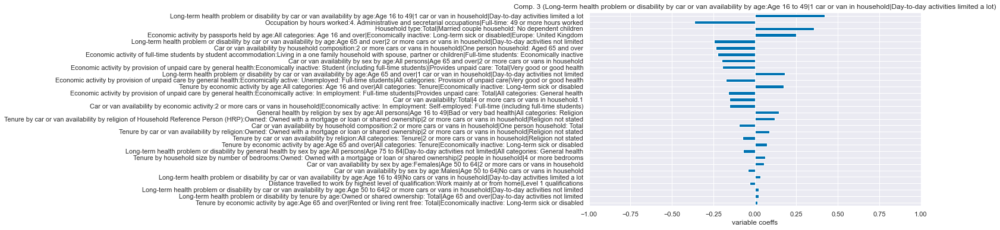

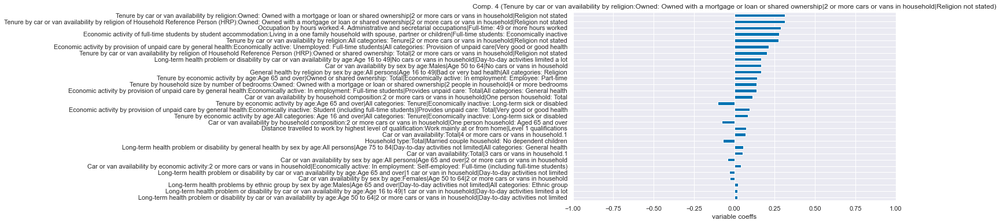

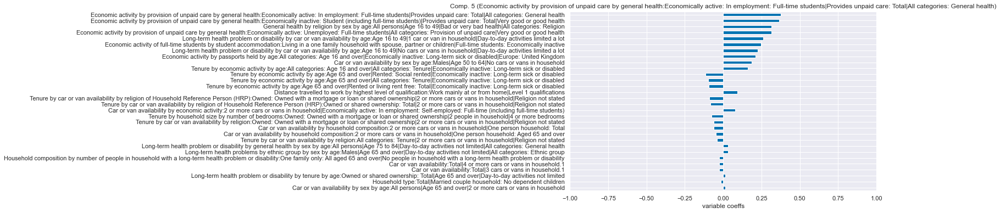

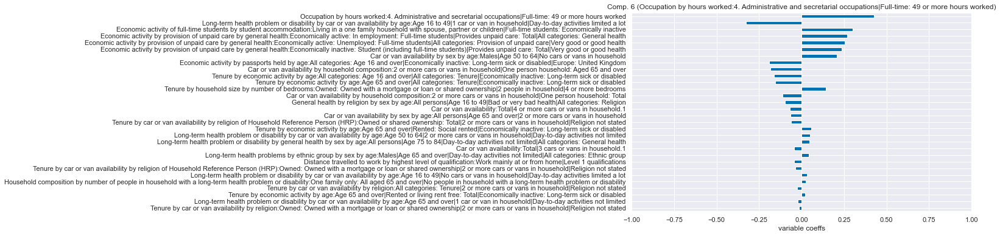

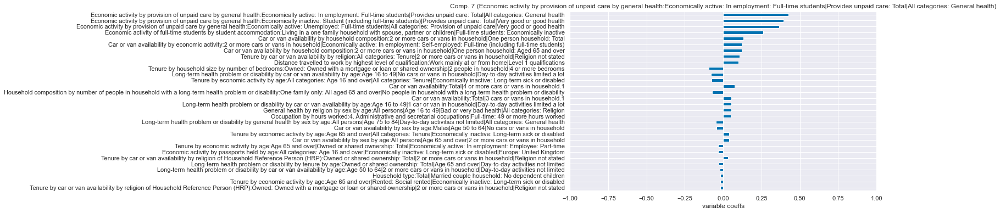

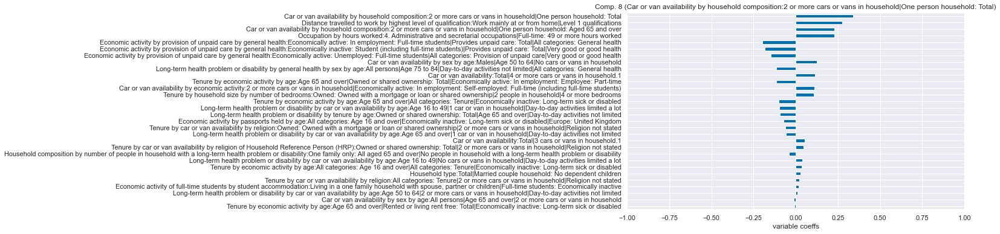

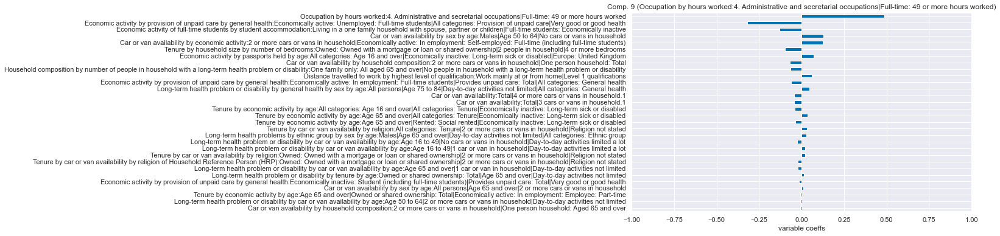

In [372]:
%%time
var_stub = "Con17_elec"
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")
# df_simp = pd.get_dummies(BES_census_data.drop(drop_cols+['Con17'],axis=1))[geomask]
df_simp[var_stub] = BES_census_data[var_stub][geomask].values
threshold = .1
n_comp=10



Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = var_stub
dependence_plots = False

alg = get_xgboost_alg(classification_problem=False)
# {'colsample_bylevel': 0.545,
#  'colsample_bytree': 0.43,
#  'gamma': 7.0559722037762675,
#  'learning_rate': 10**-1.0625,
#  'max_depth': 5+2,
#  'min_child_weight': 11.0,
#  'subsample': 0.48}
alg.colsample_bylevel = .545
alg.colsample_bytree = 0.43
alg.gamma = 7.0559722037762675
alg.learning_rate = 10**-1.0625
alg.max_depth = 5+2
alg.min_child_weight = 11.0
alg.subsample = 0.48
# alg.colsample_bylevel = .545

eval_metric=["rmsle"]

# alg.random_state = randint(0, 1000)
# alg.n_estimators=1000
title = var_stub






(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title,plot_validation=True)

dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
print( train_columns[dist[dist>=threshold].index].shape,df_simp.shape )

df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
df = df.fillna(df.mean())

(BES_decomp, comp_labels, comp_dict) = dim_red(df, n_components=n_comp,red_type="Factor Analysis",show_first_x_comps=14)

Y = df_simp[var_stub]
X = BES_decomp.loc[:,0:n_comp]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
display(results.summary())


In [393]:
dist[dist>0].min()

0.0034855092

100%|████████████████████████████████| 15000/15000 [1:26:47<00:00,  2.88trial/s, best loss: -0.8344496018980313]
{'n_comp_FA': 19.0, 'threshold': 0.16646406057171959}
Wall time: 1h 26min 48s


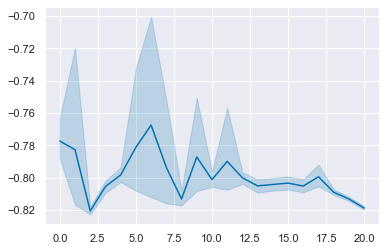

In [521]:
%%time
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe
space={ 
        'threshold':hp.uniform('threshold', dist[dist>0].min(),dist.max()),
    #0.0243612172520986,
    #
        'n_comp_FA': hp.quniform('n_comp_FA', 0,20,1),
    #hp.quniform('n_comp_FA', 1,2,1),
        'n_comp': 2,
#     2hp.quniform('n_comp', 1,10,1),
    #2,
      }
def objective(space):
    threshold = space['threshold']
    n_comp_FA = int(space['n_comp_FA'])+1
    n_comp = space['n_comp']
    df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
    df = df.fillna(df.mean())
#     print(n_comp,n_comp_FA,'!')
    BES_decomp = dim_red(df, n_components=n_comp_FA,red_type="Factor Analysis",
                                                   show_first_x_comps=n_comp,display_comp=False)

    Y = df_simp[var_stub]
    X = BES_decomp.loc[:,0:n_comp-1]
    X = sm.add_constant(X)
    model = sm.OLS(Y,X)
    results = model.fit()
    return {'loss': -(results.rsquared), 'status': STATUS_OK }


trials = Trials()

best_hyperparams = fmin(fn = objective,
                        space = space,
                        algo = tpe.suggest,
                        max_evals = 15000,
                        trials = trials)
print(best_hyperparams)
sns.lineplot(trials.vals['n_comp_FA'],trials.losses())

In [ ]:
100%|████████████████████████████████████| 5000/5000 [13:06<00:00,  6.36trial/s, best loss: -0.8344496018980313]
{'n_comp_FA': 20.0, 'threshold': 0.16907959586442886}
Wall time: 13min 7s

In [514]:
100%|████████████████████████████████████| 1000/1000 [02:19<00:00,  7.18trial/s, best loss: -0.8344496018980313]
{'n_comp_FA': 19.0, 'threshold': 0.1723355671243001}
Wall time: 2min 19s

{'n_comp_FA': 12.0, 'threshold': 0.02147037190493608}

In [ ]:
100%|████████████████████████████████████| 6000/6000 [54:06<00:00,  1.85trial/s, best loss: -0.8429211076199916]
{'n_comp_FA': 12.0, 'threshold': 0.02147037190493608}
Wall time: 54min 6s

In [ ]:
100%|████████████████████████████████████| 3000/3000 [25:46<00:00,  1.94trial/s, best loss: -0.8423724016807987]
{'n_comp_FA': 10.0, 'threshold': 0.023833247909739112}

In [ ]:
100%|████████████████████████████████████████| 40/40 [00:23<00:00,  1.71trial/s, best loss: -0.8386787958039786]
{'n_comp_FA': 30.0, 'threshold': 0.12156032207381375}
Wall time: 23.5 s

In [ ]:
100%|████████████████████████████████████████| 40/40 [00:20<00:00,  1.97trial/s, best loss: -0.8422614211333382]
{'n_comp_FA': 11.0}
Wall time: 20.6 s
    # implicit threshold = 0.0243612172520986

In [ ]:
# 100%|████████████████████████████████████| 1000/1000 [05:20<00:00,  3.12trial/s, best loss: -0.8784774246821303]
# {'threshold': 0.02436121725209867}
# Wall time: 5min 20s

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             Con17_elec   R-squared:                       0.834
Model:                            OLS   Adj. R-squared:                  0.834
Method:                 Least Squares   F-statistic:                     1434.
Date:                Sun, 06 Feb 2022   Prob (F-statistic):          6.10e-223
Time:                        21:18:44   Log-Likelihood:                -1680.0
No. Observations:                 572   AIC:                             3366.
Df Residuals:                     569   BIC:                             3379.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.7140      0.191    160.543      0.000      30.338      31.090
0             10.2304      0.192     53.172      0.000       9.852      10.608
1             -1.3254      0.208     -6.385      0.000      -1.733      -0.918
==============================================================================
Omnibus:                       45.128   Durbin-Watson:                   1.837
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               98.402
Skew:                          -0.451   Prob(JB):                     4.29e-22
Kurtosis:                       4.821   Cond. No.                         1.08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

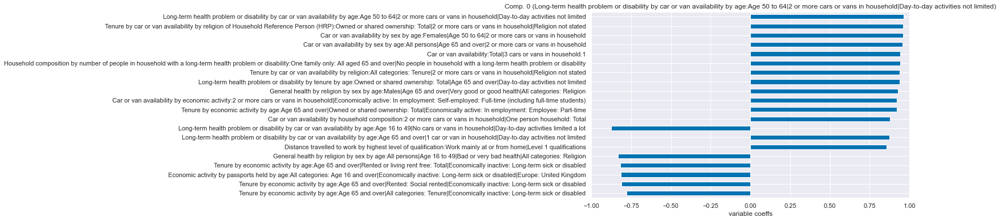

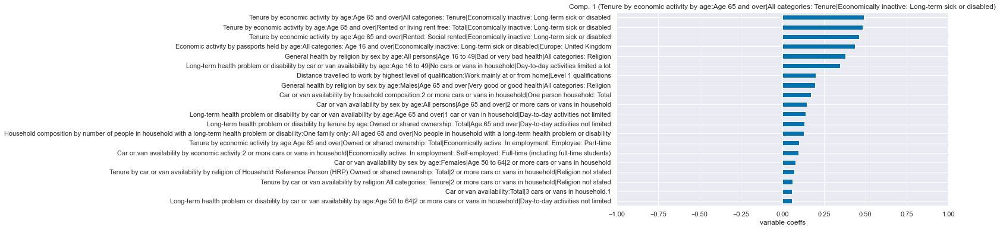

In [519]:
threshold=0.1723355671243001
df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
df = df.fillna(df.mean())
n_comp_FA = 19+1
n_comp = 2
(BES_decomp, comp_labels, comp_dict) = dim_red(df, n_components=n_comp_FA,red_type="Factor Analysis",
                                               show_first_x_comps=n_comp,display_comp=True)

Y = df_simp[var_stub]
X = BES_decomp.loc[:,0:n_comp-1]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
display(results.summary())

In [516]:
## 84% with two variables (albeit, two FA component variables!)

0.8429211076199916

-0.6931831014114253                                                                                             
const                                                                                                               26.588621
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion    11.032803
dtype: float64
-0.8941406559214737                                                                                             
const                                                                                                                                          27.400484
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                1.657510
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited      1.080491
Tenure by economic activity by age:Age 65 and ov

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                                                              0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                                                   0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                                                         0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                                                        0.0
Tenure by economic activity

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

-3.557649789841782e-32                                                                                          
[30.71401736  0.          0.          0.          0.          0.        ]                                       
nan                                                                                                             
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]                                             
-0.8104700117039018                                                                                             
const                                                                                                                                                                           25.560441
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                 2.497420
Long-term health problem or disability by tenure by age:Owned o

nan                                                                                                             
const                                                                                                                                          0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                               0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited     0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time    0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                     0.0
                                                                                                                                              ... 
respo

nan                                                                                                             
const                                                                                                                                                                                  0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                       0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                             0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                            0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                 

nan                                                                                                             
const                                                                                                                                                                              0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                   0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                         0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                        0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                 

nan                                                                                                             
const                                                                                                                                                                                                                         0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                                                              0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                                                                    0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                                                      

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

nan                                                                                                             
const                                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                             

-5.722983590732725e-32                                                                                          
const                                                                                                                                                                           10.188233
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                                 0.000000
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                       0.000000
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                      0.000000
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                     

nan                                                                                                             
const                                                                                                                                                  0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                       0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited             0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time            0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                             0.0
                                                                                                                

nan                                                                                                             
const                                                                                                                                                  0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                       0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited             0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time            0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                             0.0
                                                                                                                

nan                                                                                                             
const                                                                                                                                          0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                               0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited     0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time    0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                     0.0
                                                                                                                                              ... 
Relig

nan                                                                                                             
const                                                                                                                                                           0.0
General health by religion by sex by age:Males|Age 65 and over|Very good or good health|All categories: Religion                                                0.0
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                      0.0
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                     0.0
Tenure by economic activity by age:Age 65 and over|Rented: Social rented|Economically inactive: Long-term sick or disabled                                      0.0
                                                                   

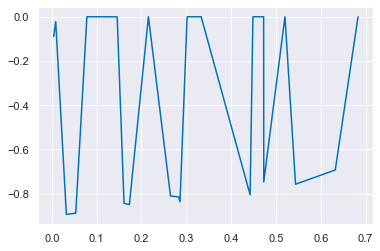

In [439]:
# %%time
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe
space={ 
        'threshold': hp.uniform('threshold', dist[dist>0].min(),dist.max()),
        'alpha':hp.uniform("alpha",0, 1),
        'L1_wt':hp.uniform("L1_wt",0, 1),
        'profile_scale':hp.choice('profile_scale',[
                    {
                        'bool':True,
                    },
                    {
                        'bool':False,
                    },] ),     
        'refit':hp.choice('refit',[
                    {
                        'bool':True,
                    },
                    {
                        'bool':False,
                    },] ),      
      }

def objective(space):
    threshold = space['threshold']
#     df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
#     df = df.fillna(df.mean())
# #     print(threshold,df.shape)
#     BES_decomp = dim_red(df, n_components=n_comp,red_type="Factor Analysis",
#                                                    show_first_x_comps=14,display_comp=False)
    df = df_simp[train_columns[dist[dist>=threshold].index]]
    df = df.fillna(df.mean())
    Y = df_simp[var_stub]
    X = df
    X = sm.add_constant(X)
    model = sm.OLS(Y,X)
    results = None
    results = model.fit_regularized(method='elastic_net',alpha=space['alpha'],L1_wt=space['L1_wt'],
                                    profile_scale=space['profile_scale']['bool'],refit=space['refit']['bool'])
#     print(space)
#     print(results)
#     print(results.fittedvalues)
#     print(df_simp[var_stub].shape,pd.Series(results.fittedvalues))
#     print(df_simp[var_stub].corr(pd.Series(results.fittedvalues))**2)
    print(-df_simp[var_stub].corr(pd.Series(results.fittedvalues))**2)
    print(results.params)
    return {'loss': -(df_simp[var_stub].corr(pd.Series(results.fittedvalues))**2), 'status': STATUS_OK }


trials = Trials()

best_hyperparams = fmin(fn = objective,
                        space = space,
                        algo = tpe.suggest,
                        max_evals = 100,
                        trials = trials)
print(best_hyperparams)
sns.lineplot(trials.vals['threshold'],trials.losses())

In [440]:
trials.best_trial

{'state': 2,
 'tid': 1,
 'spec': None,
 'result': {'loss': -0.8941406559214737, 'status': 'ok'},
 'misc': {'tid': 1,
  'cmd': ('domain_attachment', 'FMinIter_Domain'),
  'workdir': None,
  'idxs': {'L1_wt': [1],
   'alpha': [1],
   'profile_scale': [1],
   'refit': [1],
   'threshold': [1]},
  'vals': {'L1_wt': [0.6835946919087309],
   'alpha': [0.12131720402928226],
   'profile_scale': [1],
   'refit': [1],
   'threshold': [0.03260792282288916]}},
 'exp_key': None,
 'owner': None,
 'version': 0,
 'book_time': datetime.datetime(2022, 2, 6, 16, 4, 56, 514000),
 'refresh_time': datetime.datetime(2022, 2, 6, 16, 4, 56, 961000)}

In [442]:
best_hyperparams

{'L1_wt': 0.6835946919087309,
 'alpha': 0.12131720402928226,
 'profile_scale': 1,
 'refit': 1,
 'threshold': 0.03260792282288916}

In [443]:
threshold = .05


df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
df = df.fillna(df.mean())
#     print(threshold,df.shape)
# BES_decomp = dim_red(df, n_components=n_comp,red_type="Factor Analysis",
#                                                show_first_x_comps=14,display_comp=False)

Y = df_simp[var_stub]
X = df
#BES_decomp.loc[:,0:n_comp]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit_regularized(method='elastic_net',alpha=0.12131720402928226,L1_wt=0.6835946919087309,
                                profile_scale=False,refit=False)

In [447]:
df_simp[var_stub].corr(pd.Series(results.fittedvalues))**2

0.8906074617471531

In [450]:
results.params[results.params>0]

const                                                                                                                                                                                                                         28.891516
Long-term health problem or disability by tenure by age:Owned or shared ownership: Total|Age 65 and over|Day-to-day activities not limited                                                                                     1.806259
Tenure by economic activity by age:Age 65 and over|Owned or shared ownership: Total|Economically active: In employment: Employee: Part-time                                                                                    1.654906
Long-term health problem or disability by car or van availability by age:Age 50 to 64|2 or more cars or vans in household|Day-to-day activities not limited                                                                    0.756825
Tenure by car or van availability by religion of Household Reference Per

In [ ]:
### recurrent themes!

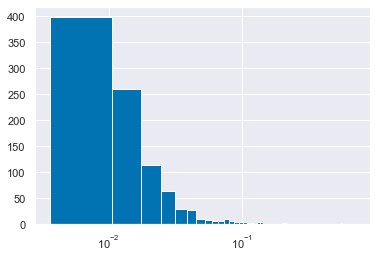

In [356]:
dist[dist>0].hist(bins=100)
plt.gca().set_xscale('log')

In [360]:
dist[dist>0].min()

0.0036366608

In [361]:
len( train_columns[dist[dist>=.01].index] )

614

In [363]:
train_columns[dist[dist>=.01].index][100:200]

Index(['Economic activity by passports held by age:Age 16 to 49|Economically active: In employment: Self-employed: Part-time|No passport held',
       'Occupation by religion:7. Sales and customer service occupations|No religion',
       'Tenure by car or van availability by religion:All categories: Tenure|2 or more cars or vans in household|Other religion',
       'Tenure by household size by number of rooms:Owned or shared ownership: Total|2 people in household|4 rooms',
       'Passports held (detailed):The Americas and the Caribbean: The Caribbean: Total',
       'Passports held by year of arrival in the UK:Europe: Other Europe: Total|Arrived 1961-1970',
       'Occupation (Minor groups) (Out of term-time population):721. Customer Service Occupations',
       'Economic activity:Economically active: Employee: Part-time.1',
       'c11IndustryEducation',
       'Household composition:Total|Other household types: All full-time students.2',
       'Country of birth by year of arrival i

In [451]:
dist[dist>0].shape

(929,)

In [455]:
train_columns[dist[dist>0].index].shape

(929,)

In [468]:
len( [x for x in train_columns[dist[dist>0].index] if x in BES_census_data.columns] )
# (929,)
# 681 nomis_dump.columns
# 226 BES_constituency_aggregates.columns
# 11 parl_con_aggs.columns
# 0 centre_for_towns
# 0 occ_df
# 21 BES_census_data

21

In [469]:
[x for x in train_columns[dist[dist>0].index] if x in BES_census_data.columns]

['c11CarsThree',
 'c11NSSECHigherManager',
 'EDUCATION_Reg. % In need of Improvement (Secondary)',
 'EDUCATION_Reg. % Outstanding (Secondary)',
 'DISEASES_High Blood Pressure',
 'c11HealthGood',
 'EDUCATION_Reg. % Outstanding (Primary)',
 'c11HealthVeryBad',
 'c11Age18to19',
 'BENEFITEXPENDITURE_Total',
 'DISEASES_Palliative Care',
 'BENEFITEXPENDITURE_Employment And Support Allowance',
 'c11EconomicActive',
 'c11Deprived1',
 'c11Unemployed50to74',
 'DEBTRELIEFORDERS_Rate per 10,000 adult population',
 'c11IndustryAdministrative',
 'BENEFITEXPENDITURE_Disability Living Allowance',
 'INCOMEANDTAX_Pension income Mean',
 'BENEFITEXPENDITURE_of which children',
 'c11EthnicityWhiteTraveller']

In [470]:
[x for x in train_columns[dist[dist>0].index] if x in BES_constituency_aggregates.columns]

['likeCorbynW7__Strongly like',
 'ethno2W7__Strongly agree',
 'sharedContentOnline_3W12_Yes',
 'redistSelfW3__Government should be less concerned about equal incomes',
 'negotiationSpecifics_2W14_Yes',
 'small_mii_catW11_Europe',
 'responsibleImmigLabourW1_Yes',
 'partyMemberW10__Yes, I am a member of a party',
 'responsibleDebtTradeUnionsW2_Yes',
 'conPriorities_nhsW4_Yes',
 'labFearW6_Yes',
 'registeredW11_Yes - another address',
 'satDemUKW13__Very satisfied',
 'pccVote1W8_The Conservative candidate',
 'majorityPartyLabW11__Very likely',
 'regSatisfactionW2__Very dissatisfied',
 'euID7W9__Strongly agree',
 'likeConW7__Strongly like',
 'achieveReduceImmigDKW10_Yes',
 'likeConW10__Strongly like',
 'satDemEngW7__Very satisfied',
 'profile_house_tenureW13_Rent - from my local authority',
 'immigUKIPW11__Allow many more',
 'profile_gross_householdW13__£150,000 and over',
 'warmRichW11__Very warm',
 'auth3W14_To be well-behaved',
 'efficacyNotUnderstandW1__Strongly agree',
 'responsibleEd

In [473]:
pd.Series([x.split("W")[0] for x in train_columns[dist[dist>0].index] if x in BES_constituency_aggregates.columns]).value_counts().head(50)

mii_cat                        4
ns_sec                         3
small_mii_cat                  3
education                      3
redistSelf                     3
satDemEng                      3
pccVote1                       3
econGenRetro                   3
bestOnMII                      3
profile_house_tenure           2
responsibleEconLibDems         2
lrCon                          2
likeRudd                       2
likeCon                        2
efficacyNotUnderstand          2
pidCriticiseParty              2
miilabel                       2
likeCorbyn                     2
controlImmig                   2
eesEUIntegrationUKIP           2
profile_work_type              2
changeNHS                      2
negotiationSpecifics_2         2
conPriorities_nhs              2
labPriorities_nhs              2
EUMIICategory                  2
conPriorities_econ             2
femaleEquality2                1
labHandleNHS                   1
ldPriorities_none              1
likeMay   

In [ ]:
## how to think about these? PCA???

In [480]:
pd.Series( flatten( [x.lower().split(":")[0].split(" by ") for x in train_columns[dist[dist>0].index] if x in nomis_dump.columns] ) ).value_counts().head(50)

age                                                                     271
sex                                                                     195
tenure                                                                  124
economic activity                                                       120
religion                                                                 78
general health                                                           71
country of birth                                                         62
ethnic group                                                             61
passports held                                                           57
car or van availability                                                  52
household composition                                                    41
provision of unpaid care                                                 36
long-term health problem or disability                                   35
accommodatio

In [ ]:
###############################################################

# get variable sets/principal components for a set of different target variables/Ges





In [524]:
## accept df_simp with scotland only, loaded with all variables, robustScaled as base
df_simp_base = df_simp.copy()

# geomask, leave as is
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

In [536]:
target_pol_var_list = ["Lab","Lib_Left","Con","Right_Auth"]
year_combo_list = [["05","10"],["10","15"],["15","17"],["17","19"],["05","10","15"],["10","15","17"],
                   ["15","17","19"],["05","10","15","17"],["10","15","17","19"],["05","10","15","17","19"]]
    
pol_var = "Con"
year_combo = ["05","10","15","17","19"]
    


In [596]:
results_store = pd.DataFrame(columns = ["duration","n_comp","n_compFA","threshold",
                    "variables",
                    "results","BES_decomp"])

Lab ['05', '10']


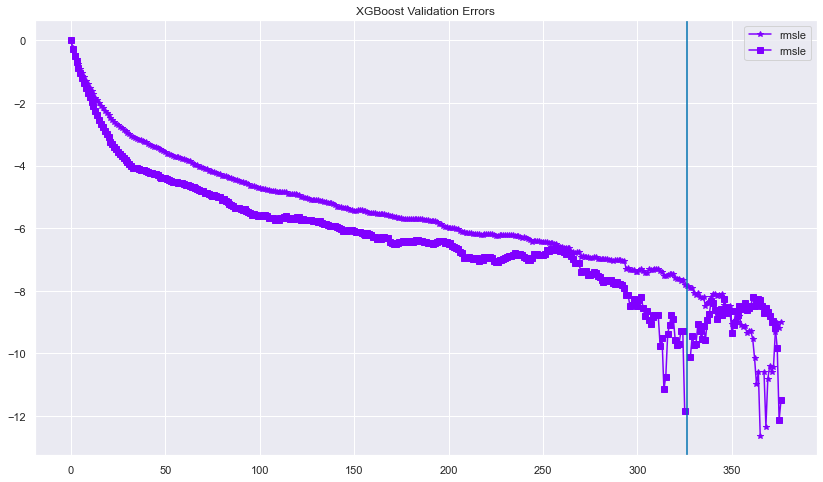

MSE: 12.64, MAE: 2.73, EV: 0.83, R2: 0.83


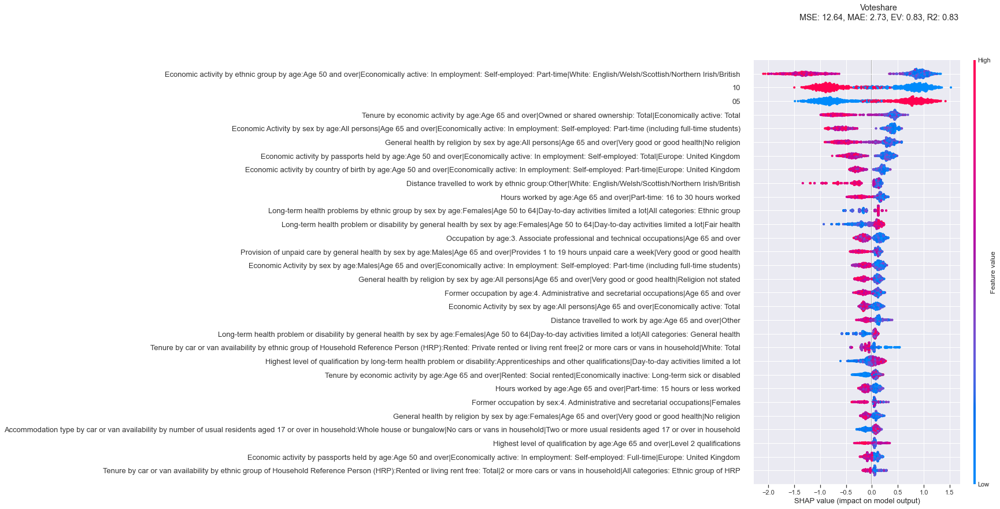

(223,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [01:27<00:00,  1.14trial/s, best loss: -0.6677973164813369]
{'n_comp_FA': 11.0, 'threshold': 0.015886464123938904}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.578
Model:                            OLS   Adj. R-squared:                  0.577
Method:                 Least Squares   F-statistic:                     519.8
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          8.33e-213
Time:                        19:19:04   Log-Likelihood:                -3595.5
No. Observations:                1144   AIC:                             7199.
Df Residuals:                    1140   BIC:                             7219.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.0776      0.235     94.008      0.000      21.617      22.538
0             -5.2097      0.166    -31.372      0.000      -5.535      -4.884
1              3.6568      0.166     22.019      0.000       3.331       3.983
10            -3.1584      0.332     -9.510      0.000      -3.810      -2.507
==============================================================================
Omnibus:                        4.461   Durbin-Watson:                   1.849
Prob(Omnibus):                  0.107   Jarque-Bera (JB):                4.532
Skew:                          -0.144   Prob(JB):                        0.104
Kurtosis:                       2.890   Cond. No.                         2.62
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lab ['10', '15']


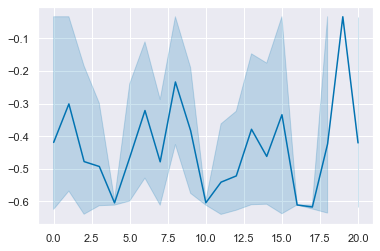

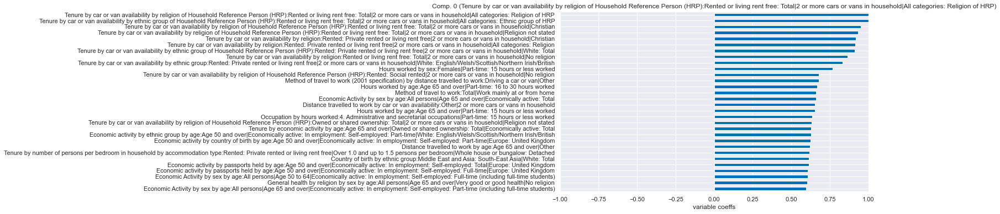

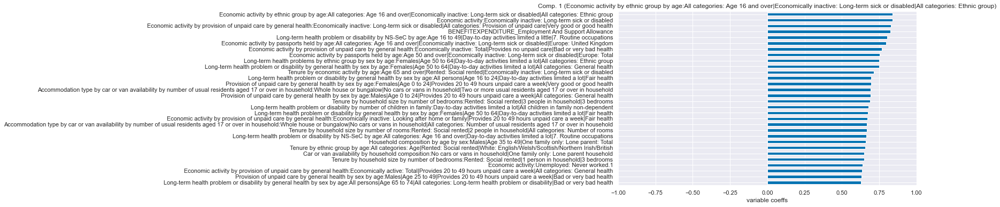

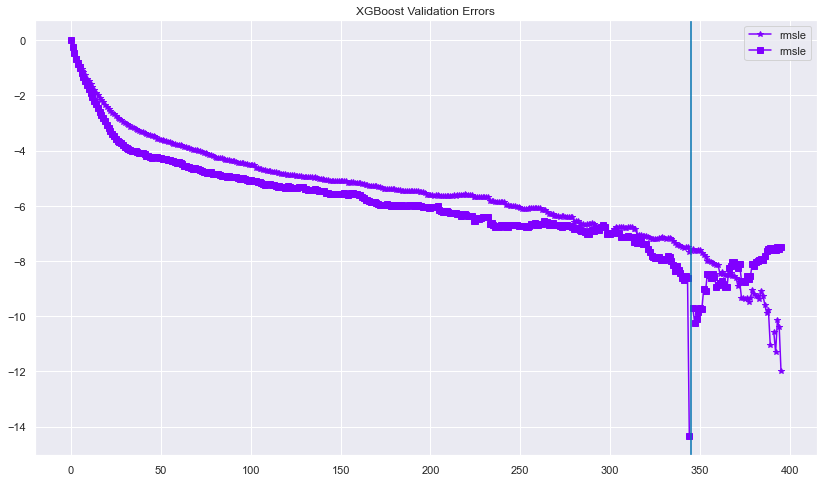

MSE: 7.74, MAE: 2.13, EV: 0.92, R2: 0.92


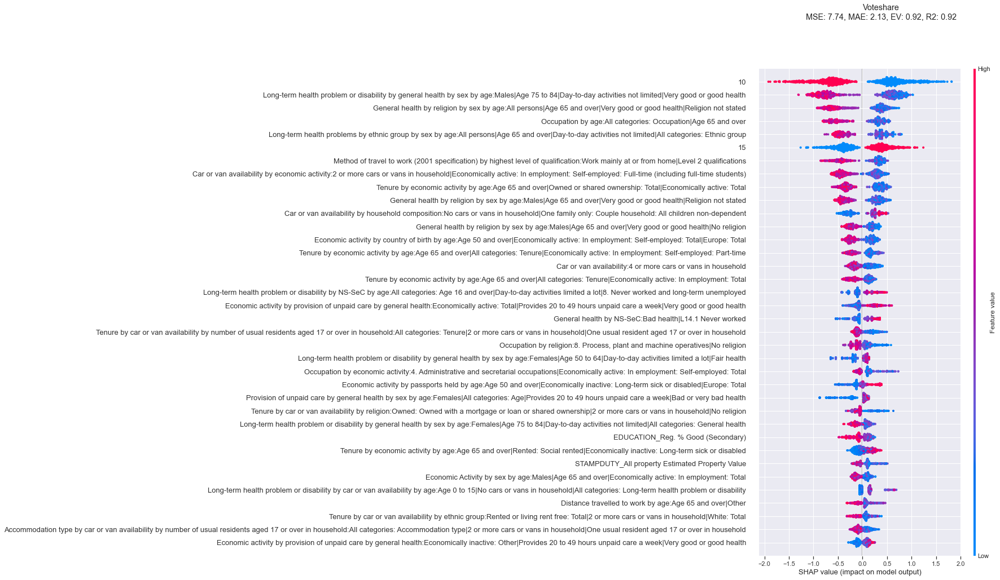

(224,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [01:35<00:00,  1.05trial/s, best loss: -0.7307674006506861]
{'n_comp_FA': 2.0, 'threshold': 0.03816477355733927}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.602
Model:                            OLS   Adj. R-squared:                  0.602
Method:                 Least Squares   F-statistic:                     863.9
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          3.59e-229
Time:                        19:26:23   Log-Likelihood:                -3680.6
No. Observations:                1144   AIC:                             7367.
Df Residuals:                    1141   BIC:                             7382.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         16.5601      0.152    108.981      0.000      16.262      16.858
0             -7.3364      0.179    -41.031      0.000      -7.687      -6.986
1              2.3592      0.152     15.526      0.000       2.061       2.657
15             7.1005      0.084     84.240      0.000       6.935       7.266
==============================================================================
Omnibus:                        6.860   Durbin-Watson:                   1.804
Prob(Omnibus):                  0.032   Jarque-Bera (JB):                7.091
Skew:                          -0.145   Prob(JB):                       0.0289
Kurtosis:                       3.254   Cond. No.                     1.07e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.49e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lab ['15', '17']


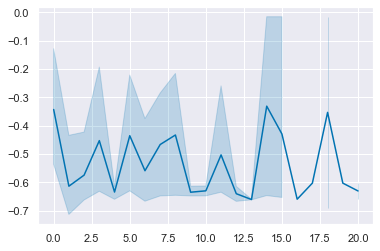

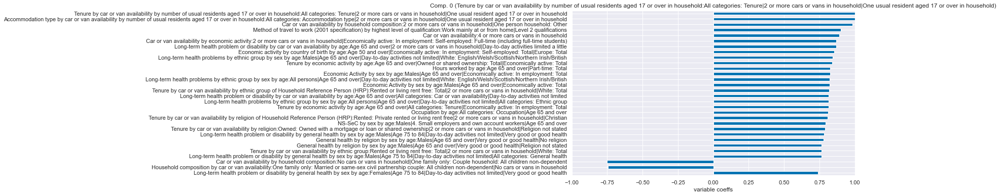

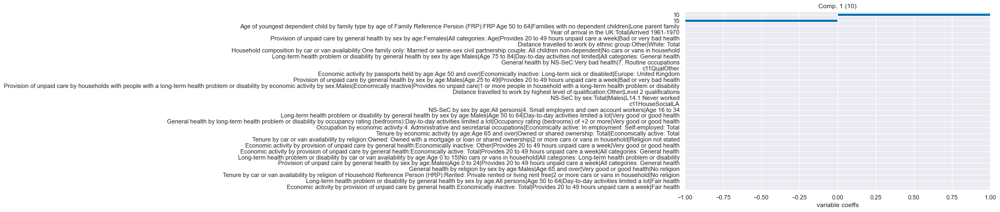

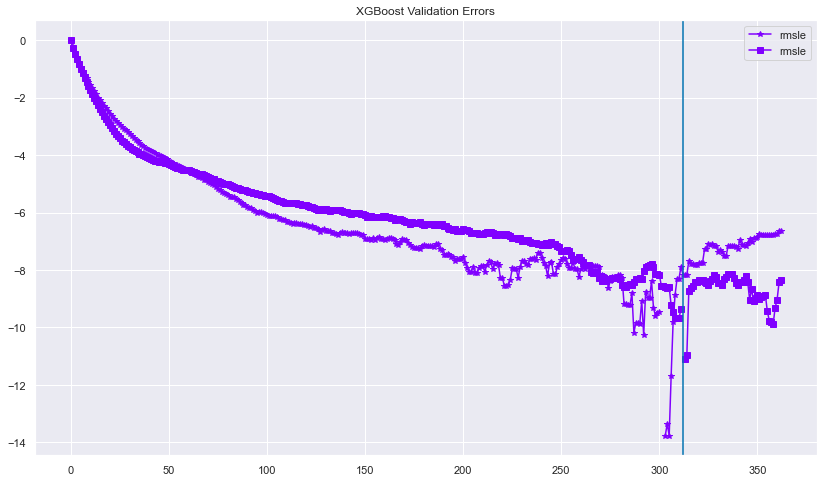

MSE: 10.62, MAE: 2.37, EV: 0.92, R2: 0.92


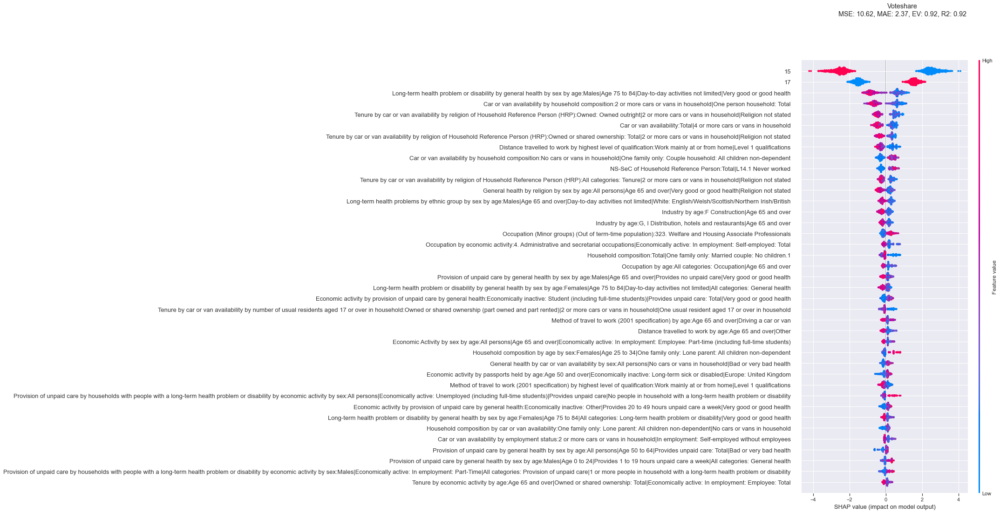

(281,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:54<00:00,  1.82trial/s, best loss: -0.7522491042055417]
{'n_comp_FA': 17.0, 'threshold': 0.019218170195083983}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.762
Model:                            OLS   Adj. R-squared:                  0.762
Method:                 Least Squares   F-statistic:                     1219.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        19:32:39   Log-Likelihood:                -3589.0
No. Observations:                1144   AIC:                             7186.
Df Residuals:                    1140   BIC:                             7206.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.3014      0.234     91.220      0.000      20.843      21.760
0              2.7036      0.165     16.373      0.000       2.380       3.028
1             -8.6949      0.165    -52.650      0.000      -9.019      -8.371
17             8.2022      0.330     24.837      0.000       7.554       8.850
==============================================================================
Omnibus:                       29.851   Durbin-Watson:                   1.749
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               66.015
Skew:                          -0.042   Prob(JB):                     4.62e-15
Kurtosis:                       4.174   Cond. No.                         2.62
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lab ['17', '19']


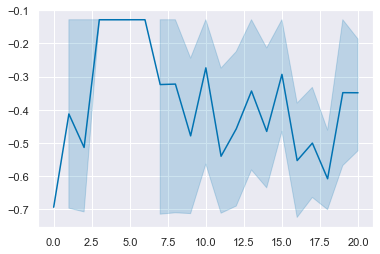

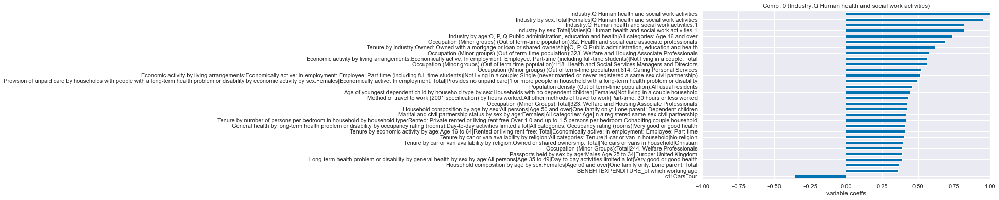

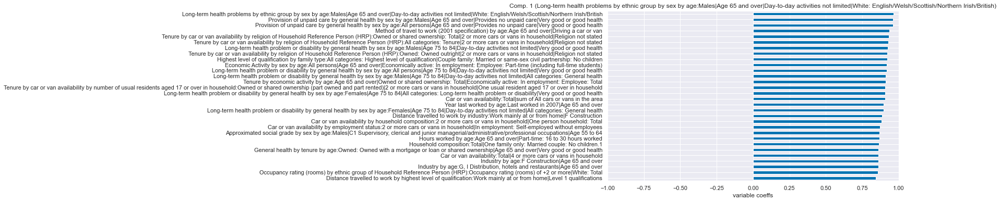

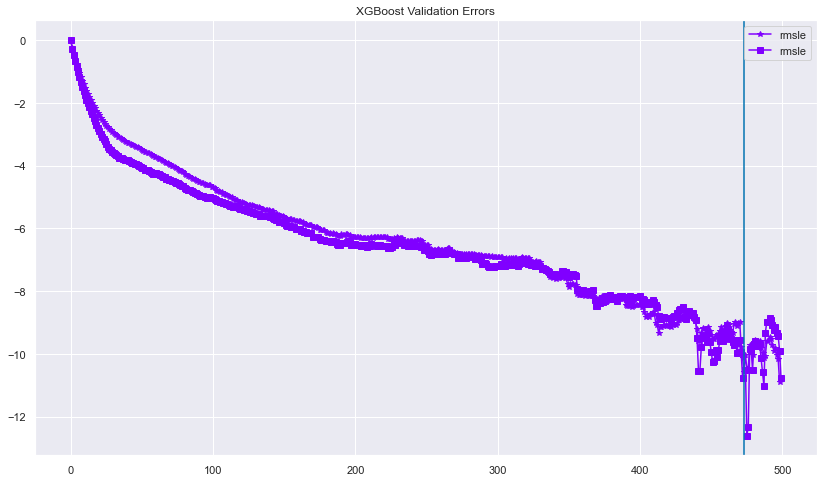

MSE: 14.62, MAE: 2.87, EV: 0.89, R2: 0.89


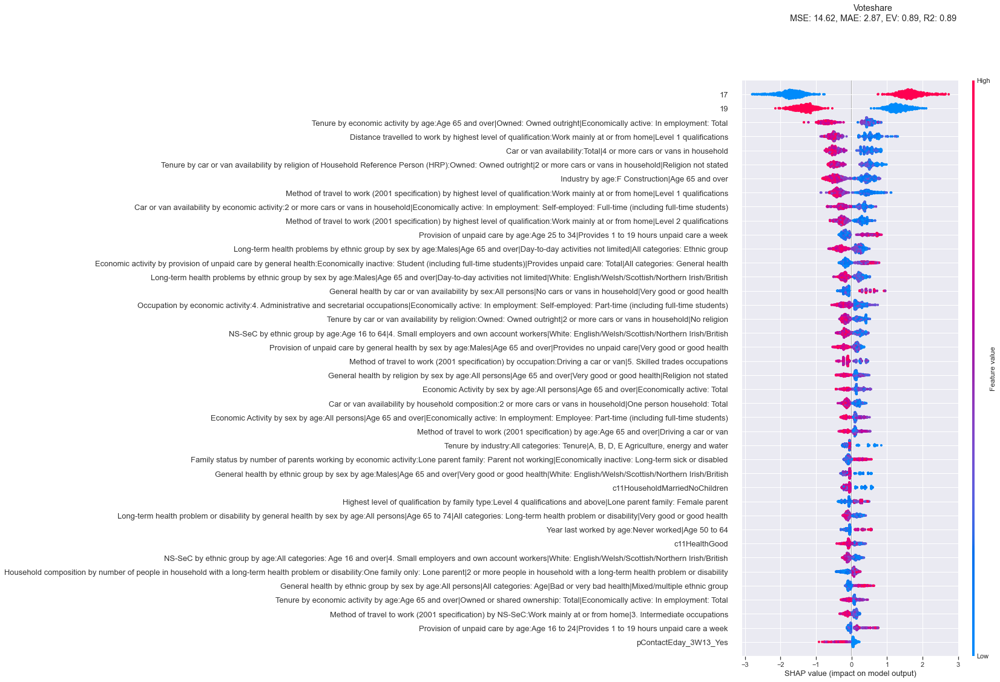

(318,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:48<00:00,  2.04trial/s, best loss: -0.6954031208132018]
{'n_comp_FA': 0.0, 'threshold': 0.041033541853389435}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.545
Model:                            OLS   Adj. R-squared:                  0.544
Method:                 Least Squares   F-statistic:                     683.9
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          6.04e-196
Time:                        19:40:49   Log-Likelihood:                -3970.9
No. Observations:                1144   AIC:                             7948.
Df Residuals:                    1141   BIC:                             7963.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.5305      0.196    115.041      0.000      22.146      22.915
0             -7.9458      0.230    -34.479      0.000      -8.398      -7.494
1              6.9731      0.196     35.605      0.000       6.589       7.357
19             7.7787      0.109     71.602      0.000       7.566       7.992
==============================================================================
Omnibus:                        8.881   Durbin-Watson:                   1.883
Prob(Omnibus):                  0.012   Jarque-Bera (JB):               12.505
Skew:                           0.005   Prob(JB):                      0.00193
Kurtosis:                       3.512   Cond. No.                     1.39e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 8.9e-30. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lab ['05', '10', '15']


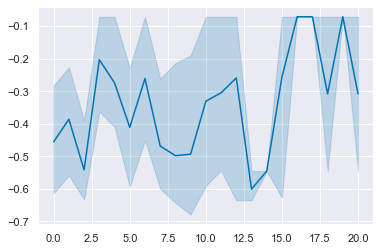

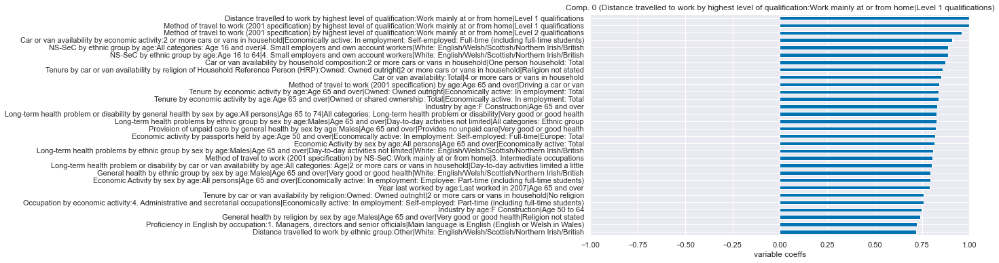

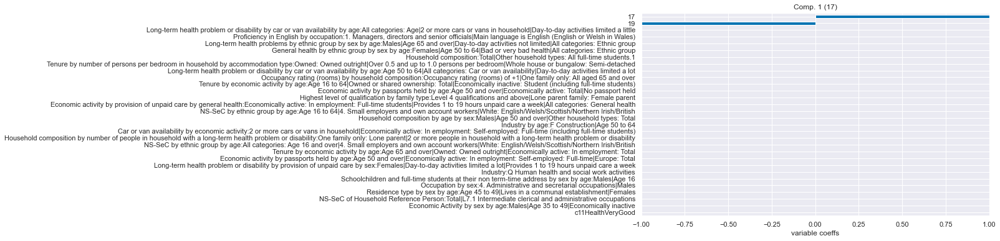

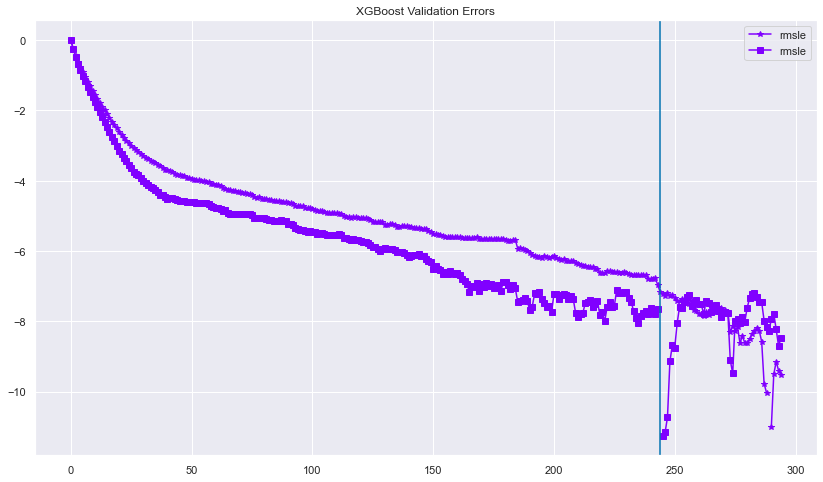

MSE: 9.91, MAE: 2.36, EV: 0.88, R2: 0.88


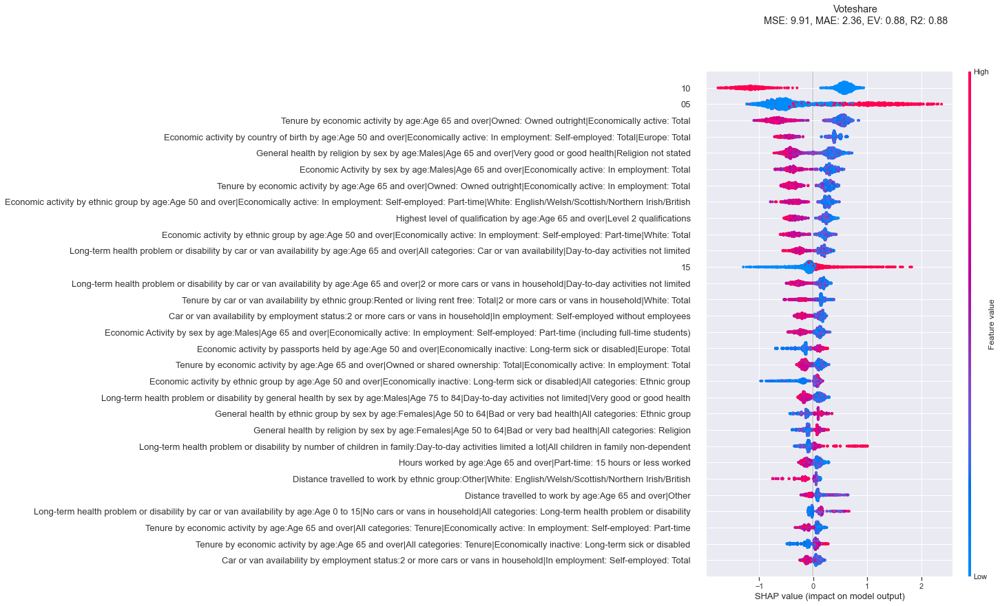

(222,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [05:05<00:00,  3.06s/trial, best loss: -0.6779949451879399]
{'n_comp_FA': 15.0, 'threshold': 0.02293243641277342}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.597
Model:                            OLS   Adj. R-squared:                  0.596
Method:                 Least Squares   F-statistic:                     633.4
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        19:50:53   Log-Likelihood:                -5444.0
No. Observations:                1716   AIC:                         1.090e+04
Df Residuals:                    1711   BIC:                         1.093e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.0776      0.242     91.297      0.000      21.603      22.552
0             -6.8763      0.140    -49.252      0.000      -7.150      -6.602
1              0.5458      0.140      3.909      0.000       0.272       0.820
10            -3.1584      0.342     -9.235      0.000      -3.829      -2.488
15            -0.7763      0.342     -2.270      0.023      -1.447      -0.106
==============================================================================
Omnibus:                       42.929   Durbin-Watson:                   1.817
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               54.930
Skew:                           0.298   Prob(JB):                     1.18e-12
Kurtosis:                       3.642   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lab ['10', '15', '17']


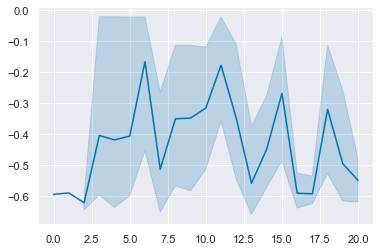

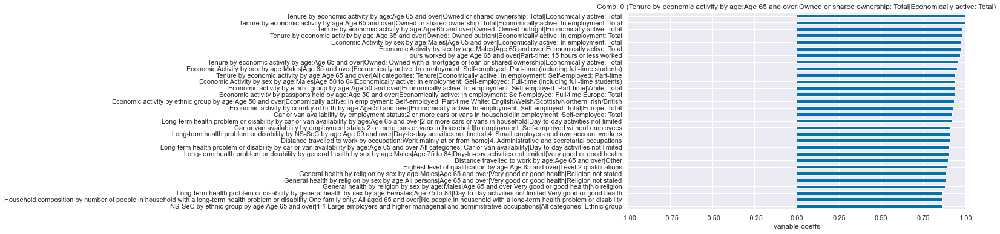

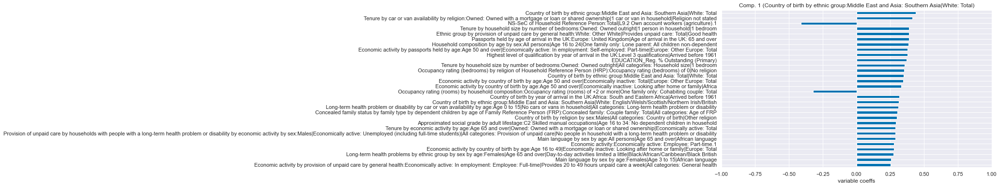

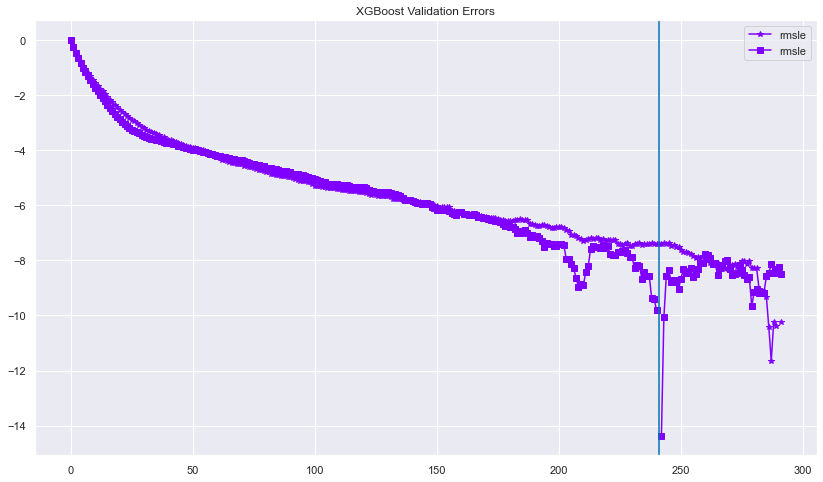

MSE: 10.04, MAE: 2.34, EV: 0.92, R2: 0.92


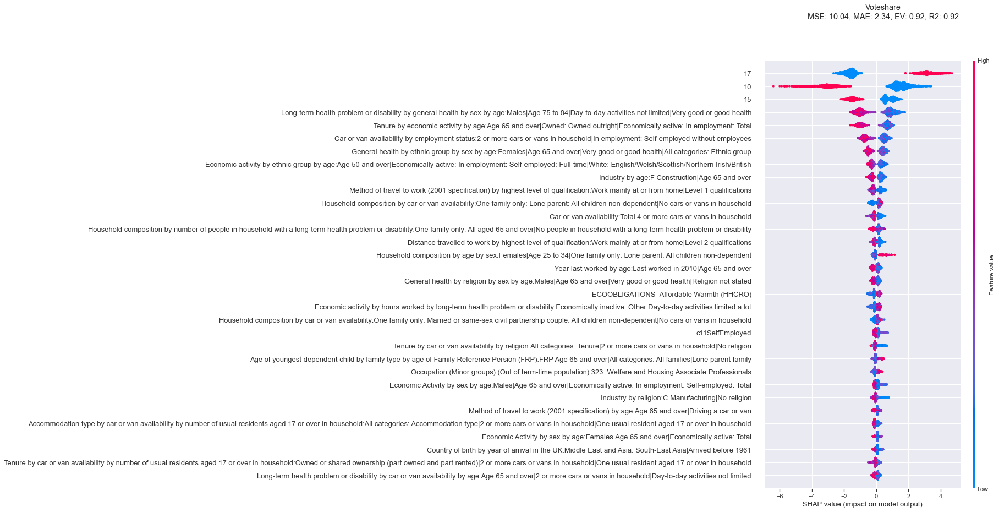

(236,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [01:17<00:00,  1.29trial/s, best loss: -0.7592476211931726]
{'n_comp_FA': 3.0, 'threshold': 0.033402281365703015}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.665
Model:                            OLS   Adj. R-squared:                  0.664
Method:                 Least Squares   F-statistic:                     847.5
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        19:57:08   Log-Likelihood:                -5631.8
No. Observations:                1716   AIC:                         1.127e+04
Df Residuals:                    1711   BIC:                         1.130e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.9192      0.270     70.124      0.000      18.390      19.448
0             -7.7765      0.156    -49.924      0.000      -8.082      -7.471
1              1.1072      0.156      7.108      0.000       0.802       1.413
15             2.3821      0.382      6.243      0.000       1.634       3.130
17            10.5844      0.382     27.741      0.000       9.836      11.333
==============================================================================
Omnibus:                       85.501   Durbin-Watson:                   1.799
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              111.735
Skew:                           0.480   Prob(JB):                     5.46e-25
Kurtosis:                       3.800   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lab ['15', '17', '19']


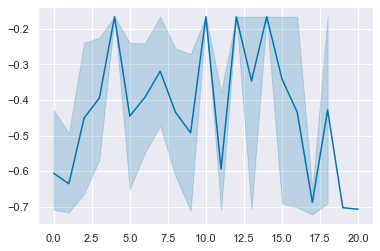

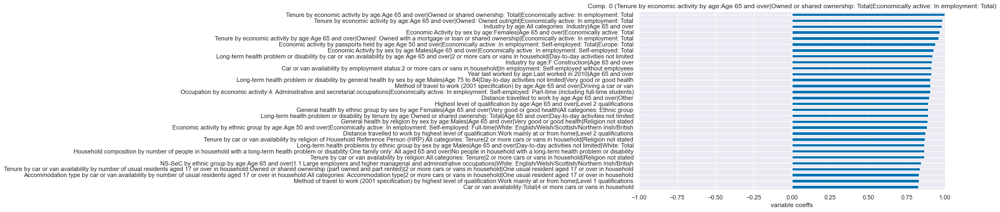

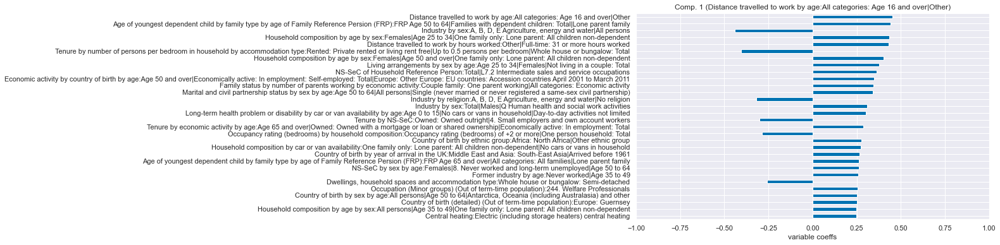

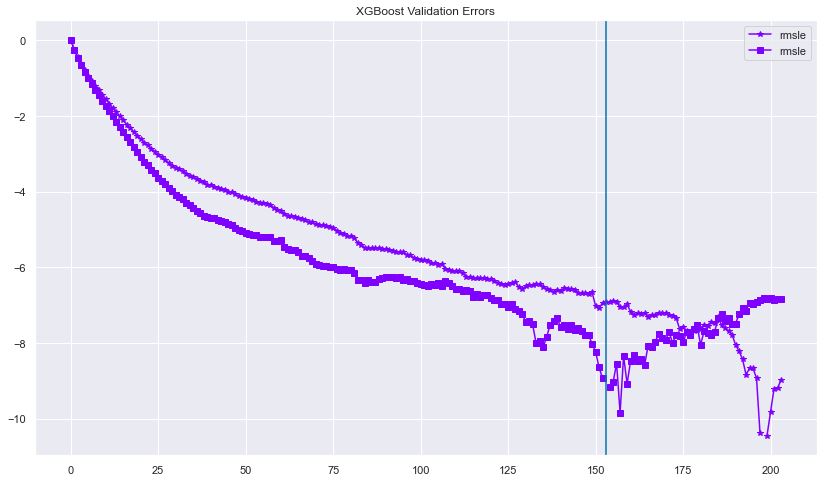

MSE: 13.65, MAE: 2.64, EV: 0.90, R2: 0.89


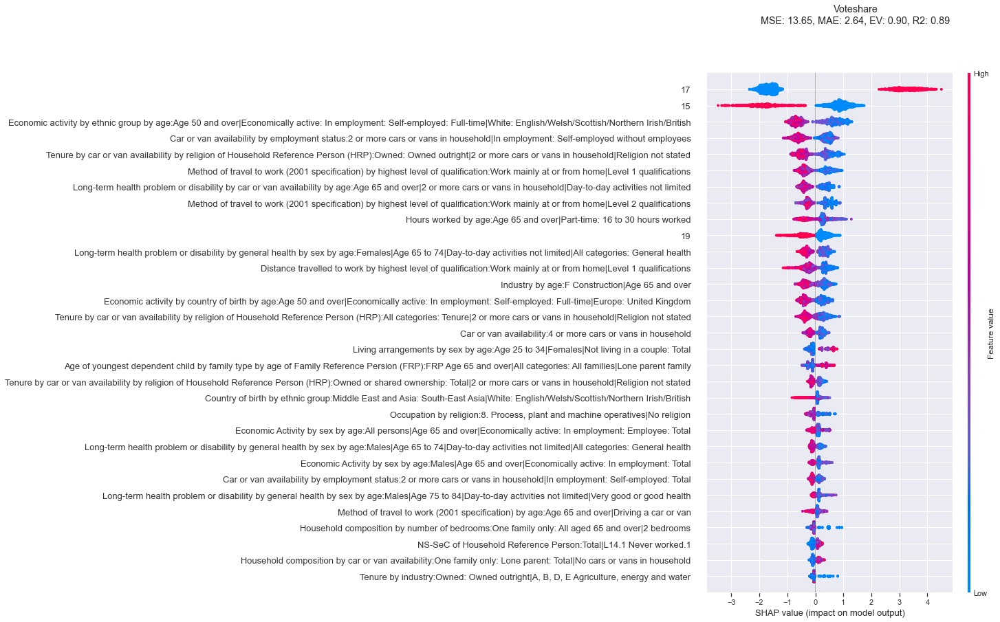

(244,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [04:16<00:00,  2.56s/trial, best loss: -0.7249982054664441]
{'n_comp_FA': 1.0, 'threshold': 0.05124651423146795}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.573
Model:                            OLS   Adj. R-squared:                  0.572
Method:                 Least Squares   F-statistic:                     765.1
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          1.71e-315
Time:                        20:04:56   Log-Likelihood:                -5865.7
No. Observations:                1716   AIC:                         1.174e+04
Df Residuals:                    1712   BIC:                         1.176e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.5768      0.220     98.044      0.000      21.145      22.008
0             -7.8061      0.178    -43.743      0.000      -8.156      -7.456
1              0.3895      0.182      2.139      0.033       0.032       0.747
17             7.3759      0.077     95.452      0.000       7.224       7.527
19             2.0346      0.437      4.655      0.000       1.177       2.892
==============================================================================
Omnibus:                       15.284   Durbin-Watson:                   1.850
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               22.971
Skew:                           0.034   Prob(JB):                     1.03e-05
Kurtosis:                       3.563   Cond. No.                     9.26e+15
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 2.67e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lab ['05', '10', '15', '17']


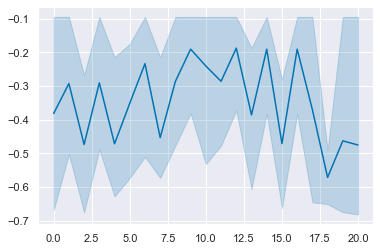

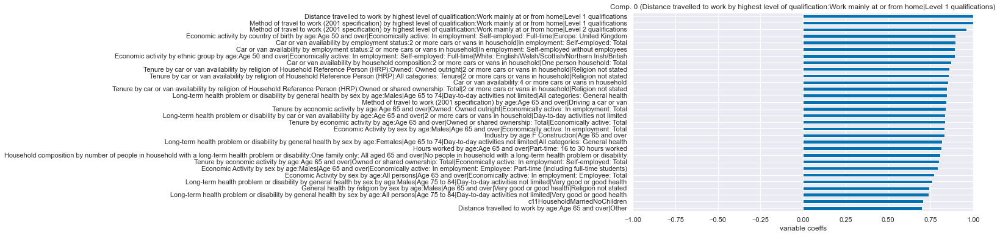

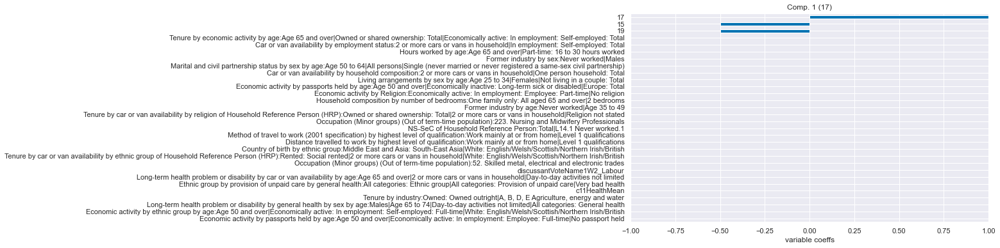

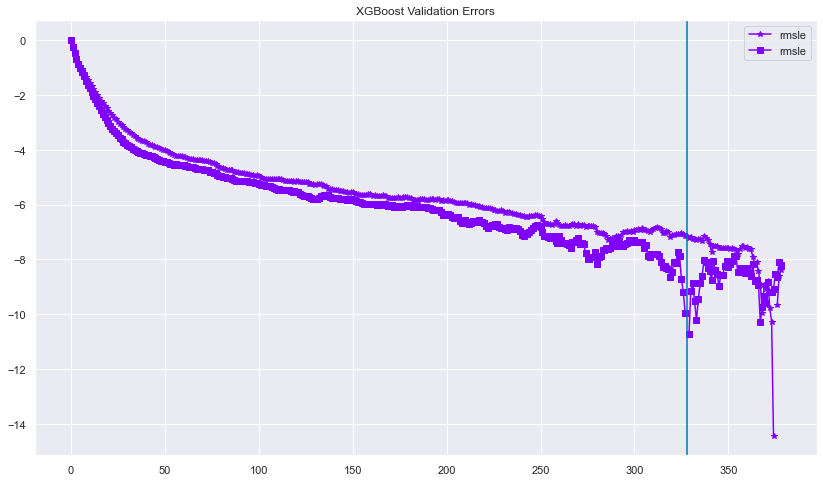

MSE: 10.53, MAE: 2.40, EV: 0.90, R2: 0.90


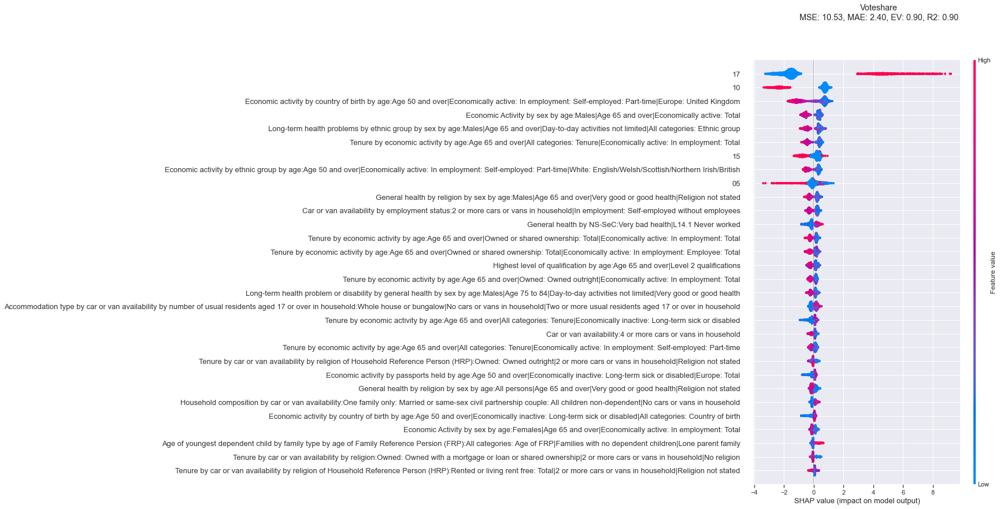

(219,) (2288, 60910)
100%|██████████████████████████████████████| 100/100 [09:16<00:00,  5.56s/trial, best loss: -0.6951289175267288]
{'n_comp_FA': 11.0, 'threshold': 0.05644214067062771}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.144
Model:                            OLS   Adj. R-squared:                  0.143
Method:                 Least Squares   F-statistic:                     128.3
Date:                Mon, 07 Feb 2022   Prob (F-statistic):           8.05e-77
Time:                        20:21:17   Log-Likelihood:                -8431.3
No. Observations:                2288   AIC:                         1.687e+04
Df Residuals:                    2284   BIC:                         1.689e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         19.0880      0.176    108.319      0.000      18.742      19.434
0             -0.3561      0.172     -2.072      0.038      -0.693      -0.019
1             -1.9180      0.190    -10.121      0.000      -2.290      -1.546
10             2.2789      0.149     15.341      0.000       1.988       2.570
15             2.7553      0.149     18.549      0.000       2.464       3.047
17            10.4156      0.383     27.213      0.000       9.665      11.166
==============================================================================
Omnibus:                       84.151   Durbin-Watson:                   1.613
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               39.767
Skew:                           0.087   Prob(JB):                     2.32e-09
Kurtosis:                       2.378   Cond. No.                     1.48e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.3e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lab ['10', '15', '17', '19']


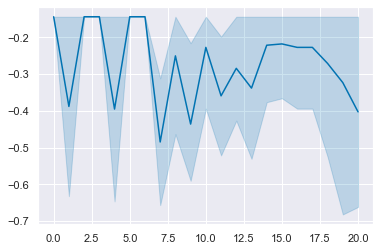

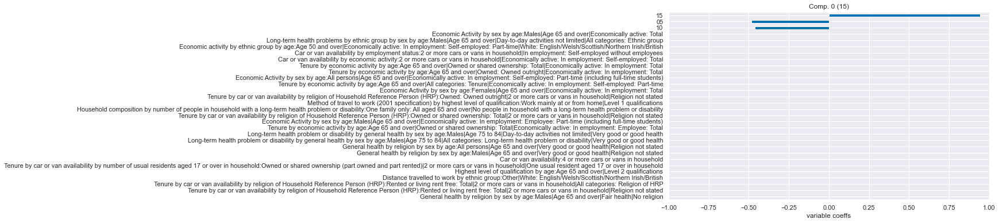

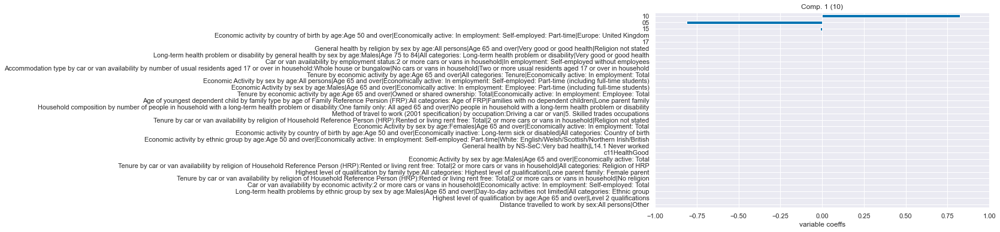

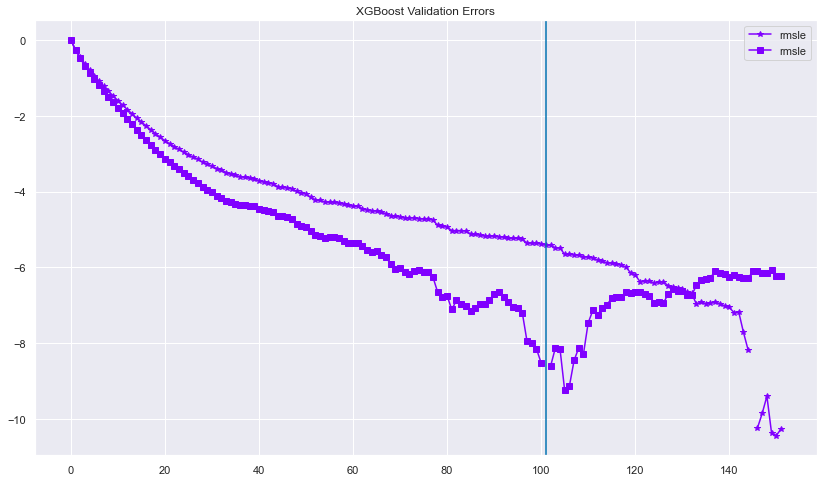

MSE: 10.59, MAE: 2.44, EV: 0.91, R2: 0.91


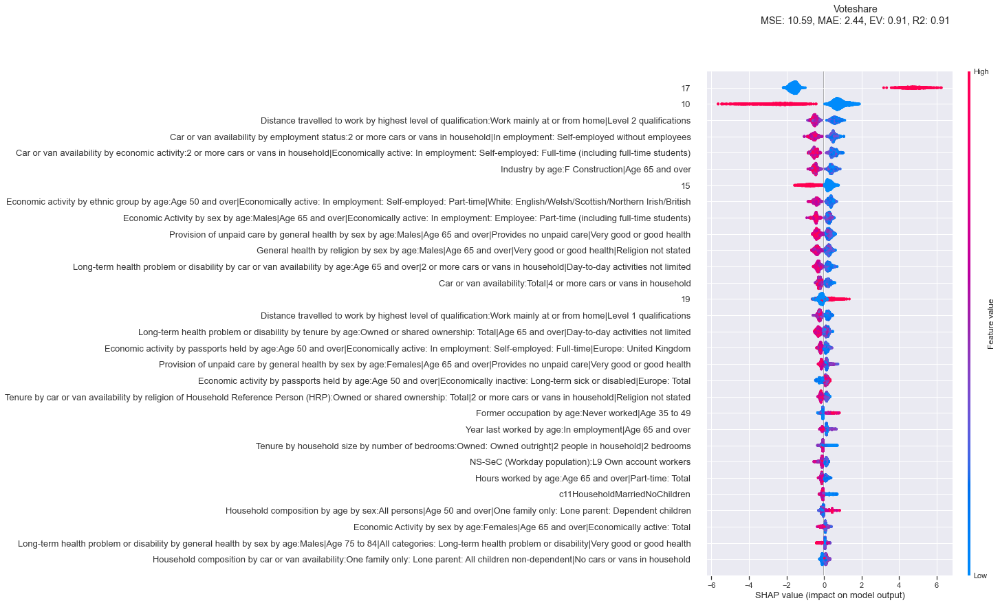

(237,) (2288, 60910)
100%|██████████████████████████████████████| 100/100 [01:51<00:00,  1.12s/trial, best loss: -0.7345119676603147]
{'n_comp_FA': 9.0, 'threshold': 0.019459907189722174}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.733
Model:                            OLS   Adj. R-squared:                  0.732
Method:                 Least Squares   F-statistic:                     1251.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        20:26:07   Log-Likelihood:                -7236.7
No. Observations:                2288   AIC:                         1.449e+04
Df Residuals:                    2282   BIC:                         1.452e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         18.9192      0.239     79.001      0.000      18.450      19.389
0             -8.5682      0.120    -71.551      0.000      -8.803      -8.333
1              0.9465      0.120      7.902      0.000       0.712       1.181
15             2.3821      0.339      7.034      0.000       1.718       3.046
17            10.5844      0.339     31.252      0.000       9.920      11.249
19             4.4168      0.339     13.041      0.000       3.753       5.081
==============================================================================
Omnibus:                       27.349   Durbin-Watson:                   1.779
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               35.378
Skew:                           0.167   Prob(JB):                     2.08e-08
Kurtosis:                       3.509   Cond. No.                         4.79
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lab ['05', '10', '15', '17', '19']


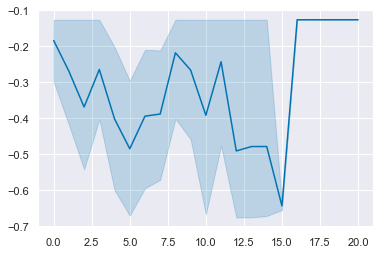

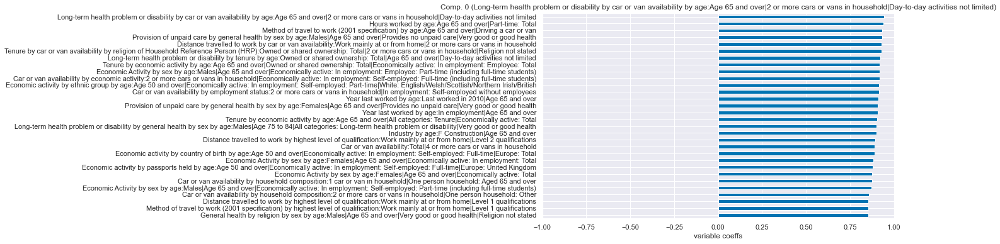

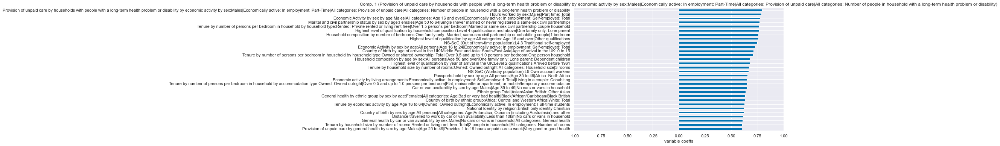

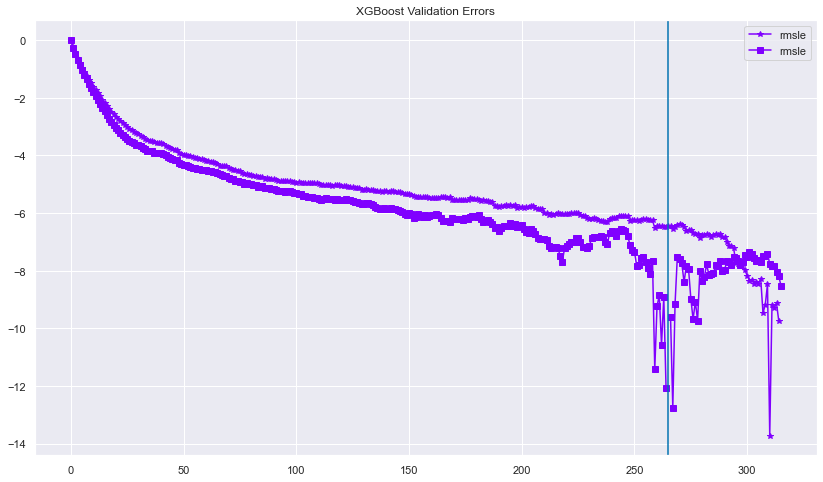

MSE: 13.32, MAE: 2.70, EV: 0.88, R2: 0.88


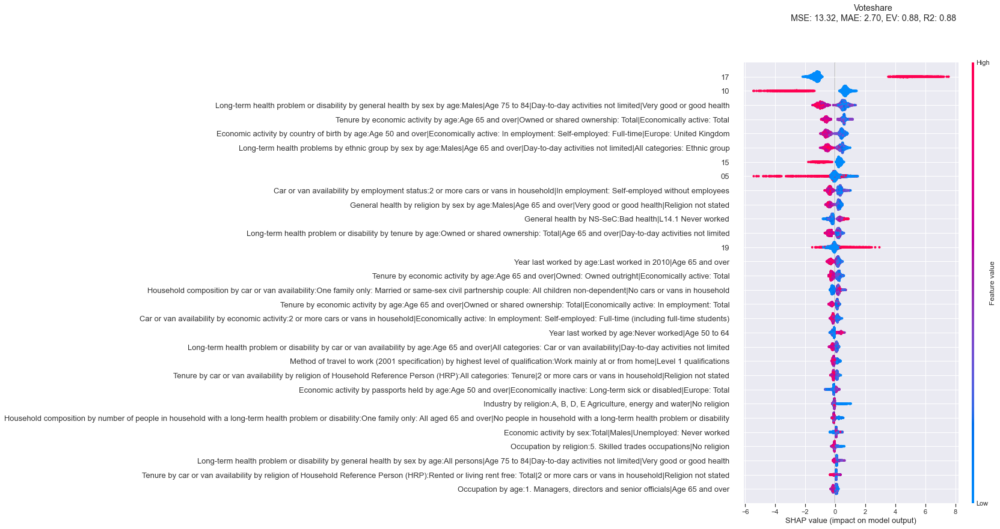

(225,) (2860, 60911)
100%|██████████████████████████████████████| 100/100 [11:49<00:00,  7.10s/trial, best loss: -0.6865902926525813]
{'n_comp_FA': 7.0, 'threshold': 0.026332138005378883}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.684
Model:                            OLS   Adj. R-squared:                  0.683
Method:                 Least Squares   F-statistic:                     1028.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        20:44:35   Log-Likelihood:                -9141.5
No. Observations:                2860   AIC:                         1.830e+04
Df Residuals:                    2853   BIC:                         1.834e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         22.0776      0.248     89.168      0.000      21.592      22.563
0             -7.5428      0.111    -68.119      0.000      -7.760      -7.326
1              2.4867      0.111     22.452      0.000       2.270       2.704
10            -3.1584      0.350     -9.020      0.000      -3.845      -2.472
15            -0.7763      0.350     -2.217      0.027      -1.463      -0.090
17             7.4260      0.350     21.208      0.000       6.739       8.113
19             1.2584      0.350      3.594      0.000       0.572       1.945
==============================================================================
Omnibus:                       31.811   Durbin-Watson:                   1.784
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               40.552
Skew:                           0.165   Prob(JB):                     1.56e-09
Kurtosis:                       3.481   Cond. No.                         5.83
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lib_Left ['05', '10']


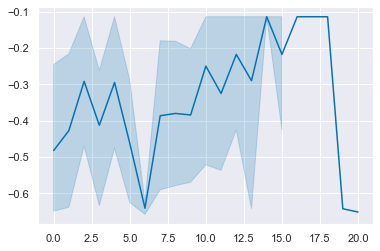

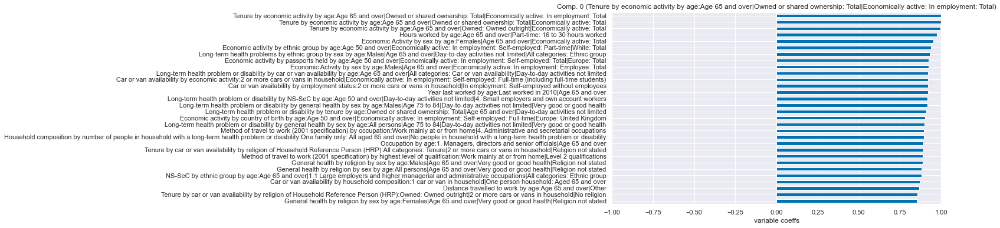

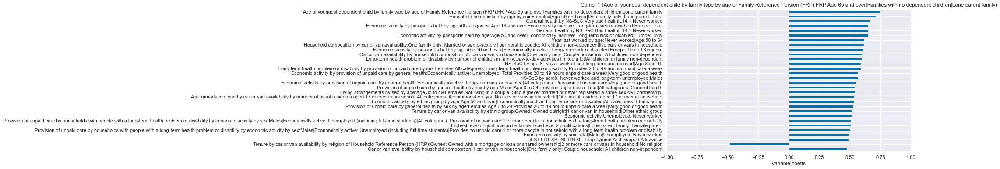

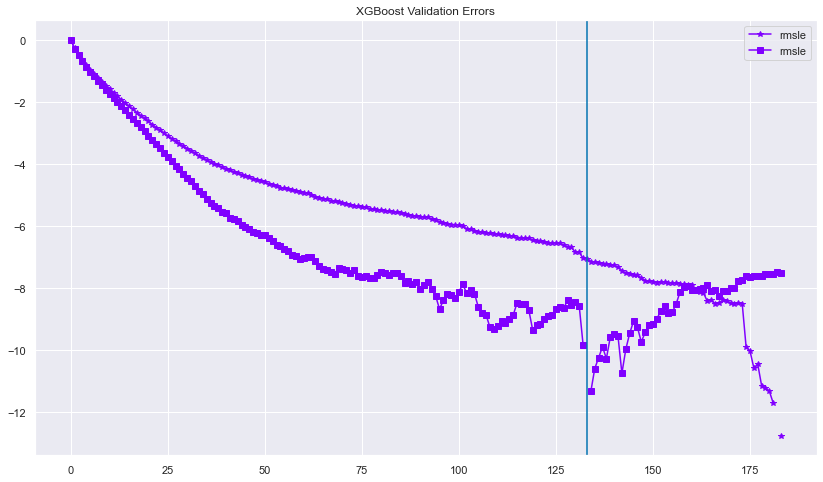

MSE: 14.64, MAE: 2.73, EV: 0.70, R2: 0.70


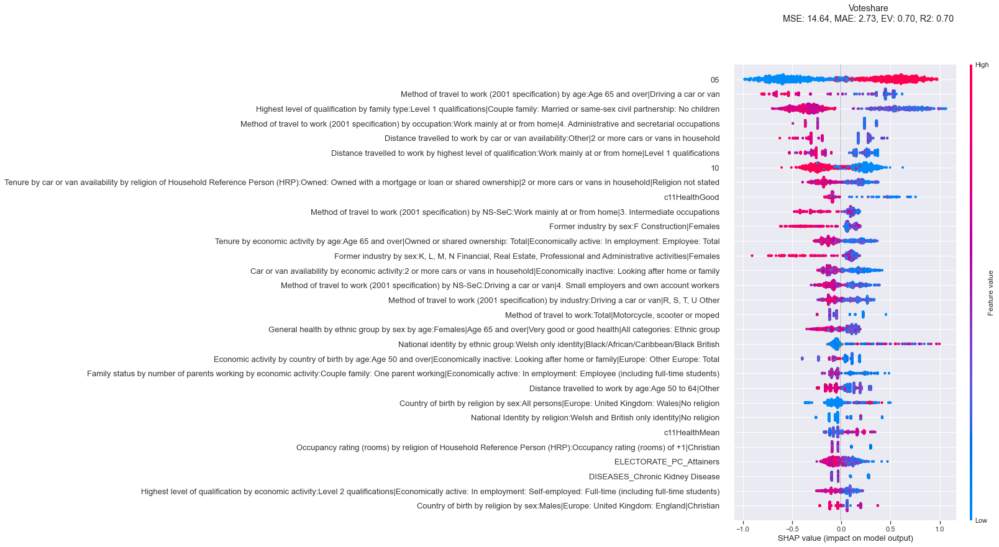

(254,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:42<00:00,  2.37trial/s, best loss: -0.4169031345981855]
{'n_comp_FA': 3.0, 'threshold': 0.07900123004116419}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.406
Model:                            OLS   Adj. R-squared:                  0.405
Method:                 Least Squares   F-statistic:                     389.8
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          9.44e-130
Time:                        20:47:59   Log-Likelihood:                -3544.4
No. Observations:                1144   AIC:                             7095.
Df Residuals:                    1141   BIC:                             7110.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.4247      0.135    225.545      0.000      30.160      30.689
0              6.6338      0.135     49.178      0.000       6.369       6.899
1             -4.3805      0.159    -27.585      0.000      -4.692      -4.069
10            11.8954      0.075    158.975      0.000      11.749      12.042
==============================================================================
Omnibus:                       35.562   Durbin-Watson:                   1.721
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               87.407
Skew:                           0.024   Prob(JB):                     1.05e-19
Kurtosis:                       4.353   Cond. No.                     1.51e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 7.51e-30. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['10', '15']


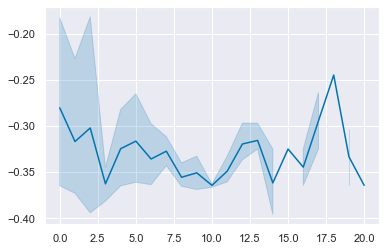

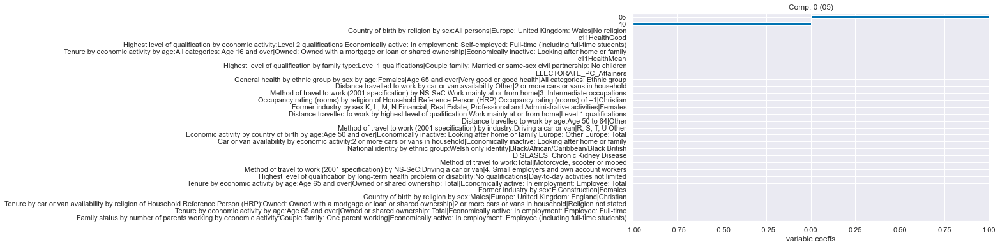

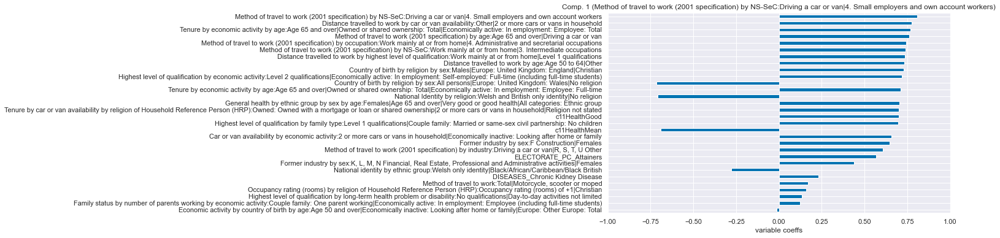

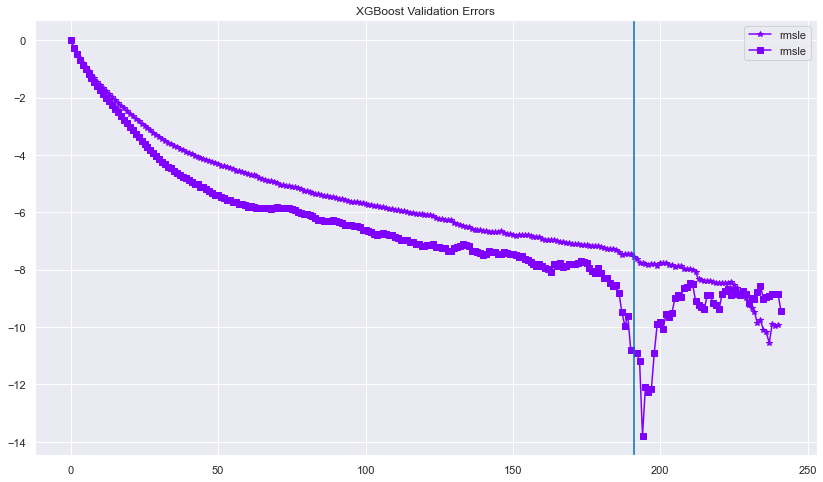

MSE: 15.65, MAE: 2.83, EV: 0.81, R2: 0.81


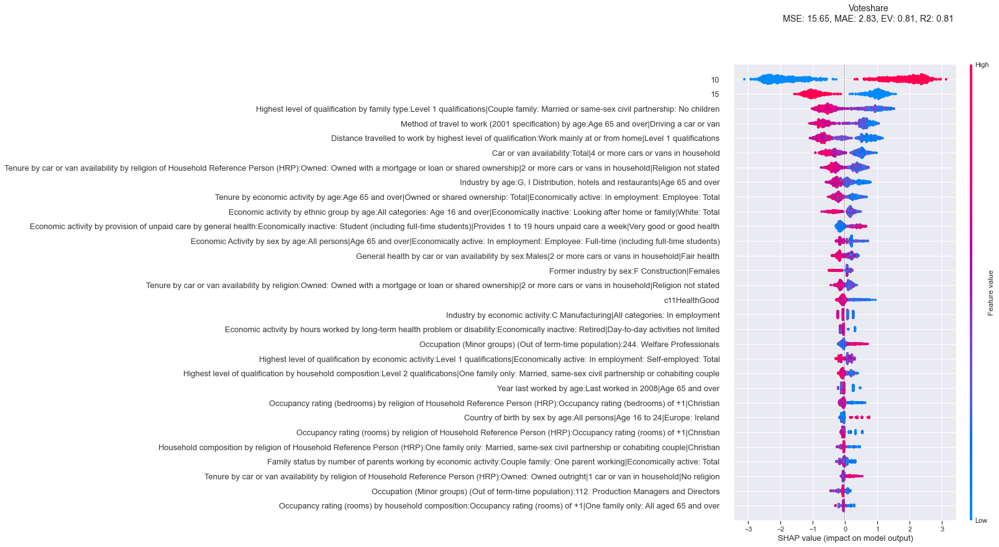

(250,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [01:19<00:00,  1.26trial/s, best loss: -0.5690308784069389]
{'n_comp_FA': 2.0, 'threshold': 0.05446473151553342}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.450
Model:                            OLS   Adj. R-squared:                  0.449
Method:                 Least Squares   F-statistic:                     467.3
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          5.61e-149
Time:                        20:52:51   Log-Likelihood:                -3792.2
No. Observations:                1144   AIC:                             7590.
Df Residuals:                    1141   BIC:                             7606.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.7885      0.168    165.870      0.000      27.460      28.117
0             -5.2692      0.197    -26.729      0.000      -5.656      -4.882
1              7.8977      0.168     47.142      0.000       7.569       8.226
15             9.9454      0.093    107.020      0.000       9.763      10.128
==============================================================================
Omnibus:                       99.991   Durbin-Watson:                   1.821
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              149.494
Skew:                           0.657   Prob(JB):                     3.45e-33
Kurtosis:                       4.187   Cond. No.                     1.58e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 6.87e-30. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['15', '17']


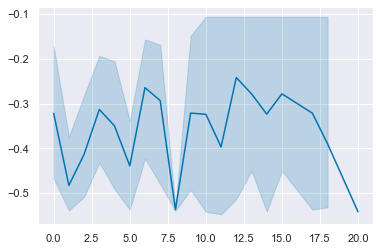

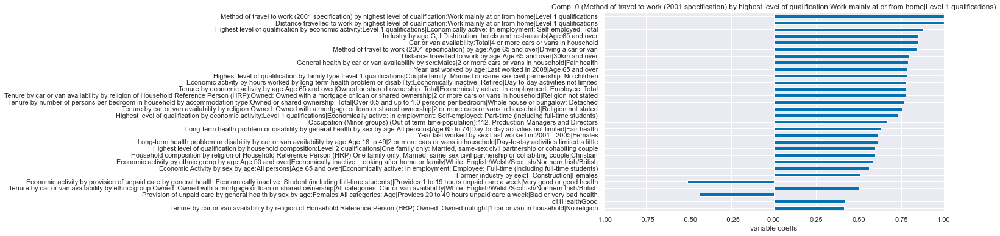

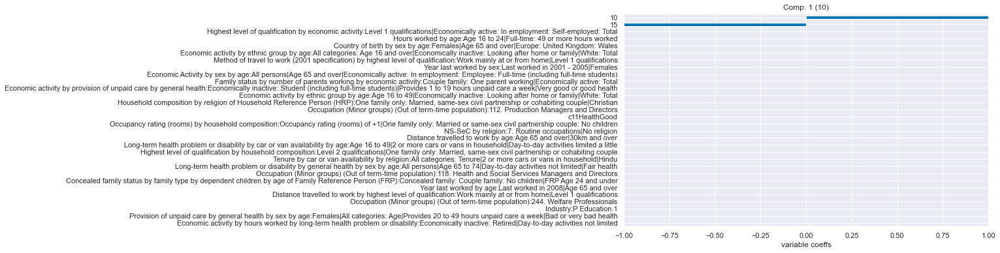

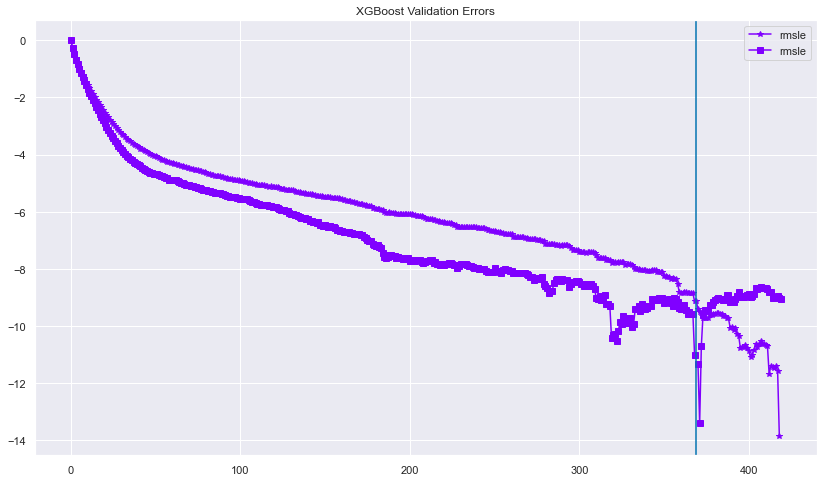

MSE: 9.89, MAE: 2.41, EV: 0.91, R2: 0.91


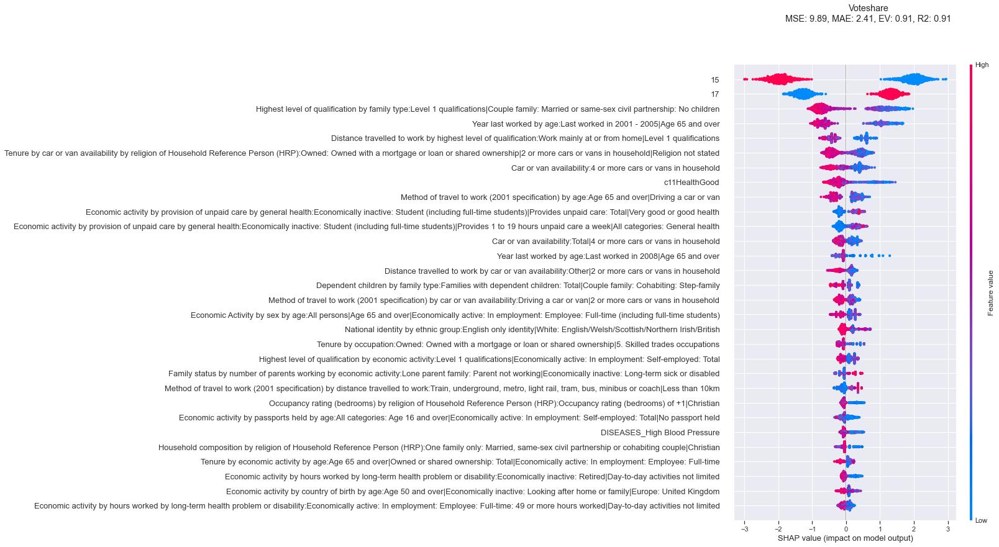

(266,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:36<00:00,  2.72trial/s, best loss: -0.6622089528087827]
{'n_comp_FA': 1.0, 'threshold': 0.06347323887454395}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.544
Model:                            OLS   Adj. R-squared:                  0.543
Method:                 Least Squares   F-statistic:                     680.8
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          2.55e-195
Time:                        20:59:34   Log-Likelihood:                -3833.0
No. Observations:                1144   AIC:                             7672.
Df Residuals:                    1141   BIC:                             7687.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         27.0450      0.174    155.778      0.000      26.704      27.386
0             -6.7907      0.204    -33.241      0.000      -7.192      -6.390
1              2.7911      0.174     16.077      0.000       2.450       3.132
17            12.1270      0.096    125.925      0.000      11.938      12.316
==============================================================================
Omnibus:                       67.927   Durbin-Watson:                   1.859
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               95.151
Skew:                           0.510   Prob(JB):                     2.18e-21
Kurtosis:                       3.978   Cond. No.                     5.86e+15
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is  5e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['17', '19']


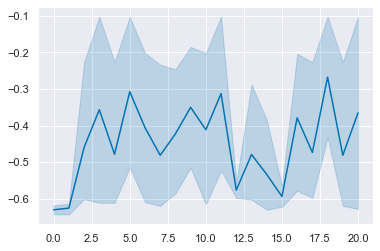

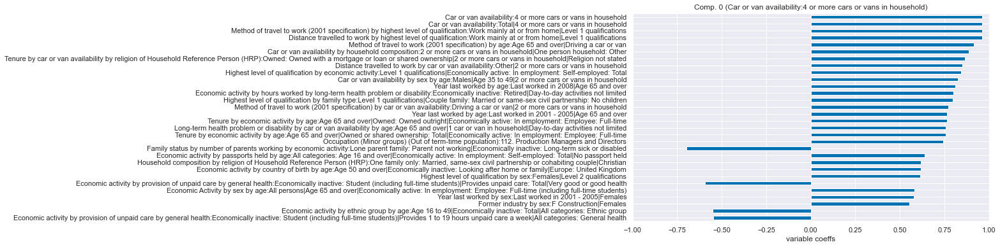

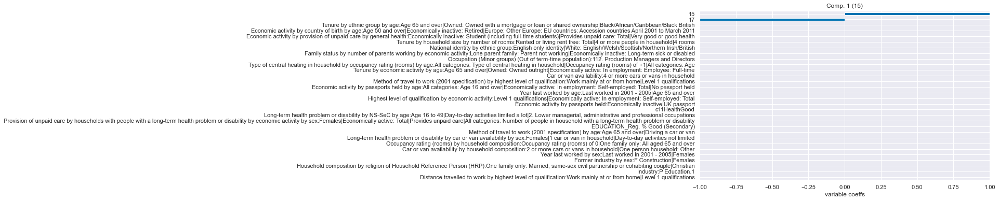

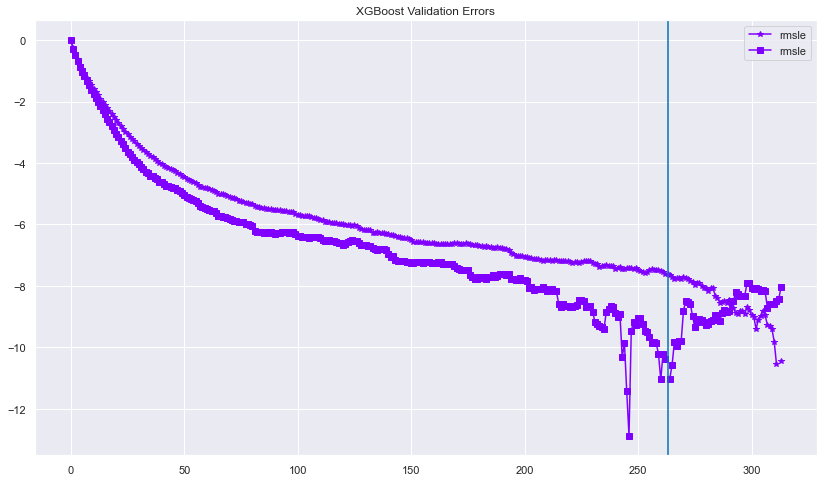

MSE: 14.26, MAE: 2.54, EV: 0.86, R2: 0.86


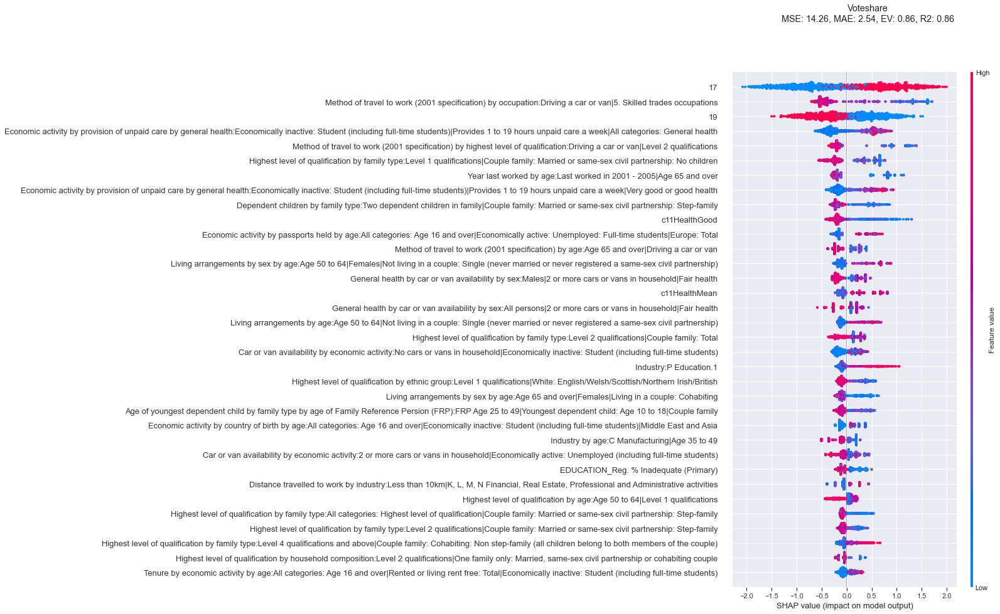

(283,) (1144, 60908)
100%|███████████████████████████████████████| 100/100 [00:59<00:00,  1.68trial/s, best loss: -0.664342451412149]
{'n_comp_FA': 6.0, 'threshold': 0.04035777669357181}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.266
Model:                            OLS   Adj. R-squared:                  0.265
Method:                 Least Squares   F-statistic:                     206.5
Date:                Mon, 07 Feb 2022   Prob (F-statistic):           2.83e-77
Time:                        21:05:09   Log-Likelihood:                -4062.2
No. Observations:                1144   AIC:                             8130.
Df Residuals:                    1141   BIC:                             8146.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.4069      0.212    138.628      0.000      28.991      29.823
0              4.8857      0.250     19.573      0.000       4.396       5.375
1              6.9739      0.212     32.876      0.000       6.558       7.390
19            11.2165      0.118     95.324      0.000      10.986      11.447
==============================================================================
Omnibus:                       52.118   Durbin-Watson:                   1.669
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               58.859
Skew:                           0.516   Prob(JB):                     1.66e-13
Kurtosis:                       3.413   Cond. No.                     1.10e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.41e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['05', '10', '15']


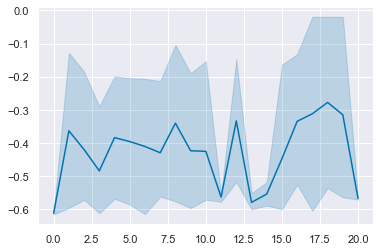

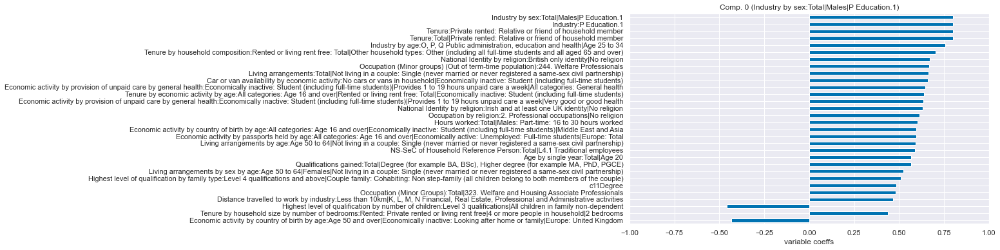

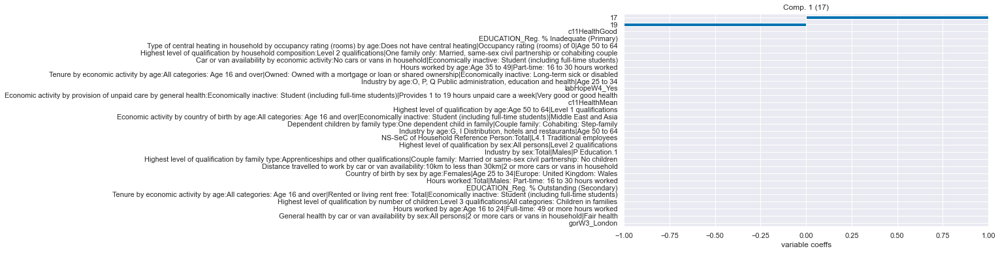

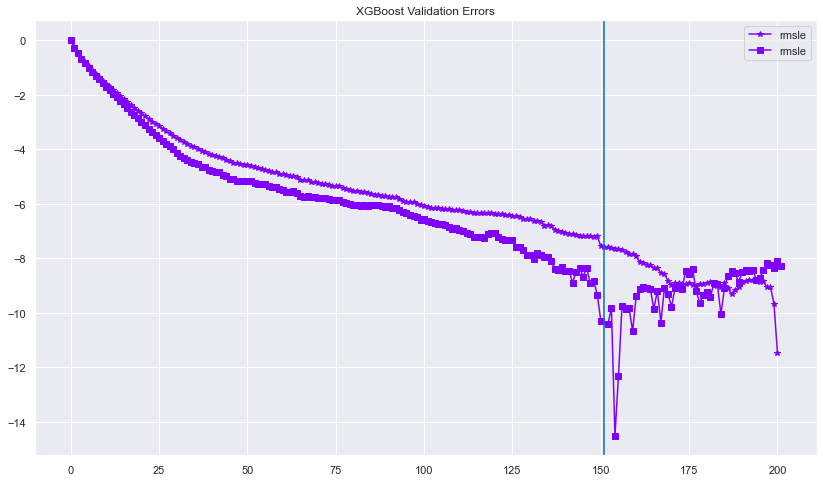

MSE: 12.16, MAE: 2.57, EV: 0.83, R2: 0.83


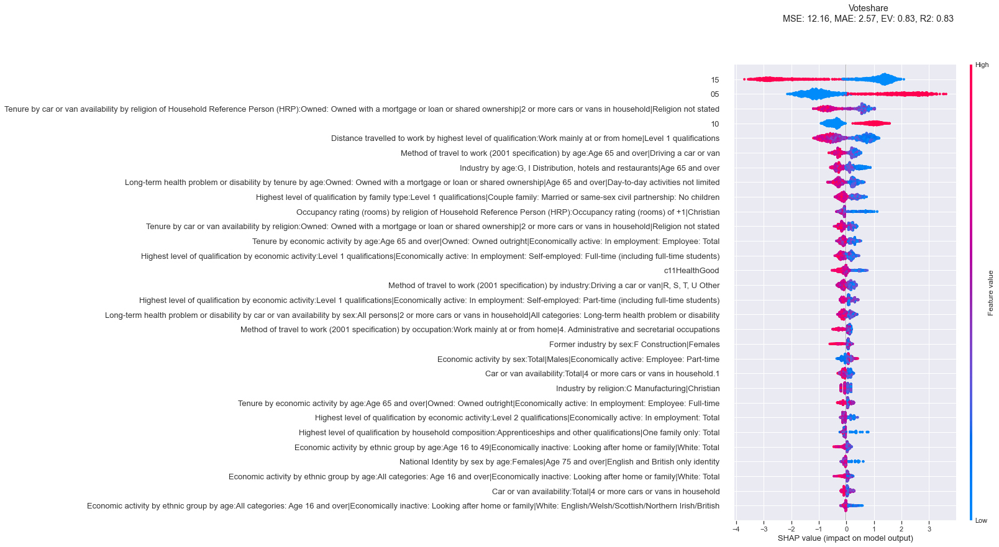

(235,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [00:31<00:00,  3.22trial/s, best loss: -0.5100400397400241]
{'n_comp_FA': 11.0, 'threshold': 0.05453511331497529}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.436
Model:                            OLS   Adj. R-squared:                  0.435
Method:                 Least Squares   F-statistic:                     441.3
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          2.43e-212
Time:                        21:09:07   Log-Likelihood:                -5609.0
No. Observations:                1716   AIC:                         1.123e+04
Df Residuals:                    1712   BIC:                         1.125e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         32.1647      0.189    169.738      0.000      31.793      32.536
0             -4.6314      0.154    -30.141      0.000      -4.933      -4.330
1             -6.9209      0.157    -44.130      0.000      -7.228      -6.613
10            -1.3723      0.376     -3.646      0.000      -2.111      -0.634
15             7.4590      0.067    112.104      0.000       7.329       7.590
==============================================================================
Omnibus:                      110.576   Durbin-Watson:                   1.826
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              188.581
Skew:                           0.484   Prob(JB):                     1.12e-41
Kurtosis:                       4.304   Cond. No.                     9.60e+15
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 2.48e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['10', '15', '17']


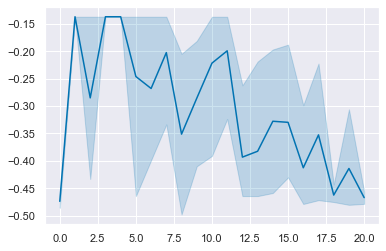

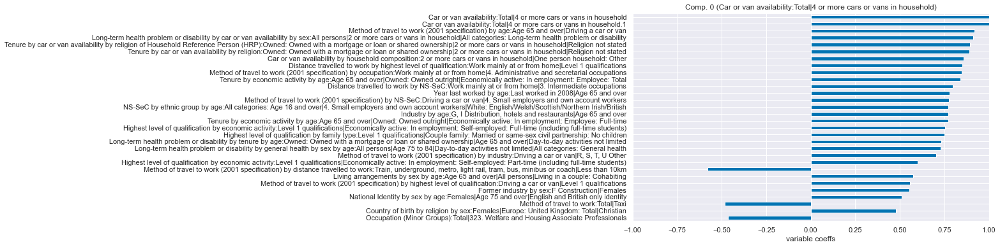

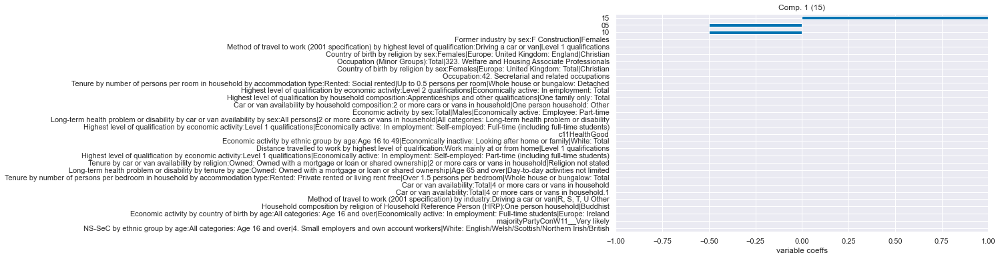

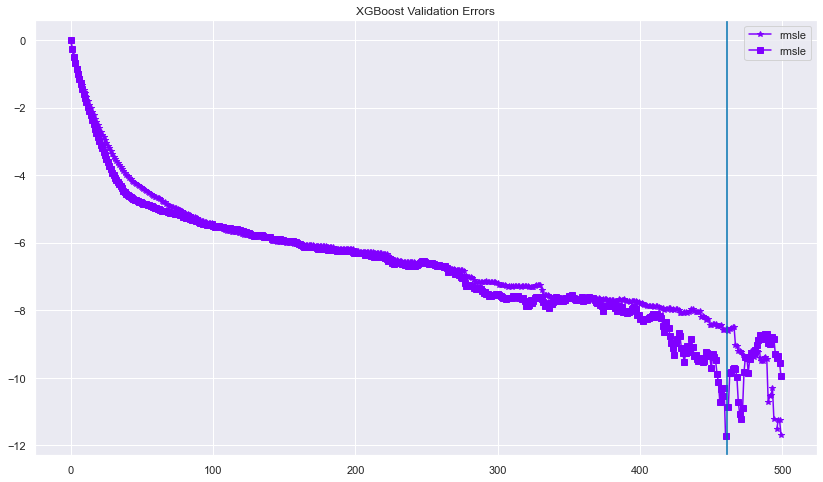

MSE: 10.07, MAE: 2.27, EV: 0.88, R2: 0.88


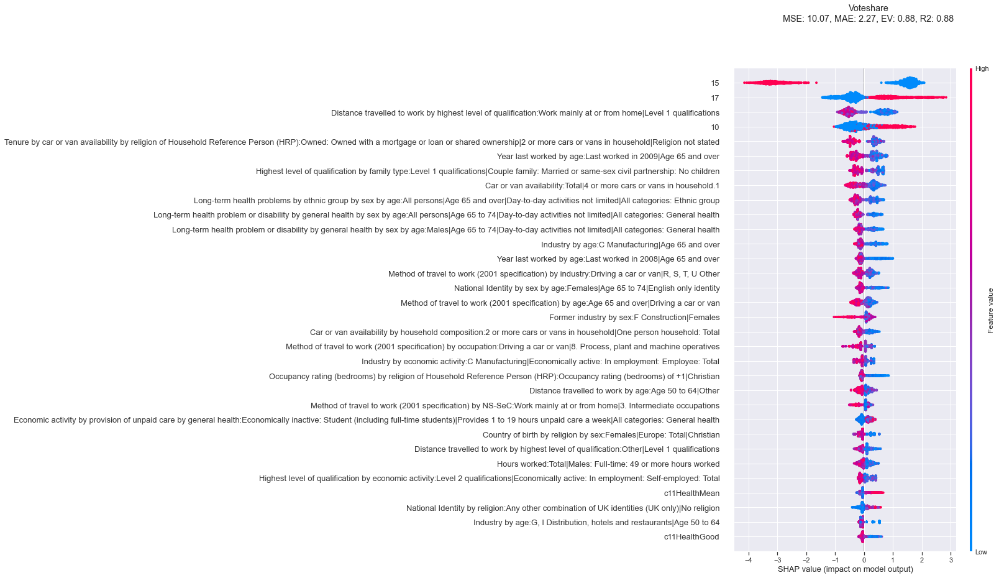

(260,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [02:12<00:00,  1.32s/trial, best loss: -0.5743094367822223]
{'n_comp_FA': 10.0, 'threshold': 0.033229433054404345}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.567
Model:                            OLS   Adj. R-squared:                  0.566
Method:                 Least Squares   F-statistic:                     561.0
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          2.37e-309
Time:                        21:19:50   Log-Likelihood:                -5569.6
No. Observations:                1716   AIC:                         1.115e+04
Df Residuals:                    1711   BIC:                         1.118e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         35.6863      0.260    137.156      0.000      35.176      36.197
0             -6.0193      0.150    -40.068      0.000      -6.314      -5.725
1              2.4072      0.150     16.024      0.000       2.113       2.702
15            -5.8501      0.368    -15.899      0.000      -6.572      -5.128
17             0.6946      0.368      1.888      0.059      -0.027       1.416
==============================================================================
Omnibus:                      110.469   Durbin-Watson:                   1.804
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              158.086
Skew:                           0.542   Prob(JB):                     4.70e-35
Kurtosis:                       4.017   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lib_Left ['15', '17', '19']


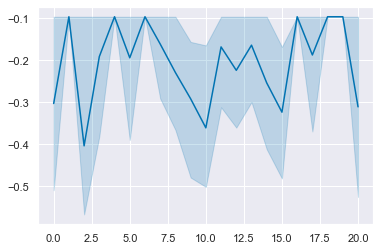

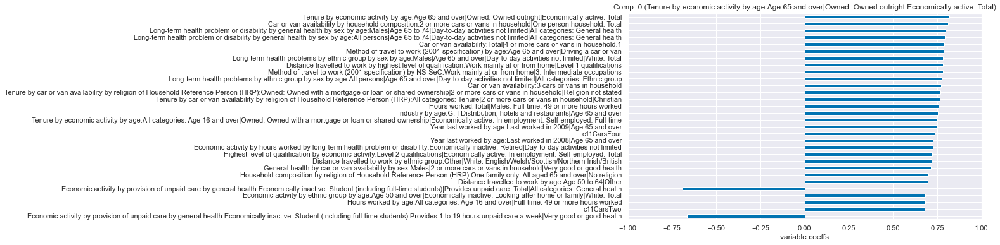

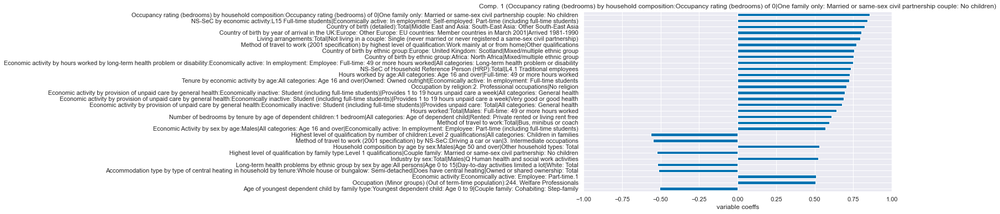

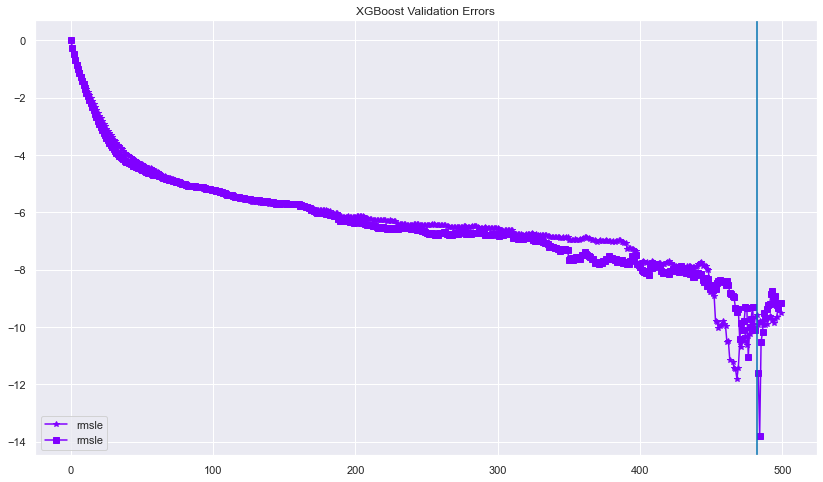

MSE: 10.55, MAE: 2.44, EV: 0.89, R2: 0.89


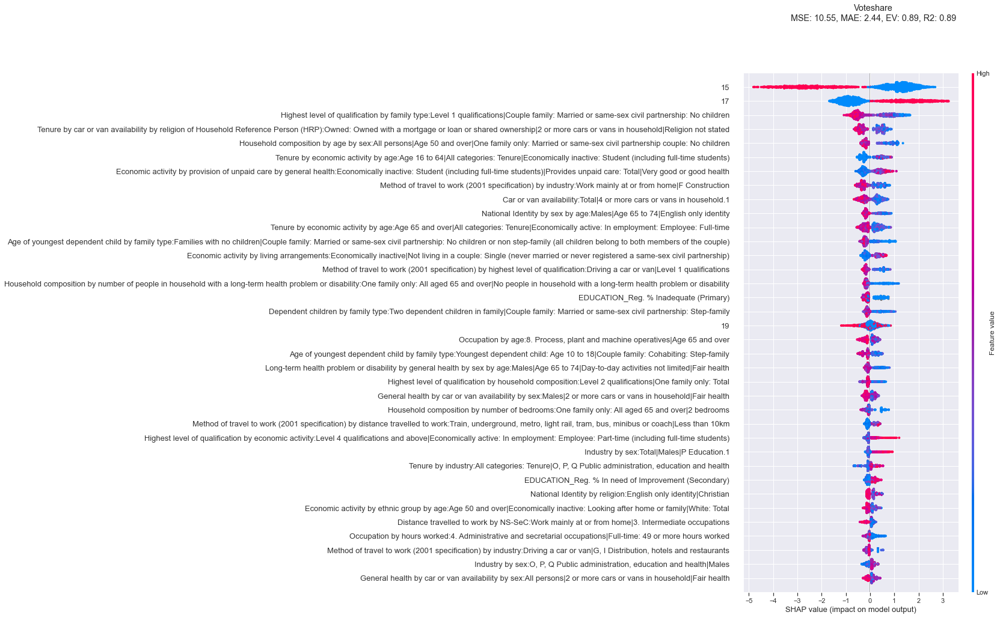

(251,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [12:59<00:00,  7.80s/trial, best loss: -0.6221857572203646]
{'n_comp_FA': 15.0, 'threshold': 0.014729624427957194}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.497
Model:                            OLS   Adj. R-squared:                  0.495
Method:                 Least Squares   F-statistic:                     422.1
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          3.81e-253
Time:                        21:41:37   Log-Likelihood:                -5800.9
No. Observations:                1716   AIC:                         1.161e+04
Df Residuals:                    1711   BIC:                         1.164e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.8362      0.298    100.213      0.000      29.252      30.420
0             -6.3260      0.172    -36.802      0.000      -6.663      -5.989
1              1.6311      0.172      9.489      0.000       1.294       1.968
17             6.5447      0.421     15.544      0.000       5.719       7.371
19             3.8133      0.421      9.057      0.000       2.988       4.639
==============================================================================
Omnibus:                      166.007   Durbin-Watson:                   1.575
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              242.467
Skew:                           0.733   Prob(JB):                     2.23e-53
Kurtosis:                       4.114   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Lib_Left ['05', '10', '15', '17']


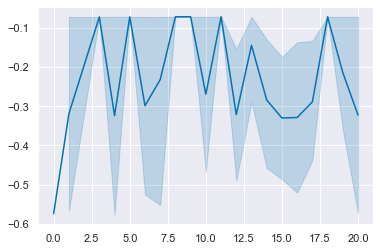

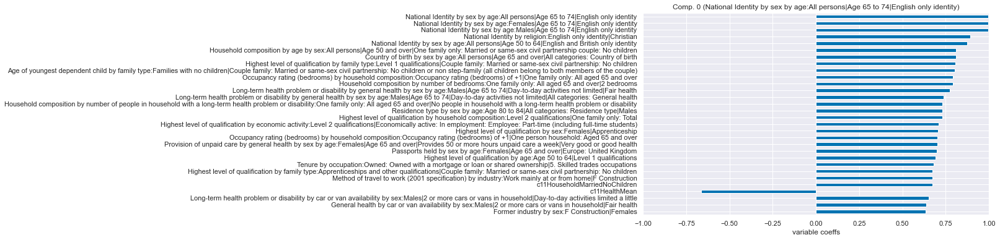

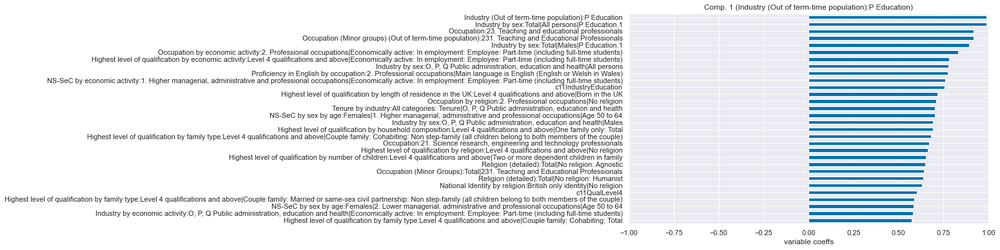

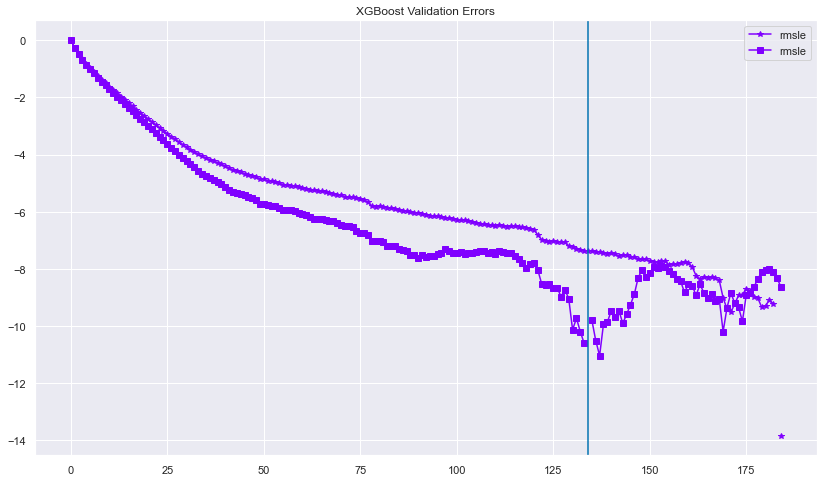

MSE: 13.48, MAE: 2.69, EV: 0.83, R2: 0.83


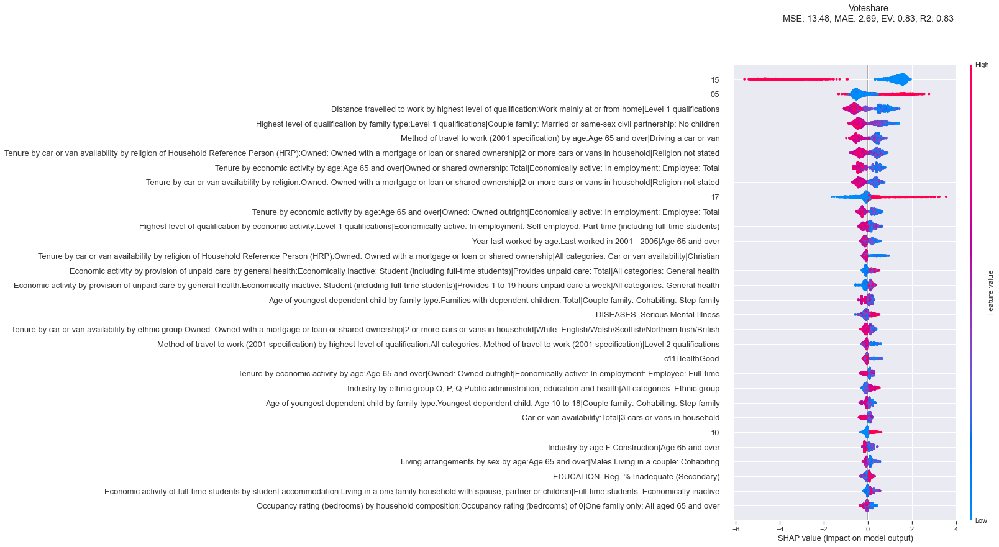

(217,) (2288, 60910)
100%|██████████████████████████████████████| 100/100 [00:16<00:00,  5.93trial/s, best loss: -0.5084374174151143]
{'n_comp_FA': 14.0, 'threshold': 0.44134282175802464}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.508
Model:                            OLS   Adj. R-squared:                  0.508
Method:                 Least Squares   F-statistic:                     590.3
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        21:45:17   Log-Likelihood:                -7433.9
No. Observations:                2288   AIC:                         1.488e+04
Df Residuals:                    2283   BIC:                         1.491e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.6321      0.130    236.461      0.000      30.378      30.886
0             -6.2225      0.144    -43.321      0.000      -6.504      -5.941
1              7.4205      0.201     36.856      0.000       7.026       7.815
10             5.0541      0.262     19.305      0.000       4.541       5.568
15             5.6304      0.170     33.071      0.000       5.297       5.964
17             5.7487      0.262     21.958      0.000       5.235       6.262
==============================================================================
Omnibus:                       86.294   Durbin-Watson:                   1.821
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              147.439
Skew:                           0.311   Prob(JB):                     9.64e-33
Kurtosis:                       4.077   Cond. No.                     1.43e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.34e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['10', '15', '17', '19']


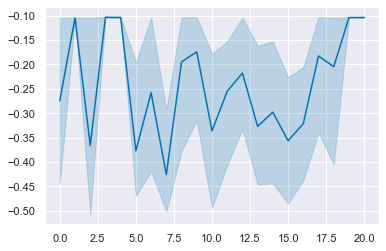

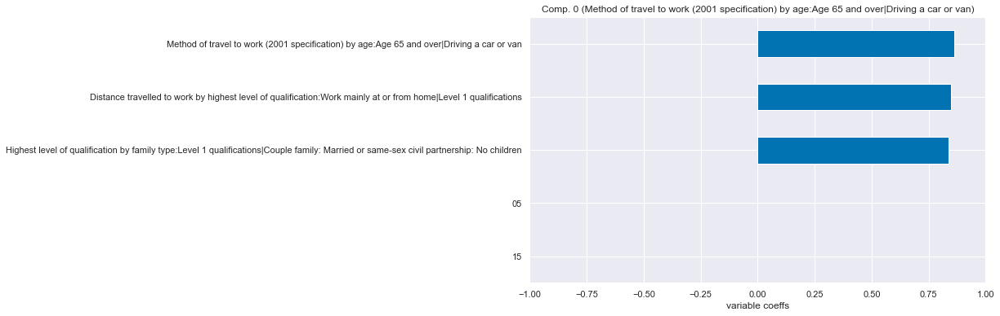

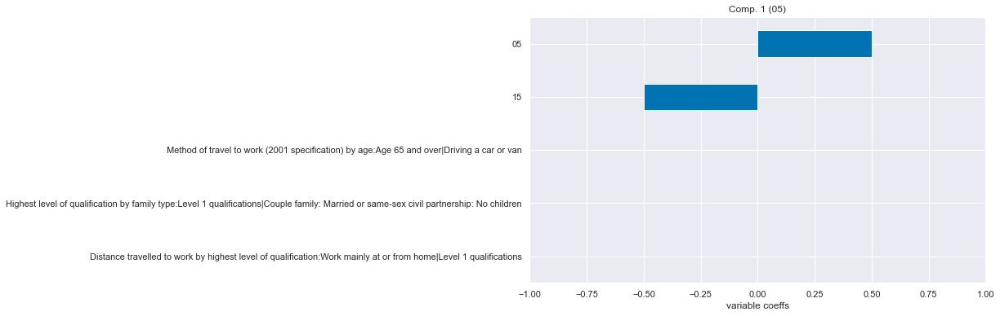

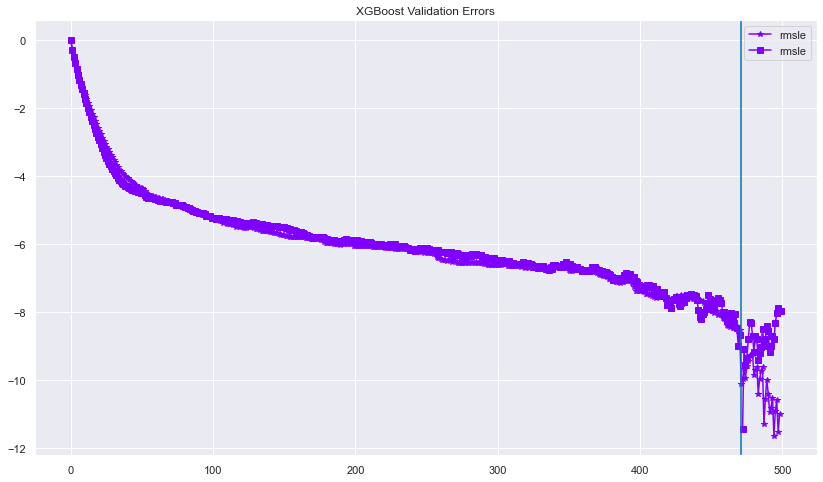

MSE: 11.72, MAE: 2.45, EV: 0.87, R2: 0.87


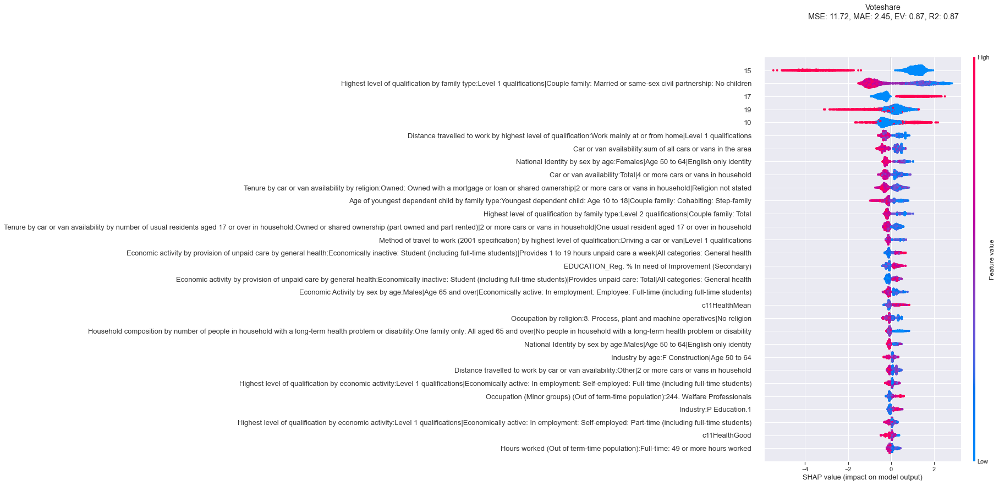

(251,) (2288, 60910)
100%|██████████████████████████████████████| 100/100 [08:52<00:00,  5.32s/trial, best loss: -0.5910718364755994]
{'n_comp_FA': 2.0, 'threshold': 0.06721792211330323}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.072
Model:                            OLS   Adj. R-squared:                  0.071
Method:                 Least Squares   F-statistic:                     59.06
Date:                Mon, 07 Feb 2022   Prob (F-statistic):           9.02e-37
Time:                        22:03:35   Log-Likelihood:                -8309.0
No. Observations:                2288   AIC:                         1.663e+04
Df Residuals:                    2284   BIC:                         1.665e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         29.1370      0.173    168.835      0.000      28.799      29.475
0             -3.0415      0.160    -19.035      0.000      -3.355      -2.728
1             -3.4230      0.189    -18.064      0.000      -3.795      -3.051
15             5.9672      0.076     78.007      0.000       5.817       6.117
17             5.3940      0.381     14.171      0.000       4.648       6.140
19             7.6436      0.197     38.897      0.000       7.258       8.029
==============================================================================
Omnibus:                      122.433   Durbin-Watson:                   1.692
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              141.355
Skew:                           0.602   Prob(JB):                     2.02e-31
Kurtosis:                       3.177   Cond. No.                     6.77e+15
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 6.24e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Lib_Left ['05', '10', '15', '17', '19']


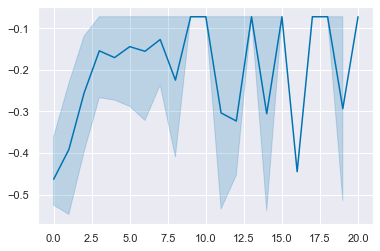

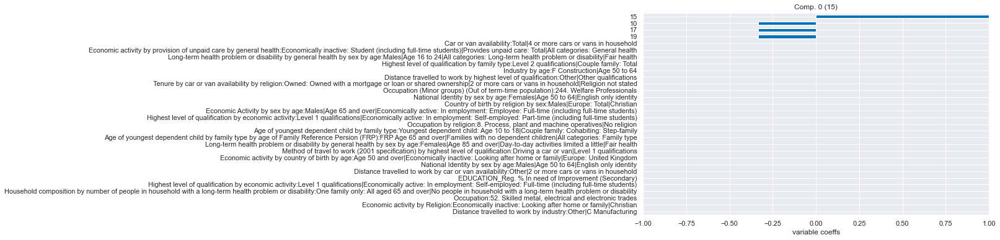

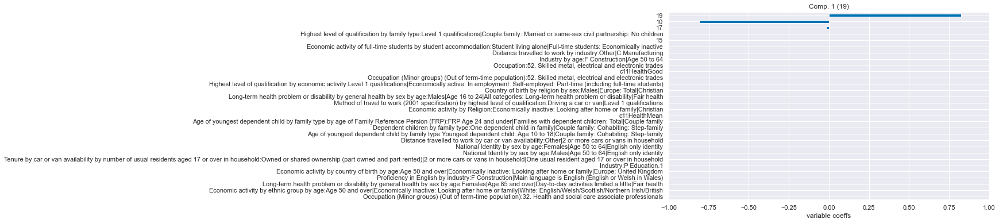

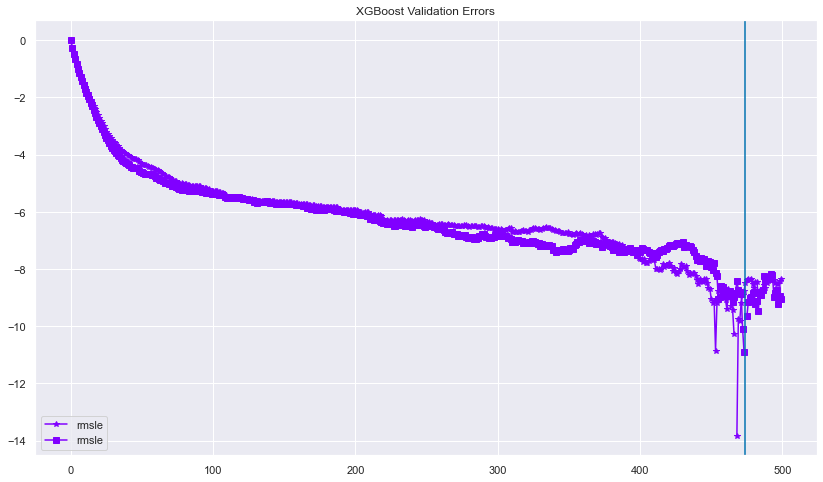

MSE: 11.83, MAE: 2.55, EV: 0.85, R2: 0.85


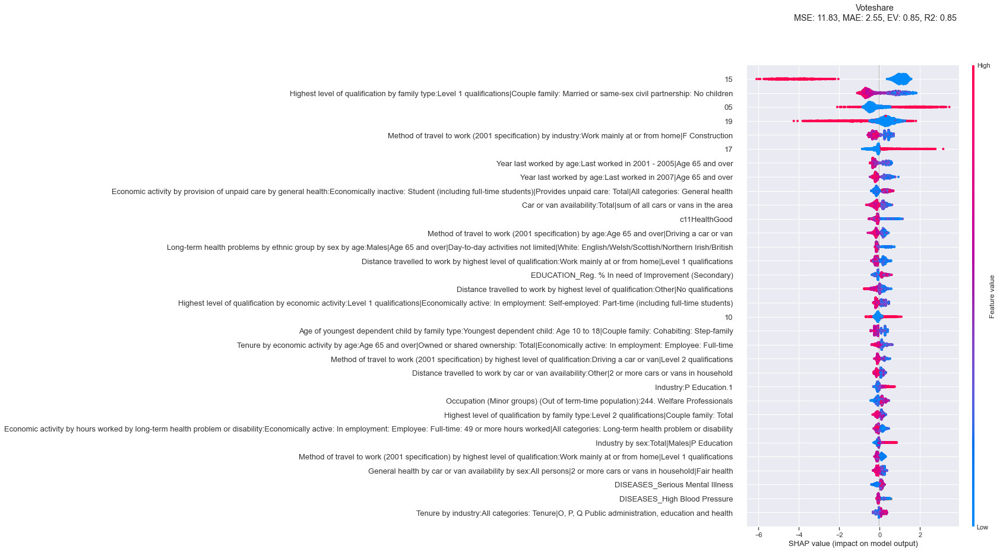

(233,) (2860, 60911)
100%|██████████████████████████████████████| 100/100 [04:52<00:00,  2.93s/trial, best loss: -0.5463840964735202]
{'n_comp_FA': 3.0, 'threshold': 0.09310882239496905}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.474
Model:                            OLS   Adj. R-squared:                  0.473
Method:                 Least Squares   F-statistic:                     429.2
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:18:53   Log-Likelihood:                -9438.1
No. Observations:                2860   AIC:                         1.889e+04
Df Residuals:                    2853   BIC:                         1.893e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         37.0585      0.275    134.927      0.000      36.520      37.597
0             -5.5207      0.123    -44.945      0.000      -5.762      -5.280
1             -1.2595      0.123    -10.254      0.000      -1.500      -1.019
10            -1.3723      0.388     -3.533      0.000      -2.134      -0.611
15            -7.2224      0.388    -18.594      0.000      -7.984      -6.461
17            -0.6777      0.388     -1.745      0.081      -1.439       0.084
19            -3.4090      0.388     -8.777      0.000      -4.171      -2.647
==============================================================================
Omnibus:                      128.799   Durbin-Watson:                   1.825
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              164.177
Skew:                           0.462   Prob(JB):                     2.24e-36
Kurtosis:                       3.723   Cond. No.                         5.83
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['05', '10']


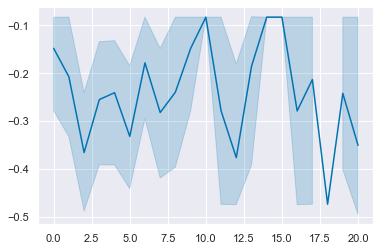

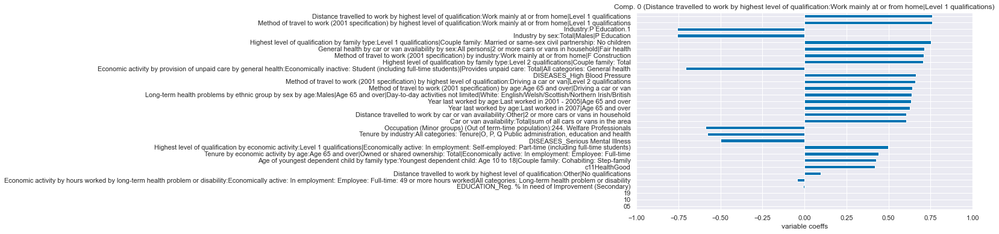

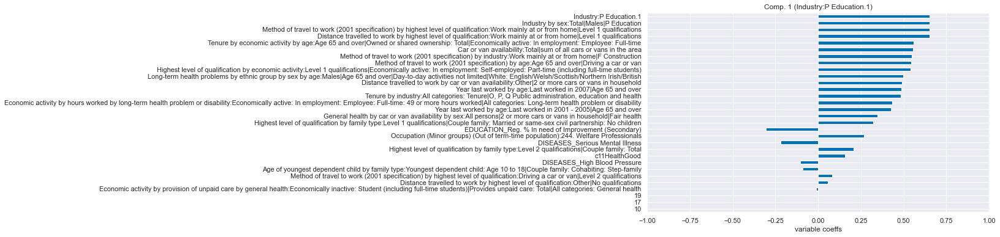

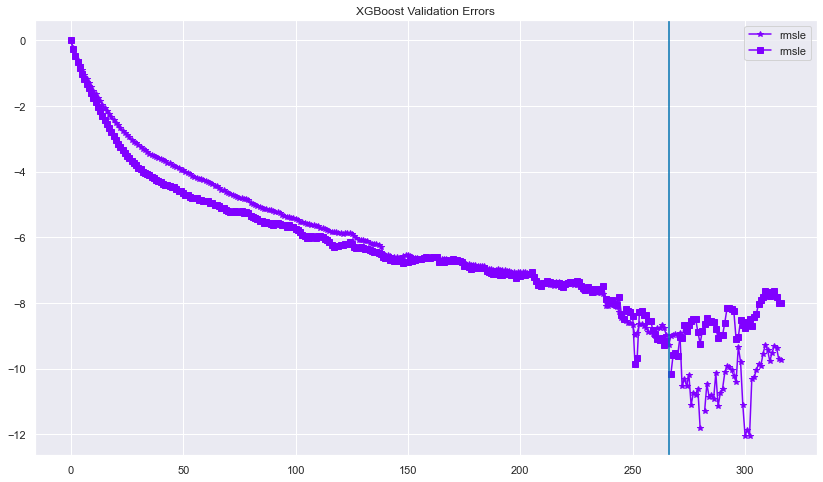

MSE: 6.61, MAE: 1.99, EV: 0.94, R2: 0.94


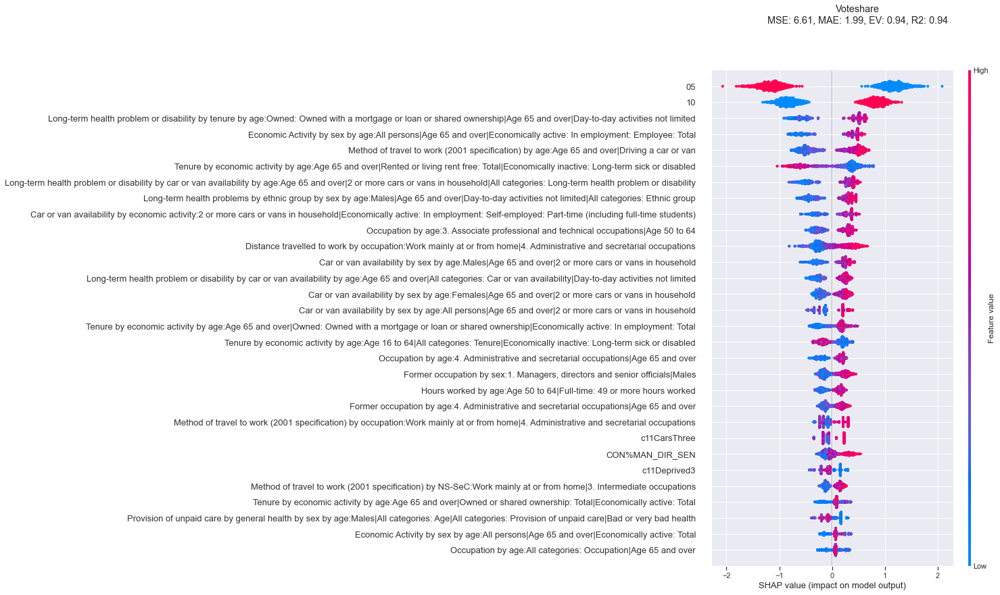

(205,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [01:11<00:00,  1.39trial/s, best loss: -0.8219680625255581]
{'n_comp_FA': 3.0, 'threshold': 0.018245282633798866}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.707
Model:                            OLS   Adj. R-squared:                  0.706
Method:                 Least Squares   F-statistic:                     917.1
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          2.73e-303
Time:                        22:24:42   Log-Likelihood:                -3553.8
No. Observations:                1144   AIC:                             7116.
Df Residuals:                    1140   BIC:                             7136.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0561      0.226     92.989      0.000      20.612      21.500
0             -7.2385      0.160    -45.208      0.000      -7.553      -6.924
1              3.7399      0.160     23.357      0.000       3.426       4.054
10             4.0754      0.320     12.726      0.000       3.447       4.704
==============================================================================
Omnibus:                       21.420   Durbin-Watson:                   1.839
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               31.498
Skew:                          -0.182   Prob(JB):                     1.45e-07
Kurtosis:                       3.727   Cond. No.                         2.62
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['10', '15']


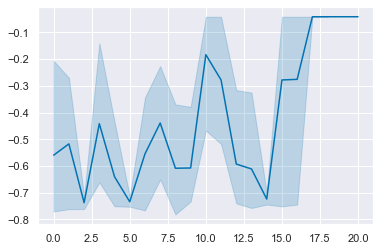

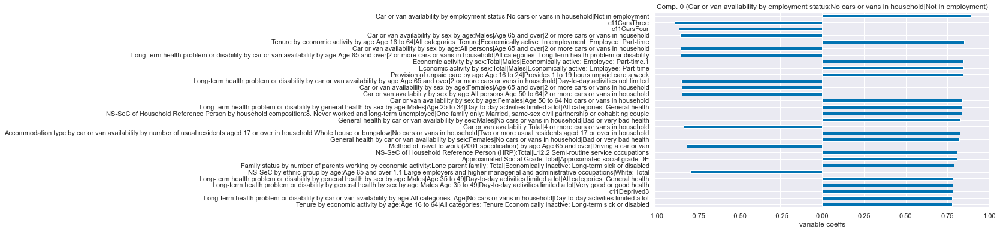

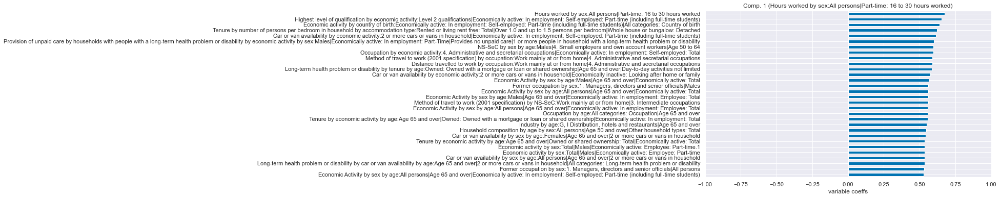

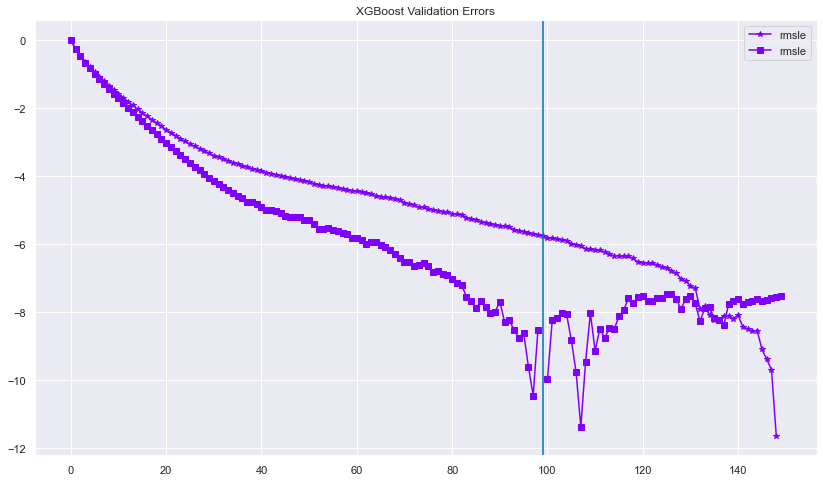

MSE: 6.76, MAE: 2.04, EV: 0.94, R2: 0.94


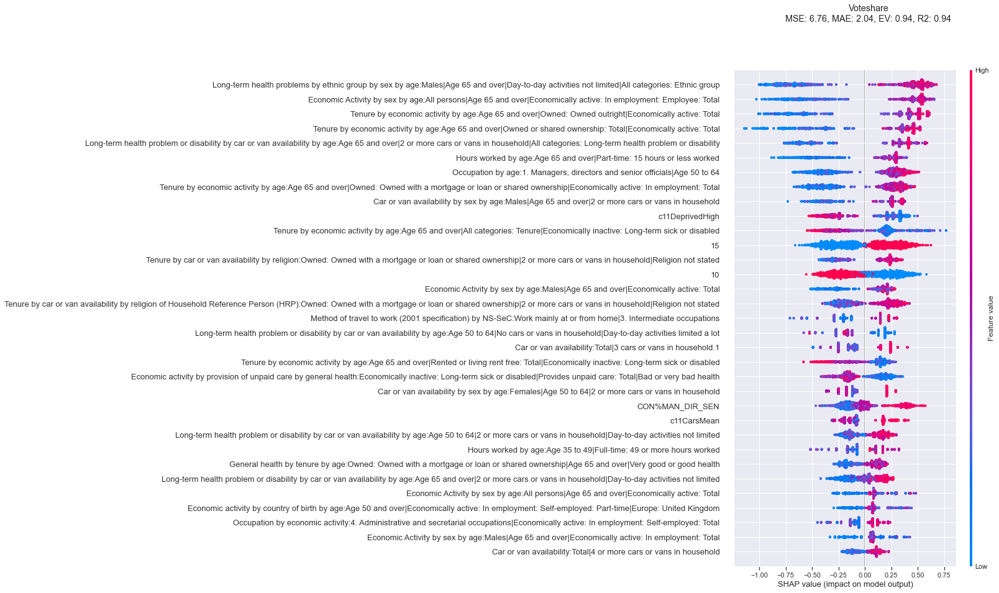

(211,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:52<00:00,  1.90trial/s, best loss: -0.8246537413691026]
{'n_comp_FA': 4.0, 'threshold': 0.03776806284827952}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.787
Model:                            OLS   Adj. R-squared:                  0.786
Method:                 Least Squares   F-statistic:                     2104.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:27:51   Log-Likelihood:                -3445.7
No. Observations:                1144   AIC:                             6897.
Df Residuals:                    1141   BIC:                             6913.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.2935      0.124    172.067      0.000      21.051      21.536
0             -9.4318      0.146    -64.771      0.000      -9.718      -9.146
1             -3.8379      0.124    -31.013      0.000      -4.081      -3.595
15             8.7278      0.069    127.144      0.000       8.593       8.862
==============================================================================
Omnibus:                      138.743   Durbin-Watson:                   1.844
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              283.247
Skew:                          -0.732   Prob(JB):                     3.12e-62
Kurtosis:                       4.949   Cond. No.                     8.82e+15
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 2.21e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Con ['15', '17']


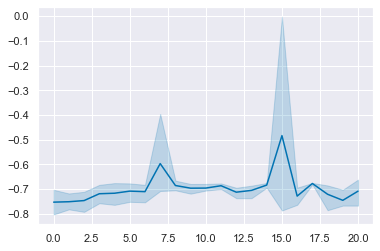

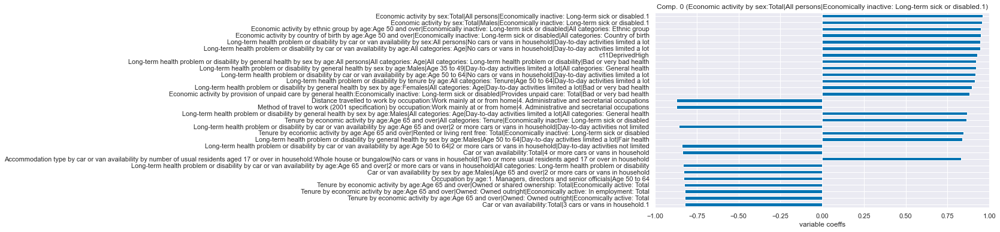

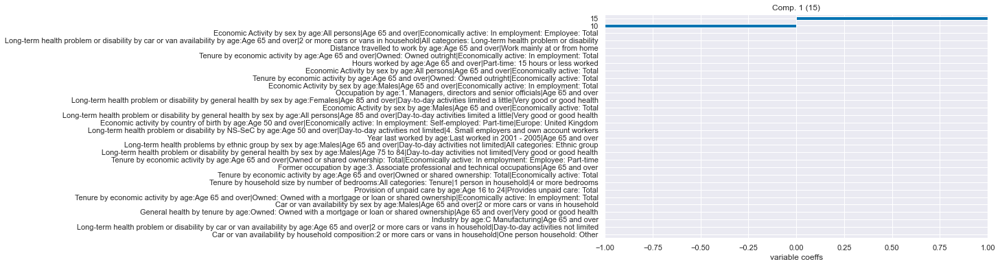

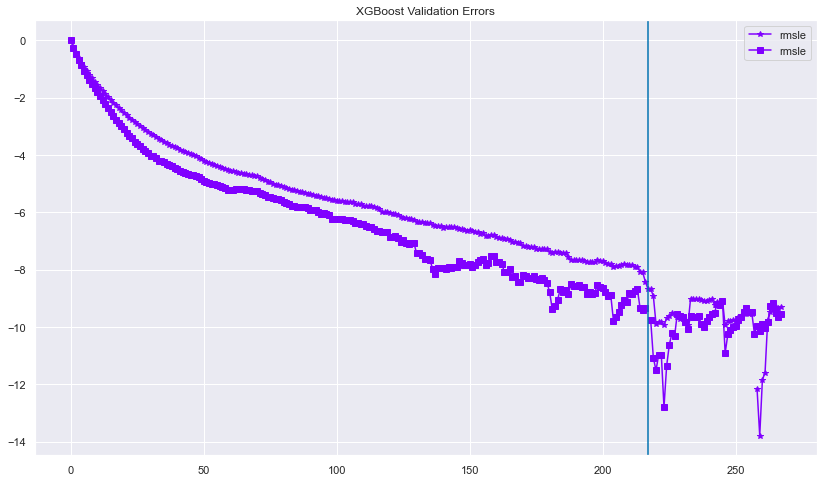

MSE: 12.16, MAE: 2.40, EV: 0.91, R2: 0.91


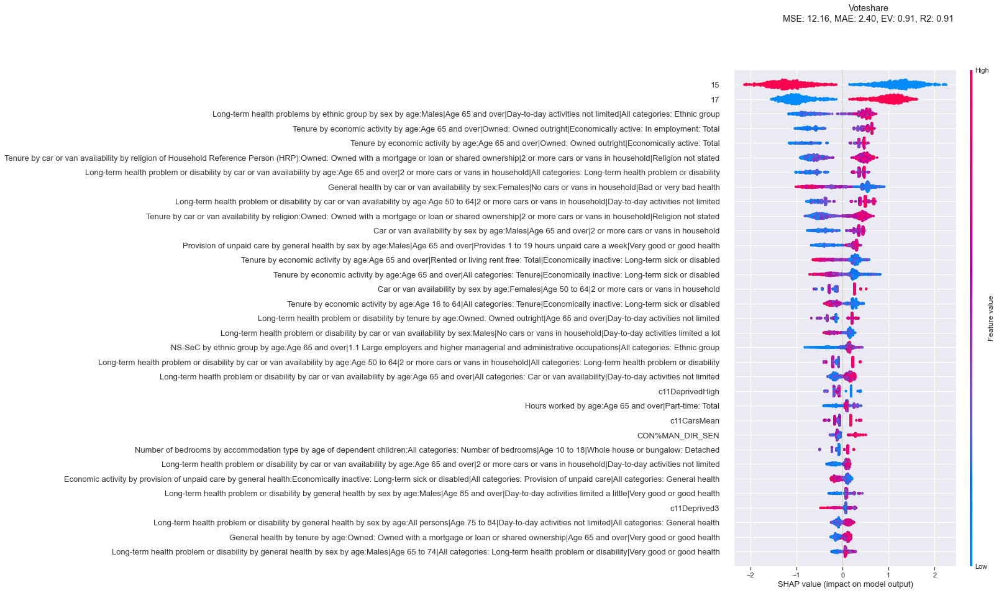

(207,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:49<00:00,  2.00trial/s, best loss: -0.8213850900425127]
{'n_comp_FA': 2.0, 'threshold': 0.03418257066943203}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.670
Model:                            OLS   Adj. R-squared:                  0.669
Method:                 Least Squares   F-statistic:                     1157.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          3.03e-275
Time:                        22:32:40   Log-Likelihood:                -3773.3
No. Observations:                1144   AIC:                             7553.
Df Residuals:                    1141   BIC:                             7568.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         23.3297      0.165    141.577      0.000      23.006      23.653
0             -9.0486      0.194    -46.666      0.000      -9.429      -8.668
1              2.8537      0.165     17.318      0.000       2.530       3.177
17            10.2380      0.091    112.006      0.000      10.059      10.417
==============================================================================
Omnibus:                      139.946   Durbin-Watson:                   1.707
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              246.934
Skew:                          -0.790   Prob(JB):                     2.39e-54
Kurtosis:                       4.639   Cond. No.                     1.07e+16
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.51e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Con ['17', '19']


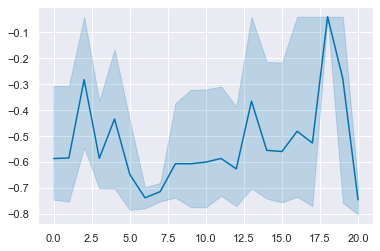

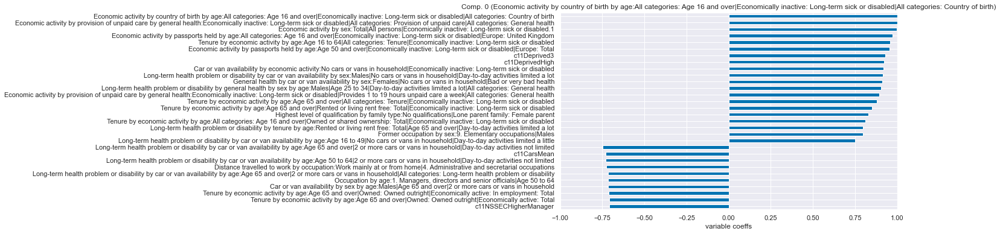

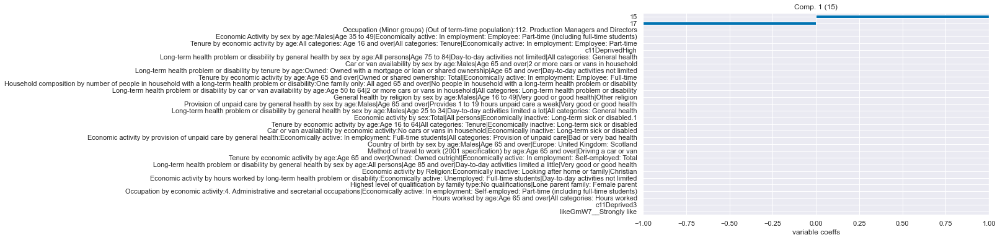

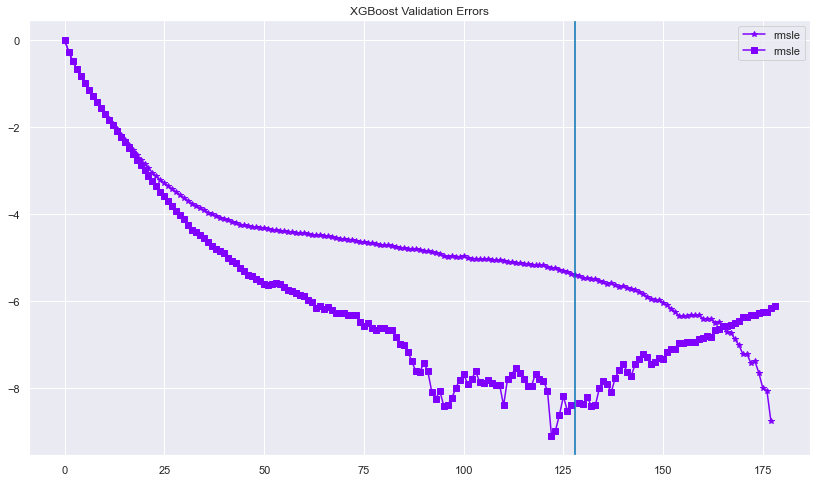

MSE: 7.96, MAE: 2.10, EV: 0.94, R2: 0.94


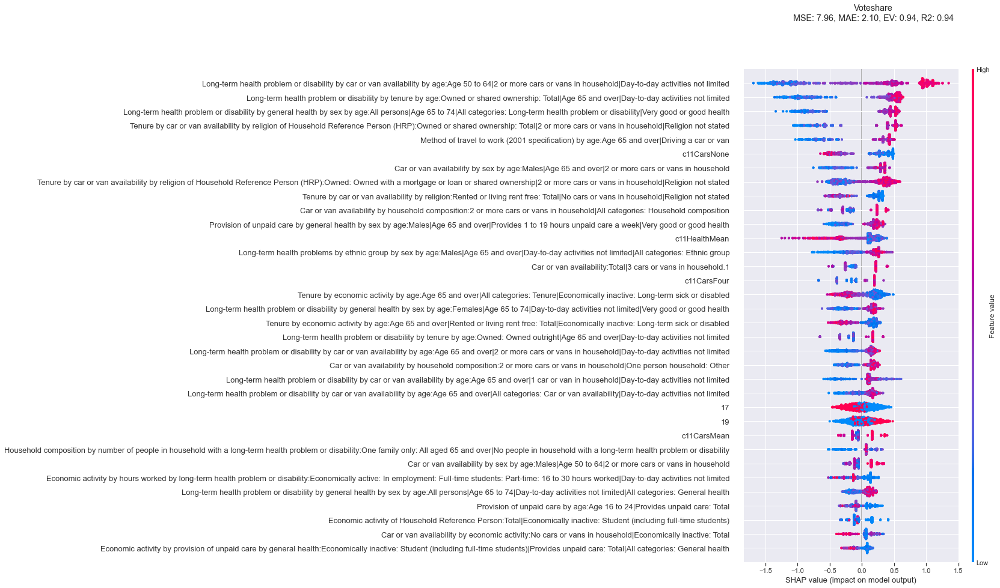

(232,) (1144, 60908)
100%|██████████████████████████████████████| 100/100 [00:31<00:00,  3.21trial/s, best loss: -0.8010000063725838]
{'n_comp_FA': 6.0, 'threshold': 0.17258305314807337}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.747
Model:                            OLS   Adj. R-squared:                  0.747
Method:                 Least Squares   F-statistic:                     1124.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:35:50   Log-Likelihood:                -3620.9
No. Observations:                1144   AIC:                             7250.
Df Residuals:                    1140   BIC:                             7270.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         30.7140      0.240    127.912      0.000      30.243      31.185
0              9.7293      0.170     57.301      0.000       9.396      10.062
1              1.5782      0.170      9.289      0.000       1.245       1.912
19             0.4722      0.340      1.390      0.165      -0.194       1.138
==============================================================================
Omnibus:                       32.547   Durbin-Watson:                   1.896
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               50.333
Skew:                          -0.256   Prob(JB):                     1.18e-11
Kurtosis:                       3.891   Cond. No.                         2.62
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['05', '10', '15']


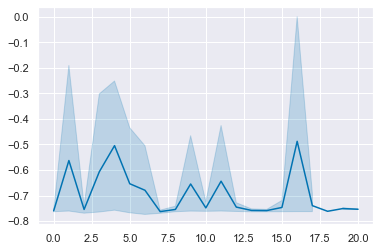

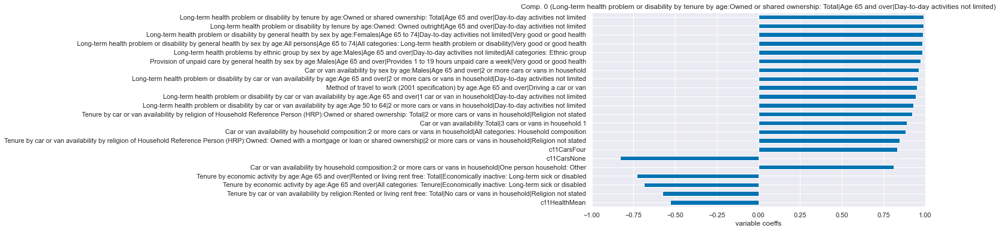

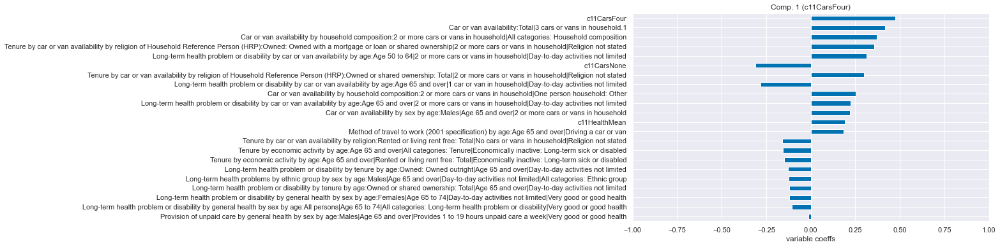

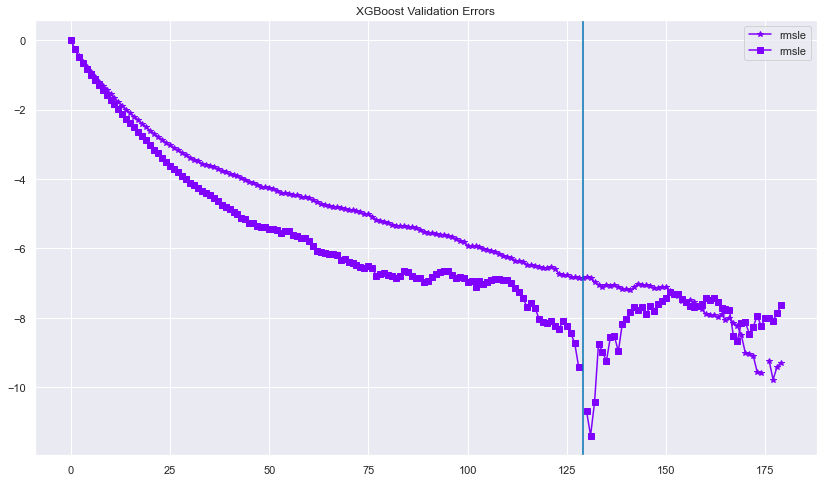

MSE: 7.62, MAE: 2.02, EV: 0.93, R2: 0.93


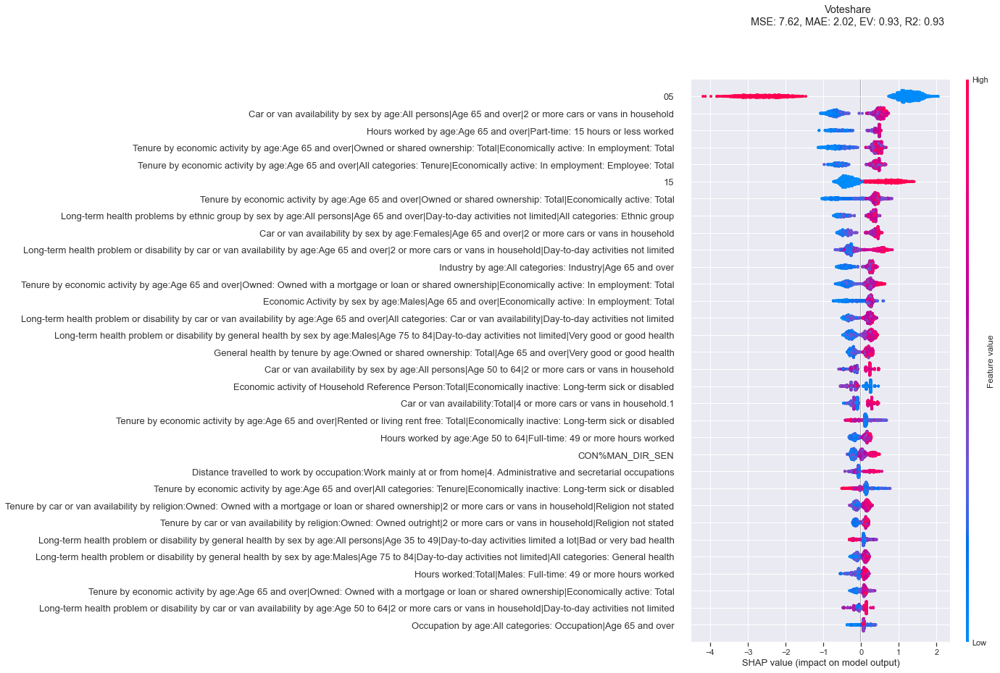

(165,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [02:19<00:00,  1.40s/trial, best loss: -0.8140910151123382]
{'n_comp_FA': 1.0, 'threshold': 0.006535786882529648}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.797
Model:                            OLS   Adj. R-squared:                  0.796
Method:                 Least Squares   F-statistic:                     1675.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:41:22   Log-Likelihood:                -5100.5
No. Observations:                1716   AIC:                         1.021e+04
Df Residuals:                    1711   BIC:                         1.024e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0561      0.198    106.370      0.000      20.668      21.444
0              8.0670      0.114     70.586      0.000       7.843       8.291
1             -4.1916      0.114    -36.671      0.000      -4.416      -3.967
10             4.0754      0.280     14.558      0.000       3.526       4.624
15             5.1273      0.280     18.315      0.000       4.578       5.676
==============================================================================
Omnibus:                      239.993   Durbin-Watson:                   1.886
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              497.045
Skew:                          -0.835   Prob(JB):                    1.17e-108
Kurtosis:                       5.040   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['10', '15', '17']


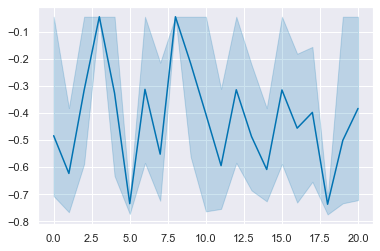

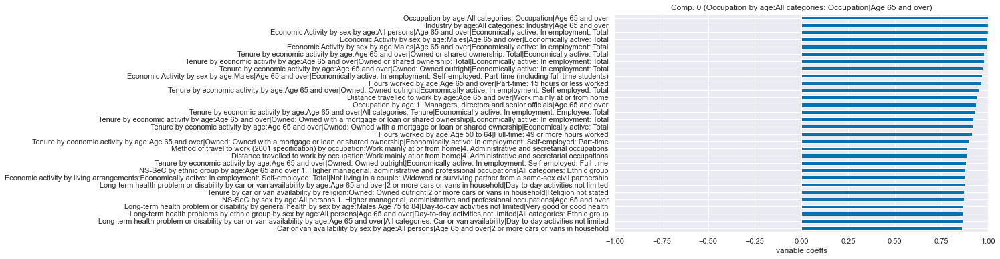

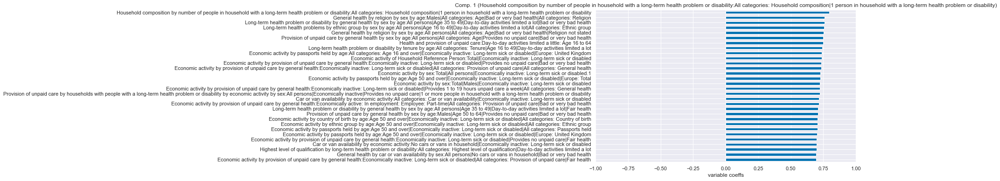

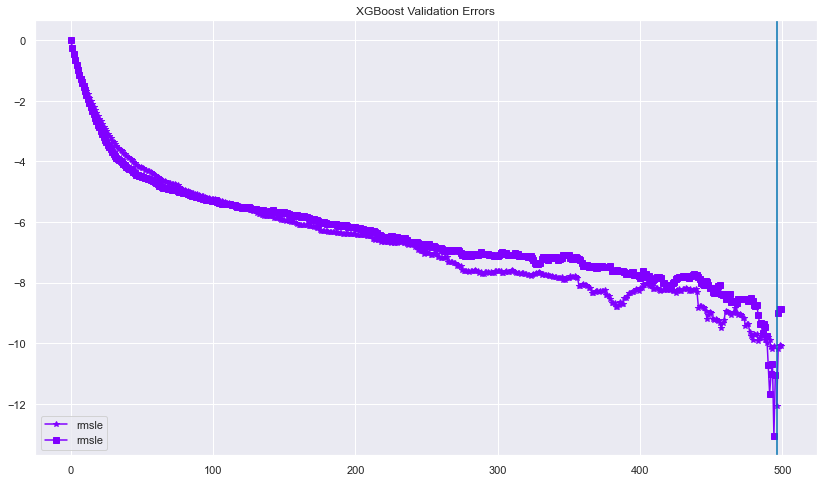

MSE: 5.92, MAE: 1.83, EV: 0.95, R2: 0.95


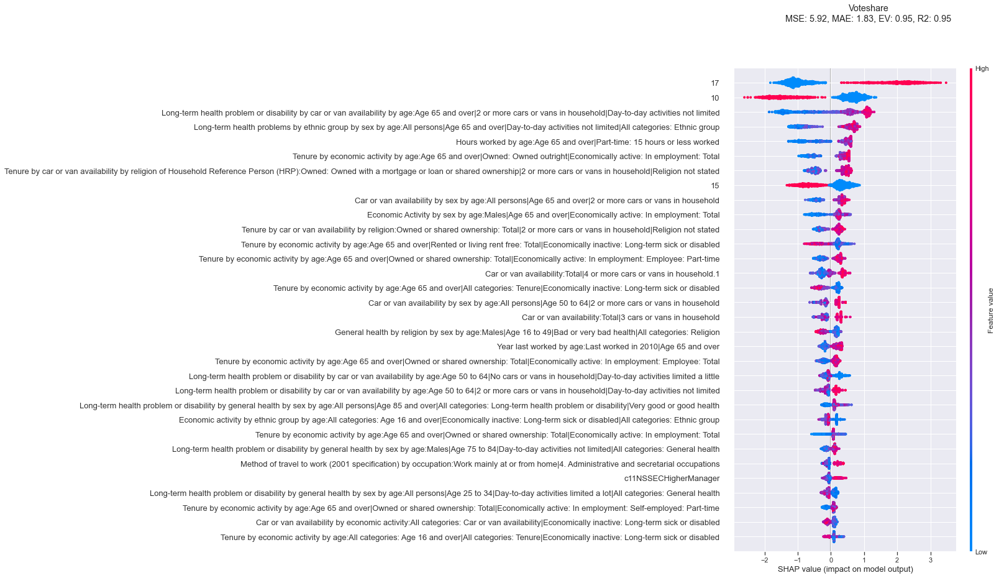

(179,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [03:41<00:00,  2.22s/trial, best loss: -0.8206410466876184]
{'n_comp_FA': 4.0, 'threshold': 0.06339480272972153}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.686
Model:                            OLS   Adj. R-squared:                  0.686
Method:                 Least Squares   F-statistic:                     1249.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        22:53:48   Log-Likelihood:                -5570.3
No. Observations:                1716   AIC:                         1.115e+04
Df Residuals:                    1712   BIC:                         1.117e+04
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         24.4328      0.185    131.873      0.000      24.069      24.796
0              8.8728      0.150     59.059      0.000       8.578       9.167
1             -0.9880      0.153     -6.444      0.000      -1.289      -0.687
15             1.0519      0.368      2.858      0.004       0.330       1.774
17             7.6785      0.065    118.032      0.000       7.551       7.806
==============================================================================
Omnibus:                       43.734   Durbin-Watson:                   1.883
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               47.218
Skew:                          -0.374   Prob(JB):                     5.58e-11
Kurtosis:                       3.319   Cond. No.                     5.16e+15
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 8.6e-29. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

Con ['15', '17', '19']


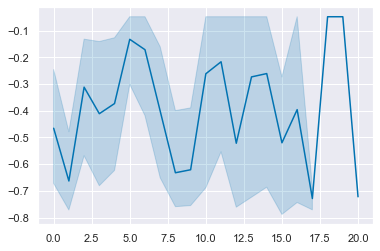

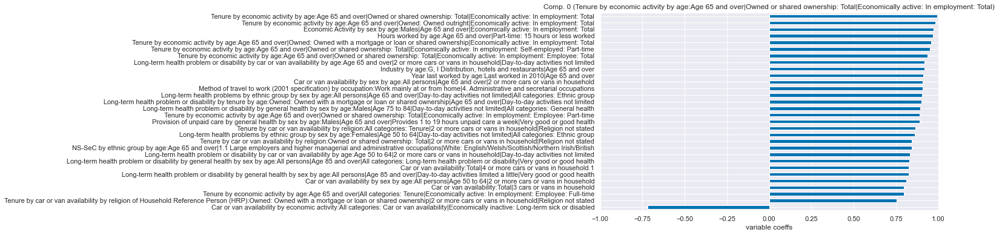

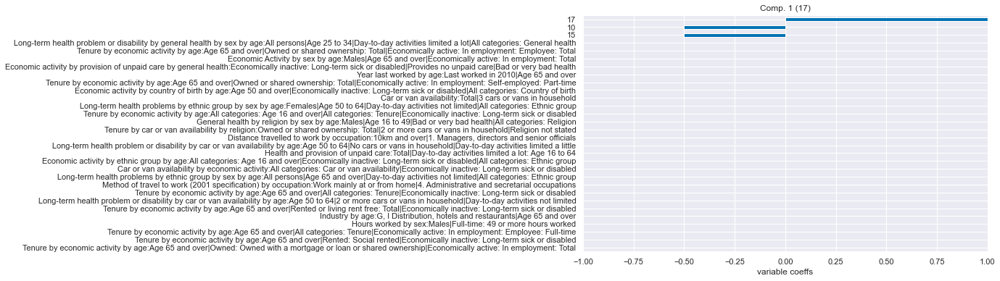

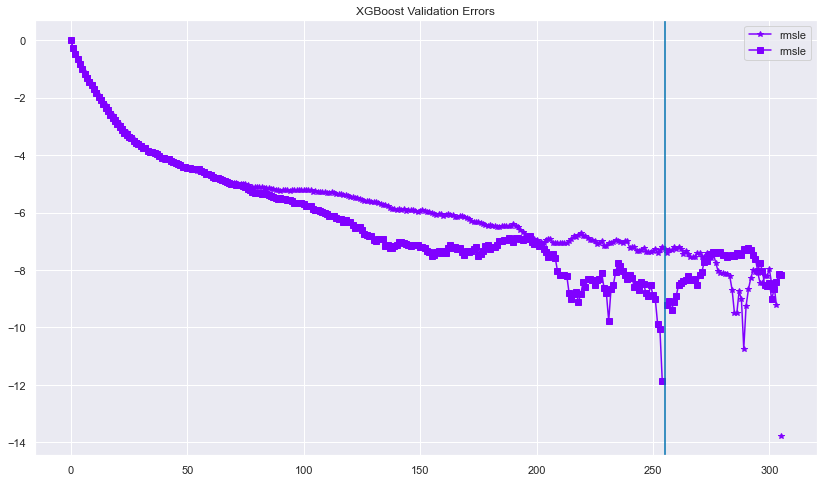

MSE: 7.56, MAE: 1.97, EV: 0.94, R2: 0.94


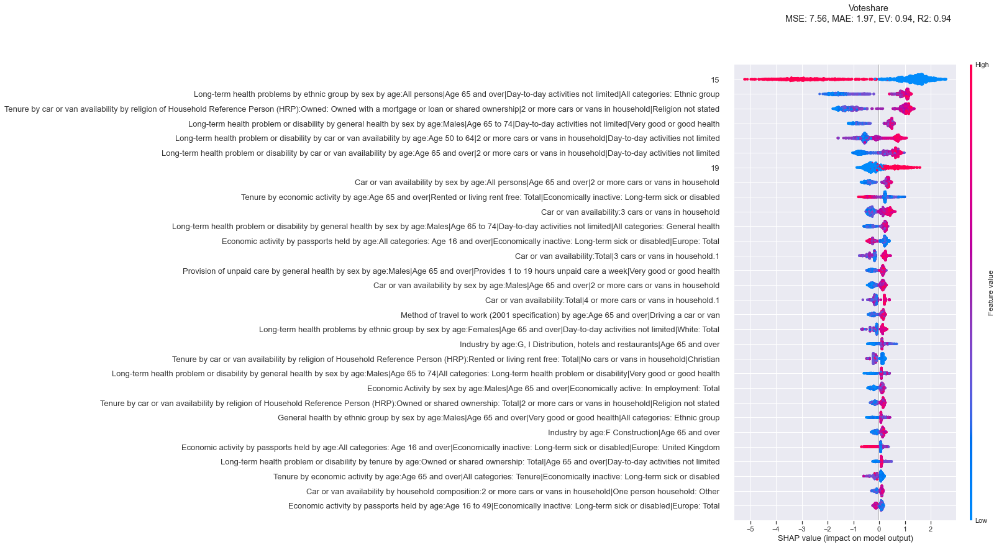

(210,) (1716, 60909)
100%|██████████████████████████████████████| 100/100 [04:37<00:00,  2.78s/trial, best loss: -0.7627862923265422]
{'n_comp_FA': 17.0, 'threshold': 0.006082640438088871}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.687
Model:                            OLS   Adj. R-squared:                  0.686
Method:                 Least Squares   F-statistic:                     939.7
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        23:03:55   Log-Likelihood:                -5633.8
No. Observations:                1716   AIC:                         1.128e+04
Df Residuals:                    1711   BIC:                         1.130e+04
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         26.1833      0.270     96.940      0.000      25.654      26.713
0              9.2906      0.156     59.578      0.000       8.985       9.596
1             -0.0014      0.156     -0.009      0.993      -0.307       0.304
17             4.5307      0.382     11.861      0.000       3.782       5.280
19             5.0029      0.382     13.097      0.000       4.254       5.752
==============================================================================
Omnibus:                       17.894   Durbin-Watson:                   1.918
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               21.475
Skew:                          -0.168   Prob(JB):                     2.17e-05
Kurtosis:                       3.433   Cond. No.                         3.73
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['05', '10', '15', '17']


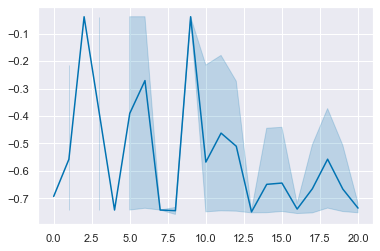

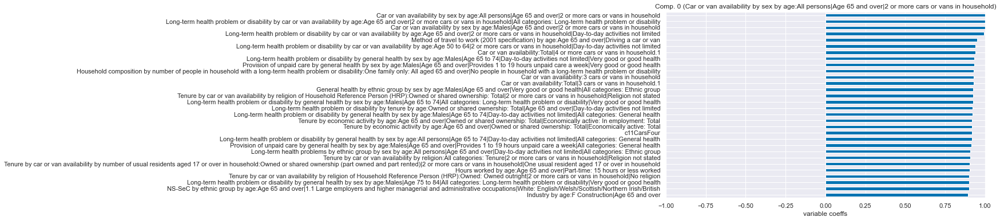

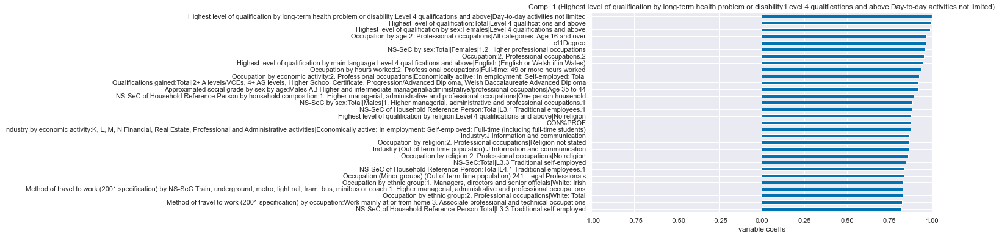

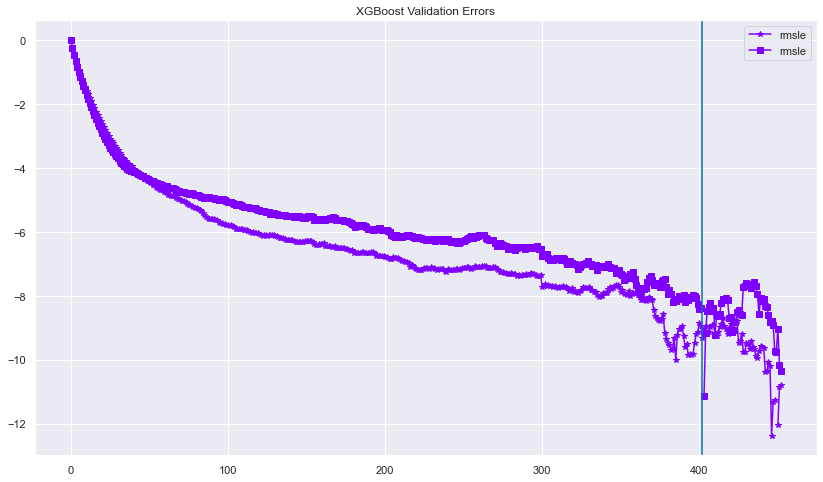

MSE: 5.50, MAE: 1.77, EV: 0.95, R2: 0.95


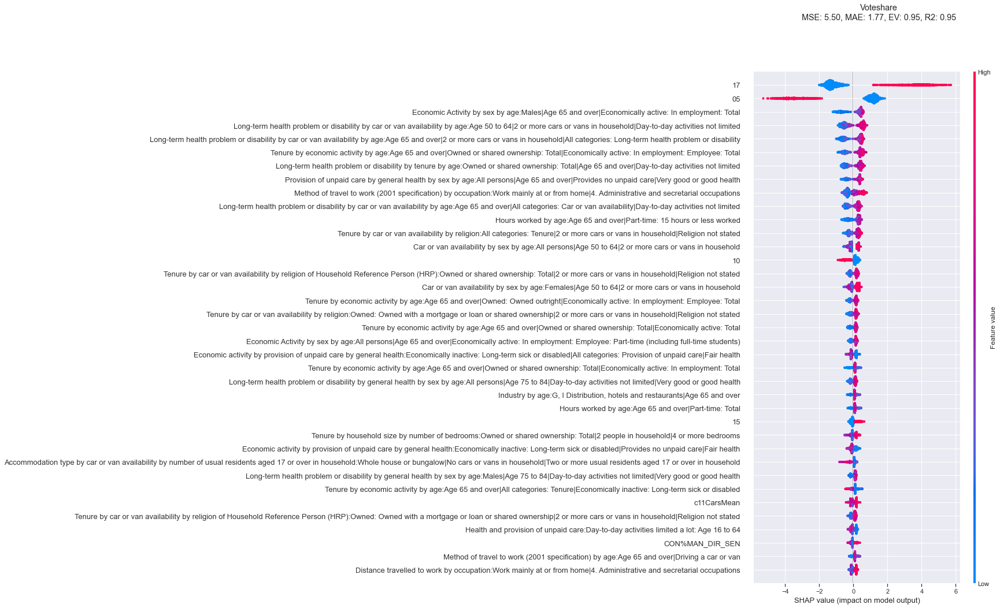

(177,) (2288, 60910)
100%|██████████████████████████████████████| 100/100 [08:23<00:00,  5.03s/trial, best loss: -0.8298025785731777]
{'n_comp_FA': 4.0, 'threshold': 0.016820469043224782}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.701
Model:                            OLS   Adj. R-squared:                  0.700
Method:                 Least Squares   F-statistic:                     1068.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        23:20:53   Log-Likelihood:                -7362.9
No. Observations:                2288   AIC:                         1.474e+04
Df Residuals:                    2282   BIC:                         1.477e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0561      0.253     83.209      0.000      20.560      21.552
0             -7.4570      0.127    -58.937      0.000      -7.705      -7.209
1             -4.2489      0.127    -33.581      0.000      -4.497      -4.001
10             4.0754      0.358     11.388      0.000       3.374       4.777
15             5.1273      0.358     14.327      0.000       4.425       5.829
17             9.6580      0.358     26.988      0.000       8.956      10.360
==============================================================================
Omnibus:                       85.580   Durbin-Watson:                   1.637
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              134.572
Skew:                          -0.335   Prob(JB):                     6.00e-30
Kurtosis:                       3.981   Cond. No.                         4.79
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['10', '15', '17', '19']


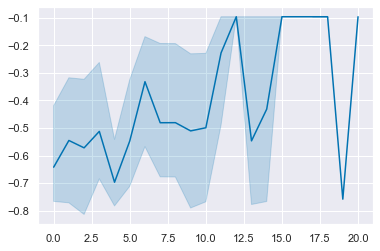

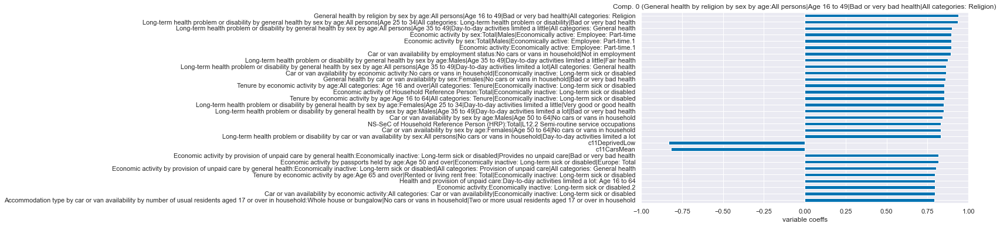

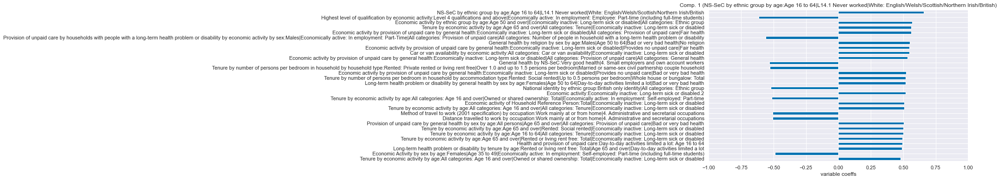

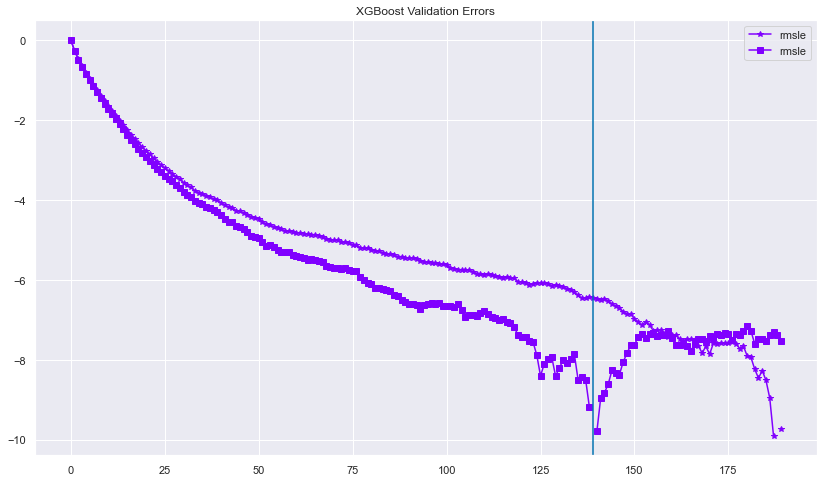

MSE: 6.53, MAE: 1.92, EV: 0.95, R2: 0.95


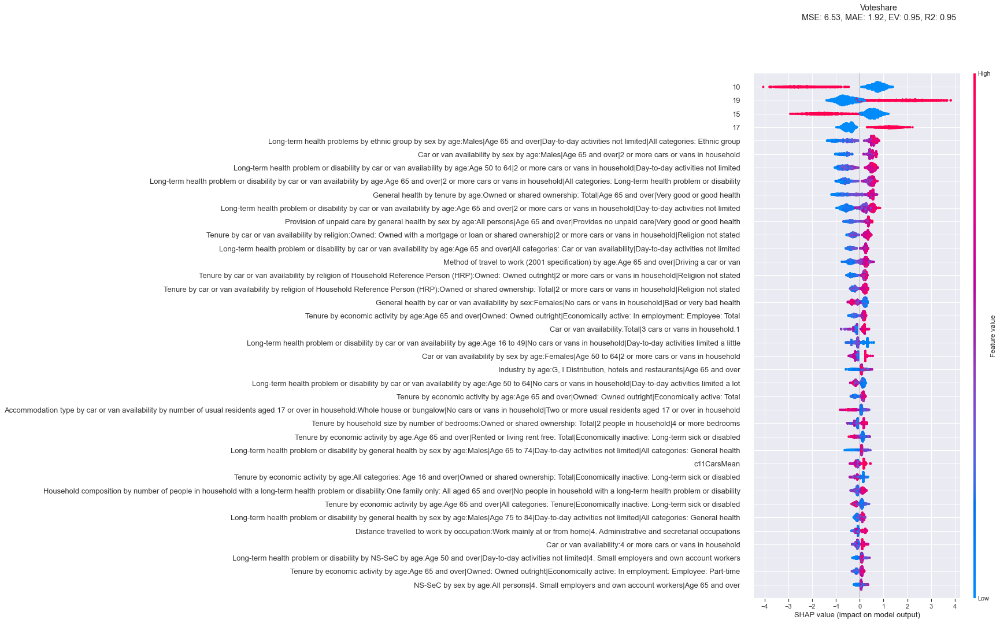

(178,) (2288, 60910)
100%|██████████████████████████████████████| 100/100 [02:52<00:00,  1.72s/trial, best loss: -0.8000008615793587]
{'n_comp_FA': 4.0, 'threshold': 0.031050003929017723}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.766
Model:                            OLS   Adj. R-squared:                  0.765
Method:                 Least Squares   F-statistic:                     1493.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        23:27:29   Log-Likelihood:                -7142.9
No. Observations:                2288   AIC:                         1.430e+04
Df Residuals:                    2282   BIC:                         1.433e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         25.1314      0.230    109.335      0.000      24.681      25.582
0             -9.5445      0.115    -83.048      0.000      -9.770      -9.319
1              0.5828      0.115      5.071      0.000       0.357       0.808
15             1.0519      0.325      3.236      0.001       0.414       1.689
17             5.5826      0.325     17.174      0.000       4.945       6.220
19             6.0548      0.325     18.626      0.000       5.417       6.692
==============================================================================
Omnibus:                      110.324   Durbin-Watson:                   1.800
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              280.268
Skew:                          -0.251   Prob(JB):                     1.38e-61
Kurtosis:                       4.639   Cond. No.                         4.79
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Con ['05', '10', '15', '17', '19']


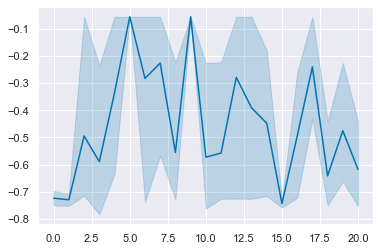

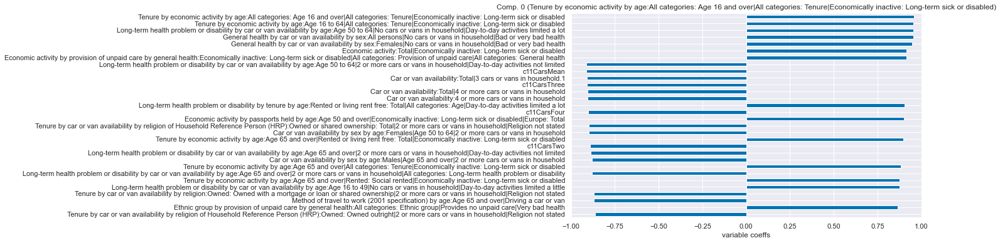

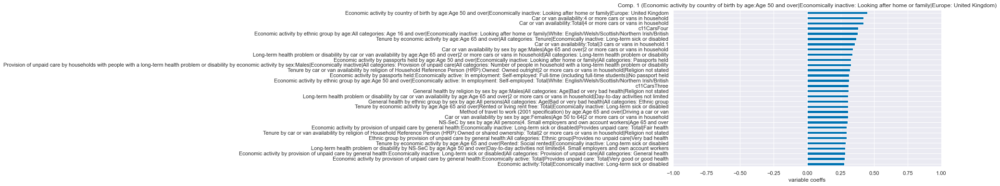

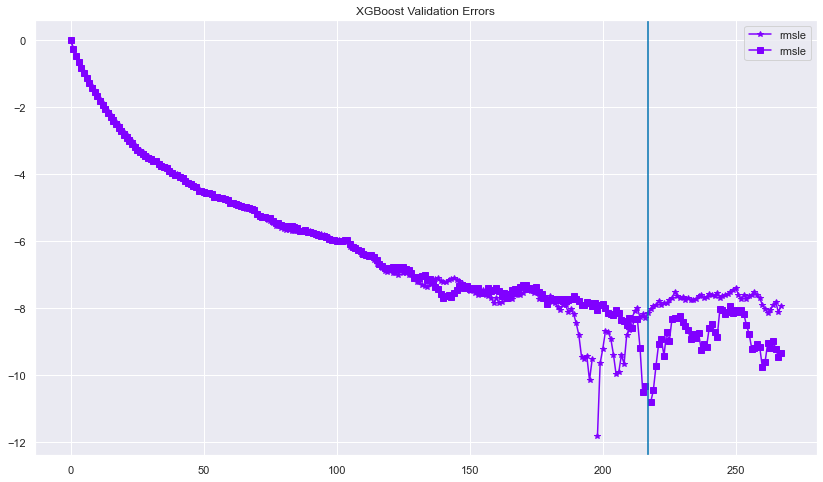

MSE: 6.66, MAE: 1.94, EV: 0.95, R2: 0.95


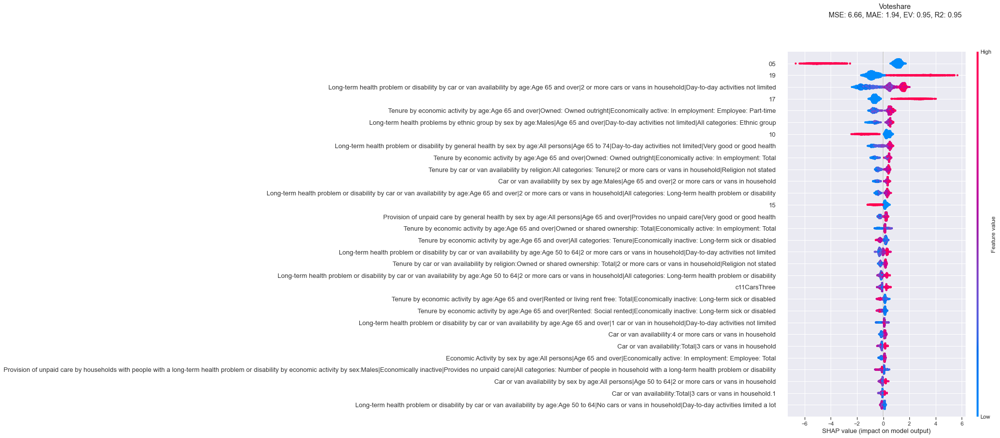

(177,) (2860, 60911)
100%|██████████████████████████████████████| 100/100 [14:53<00:00,  8.94s/trial, best loss: -0.7628015010041469]
{'n_comp_FA': 19.0, 'threshold': 0.1722913069445159}


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.763
Model:                            OLS   Adj. R-squared:                  0.762
Method:                 Least Squares   F-statistic:                     1529.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        23:48:00   Log-Likelihood:                -8951.6
No. Observations:                2860   AIC:                         1.792e+04
Df Residuals:                    2853   BIC:                         1.796e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0561      0.232     90.879      0.000      20.602      21.510
0              9.2215      0.104     88.422      0.000       9.017       9.426
1              0.7916      0.126      6.283      0.000       0.545       1.039
10             4.0754      0.328     12.438      0.000       3.433       4.718
15             5.1273      0.328     15.648      0.000       4.485       5.770
17             9.6580      0.328     29.475      0.000       9.015      10.300
19            10.1301      0.328     30.916      0.000       9.488      10.773
==============================================================================
Omnibus:                       53.769   Durbin-Watson:                   1.866
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              107.963
Skew:                          -0.044   Prob(JB):                     3.60e-24
Kurtosis:                       3.948   Cond. No.                         5.83
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Right_Auth ['05', '10']


KeyError: "None of [Index(['Right_Auth05_elec', 'Right_Auth10_elec'], dtype='object')] are in the [columns]"

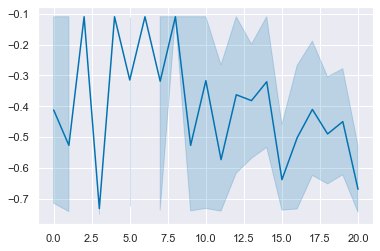

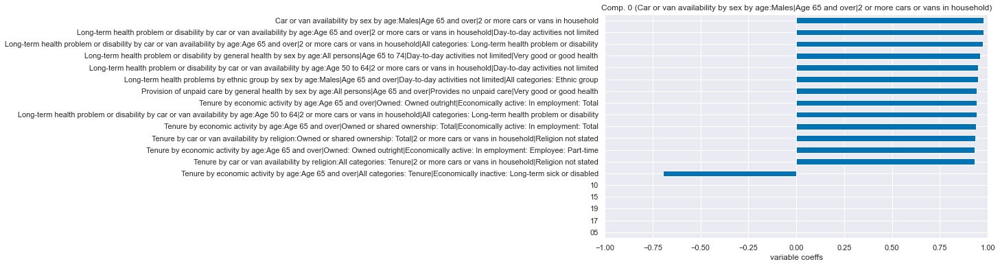

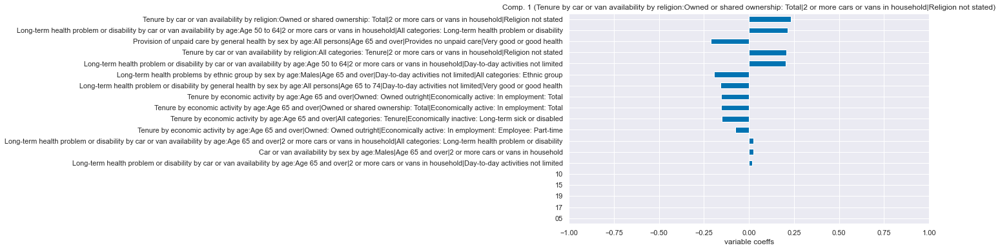

In [597]:
# %%time

for pol_var in target_pol_var_list:
    for year_combo in year_combo_list:
        start = time.time()
        print(pol_var,year_combo)

        var_stub = "Voteshare"

        var_set = [pol_var+x+"_elec" for x in year_combo]
        df_simp = df_simp_base.loc[BES_census_data[var_set][geomask].reset_index().melt(id_vars='index')["index"]].copy()
        temp = BES_census_data[var_set][geomask].melt(var_name="GE",value_name="Voteshare")
        temp["GE"] = temp["GE"].astype('category')
        temp = pd.get_dummies(temp)
        df_simp[["Voteshare"]+year_combo] = temp.values
        df_simp=df_simp.reset_index().drop("index",axis=1)   


        # df_simp = pd.get_dummies(BES_census_data.drop(drop_cols+['Con17'],axis=1))[geomask]
        # df_simp[var_stub] = BES_census_data[var_stub][geomask].values
        threshold = 0.02
        n_comp=2
        n_compFA = 20


        Treatment = var_stub

        var_list = [var_stub]
        var_stub_list = [var_stub,]
        mask = df_simp[var_stub].notnull()
        wt_cols = []
        min_features = 30
        colname = var_stub
        dependence_plots = False

        alg = get_xgboost_alg(classification_problem=False)
        alg.colsample_bylevel = .545
        alg.colsample_bytree = 0.43
        alg.gamma = 7.0559722037762675
        alg.learning_rate = 10**-1.0625
        alg.max_depth = 5+2
        alg.min_child_weight = 11.0
        alg.subsample = 0.48

        eval_metric=["rmsle"]

        # alg.n_estimators=100
        title = var_stub


        (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
            xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
                    var_list=var_list,var_stub_list=var_stub_list,
                    use_specific_weights=None,
                    min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                    skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                    title = title,plot_validation=True)

        dist = pd.DataFrame(shap_values).abs().mean(axis=0).sort_values(ascending=False)
        print( train_columns[dist[dist>=threshold].index].shape,df_simp.shape )

        space={ 
            'threshold':hp.uniform('threshold', dist[dist>0].min(),dist.max()),
            'n_comp_FA': hp.quniform('n_comp_FA', 0,20,1),
            'n_comp': 2,
          }        
        trials = Trials()
        best_hyperparams = fmin(fn = objective,
                                space = space,
                                algo = tpe.suggest,
                                max_evals = 100,
                                trials = trials)
        print(best_hyperparams)
        sns.lineplot(trials.vals['n_comp_FA'],trials.losses())
        threshold = best_hyperparams['threshold']
        n_comp_FA = best_hyperparams['n_comp_FA']
        n_comp    = 2

        df = df_simp[train_columns[dist[dist>=threshold].index]]
        df = df.fillna(df.mean())
        (BES_decomp, comp_labels, comp_dict) = dim_red(df, n_components=n_compFA,
                                                       red_type="Factor Analysis",show_first_x_comps=n_comp)
        Y = df_simp[var_stub]
        X = BES_decomp.loc[:,0:(n_comp-1)]
        X[year_combo[1:]] = df_simp[year_combo[1:]]
        X = sm.add_constant(X)
        model = sm.OLS(Y,X)
        results = model.fit()
        display(results.summary())
        
#         results_store.loc[ind]
        ind = results_store.index.max()
        if pd.isnull(ind):
            ind = 0
        else:
            ind = ind+1
        end = time.time()
#         print(end - start)            
        results_store.loc[ind,["duration","n_comp","n_compFA","threshold",
                            "variables",
                            "results","BES_decomp"]] = [end-start,
                                                                            n_comp,n_compFA,threshold,
                                                                                                           df.columns,
                                                                                                    results,BES_decomp]


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.724
Model:                            OLS   Adj. R-squared:                  0.723
Method:                 Least Squares   F-statistic:                     995.0
Date:                Mon, 07 Feb 2022   Prob (F-statistic):          1.01e-317
Time:                        18:57:02   Log-Likelihood:                -3520.4
No. Observations:                1144   AIC:                             7049.
Df Residuals:                    1140   BIC:                             7069.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0561      0.220     95.740      0.000      20.625      21.488
0              8.1168      0.156     52.194      0.000       7.812       8.422
1              1.4684      0.156      9.442      0.000       1.163       1.774
10             4.0754      0.311     13.103      0.000       3.465       4.686
==============================================================================
Omnibus:                       10.837   Durbin-Watson:                   1.871
Prob(Omnibus):                  0.004   Jarque-Bera (JB):               13.397
Skew:                          -0.133   Prob(JB):                      0.00123
Kurtosis:                       3.459   Cond. No.                         2.62
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

NameError: name 'ind' is not defined

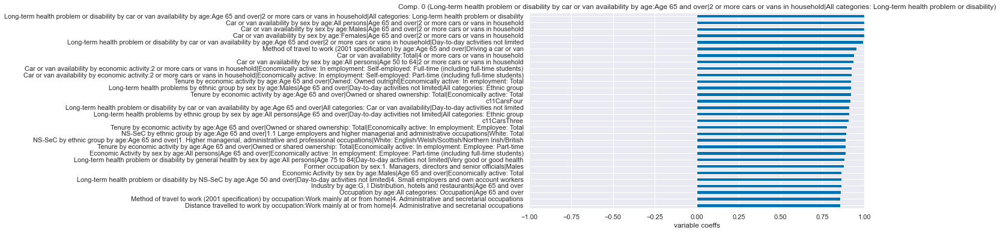

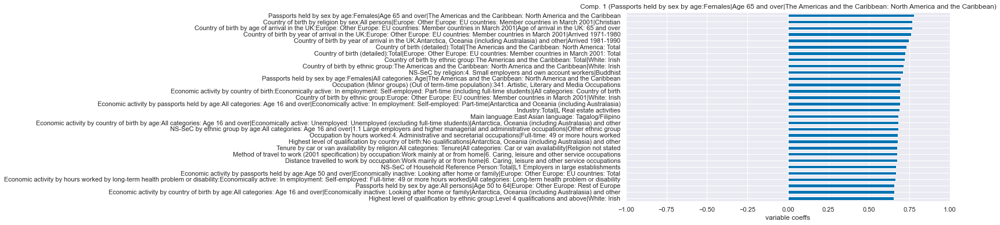

In [583]:
threshold = best_hyperparams['threshold']
n_comp_FA = best_hyperparams['n_comp_FA']
n_comp    = 2

df = df_simp[train_columns[dist[dist>=threshold].index]]
df = df.fillna(df.mean())
(BES_decomp, comp_labels, comp_dict) = dim_red(df, n_components=n_compFA,
                                               red_type="Factor Analysis",show_first_x_comps=n_comp)
Y = df_simp[var_stub]
X = BES_decomp.loc[:,0:(n_comp-1)]
X[year_combo[1:]] = df_simp[year_combo[1:]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
display(results.summary())

# results_store.loc[ind]
ind = results_store.index.max()
if pd.isnull(ind):
    ind = 0
else:
    ind = ind+1
end = time.time()
#         print(end - start)            
results_df.loc[ind,["duration","n_comp","n_compFA","threshold",
                    "variables",
                    "results","BES_decomp"]] = [end-start,
                                                                    n_comp,n_compFA,threshold,
                                                                                                   df.columns,
                                                                                            results,BES_decomp]


In [595]:
results_store.loc[ind,["duration","n_comp","n_compFA","threshold",
                    "variables",
                    "results","BES_decomp"]] = [end-start,
                                                                    n_comp,n_compFA,threshold,
                                                                                                   df.columns,
                                                                                            results,BES_decomp]

In [592]:
results

In [587]:
ind = results_store.index.max()
if pd.isnull(ind):
    ind = 0
else:
    ind = ind+1
end = time.time()
#         print(end - start)            
results_store.loc[ind,["duration","n_comp","n_compFA","threshold",
                    "variables",
                    "results","BES_decomp"]] = [end-start,
                                                                    n_comp,n_compFA,threshold,
                                                                                                   df.columns,
                                                                                            results,BES_decomp]

results_store

ValueError: setting an array element with a sequence.

100%|██████████████████████████████████████| 100/100 [01:07<00:00,  1.49trial/s, best loss: -0.8087304957151816]
{'n_comp_FA': 3.0, 'threshold': 0.011206802271365307}
Wall time: 1min 7s


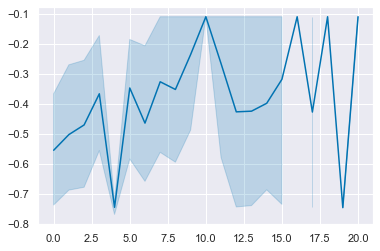

In [561]:
%%time
from hyperopt import STATUS_OK, Trials, fmin, hp, tpe
space={ 
        'threshold':hp.uniform('threshold', dist[dist>0].min(),dist.max()),
        'n_comp_FA': hp.quniform('n_comp_FA', 0,20,1),
        'n_comp': 2,
      }
def objective(space):
    threshold = space['threshold']
    n_comp_FA = int(space['n_comp_FA'])+1
    n_comp = space['n_comp']
    df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
    df = df.fillna(df.mean())
#     print(n_comp,n_comp_FA,'!')
    BES_decomp = dim_red(df, n_components=n_comp_FA,red_type="Factor Analysis",
                                                   show_first_x_comps=n_comp,display_comp=False)

    Y = df_simp[var_stub]
    X = BES_decomp.loc[:,0:(n_comp-1)]
    X[["GE"+x for x in year_combo[1:]]] = df_simp[year_combo[1:]]
    X = sm.add_constant(X)
    model = sm.OLS(Y,X)
    results = model.fit()
    return {'loss': -(results.rsquared), 'status': STATUS_OK }


trials = Trials()
best_hyperparams = fmin(fn = objective,
                        space = space,
                        algo = tpe.suggest,
                        max_evals = 100,
                        trials = trials)
print(best_hyperparams)
sns.lineplot(trials.vals['n_comp_FA'],trials.losses())

In [570]:
threshold = 0.011206802271365307
n_comp_FA = 3+1
n_comp = 2

df = df_simp[train_columns[dist[dist>=threshold].index]]#[geomask]
df = df.fillna(df.mean())

BES_decomp = dim_red(df, n_components=n_comp_FA,red_type="Factor Analysis",
                                               show_first_x_comps=n_comp,display_comp=False)

Y = df_simp[var_stub]
X = BES_decomp.loc[:,0:(n_comp-1)]
X[["GE"+x for x in year_combo[1:]]] = df_simp[year_combo[1:]]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
display(results.summary())

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Voteshare   R-squared:                       0.809
Model:                            OLS   Adj. R-squared:                  0.808
Method:                 Least Squares   F-statistic:                     2011.
Date:                Mon, 07 Feb 2022   Prob (F-statistic):               0.00
Time:                        18:26:14   Log-Likelihood:                -8643.9
No. Observations:                2860   AIC:                         1.730e+04
Df Residuals:                    2853   BIC:                         1.734e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         21.0561      0.208    101.203      0.000      20.648      21.464
0              9.4664      0.093    101.693      0.000       9.284       9.649
1              0.8757      0.093      9.399      0.000       0.693       1.058
GE10           4.0754      0.294     13.851      0.000       3.498       4.652
GE15           5.1273      0.294     17.426      0.000       4.550       5.704
GE17           9.6580      0.294     32.824      0.000       9.081      10.235
GE19          10.1301      0.294     34.429      0.000       9.553      10.707
==============================================================================
Omnibus:                      253.761   Durbin-Watson:                   1.845
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              528.093
Skew:                          -0.571   Prob(JB):                    2.12e-115
Kurtosis:                       4.769   Cond. No.                         5.83
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [566]:
dist[dist>0].min()

0.000563616

In [535]:
## label the train/test plot!

In [533]:
# df_simp_base.drop("Con17_elec",axis=1,inplace=True)

In [539]:
gc.collect()

128687

In [540]:
search(df_simp,"Con17_elec")

Series([], dtype: float64)

In [559]:
dist[dist>0].shape

(3723,)